In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from sklearn.ensemble import GradientBoostingRegressor

In [3]:
test_array = np.array([1, 2, 3])
test_array**2

a,b = 5, 5
a, b

(5, 5)

#### tree objects

In [4]:
from dataclasses import dataclass
from typing import Optional

@dataclass
class Tree:
    left: Optional= None
    right: Optional = None
    parent: Optional = None
    feature_idx: Optional[int] = None
    split_value: Optional[float] = None
    predict_value: Optional[float] = None
    depth: Optional[int] = 0
    
    def apply(self, x: np.array):
        """return the root node of the tree"""
        return 
    
    def __repr__(self):
        return f"Tree feature_idx:'{self.feature_idx}' split_value:'{self.split_value}'\n"+\
            f"predicted_value:{self.predict_value}"
    
    def __str__(self):
        return self.__repr__()
    
    
    def apply_single_input(self, input_feature_array: np.array):
        """for each instance, apply the decision tree."""
        # if leaf, return predicted value
        if self.feature_idx is None:
            return self.predict_value
        if input_feature_array[self.feature_idx] <= self.split_value:
            return self.left.apply_single_input(input_feature_array)
        else:
            return self.right.apply_single_input(input_feature_array)
            
    def apply(self, input_df: pd.DataFrame):
        """apply decision tree for the whole tree"""
        # skip the index column
        print(f"input df shape from tree: {input_df.shape}")
        intermediate_output = [self.apply_single_input(row)  for row in input_df.values]
        output_array = np.array(intermediate_output)
        #print(f"intermediate shape from tree: { [row  for row in input_df.values]}")
        print(f"output df shape from tree: {output_array.shape}")
        return output_array
    
def find_tree_split(feature_df: pd.DataFrame, residuals: np.array):
    """
    curr_score = residuals**2/len(residuals)

    for feature_index in range(len(features)):

        for value in input_df.sort_values(feature_index)[feature_index]:


            residuals_left = y[input_df.query(f"")]  
            residuals_right = y[input_df.query(f"")]

            # the score of squre lost is just residuals / (num residuals + lambda)
            score_left = residuals_left**2/len(residuals_left)
            score_right = residuals_right**2/len(residuals_left)
    return:
        feature_idx,
        best_split_value,
    """
    parent_score = np.sum(residuals)**2/len(residuals)
    best_score = 0 #float(parent_score)
    n_features = feature_df.shape[1]
    features = list(feature_df.columns)

    best_feature_idx = None
    best_split_value = None
    predicted_left, predicted_right = None, None
    if feature_df.shape[0] == 1:
        return best_feature_idx, best_split_value, predicted_left, predicted_right
    for feature_idx in range(n_features):
        # sort data to see the split
        feature_df = feature_df.sort_values(feature_df.columns[feature_idx])
        feature_values = feature_df[features[feature_idx]]
        candidate_values = feature_values.unique()
        # need to handle where there is only 1 unique value 
        if len(candidate_values) ==1:
            continue 
        #dont have to consider maximum value since it doesn't create split 
        for candidate_value in candidate_values[:-1]: 
            print(f"feature_idx: {feature_idx}, feature_value: {candidate_value}")
            left_indices = feature_values <= candidate_value
            right_indices = feature_values > candidate_value
            
            residuals_left = residuals[left_indices]
            residuals_right = residuals[right_indices]
  
            # no regularizations
            # with square loss, griadent is just residuals, hessians is 1
            score_left = np.sum(residuals_left)**2/len(residuals_left)
            score_right = np.sum(residuals_right)**2/len(residuals_right)
            split_score = score_left + score_right - parent_score
            print(f"""best_value:{np.round(best_score, 2)}, split_score:{np.round(split_score,2)}\n"""+\
            f"""left_score:{np.round(score_left,2)}, right_score:{np.round(score_right,2)}\n\n""")
            if  split_score > best_score:
                print(f"find new best: {np.round(split_score,2)}, old_score: {best_score}")
                best_score = split_score
                best_split_value = candidate_value
                best_feature_idx = int(feature_idx)
                predicted_left = np.sum(residuals_left)/len(residuals_left)
                predicted_right = np.sum(residuals_right)/len(residuals_right)
    return best_feature_idx, best_split_value, predicted_left, predicted_right
                
class gradientTreeRegressor:
    def __init__(self, learning_rate: float=0.3, max_depth: int=5, min_leaf_size=1):
        self.max_depth = max_depth
        self.min_leaf_size = min_leaf_size
        self.learning_rate = learning_rate
        self.tree = None
        
    def predict(self, input_df:pd.DataFrame):
        """
        predict value given input dataframe
        """
        return self.tree.apply(input_df)
    
    def fit(self, feature_df:pd.DataFrame, res: pd.Series):
        """
        fitting a single tree
        """
        prediction_value = np.sum(res)/len(res)
        root = Tree(predict_value=prediction_value, depth=1) 
        print(root)
        #res = y - prev_prediction
        stack = [(root, feature_df, res)]
    
        while stack:
            print("checking stack")
            print([tuple_[1].shape[0] for tuple_ in stack]) # print input feature_df
            print([tuple_[2] for tuple_ in stack]) # print residuals
            curr_node, feature_df, res = stack.pop(0)
            print(f"current feature_df： {feature_df.shape}")
            
            if curr_node.depth >= self.max_depth:
                continue
                
            
            feature_idx, split_value, left_predicted, right_predicted = find_tree_split(feature_df, res)
            if feature_idx is None:
                # training is done
                print("no feature idx, skpping")
                continue
            curr_node.feature_idx = feature_idx
            curr_node.split_value = split_value
            
            
            split_col = feature_df.columns[feature_idx]
            sorted_feature_df = feature_df.sort_values(split_col)
            left_feature_df = sorted_feature_df[sorted_feature_df[split_col] <= split_value].copy()
            right_feature_df = sorted_feature_df[sorted_feature_df[split_col] > split_value].copy()
            
            left_res = res[sorted_feature_df[split_col] <= split_value] #- self.learning_rate * left_predicted
            right_res =  res[sorted_feature_df[split_col] > split_value]# - self.learning_rate * right_predicted
            print(f"left res {left_feature_df.shape}")
            print(f"right res {right_feature_df.shape}")
            
            left_tree = Tree(predict_value=left_predicted, depth=curr_node.depth+1)
            right_tree = Tree(predict_value=right_predicted,depth=curr_node.depth+1)
            #eft_feature_df, left_res, 
            curr_node.left = left_tree
            curr_node.right = right_tree
            
            stack.append((left_tree, left_feature_df, left_res))
            stack.append((right_tree, right_feature_df, right_res))
            print("end check stack ###\n\n")
        self.tree = root
        return root
    
class xgboostRegressor:
    def __init__(self, n_estimators: int=5, learning_rate: float=0.1, max_depth: int=5, min_leaf_size=1):
        """
        min_leaf_size is not yet implemented
        """
        self.n_estimators = n_estimators
        self.learning_rate = learning_rate
        self.max_depth = max_depth
        self.min_leaf_size = min_leaf_size
        self.regressors = []
        
    def fit(self, feature_df:pd.DataFrame, y: pd.Series):
        self.regressors = []
        curr_prediction = np.array([0.5]*feature_df.shape[0]) # initial prediction is 0.5
        res = y - curr_prediction
        for i in range(self.n_estimators):
            # don't think learning rate matter in a single tree
            print(f"training {i}th tree")
            print(curr_prediction)
            regressor = gradientTreeRegressor(max_depth=self.max_depth, min_leaf_size=self.min_leaf_size, 
                                         learning_rate=self.learning_rate)
            regressor.fit(feature_df, res)
            
            regressor_predictions =regressor.predict(feature_df)
            print(f"regressor_predictions shape: {regressor_predictions.shape}")
            curr_prediction = curr_prediction + self.learning_rate * regressor.predict(feature_df)
            res = y - curr_prediction
            print(f"curr prediction shape:{curr_prediction.shape}")
            self.regressors.append(regressor)
            
            print("done training \n\n")
        return self.regressors
    
    def predict(self, feature_df: pd.DataFrame):
        """assume the model is trained"""
        curr_prediction = np.array([0.5]*feature_df.shape[0]) # initial prediction is 0.5
        for regressor in self.regressors:
            # don't think learning rate matter in a single tree
            curr_prediction = curr_prediction + self.learning_rate * regressor.predict(feature_df)
            print(f"curr prediction shape:{curr_prediction.shape}")
        return curr_prediction


#### single tree testing

In [5]:
new_tree = Tree(feature_idx=5, split_value=5)
left_tree = Tree(parent=new_tree, predict_value=10)
right_tree = Tree(parent=new_tree, predict_value=15)

In [6]:
feature_df = pd.DataFrame({'1':[1, 5, 5, 4, 20], '2':[1, 1, 2, 5, 5]})
residuals = np.array([5, 5, 5, 1, 1])
feature_df 

,1,2
0,1,1
1,5,1
2,5,2
3,4,5
4,20,5


In [7]:
#new_tree.find_split(feature_df, residuals)

In [8]:
y = np.array([15, 15, 15, 1, 10])

In [9]:
gtr = gradientTreeRegressor(max_depth=3)
tree = gtr.fit(feature_df, y-0.5)

Tree feature_idx:'None' split_value:'None'
predicted_value:10.7
checking stack
[5]
[array([14.5, 14.5, 14.5,  0.5,  9.5])]
current feature_df： (5, 2)
feature_idx: 0, feature_value: 1
best_value:0, split_score:18.05
left_score:210.25, right_score:380.25


find new best: 18.05, old_score: 0
feature_idx: 0, feature_value: 4
best_value:18.05, split_score:48.13
left_score:420.5, right_score:200.08


find new best: 48.13, old_score: 18.049999999999955
feature_idx: 0, feature_value: 5
best_value:48.13, split_score:1.8
left_score:484.0, right_score:90.25


feature_idx: 1, feature_value: 1
best_value:48.13, split_score:48.13
left_score:420.5, right_score:200.08


feature_idx: 1, feature_value: 2
best_value:48.13, split_score:108.3
left_score:630.75, right_score:50.0


find new best: 108.3, old_score: 48.133333333333326
left res (3, 2)
right res (2, 2)
end check stack ###


checking stack
[3, 2]
[array([14.5, 14.5, 14.5]), array([0.5, 9.5])]
current feature_df： (3, 2)
feature_idx: 0, feature_val

In [10]:
pd.concat([feature_df, pd.Series(y)],axis=1)

,1,2,0
0,1,1,15
1,5,1,15
2,5,2,15
3,4,5,1
4,20,5,10


In [11]:
tree

Tree feature_idx:'1' split_value:'2'
predicted_value:10.7

In [12]:
tree.apply_single_input(np.array([40, 15]))

9.5

In [13]:
tree.apply(feature_df) + 0.5

input df shape from tree: (5, 2)
output df shape from tree: (5,)


array([15., 15., 15.,  1., 10.])

In [14]:
tree.left

Tree feature_idx:'None' split_value:'None'
predicted_value:14.5

In [15]:
tree.right

Tree feature_idx:'0' split_value:'4'
predicted_value:5.0

In [16]:
tree.right.left

Tree feature_idx:'None' split_value:'None'
predicted_value:0.5

In [17]:
tree.right.right

Tree feature_idx:'None' split_value:'None'
predicted_value:9.5

In [18]:
gbregressor = GradientBoostingRegressor(n_estimators=2, learning_rate=1, max_depth=3)
gbregressor.fit(feature_df, y)

GradientBoostingRegressor(learning_rate=1, n_estimators=2)

In [19]:
sklearn_gb_pred = gbregressor.predict(feature_df)
np.mean((sklearn_gb_pred - y)**2)

0.0

#### loading iris dataset

In [20]:
from sklearn.datasets import load_iris

In [21]:
data = load_iris()

In [22]:
iris = pd.DataFrame(data['data'])
iris.columns = ['1', '2', '3', '4']
iris['target'] =data['target']
iris

,1,2,3,4,target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,2
146,6.3,2.5,5.0,1.9,2
147,6.5,3.0,5.2,2.0,2
148,6.2,3.4,5.4,2.3,2


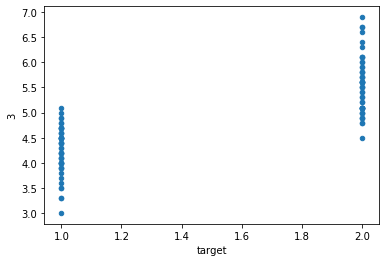

In [23]:
iris.query("target > 0").plot(x='target', y='3', kind='scatter')

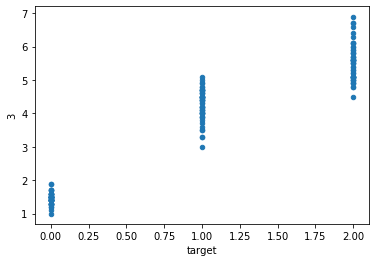

In [24]:
iris.plot(x='target', y='3', kind='scatter')

In [25]:
iris['target'].value_counts()

0    50
1    50
2    50
Name: target, dtype: int64

In [26]:
feature_df = iris[['2', 'target']]
y = iris['3']

#### test_single grident tree regressor

In [27]:
gtr = gradientTreeRegressor(max_depth=3)
tree = gtr.fit(feature_df , y-0.5)

Tree feature_idx:'None' split_value:'None'
predicted_value:3.258
checking stack
[150]
[0      0.9
1      0.9
2      0.8
3      1.0
4      0.9
      ... 
145    4.7
146    4.5
147    4.7
148    4.9
149    4.6
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.07
left_score:9.0, right_score:1583.25


find new best: 0.07, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.07, split_score:0.99
left_score:56.25, right_score:1536.93


find new best: 0.99, old_score: 0.0670107382545666
feature_idx: 0, feature_value: 2.3
best_value:0.99, split_score:0.0
left_score:84.5, right_score:1507.69


feature_idx: 0, feature_value: 2.4
best_value:0.99, split_score:0.03
left_score:113.28, right_score:1478.93


feature_idx: 0, feature_value: 2.5
best_value:0.99, split_score:1.82
left_score:239.09, right_score:1354.91


find new best: 1.82, old_score: 0.9947835616439988
feature_idx: 0, feature_value: 2.6
best_value:1.8

In [28]:
np.mean((np.array(tree.apply(feature_df))+0.5 - y)**2)

input df shape from tree: (150, 2)
output df shape from tree: (150,)


0.18082391919191923

In [29]:
from sklearn.tree import DecisionTreeRegressor

In [30]:
regressor = DecisionTreeRegressor(random_state=0, max_depth=3)
regressor.fit(iris[['2', 'target']], iris['3'])

DecisionTreeRegressor(max_depth=3, random_state=0)

In [31]:
np.mean((np.array(regressor.predict(feature_df)) - y)**2)

0.14308213771001627

#### test xgboost regressor

In [32]:
extremely_slow_regressor = xgboostRegressor(learning_rate=0.1, max_depth=3, n_estimators=50)

In [33]:
extremely_slow_regressor.fit(feature_df, np.array(y))

training 0th tree
[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5]
Tree feature_idx:'None' split_value:'None'
predicted_value:3.258
checking stack
[150]
[array([0.9, 0.9, 0.8, 1. , 0.9, 1.2, 0.9, 1. , 0.9, 1. , 1. , 1.1, 0.9,
       0.6, 0.7, 1. , 0.8, 0.9, 1.2, 1. , 1.2, 1. , 0.5, 1.2, 1.4, 1.1,
       1.1, 1. , 0.9, 1.1, 1.1, 1. , 1. , 0.9, 1. , 0.7, 0.8, 0.9, 0.8,
       1. , 0.8, 0.8, 0.8, 1.1, 1.4, 0.9, 1.1, 0.9, 1. , 0.9, 4.2, 4.

find new best: 33.46, old_score: 23.995900795130865
feature_idx: 0, feature_value: 2.5
best_value:33.46, split_score:63.14
left_score:8.57, right_score:900.73


find new best: 63.14, old_score: 33.46161386221968
feature_idx: 0, feature_value: 2.6
best_value:63.14, split_score:82.09
left_score:11.1, right_score:917.15


find new best: 82.09, old_score: 63.143455392069995
feature_idx: 0, feature_value: 2.7
best_value:82.09, split_score:116.26
left_score:16.98, right_score:945.44


find new best: 116.26, old_score: 82.09429327970054
feature_idx: 0, feature_value: 2.8
best_value:116.26, split_score:191.34
left_score:23.24, right_score:1014.25


find new best: 191.34, old_score: 116.26492012152494
feature_idx: 0, feature_value: 2.9
best_value:191.34, split_score:176.81
left_score:55.67, right_score:967.29


feature_idx: 0, feature_value: 3.0
best_value:191.34, split_score:135.18
left_score:192.31, right_score:789.02


feature_idx: 0, feature_value: 3.1
best_value:191.34, split_score:124.23


best_value:3.92, split_score:4.5
left_score:144.05, right_score:696.11


find new best: 4.5, old_score: 3.9226877731371133
feature_idx: 0, feature_value: 2.7
best_value:4.5, split_score:7.05
left_score:200.61, right_score:642.1


find new best: 7.05, old_score: 4.501137461559551
feature_idx: 0, feature_value: 2.8
best_value:7.05, split_score:13.13
left_score:287.1, right_score:561.69


find new best: 13.13, old_score: 7.046700027451948
feature_idx: 0, feature_value: 2.9
best_value:13.13, split_score:13.73
left_score:359.22, right_score:490.17


find new best: 13.73, old_score: 13.125734493433242
feature_idx: 0, feature_value: 3.0
best_value:13.73, split_score:3.76
left_score:579.14, right_score:260.28


feature_idx: 0, feature_value: 3.1
best_value:13.73, split_score:1.49
left_score:658.38, right_score:178.78


feature_idx: 0, feature_value: 3.2
best_value:13.73, split_score:0.45
left_score:740.47, right_score:95.64


feature_idx: 0, feature_value: 3.3
best_value:13.73, split_score:0.1


find new best: 54.23, old_score: 41.747543689653526
feature_idx: 0, feature_value: 2.7
best_value:54.23, split_score:75.99
left_score:11.24, right_score:619.91


find new best: 75.99, old_score: 54.22922201866504
feature_idx: 0, feature_value: 2.8
best_value:75.99, split_score:125.47
left_score:15.26, right_score:665.37


find new best: 125.47, old_score: 75.98953712700745
feature_idx: 0, feature_value: 2.9
best_value:125.47, split_score:114.58
left_score:37.16, right_score:632.58


feature_idx: 0, feature_value: 3.0
best_value:125.47, split_score:88.21
left_score:126.56, right_score:516.81


feature_idx: 0, feature_value: 3.1
best_value:125.47, split_score:80.61
left_score:173.35, right_score:462.41


feature_idx: 0, feature_value: 3.2
best_value:125.47, split_score:65.77
left_score:242.05, right_score:378.88


feature_idx: 0, feature_value: 3.3
best_value:125.47, split_score:51.18
left_score:285.52, right_score:320.83


feature_idx: 0, feature_value: 3.4
best_value:125.47, split_sco

output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 8th tree
[1.06548862 1.01372957 1.01372957 1.01372957 1.06548862 1.06548862
 1.06548862 1.06548862 1.01372957 1.01372957 1.06548862 1.06548862
 1.01372957 1.01372957 1.06548862 1.06548862 1.06548862 1.06548862
 1.06548862 1.06548862 1.06548862 1.06548862 1.06548862 1.06548862
 1.06548862 1.01372957 1.06548862 1.06548862 1.06548862 1.01372957
 1.01372957 1.06548862 1.06548862 1.06548862 1.01372957 1.01372957
 1.06548862 1.06548862 1.01372957 1.06548862 1.06548862 1.01372957
 1.01372957 1.06548862 1.06548862 1.01372957 1.06548862 1.01372957
 1.06548862 1.06548862 2.64144329 2.64144329 2.64144329 2.64144329
 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329
 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329
 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329
 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329 2.64144329
 2.64144329 2.64144329 2.641443

feature_idx: 1, feature_value: 0
best_value:53.93, split_score:59.34
left_score:6.95, right_score:291.38


find new best: 59.34, old_score: 53.93220018642157
feature_idx: 1, feature_value: 1
best_value:59.34, split_score:36.23
left_score:83.67, right_score:191.54


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[array([ 0.29100694,  0.34892333,  0.24892333,  0.44892333,  0.29100694,
        0.59100694,  0.29100694,  0.39100694,  0.34892333,  0.44892333,
        0.39100694,  0.49100694,  0.34892333,  0.04892333,  0.09100694,
        0.39100694,  0.19100694,  0.29100694,  0.59100694,  0.39100694,
        0.59100694,  0.39100694, -0.10899306,  0.59100694,  0.79100694,
        0.54892333,  0.49100694,  0.39100694,  0.29100694,  0.54892333,
        0.54892333,  0.39100694,  0.39100694,  0.29100694,  0.44892333,
        0.14892333,  0.19100694,  0.29100694,  0.24892333,  0.39100694,
        0.19100694,  0.24892333,  0.24892333,  0.49100694,  0.79100694,
  


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.01
left_score:0.1, right_score:3.6


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.0
left_score:0.55, right_score:3.14


feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.96, right_score:2.74


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.04
left_score:0.92, right_score:2.81


find new best: 0.04, old_score: 0.00787269929700507
feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.02
left_score:1.13, right_score:2.59


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.0
left_score:2.15, right_score:1.54


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.01
left_score:2.72, right_score:0.99


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.0
left_score:2.77, right_score:0.93


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.0
left_score:

 4.39626445 4.39626445 4.39626445 4.39626445 4.39626445 4.39626445]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.7453258981826294
checking stack
[150]
[array([ 0.12825223,  0.21596551,  0.11596551,  0.31596551,  0.12825223,
        0.42825223,  0.12825223,  0.22825223,  0.21596551,  0.31596551,
        0.22825223,  0.32825223,  0.21596551, -0.08403449, -0.07174777,
        0.22825223,  0.02825223,  0.12825223,  0.42825223,  0.22825223,
        0.42825223,  0.22825223, -0.27174777,  0.42825223,  0.62825223,
        0.41596551,  0.32825223,  0.22825223,  0.12825223,  0.41596551,
        0.41596551,  0.22825223,  0.22825223,  0.12825223,  0.31596551,
        0.01596551,  0.02825223,  0.12825223,  0.11596551,  0.22825223,
        0.02825223,  0.11596551,  0.11596551,  0.32825223,  0.62825223,
        0.21596551,  0.32825223,  0.21596551,  0.22825223,  0.12825223,
        1.3001674 ,  1.1001674 ,  1.5001674 ,  0.6001674 ,  1.2001674 ,
        1.1001674 ,  1.3001674 , -0.0998

feature_idx: 0, feature_value: 2.6
best_value:3.66, split_score:4.76
left_score:0.44, right_score:48.61


find new best: 4.76, old_score: 3.6633822882874654
feature_idx: 0, feature_value: 2.7
best_value:4.76, split_score:5.79
left_score:0.99, right_score:49.08


find new best: 5.79, old_score: 4.763297077511247
feature_idx: 0, feature_value: 2.8
best_value:5.79, split_score:9.94
left_score:1.24, right_score:52.98


find new best: 9.94, old_score: 5.791784176140048
feature_idx: 0, feature_value: 2.9
best_value:9.94, split_score:7.68
left_score:3.68, right_score:48.28


feature_idx: 0, feature_value: 3.0
best_value:9.94, split_score:6.53
left_score:10.51, right_score:40.31


feature_idx: 0, feature_value: 3.1
best_value:9.94, split_score:5.51
left_score:14.7, right_score:35.09


feature_idx: 0, feature_value: 3.2
best_value:9.94, split_score:4.88
left_score:19.7, right_score:29.46


feature_idx: 0, feature_value: 3.3
best_value:9.94, split_score:3.34
left_score:23.7, right_score:23.92





find new best: 0.94, old_score: 0.5601049845275625
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[array([ 0.04485321,  0.15525859,  0.05525859,  0.25525859,  0.04485321,
        0.34485321,  0.04485321,  0.14485321,  0.15525859,  0.25525859,
        0.14485321,  0.24485321,  0.15525859, -0.14474141, -0.15514679,
        0.14485321, -0.05514679]), array([ 0.04485321,  0.34485321,  0.14485321,  0.34485321,  0.14485321,
       -0.35514679,  0.34485321,  0.54485321,  0.35525859,  0.24485321,
        0.14485321,  0.04485321,  0.35525859,  0.35525859,  0.14485321,
        0.14485321,  0.04485321,  0.25525859, -0.04474141, -0.05514679,
        0.04485321,  0.05525859,  0.14485321, -0.05514679,  0.05525859,
        0.05525859,  0.24485321,  0.54485321,  0.15525859,  0.24485321,
        0.15525859,  0.14485321,  0.04485321]), array([ 1.00435583,  0.80435583,  1.20435583,  0.30435583,  0.90435583,
        0.80435583,  1.00435583, -0.39564417,  0.904355


feature_idx: 0, feature_value: 3.3
best_value:6.5, split_score:2.04
left_score:15.75, right_score:15.34


feature_idx: 0, feature_value: 3.4
best_value:6.5, split_score:0.71
left_score:20.93, right_score:8.83


feature_idx: 0, feature_value: 3.5
best_value:6.5, split_score:0.38
left_score:23.21, right_score:6.23


feature_idx: 0, feature_value: 3.6
best_value:6.5, split_score:0.08
left_score:25.23, right_score:3.91


feature_idx: 0, feature_value: 3.7
best_value:6.5, split_score:0.0
left_score:26.92, right_score:2.14


feature_idx: 0, feature_value: 3.8
best_value:6.5, split_score:0.01
left_score:28.12, right_score:0.95


feature_idx: 0, feature_value: 3.9
best_value:6.5, split_score:0.07
left_score:28.76, right_score:0.37


feature_idx: 0, feature_value: 4.0
best_value:6.5, split_score:0.02
left_score:28.68, right_score:0.4


feature_idx: 0, feature_value: 4.1
best_value:6.5, split_score:0.01
left_score:28.77, right_score:0.29


feature_idx: 0, feature_value: 4.2
best_value:6.5, spli

feature_idx: 0, feature_value: 2.8
best_value:0.39, split_score:0.13
left_score:9.02, right_score:14.36


feature_idx: 0, feature_value: 2.9
best_value:0.39, split_score:0.26
left_score:10.45, right_score:13.05


feature_idx: 0, feature_value: 3.0
best_value:0.39, split_score:0.01
left_score:17.85, right_score:5.4


feature_idx: 0, feature_value: 3.1
best_value:0.39, split_score:0.19
left_score:20.7, right_score:2.73


feature_idx: 0, feature_value: 3.2
best_value:0.39, split_score:0.25
left_score:22.4, right_score:1.09


feature_idx: 0, feature_value: 3.3
best_value:0.39, split_score:0.29
left_score:23.11, right_score:0.43


feature_idx: 0, feature_value: 3.4
best_value:0.39, split_score:0.19
left_score:23.27, right_score:0.16


feature_idx: 0, feature_value: 3.6
best_value:0.39, split_score:0.11
left_score:23.23, right_score:0.13


feature_idx: 1, feature_value: 1
best_value:0.39, split_score:0.5
left_score:8.46, right_score:15.28


find new best: 0.5, old_score: 0.3860034228453344
l


feature_idx: 0, feature_value: 3.7
best_value:2.79, split_score:0.11
left_score:12.16, right_score:0.46


feature_idx: 0, feature_value: 3.8
best_value:2.79, split_score:0.09
left_score:12.42, right_score:0.17


feature_idx: 0, feature_value: 3.9
best_value:2.79, split_score:0.18
left_score:12.66, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:2.79, split_score:0.07
left_score:12.52, right_score:0.06


feature_idx: 0, feature_value: 4.1
best_value:2.79, split_score:0.04
left_score:12.5, right_score:0.05


feature_idx: 0, feature_value: 4.2
best_value:2.79, split_score:0.08
left_score:12.59, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:2.79, split_score:3.11
left_score:0.36, right_score:15.25


find new best: 3.11, old_score: 2.7855107404789177
feature_idx: 1, feature_value: 1
best_value:3.11, split_score:2.08
left_score:4.22, right_score:10.37


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[array([-0.01805141,  0


feature_idx: 1, feature_value: 0
best_value:1.47, split_score:1.65
left_score:0.19, right_score:8.1


find new best: 1.65, old_score: 1.4732448331264827
feature_idx: 1, feature_value: 1
best_value:1.65, split_score:1.37
left_score:2.04, right_score:5.97


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[array([-0.04112849,  0.0918397 , -0.0081603 ,  0.1918397 , -0.04112849,
        0.22616246, -0.04112849,  0.05887151,  0.0918397 ,  0.1918397 ,
        0.05887151,  0.15887151,  0.0918397 , -0.2081603 , -0.27383754,
        0.02616246, -0.17383754, -0.04112849,  0.25887151,  0.05887151,
        0.25887151,  0.05887151, -0.44112849,  0.25887151,  0.45887151,
        0.2918397 ,  0.15887151,  0.05887151, -0.04112849,  0.2918397 ,
        0.2918397 ,  0.05887151,  0.02616246, -0.07383754,  0.1918397 ,
       -0.1081603 , -0.14112849, -0.04112849, -0.0081603 ,  0.05887151,
       -0.14112849, -0.0081603 , -0.0081603 ,  0.15887151,  0.45887151,
        0.0


feature_idx: 0, feature_value: 3.6
best_value:0.41, split_score:0.12
left_score:6.68, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.41, split_score:0.39
left_score:1.88, right_score:5.07


left res (7, 2)
right res (93, 2)
end check stack ###


checking stack
[44, 6, 7, 93]
[array([-0.04933159,  0.08948231, -0.01051769,  0.18948231, -0.04933159,
        0.21795936, -0.04933159,  0.05066841,  0.08948231,  0.18948231,
        0.05066841,  0.15066841,  0.08948231, -0.21051769, -0.28204064,
        0.01795936, -0.18204064, -0.04933159,  0.25066841,  0.05066841,
        0.25066841,  0.05066841, -0.44933159,  0.25066841,  0.45066841,
        0.28948231,  0.15066841,  0.05066841, -0.04933159,  0.28948231,
        0.28948231,  0.05066841,  0.01795936, -0.08204064,  0.18948231,
       -0.11051769, -0.14933159, -0.04933159, -0.01051769,  0.05066841,
       -0.14933159, -0.01051769, -0.01051769,  0.15066841]), array([ 0.45066841,  0.08948231,  0.15066841,  0.08948231,  0.050668

feature_idx: 0, feature_value: 3.7
best_value:0.96, split_score:0.24
left_score:4.58, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.96, split_score:0.16
left_score:4.52, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.96, split_score:0.26
left_score:4.59, right_score:0.03


feature_idx: 0, feature_value: 4.0
best_value:0.96, split_score:0.11
left_score:4.47, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.96, split_score:0.06
left_score:4.42, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.96, split_score:0.11
left_score:4.44, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.96, split_score:1.08
left_score:0.13, right_score:5.32


find new best: 1.08, old_score: 0.9625560630337855
feature_idx: 1, feature_value: 1
best_value:1.08, split_score:1.14
left_score:1.18, right_score:4.32


find new best: 1.14, old_score: 1.0828930326010147
left res (100, 2)
right res (50, 2)
end check stack ###


checkin


find new best: 0.36, old_score: 0.2304429995228232
feature_idx: 0, feature_value: 2.8
best_value:0.36, split_score:0.61
left_score:2.82, right_score:0.78


find new best: 0.61, old_score: 0.3635064787236879
feature_idx: 0, feature_value: 2.9
best_value:0.61, split_score:0.38
left_score:2.52, right_score:0.85


feature_idx: 0, feature_value: 3.0
best_value:0.61, split_score:0.77
left_score:3.69, right_score:0.09


find new best: 0.77, old_score: 0.6059674980381708
feature_idx: 0, feature_value: 3.1
best_value:0.77, split_score:1.03
left_score:4.03, right_score:0.0


find new best: 1.03, old_score: 0.7735261073137276
feature_idx: 0, feature_value: 3.2
best_value:1.03, split_score:0.46
left_score:3.46, right_score:0.0


feature_idx: 0, feature_value: 3.3
best_value:1.03, split_score:0.76
left_score:3.68, right_score:0.08


feature_idx: 0, feature_value: 3.4
best_value:1.03, split_score:0.31
left_score:3.3, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:1.03, split_score

feature_idx: 1, feature_value: 0
best_value:0.51, split_score:0.59
left_score:0.03, right_score:2.44


find new best: 0.59, old_score: 0.5128499684354295
feature_idx: 1, feature_value: 1
best_value:0.59, split_score:0.56
left_score:0.47, right_score:1.97


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[array([-0.09083789,  0.05372049, -0.04627951,  0.15372049, -0.09083789,
        0.16800613, -0.09083789,  0.00916211,  0.05372049,  0.15372049,
        0.00916211,  0.10916211,  0.05372049, -0.24627951, -0.33199387,
        0.16445951, -0.23199387, -0.09083789,  0.20916211,  0.00916211,
        0.20916211,  0.00916211, -0.49083789,  0.20916211,  0.40916211,
        0.25372049,  0.10916211,  0.00916211, -0.09083789,  0.25372049,
        0.25372049,  0.00916211, -0.03199387,  0.06445951,  0.15372049,
       -0.14627951, -0.19083789, -0.09083789, -0.04627951,  0.00916211,
       -0.19083789, -0.04627951, -0.04627951,  0.10916211,  0.40916211,
        0.0

end check stack ###


checking stack
[50, 100]
[array([-0.12696453,  0.04111628, -0.05888372,  0.14111628, -0.12696453,
        0.1600564 , -0.12696453, -0.02696453,  0.04111628,  0.14111628,
       -0.02696453,  0.07303547,  0.04111628, -0.25888372, -0.3224436 ,
        0.24038264, -0.2399436 , -0.12696453,  0.20121238,  0.00121238,
        0.17303547, -0.02696453, -0.52696453,  0.17303547,  0.37303547,
        0.24111628,  0.07303547, -0.02696453, -0.12696453,  0.24111628,
        0.24111628, -0.02696453, -0.0224436 ,  0.14038264,  0.14111628,
       -0.15888372, -0.22696453, -0.12696453, -0.05888372, -0.02696453,
       -0.22696453, -0.05888372, -0.05888372,  0.07303547,  0.40121238,
        0.04111628,  0.10121238,  0.04111628, -0.02696453, -0.12696453]), array([ 0.54471964,  0.34471964,  0.74471964, -0.33442064,  0.44471964,
        0.34471964,  0.52650416, -0.85528036,  0.44471964, -0.25528036,
       -0.83442064,  0.04471964, -0.33442064,  0.54471964, -0.55528036,
        0.2447

[array([-0.43345002, -0.23345002,  0.07952046, -0.33345002])]
current feature_df： (4, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 37th tree
[1.54944176 1.3633572  1.3633572  1.3633572  1.54944176 1.54182935
 1.54944176 1.54944176 1.3633572  1.3633572  1.54944176 1.54944176
 1.3633572  1.3633572  1.50660166 1.24377543 1.54182935 1.54944176
 1.49306027 1.49306027 1.54944176 1.54944176 1.54944176 1.54944176
 1.54944176 1.3633572  1.54944176 1.54944176 1.54944176 1.3633572
 1.3633572  1.54944176 1.50660166 1.24377543 1.3633572  1.3633572
 1.54944176 1.54944176 1.3633572  1.54944176 1.54944176 1.3633572
 1.3633572  1.54944176 1.49306027 1.3633572  1.49306027 1.3633572
 1.54944176 1.54944176 4.17027159 4.17027159 4.17027159 4.3766953
 4.17027159 4.17027159 4.20649082 4.17027159 4.17027159 4.17027159
 4.3766

        0.05660893, -0.3383578 ])]
current feature_df： (138, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.05
left_score:0.02, right_score:0.96


find new best: 0.05, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.05, split_score:0.03
left_score:0.0, right_score:0.97


feature_idx: 0, feature_value: 2.3
best_value:0.05, split_score:0.1
left_score:0.01, right_score:1.03


find new best: 0.1, old_score: 0.05406390771249414
feature_idx: 0, feature_value: 2.4
best_value:0.1, split_score:0.1
left_score:0.0, right_score:1.03


feature_idx: 0, feature_value: 2.5
best_value:0.1, split_score:0.26
left_score:0.01, right_score:1.18


find new best: 0.26, old_score: 0.10451917394612076
feature_idx: 0, feature_value: 2.6
best_value:0.26, split_score:0.39
left_score:0.03, right_score:1.3


find new best: 0.39, old_score: 0.2638261348368073
feature_idx: 0, feature_value: 2.7
best_value:0.39, split_score:0.28
left_score:0.0, right_score:1.22


feature_idx: 0, feature_

feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.0
left_score:0.04, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.0
left_score:0.02, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.0
left_score:0.04, right_score:0.0


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.04
left_score:0.07, right_score:0.01


find new best: 0.04, old_score: 0.03460629522606905
feature_idx: 0, feature_value: 3.9
best_value:0.04, split_score:0.0
left_score:0.04, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.04, split_score:0.02
left_score:0.03, right_score:0.03


feature_idx: 0, feature_value: 4.1
best_value:0.04, split_score:0.04
left_score:0.03, right_score:0.05


feature_idx: 0, feature_value: 4.2
best_value:0.04, split_score:0.03
left_score:0.04, right_score:0.05


left res


feature_idx: 0, feature_value: 2.8
best_value:0.28, split_score:0.32
left_score:0.04, right_score:0.51


find new best: 0.32, old_score: 0.2835704646452684
feature_idx: 0, feature_value: 2.9
best_value:0.32, split_score:0.08
left_score:0.0, right_score:0.31


feature_idx: 0, feature_value: 3.0
best_value:0.32, split_score:0.22
left_score:0.0, right_score:0.45


feature_idx: 0, feature_value: 3.1
best_value:0.32, split_score:0.16
left_score:0.02, right_score:0.37


feature_idx: 0, feature_value: 3.2
best_value:0.32, split_score:0.23
left_score:0.02, right_score:0.44


feature_idx: 0, feature_value: 3.3
best_value:0.32, split_score:0.07
left_score:0.08, right_score:0.22


feature_idx: 0, feature_value: 3.4
best_value:0.32, split_score:0.0
left_score:0.21, right_score:0.02


feature_idx: 0, feature_value: 3.5
best_value:0.32, split_score:0.03
left_score:0.25, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.32, split_score:0.18
left_score:0.34, right_score:0.06


feature


feature_idx: 0, feature_value: 3.3
best_value:0.06, split_score:0.0
left_score:0.06, right_score:0.08


feature_idx: 0, feature_value: 3.4
best_value:0.06, split_score:0.0
left_score:0.1, right_score:0.04


feature_idx: 0, feature_value: 3.5
best_value:0.06, split_score:0.03
left_score:0.04, right_score:0.13


feature_idx: 0, feature_value: 3.6
best_value:0.06, split_score:0.01
left_score:0.07, right_score:0.07


feature_idx: 0, feature_value: 3.7
best_value:0.06, split_score:0.0
left_score:0.12, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.06, split_score:0.05
left_score:0.18, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.06, split_score:0.0
left_score:0.12, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.06, split_score:0.03
left_score:0.1, right_score:0.07


feature_idx: 0, feature_value: 4.1
best_value:0.06, split_score:0.07
left_score:0.1, right_score:0.11


find new best: 0.07, old_score: 0.05751103237238955
feature_i


feature_idx: 0, feature_value: 3.4
best_value:0.32, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.32, split_score:0.03
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.32, split_score:0.2
left_score:0.17, right_score:0.11


feature_idx: 0, feature_value: 3.7
best_value:0.32, split_score:0.5
left_score:0.22, right_score:0.36


find new best: 0.5, old_score: 0.31936251221733053
feature_idx: 0, feature_value: 3.8
best_value:0.5, split_score:0.36
left_score:0.16, right_score:0.28


feature_idx: 0, feature_value: 3.9
best_value:0.5, split_score:0.43
left_score:0.15, right_score:0.36


feature_idx: 0, feature_value: 4.0
best_value:0.5, split_score:0.22
left_score:0.12, right_score:0.18


feature_idx: 0, feature_value: 4.1
best_value:0.5, split_score:0.13
left_score:0.1, right_score:0.11


feature_idx: 0, feature_value: 4.2
best_value:0.5, split_score:0.15
left_score:0.1, right_score:0.14


feature_idx: 1, 

In [34]:
np.mean((np.array(extremely_slow_regressor.regressors[0].predict(feature_df))+0.5 - y)**2)

input df shape from tree: (150, 2)
output df shape from tree: (150,)


0.18087739512774811

In [35]:
#it should be the same
np.mean((np.array(gtr.predict(feature_df))+0.5 - y)**2)

input df shape from tree: (150, 2)
output df shape from tree: (150,)


0.18082391919191923

In [36]:
two_tree_preds = extremely_slow_regressor.predict(feature_df)

input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from 

In [37]:
np.mean((y-two_tree_preds )**2)

0.21823453156470332

In [38]:
 gbregressor = GradientBoostingRegressor(n_estimators=50, learning_rate=0.1, max_depth=3)
gbregressor.fit(feature_df, y)

GradientBoostingRegressor(n_estimators=50)

In [45]:
mse_dict = {}
for n_estimator in np.arange(1, 100, 5):
    gbregressor = GradientBoostingRegressor(n_estimators=n_estimator , learning_rate=0.1, max_depth=3)
    gbregressor.fit(feature_df, y)
    sklearn_gb_pred = gbregressor.predict(feature_df)
    mse_dict[n_estimator] = np.mean((sklearn_gb_pred - y)**2)
    

In [50]:
mse_dict

{1: 2.5345427661649014,
 6: 0.9758422598051192,
 11: 0.42930408857064367,
 16: 0.23638476286893553,
 21: 0.1676024511702245,
 26: 0.1420041148593535,
 31: 0.13176372984080323,
 36: 0.123988476747399,
 41: 0.11930742031428596,
 46: 0.1165236413051234,
 51: 0.11463946760826663,
 56: 0.11348079809307549,
 61: 0.11266751711196415,
 66: 0.11217345147787895,
 71: 0.1118087441313892,
 76: 0.11150151626945035,
 81: 0.11115872334097719,
 86: 0.11104744324301773,
 91: 0.11031663279120435,
 96: 0.11014052311718348}

In [39]:
regressor = DecisionTreeRegressor(random_state=0, max_depth=3)
regressor.fit(feature_df, y)

DecisionTreeRegressor(max_depth=3, random_state=0)

In [40]:
dt_regressor_pred = regressor.predict(feature_df)

In [41]:
np.mean((dt_regressor_pred - y)**2)

0.14308213771001627

In [51]:
mse_dict = {}
for n_estimator in np.arange(1, 100, 5):
    extremely_slow_regressor = xgboostRegressor(learning_rate=0.1, max_depth=3, n_estimators=n_estimator)
    extremely_slow_regressor.fit(feature_df, y)
    pred = extremely_slow_regressor.predict(feature_df)
    mse_dict[n_estimator] = np.mean((pred - y)**2)

training 0th tree
[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5]
Tree feature_idx:'None' split_value:'None'
predicted_value:3.258
checking stack
[150]
[0      0.9
1      0.9
2      0.8
3      1.0
4      0.9
      ... 
145    4.7
146    4.5
147    4.7
148    4.9
149    4.6
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.07
left_score:9.0, right_score:158

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.1
left_score:6.89, right_score:1282.88


find new best: 0.1, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.1, split_score:0.69
left_score:44.67, right_score:1245.69


find new best: 0.69, old_score: 0.0956247382548554
feature_idx: 0, feature_value: 2.3
best_value:0.69, split_score:0.01
left_score:66.98, right_score:1222.7


feature_idx: 0, feature_value: 2.4
best_value:0.69, split_score:0.09
left_score:89.18, right_score:1200.57


feature_idx: 0, feature_value: 2.5
best_value:0.69, split_score:1.06
left_score:188.82, right_score:1101.91


find new best: 1.06, old_score: 0.6891380136987664
feature_idx: 0, feature_value: 2.6
best_value:1.06, split_score:4.28
left_score:264.39, right_score:1029.56


find new best: 4.28, old_score: 1.0550941928486282
feature_idx: 0, feature_value: 2.7
best_value:4.28, split_score:10.06
left_score:385.96, right_sco


feature_idx: 0, feature_value: 3.3
best_value:9.32, split_score:4.04
left_score:1163.43, right_score:114.29


feature_idx: 0, feature_value: 3.4
best_value:9.32, split_score:5.82
left_score:1206.28, right_score:73.21


feature_idx: 0, feature_value: 3.6
best_value:9.32, split_score:4.72
left_score:1226.58, right_score:51.82


feature_idx: 1, feature_value: 1
best_value:9.32, split_score:27.38
left_score:463.78, right_score:837.27


find new best: 27.38, old_score: 9.315782667100393
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.732750
2     0.621643
3     0.821643
8     0.732750
9     0.821643
12    0.732750
13    0.432750
25    0.932750
29    0.921643
30    0.921643
34    0.821643
35    0.521643
38    0.632750
41    0.632750
42    0.621643
45    0.732750
47    0.721643
Name: 3, dtype: float64, 0     0.712249
4     0.712249
5     1.012249
6     0.712249
7     0.812249
10    0.812249
11    0.912249
14    0.512249
15    0.812249
16    0


find new best: 8.09, old_score: 6.730089479170488
feature_idx: 0, feature_value: 2.6
best_value:8.09, split_score:6.63
left_score:134.65, right_score:707.65


feature_idx: 0, feature_value: 2.7
best_value:8.09, split_score:7.97
left_score:196.69, right_score:646.94


feature_idx: 0, feature_value: 2.8
best_value:8.09, split_score:5.51
left_score:319.74, right_score:521.43


feature_idx: 0, feature_value: 2.9
best_value:8.09, split_score:6.46
left_score:389.43, right_score:452.69


feature_idx: 0, feature_value: 3.0
best_value:8.09, split_score:5.07
left_score:571.64, right_score:269.09


feature_idx: 0, feature_value: 3.1
best_value:8.09, split_score:5.15
left_score:635.78, right_score:205.02


feature_idx: 0, feature_value: 3.2
best_value:8.09, split_score:4.56
left_score:715.51, right_score:124.71


feature_idx: 0, feature_value: 3.3
best_value:8.09, split_score:3.39
left_score:760.43, right_score:78.63


feature_idx: 0, feature_value: 3.4
best_value:8.09, split_score:5.0
left_score

left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     4.2
51     4.0
52     4.4
53     3.5
54     4.1
      ... 
145    4.7
146    4.5
147    4.7
148    4.9
149    4.6
Name: 3, Length: 100, dtype: float64, 1     0.9
2     0.8
3     1.0
8     0.9
9     1.0
12    0.9
13    0.6
25    1.1
29    1.1
30    1.1
34    1.0
35    0.7
38    0.8
41    0.8
42    0.8
45    0.9
47    0.9
Name: 3, dtype: float64, 0     0.9
4     0.9
5     1.2
6     0.9
7     1.0
10    1.0
11    1.1
14    0.7
15    1.0
16    0.8
17    0.9
18    1.2
19    1.0
20    1.2
21    1.0
22    0.5
23    1.2
24    1.4
26    1.1
27    1.0
28    0.9
31    1.0
32    1.0
33    0.9
36    0.8
37    0.9
39    1.0
40    0.8
43    1.1
44    1.4
46    1.1
48    1.0
49    0.9
Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:2.0
left_score:9.0, right_score:1934.28


find new best: 2.0, old_score: 0
feature_idx: 0, feature_value: 2.2
best


feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.07
left_score:8.98, right_score:21.45


find new best: 0.07, old_score: 0.06715200857142634
feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.04
left_score:10.44, right_score:19.97


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.0
left_score:17.27, right_score:13.09


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:20.44, right_score:9.92


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.06
left_score:21.34, right_score:9.07


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.05
left_score:23.32, right_score:7.09


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.01
left_score:27.03, right_score:3.34


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.02
left_score:28.35, right_score:2.03


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:28.54, right_score:1


feature_idx: 0, feature_value: 4.2
best_value:49.67, split_score:2.2
left_score:687.15, right_score:0.44


feature_idx: 1, feature_value: 0
best_value:49.67, split_score:170.19
left_score:19.92, right_score:835.66


find new best: 170.19, old_score: 49.67465807149176
feature_idx: 1, feature_value: 1
best_value:170.19, split_score:103.91
left_score:239.96, right_score:549.33


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.560001
1     0.597807
2     0.477326
3     0.677326
4     0.560001
5     0.860001
6     0.560001
7     0.660001
8     0.597807
9     0.677326
10    0.660001
11    0.760001
12    0.597807
13    0.297807
14    0.360001
15    0.660001
16    0.460001
17    0.560001
18    0.860001
19    0.660001
20    0.860001
21    0.660001
22    0.160001
23    0.860001
24    1.060001
25    0.797807
26    0.760001
27    0.660001
28    0.560001
29    0.777326
30    0.777326
31    0.660001
32    0.660001
33    0.560001
34    0.677326
35    0.377


find new best: 20.94, old_score: 18.87389331085126
feature_idx: 0, feature_value: 3.2
best_value:20.94, split_score:24.83
left_score:423.45, right_score:51.06


find new best: 24.83, old_score: 20.937673547136285
feature_idx: 0, feature_value: 3.3
best_value:24.83, split_score:31.48
left_score:449.1, right_score:32.06


find new best: 31.48, old_score: 24.82513136765806
feature_idx: 0, feature_value: 3.4
best_value:31.48, split_score:22.82
left_score:454.04, right_score:18.46


feature_idx: 0, feature_value: 3.5
best_value:31.48, split_score:12.07
left_score:443.26, right_score:18.49


feature_idx: 0, feature_value: 3.6
best_value:31.48, split_score:9.59
left_score:445.07, right_score:14.2


feature_idx: 0, feature_value: 3.7
best_value:31.48, split_score:5.49
left_score:441.1, right_score:14.07


feature_idx: 0, feature_value: 3.8
best_value:31.48, split_score:10.01
left_score:458.38, right_score:1.3


feature_idx: 0, feature_value: 3.9
best_value:31.48, split_score:6.93
left_score:4


feature_idx: 0, feature_value: 2.6
best_value:0.76, split_score:0.03
left_score:49.28, right_score:245.78


feature_idx: 0, feature_value: 2.7
best_value:0.76, split_score:0.35
left_score:73.58, right_score:221.81


feature_idx: 0, feature_value: 2.8
best_value:0.76, split_score:3.81
left_score:126.17, right_score:172.67


find new best: 3.81, old_score: 0.7595160707437003
feature_idx: 0, feature_value: 2.9
best_value:3.81, split_score:5.8
left_score:155.87, right_score:144.97


find new best: 5.8, old_score: 3.8121358164949015
feature_idx: 0, feature_value: 3.0
best_value:5.8, split_score:11.08
left_score:225.04, right_score:81.07


find new best: 11.08, old_score: 5.800554711436973
feature_idx: 0, feature_value: 3.1
best_value:11.08, split_score:12.53
left_score:248.39, right_score:59.18


find new best: 12.53, old_score: 11.076210299482455
feature_idx: 0, feature_value: 3.2
best_value:12.53, split_score:15.16
left_score:275.28, right_score:34.91


find new best: 15.16, old_score: 1

current feature_df： (50, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 10th tree
[1.13780272 1.07875984 1.11377935 1.11377935 1.13780272 1.15037957
 1.13780272 1.13780272 1.07875984 1.11377935 1.15037957 1.13780272
 1.07875984 1.07875984 1.14125088 1.14125088 1.15037957 1.13780272
 1.15037957 1.15037957 1.13780272 1.15037957 1.13780272 1.13780272
 1.13780272 1.07875984 1.13780272 1.13780272 1.13780272 1.11377935
 1.11377935 1.13780272 1.14125088 1.14125088 1.11377935 1.11377935
 1.13780272 1.13780272 1.07875984 1.13780272 1.13780272 1.07875984
 1.11377935 1.13780272 1.15037957 1.07875984 1.15037957 1.11377935
 1.15037957 1.13780272 2.94896907 2.94896907 2.94896907 2.94896907
 2.94896907 2.94896907 2.94896907 2.94896907 2.94896907 2.94896907
 2.94896907 2.94896907 2.94896907 2.94896907 2.94896907 2.94896


feature_idx: 0, feature_value: 3.3
best_value:10.94, split_score:4.91
left_score:1778.71, right_score:167.48


feature_idx: 0, feature_value: 3.4
best_value:10.94, split_score:6.9
left_score:1843.76, right_score:104.43


feature_idx: 0, feature_value: 3.6
best_value:10.94, split_score:5.52
left_score:1873.59, right_score:73.21


feature_idx: 1, feature_value: 1
best_value:10.94, split_score:41.73
left_score:706.88, right_score:1276.14


find new best: 41.73, old_score: 10.94127804878076
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.9
2     0.8
3     1.0
8     0.9
9     1.0
12    0.9
13    0.6
25    1.1
29    1.1
30    1.1
34    1.0
35    0.7
38    0.8
41    0.8
42    0.8
45    0.9
47    0.9
Name: 3, dtype: float64, 0     0.9
4     0.9
5     1.2
6     0.9
7     1.0
10    1.0
11    1.1
14    0.7
15    1.0
16    0.8
17    0.9
18    1.2
19    1.0
20    1.2
21    1.0
22    0.5
23    1.2
24    1.4
26    1.1
27    1.0
28    0.9
31    1.0
32

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:1.66
left_score:5.22, right_score:1270.12


find new best: 1.66, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:1.66, split_score:1.47
left_score:35.38, right_score:1239.77


feature_idx: 0, feature_value: 2.3
best_value:1.66, split_score:3.88
left_score:56.88, right_score:1220.68


find new best: 3.88, old_score: 1.66339012888875
feature_idx: 0, feature_value: 2.4
best_value:3.88, split_score:8.18
left_score:73.5, right_score:1208.35


find new best: 8.18, old_score: 3.8838403824884153
feature_idx: 0, feature_value: 2.5
best_value:8.18, split_score:9.32
left_score:153.2, right_score:1129.79


find new best: 9.32, old_score: 8.175939609600164
feature_idx: 0, feature_value: 2.6
best_value:9.32, split_score:7.77
left_score:215.18, right_score:1066.27


feature_idx: 0, feature_value: 2.7
best_value:9.32, split_score:9.22
left_score:312.74, right_score:970.15


fea


feature_idx: 0, feature_value: 4.0
best_value:0.05, split_score:0.0
left_score:18.74, right_score:1.18


feature_idx: 0, feature_value: 4.1
best_value:0.05, split_score:0.0
left_score:19.18, right_score:0.74


feature_idx: 0, feature_value: 4.2
best_value:0.05, split_score:0.0
left_score:19.48, right_score:0.44


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     2.906936
51     2.706936
52     3.106936
53     2.206936
54     2.806936
         ...   
145    2.962617
146    2.762617
147    2.962617
148    3.162617
149    2.862617
Name: 3, Length: 100, dtype: float64, 1     0.597807
2     0.477326
3     0.677326
8     0.597807
9     0.677326
12    0.597807
13    0.297807
25    0.797807
29    0.777326
30    0.777326
34    0.677326
35    0.377326
38    0.497807
41    0.497807
42    0.477326
45    0.597807
47    0.577326
Name: 3, dtype: float64, 0     0.560001
4     0.560001
5     0.860001
6     0.560001
7     0.660001
10    0.660001
11    0.76000


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.04
left_score:1.6, right_score:11.51


find new best: 0.04, old_score: 0.01650932547272177
feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.0
left_score:2.93, right_score:10.15


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.04
left_score:3.81, right_score:9.3


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.02
left_score:4.48, right_score:8.61


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.01
left_score:7.7, right_score:5.38


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:8.92, right_score:4.15


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.04
left_score:9.09, right_score:4.02


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.03
left_score:9.93, right_score:3.17


feature_idx: 0, feature_value: 3.8
best_value:0.04, split_score:0.01
left_score:11.78, right_score:1.3


featu

feature_idx: 1, feature_value: 0
best_value:19.74, split_score:73.26
left_score:8.57, right_score:359.72


find new best: 73.26, old_score: 19.743213589773404
feature_idx: 1, feature_value: 1
best_value:73.26, split_score:44.73
left_score:103.29, right_score:236.47


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0.394908
9     0.466726
10    0.430125
11    0.542702
12    0.394908
13    0.094908
14    0.130125
15    0.430125
16    0.230125
17    0.342702
18    0.630125
19    0.430125
20    0.642702
21    0.430125
22   -0.057298
23    0.642702
24    0.842702
25    0.594908
26    0.542702
27    0.442702
28    0.342702
29    0.566726
30    0.566726
31    0.442702
32    0.430125
33    0.330125
34    0.466726
35    0.166726
36    0.242702
37    0.342702
38    0.294908
39    0.442702
40    0.242702
41    0.294908
42    0.266726
43 


feature_idx: 0, feature_value: 3.6
best_value:12.19, split_score:3.27
left_score:189.63, right_score:7.21


feature_idx: 0, feature_value: 3.7
best_value:12.19, split_score:1.66
left_score:187.94, right_score:7.29


feature_idx: 0, feature_value: 3.8
best_value:12.19, split_score:4.48
left_score:197.55, right_score:0.5


feature_idx: 0, feature_value: 3.9
best_value:12.19, split_score:3.16
left_score:196.47, right_score:0.27


feature_idx: 0, feature_value: 4.0
best_value:12.19, split_score:2.01
left_score:195.27, right_score:0.32


feature_idx: 0, feature_value: 4.1
best_value:12.19, split_score:1.39
left_score:194.77, right_score:0.19


feature_idx: 0, feature_value: 4.2
best_value:12.19, split_score:0.61
left_score:194.05, right_score:0.13


feature_idx: 1, feature_value: 0
best_value:12.19, split_score:48.07
left_score:5.63, right_score:236.01


find new best: 48.07, old_score: 12.188676848177295
feature_idx: 1, feature_value: 1
best_value:48.07, split_score:29.35
left_score:67.77


find new best: 0.93, old_score: 0.8078053606801774
feature_idx: 0, feature_value: 2.9
best_value:0.93, split_score:1.61
left_score:63.15, right_score:65.46


find new best: 1.61, old_score: 0.9319527228735609
feature_idx: 0, feature_value: 3.0
best_value:1.61, split_score:3.52
left_score:92.87, right_score:37.65


find new best: 3.52, old_score: 1.6128166547712937
feature_idx: 0, feature_value: 3.1
best_value:3.52, split_score:4.14
left_score:103.32, right_score:27.82


find new best: 4.14, old_score: 3.5203972543238393
feature_idx: 0, feature_value: 3.2
best_value:4.14, split_score:5.23
left_score:115.39, right_score:16.84


find new best: 5.23, old_score: 4.141353244607316
feature_idx: 0, feature_value: 3.3
best_value:5.23, split_score:7.38
left_score:123.89, right_score:10.49


find new best: 7.38, old_score: 5.225468884964201
feature_idx: 0, feature_value: 3.4
best_value:7.38, split_score:5.4
left_score:126.25, right_score:6.15


feature_idx: 0, feature_value: 3.5
best_value:7.38,


feature_idx: 0, feature_value: 2.7
best_value:0.75, split_score:0.02
left_score:17.23, right_score:66.12


feature_idx: 0, feature_value: 2.8
best_value:0.75, split_score:0.37
left_score:31.51, right_score:52.18


feature_idx: 0, feature_value: 2.9
best_value:0.75, split_score:0.74
left_score:39.75, right_score:44.32


feature_idx: 0, feature_value: 3.0
best_value:0.75, split_score:1.84
left_score:59.23, right_score:25.94


find new best: 1.84, old_score: 0.7477014842878731
feature_idx: 0, feature_value: 3.1
best_value:1.84, split_score:2.24
left_score:66.28, right_score:19.29


find new best: 2.24, old_score: 1.8364851551870345
feature_idx: 0, feature_value: 3.2
best_value:2.24, split_score:2.95
left_score:74.46, right_score:11.82


find new best: 2.95, old_score: 2.2442831116535302
feature_idx: 0, feature_value: 3.3
best_value:2.95, split_score:4.43
left_score:80.42, right_score:7.33


find new best: 4.43, old_score: 2.9463940979279784
feature_idx: 0, feature_value: 3.4
best_value:4

output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
training 0th tree
[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0

feature_idx: 0, feature_value: 3.2
best_value:10.07, split_score:6.01
left_score:1357.49, right_score:220.96


feature_idx: 0, feature_value: 3.3
best_value:10.07, split_score:4.44
left_score:1438.66, right_score:138.22


feature_idx: 0, feature_value: 3.4
best_value:10.07, split_score:6.32
left_score:1491.45, right_score:87.31


feature_idx: 0, feature_value: 3.6
best_value:10.07, split_score:5.09
left_score:1516.04, right_score:61.49


feature_idx: 1, feature_value: 1
best_value:10.07, split_score:33.8
left_score:572.57, right_score:1033.67


find new best: 33.8, old_score: 10.069468661246674
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[8, 42, 50, 50]
[1     0.81
8     0.81
12    0.81
13    0.51
25    1.01
38    0.71
41    0.71
45    0.81
Name: 3, dtype: float64, 0     0.800606
2     0.710000
3     0.910000
4     0.800606
5     1.100606
6     0.800606
7     0.900606
9     0.910000
10    0.900606
11    1.000606
14    0.600606
15    0.900606
16    0.700606
1


find new best: 8.66, old_score: 7.397442590976198
feature_idx: 0, feature_value: 2.6
best_value:8.66, split_score:7.16
left_score:170.45, right_score:868.39


feature_idx: 0, feature_value: 2.7
best_value:8.66, split_score:8.55
left_score:248.32, right_score:791.91


feature_idx: 0, feature_value: 2.8
best_value:8.66, split_score:5.87
left_score:400.17, right_score:637.38


feature_idx: 0, feature_value: 2.9
best_value:8.66, split_score:7.1
left_score:485.47, right_score:553.3


feature_idx: 0, feature_value: 3.0
best_value:8.66, split_score:5.52
left_score:709.78, right_score:327.42


feature_idx: 0, feature_value: 3.1
best_value:8.66, split_score:5.6
left_score:788.58, right_score:248.7


feature_idx: 0, feature_value: 3.2
best_value:8.66, split_score:4.97
left_score:886.03, right_score:150.62


feature_idx: 0, feature_value: 3.3
best_value:8.66, split_score:3.69
left_score:940.68, right_score:94.69


feature_idx: 0, feature_value: 3.4
best_value:8.66, split_score:5.38
left_score:97


find new best: 2.87, old_score: 1.3160838714228476
feature_idx: 0, feature_value: 2.4
best_value:2.87, split_score:6.16
left_score:34.5, right_score:648.54


find new best: 6.16, old_score: 2.8657761970075626
feature_idx: 0, feature_value: 2.5
best_value:6.16, split_score:7.6
left_score:72.96, right_score:611.53


find new best: 7.6, old_score: 6.156439984560166
feature_idx: 0, feature_value: 2.6
best_value:7.6, split_score:6.17
left_score:106.03, right_score:577.03


feature_idx: 0, feature_value: 2.7
best_value:7.6, split_score:7.47
left_score:155.35, right_score:529.0


feature_idx: 0, feature_value: 2.8
best_value:7.6, split_score:5.19
left_score:255.06, right_score:427.02


feature_idx: 0, feature_value: 2.9
best_value:7.6, split_score:5.91
left_score:312.03, right_score:370.76


feature_idx: 0, feature_value: 3.0
best_value:7.6, split_score:4.68
left_score:460.08, right_score:221.48


feature_idx: 0, feature_value: 3.1
best_value:7.6, split_score:4.75
left_score:512.32, right_sc


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:10.36, right_score:0.23


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     2.238396
51     2.038396
52     2.438396
53     1.538396
54     2.138396
         ...   
145    2.064356
146    1.864356
147    2.064356
148    2.264356
149    1.964356
Name: 3, Length: 100, dtype: float64, 0     0.387188
1     0.439394
2     0.311212
3     0.511212
4     0.387188
6     0.387188
7     0.487188
8     0.439394
9     0.511212
11    0.587188
12    0.439394
13    0.139394
17    0.387188
20    0.687188
22   -0.012812
23    0.687188
24    0.887188
25    0.639394
26    0.587188
27    0.487188
28    0.387188
29    0.611212
30    0.611212
31    0.487188
34    0.511212
35    0.211212
36    0.287188
37    0.387188
38    0.339394
39    0.487188
40    0.287188
41    0.339394
42    0.311212
43    0.587188
45    0.439394
47    0.411212
49    0.387188
Name: 3, dtype: float64, 5     0.68048


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.03
left_score:0.8, right_score:6.18


find new best: 0.03, old_score: 0.014677147335198981
feature_idx: 0, feature_value: 3.1
best_value:0.03, split_score:0.0
left_score:1.56, right_score:5.39


feature_idx: 0, feature_value: 3.2
best_value:0.03, split_score:0.03
left_score:1.94, right_score:5.04


feature_idx: 0, feature_value: 3.3
best_value:0.03, split_score:0.02
left_score:2.32, right_score:4.64


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.01
left_score:4.2, right_score:2.76


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:4.78, right_score:2.16


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.03
left_score:4.75, right_score:2.23


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:5.2, right_score:1.78


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.01
left_score:6.32, right_score:0.64


featur


find new best: 38.94, old_score: 9.510435482710307
feature_idx: 1, feature_value: 1
best_value:38.94, split_score:25.27
left_score:53.61, right_score:128.45


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.229850
1     0.288893
2     0.153874
3     0.353874
4     0.229850
5     0.511293
6     0.229850
7     0.329850
8     0.288893
9     0.353874
10    0.317274
11    0.429850
12    0.288893
13   -0.011107
14    0.020422
15    0.320422
16    0.111293
17    0.229850
18    0.511293
19    0.311293
20    0.529850
21    0.317274
22   -0.170150
23    0.529850
24    0.729850
25    0.488893
26    0.429850
27    0.329850
28    0.229850
29    0.453874
30    0.453874
31    0.329850
32    0.320422
33    0.220422
34    0.353874
35    0.053874
36    0.129850
37    0.229850
38    0.188893
39    0.329850
40    0.129850
41    0.188893
42    0.153874
43    0.429850
44    0.711293
45    0.288893
46    0.411293
47    0.253874
48    0.317274
49    0.229850
Name: 


feature_idx: 0, feature_value: 3.8
best_value:5.75, split_score:2.49
left_score:105.13, right_score:0.23


feature_idx: 0, feature_value: 3.9
best_value:5.75, split_score:1.78
left_score:104.54, right_score:0.11


feature_idx: 0, feature_value: 4.0
best_value:5.75, split_score:1.07
left_score:103.78, right_score:0.17


feature_idx: 0, feature_value: 4.1
best_value:5.75, split_score:0.75
left_score:103.53, right_score:0.1


feature_idx: 0, feature_value: 4.2
best_value:5.75, split_score:0.31
left_score:103.11, right_score:0.07


feature_idx: 1, feature_value: 0
best_value:5.75, split_score:25.55
left_score:2.99, right_score:125.43


find new best: 25.55, old_score: 5.754174083291986
feature_idx: 1, feature_value: 1
best_value:25.55, split_score:17.69
left_score:34.26, right_score:86.3


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.170123
1     0.234051
2     0.099031
3     0.299031
4     0.170123
5     0.451566
6     0.170123
7     0.27012


find new best: 2.16, old_score: 1.6006912628543972
feature_idx: 0, feature_value: 3.3
best_value:2.16, split_score:3.38
left_score:64.69, right_score:6.18


find new best: 3.38, old_score: 2.1591091059317193
feature_idx: 0, feature_value: 3.4
best_value:3.38, split_score:2.49
left_score:66.32, right_score:3.66


feature_idx: 0, feature_value: 3.5
best_value:3.38, split_score:0.97
left_score:64.46, right_score:4.01


feature_idx: 0, feature_value: 3.6
best_value:3.38, split_score:0.63
left_score:64.72, right_score:3.41


feature_idx: 0, feature_value: 3.7
best_value:3.38, split_score:0.21
left_score:64.17, right_score:3.54


feature_idx: 0, feature_value: 3.8
best_value:3.38, split_score:1.69
left_score:69.05, right_score:0.14


feature_idx: 0, feature_value: 3.9
best_value:3.38, split_score:1.22
left_score:68.65, right_score:0.06


feature_idx: 0, feature_value: 4.0
best_value:3.38, split_score:0.7
left_score:68.08, right_score:0.11


feature_idx: 0, feature_value: 4.1
best_value:3.38


feature_idx: 0, feature_value: 2.7
best_value:0.82, split_score:0.12
left_score:7.92, right_score:36.49


feature_idx: 0, feature_value: 2.8
best_value:0.82, split_score:0.05
left_score:15.3, right_score:29.04


feature_idx: 0, feature_value: 2.9
best_value:0.82, split_score:0.17
left_score:19.6, right_score:24.86


feature_idx: 0, feature_value: 3.0
best_value:0.82, split_score:0.61
left_score:29.94, right_score:14.95


feature_idx: 0, feature_value: 3.1
best_value:0.82, split_score:0.82
left_score:33.89, right_score:11.22


find new best: 0.82, old_score: 0.8181605909499083
feature_idx: 0, feature_value: 3.2
best_value:0.82, split_score:1.18
left_score:38.48, right_score:6.99


find new best: 1.18, old_score: 0.8202522430836083
feature_idx: 0, feature_value: 3.3
best_value:1.18, split_score:2.05
left_score:42.07, right_score:4.26


find new best: 2.05, old_score: 1.1840527617276848
feature_idx: 0, feature_value: 3.4
best_value:2.05, split_score:1.56
left_score:43.36, right_score:2.4


feature_idx: 0, feature_value: 3.4
best_value:2.5, split_score:2.34
left_score:39.04, right_score:7.03


feature_idx: 0, feature_value: 3.6
best_value:2.5, split_score:2.12
left_score:40.2, right_score:5.65


feature_idx: 1, feature_value: 1
best_value:2.5, split_score:2.18
left_score:13.2, right_score:32.71


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[37, 13, 18, 82]
[0     0.073132
1     0.132910
2    -0.002110
3     0.197890
4     0.073132
6     0.068982
7     0.168982
8     0.132910
9     0.197890
11    0.268982
12    0.132910
13   -0.167090
17    0.073132
20    0.368982
22   -0.326868
23    0.368982
24    0.568982
25    0.332910
26    0.268982
27    0.173132
28    0.068982
29    0.297890
30    0.297890
31    0.168982
34    0.197890
35   -0.102110
36   -0.026868
37    0.073132
38    0.032910
39    0.168982
40   -0.026868
41    0.032910
42   -0.002110
43    0.273132
45    0.132910
47    0.097890
49    0.068982
Name: 3, dtype: float64, 5     0.343724
10


find new best: 1.92, old_score: 0.7408857201667818
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    1.102034
101    0.288151
102    1.002034
103    0.702034
104    0.902034
105    1.702034
106   -0.155544
107    1.402034
108    1.144456
109    1.011656
110    0.202034
111    0.488151
112    0.602034
113    0.344456
114    0.202034
115    0.402034
116    0.602034
117    1.611656
118    2.088151
119    0.344456
120    0.802034
121    0.002034
122    1.802034
123    0.088151
124    0.802034
125    1.102034
126   -0.097966
127    0.002034
128    0.702034
129    0.902034
130    1.202034
131    1.311656
132    0.702034
133    0.202034
134    0.788151
135    1.202034
136    0.702034
137    0.602034
138   -0.097966
139    0.502034
140    0.702034
141    0.202034
142    0.288151
143    1.002034
144    0.802034
145    0.302034
146    0.344456
147    0.302034
148    0.502034
149    0.202034
Name: 3, dtype: float64, 0     0.046090
1     0.111544
2    -0


feature_idx: 0, feature_value: 3.6
best_value:97.29, split_score:32.31
left_score:1286.41, right_score:35.57


feature_idx: 0, feature_value: 3.7
best_value:97.29, split_score:19.82
left_score:1274.82, right_score:34.67


feature_idx: 0, feature_value: 3.8
best_value:97.29, split_score:27.52
left_score:1313.01, right_score:4.17


feature_idx: 0, feature_value: 3.9
best_value:97.29, split_score:18.67
left_score:1305.78, right_score:2.56


feature_idx: 0, feature_value: 4.0
best_value:97.29, split_score:13.05
left_score:1300.47, right_score:2.26


feature_idx: 0, feature_value: 4.1
best_value:97.29, split_score:8.78
left_score:1297.01, right_score:1.45


feature_idx: 0, feature_value: 4.2
best_value:97.29, split_score:4.16
left_score:1293.01, right_score:0.81


feature_idx: 1, feature_value: 0
best_value:97.29, split_score:320.25
left_score:37.48, right_score:1572.44


find new best: 320.25, old_score: 97.28887446453155
feature_idx: 1, feature_value: 1
best_value:320.25, split_score:195

left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.732750
2     0.621643
3     0.821643
8     0.732750
9     0.821643
12    0.732750
13    0.432750
25    0.932750
29    0.921643
30    0.921643
34    0.821643
35    0.521643
38    0.632750
41    0.632750
42    0.621643
45    0.732750
47    0.721643
Name: 3, dtype: float64, 0     0.712249
4     0.712249
5     1.012249
6     0.712249
7     0.812249
10    0.812249
11    0.912249
14    0.512249
15    0.812249
16    0.612249
17    0.712249
18    1.012249
19    0.812249
20    1.012249
21    0.812249
22    0.312249
23    1.012249
24    1.212249
26    0.912249
27    0.812249
28    0.712249
31    0.812249
32    0.812249
33    0.712249
36    0.612249
37    0.712249
39    0.812249
40    0.612249
43    0.912249
44    1.212249
46    0.912249
48    0.812249
49    0.712249
Name: 3, dtype: float64, 50    3.4856
51    3.2856
52    3.6856
53    2.7856
54    3.3856
55    3.2856
56    3.4856
57    2.0856
58    

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:1.42
left_score:2.91, right_score:834.16


find new best: 1.42, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:1.42, split_score:1.24
left_score:22.01, right_score:814.88


feature_idx: 0, feature_value: 2.3
best_value:1.42, split_score:3.15
left_score:35.23, right_score:803.58


find new best: 3.15, old_score: 1.415634915362034
feature_idx: 0, feature_value: 2.4
best_value:3.15, split_score:6.73
left_score:44.63, right_score:797.76


find new best: 6.73, old_score: 3.1538864250702545
feature_idx: 0, feature_value: 2.5
best_value:6.73, split_score:8.09
left_score:93.86, right_score:749.89


find new best: 8.09, old_score: 6.730089479170488
feature_idx: 0, feature_value: 2.6
best_value:8.09, split_score:6.63
left_score:134.65, right_score:707.65


feature_idx: 0, feature_value: 2.7
best_value:8.09, split_score:7.97
left_score:196.69, right_score:646.94


feature


find new best: 0.04, old_score: 0.01650932547272177
feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.0
left_score:2.93, right_score:10.15


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.04
left_score:3.81, right_score:9.3


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.02
left_score:4.48, right_score:8.61


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.01
left_score:7.7, right_score:5.38


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:8.92, right_score:4.15


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.04
left_score:9.09, right_score:4.02


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.03
left_score:9.93, right_score:3.17


feature_idx: 0, feature_value: 3.8
best_value:0.04, split_score:0.01
left_score:11.78, right_score:1.3


feature_idx: 0, feature_value: 3.9
best_value:0.04, split_score:0.03
left_score:12.35, right_score:0.75


feat

feature_idx: 1, feature_value: 1
best_value:73.26, split_score:44.73
left_score:103.29, right_score:236.47


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0.394908
9     0.466726
10    0.430125
11    0.542702
12    0.394908
13    0.094908
14    0.130125
15    0.430125
16    0.230125
17    0.342702
18    0.630125
19    0.430125
20    0.642702
21    0.430125
22   -0.057298
23    0.642702
24    0.842702
25    0.594908
26    0.542702
27    0.442702
28    0.342702
29    0.566726
30    0.566726
31    0.442702
32    0.430125
33    0.330125
34    0.466726
35    0.166726
36    0.242702
37    0.342702
38    0.294908
39    0.442702
40    0.242702
41    0.294908
42    0.266726
43    0.542702
44    0.830125
45    0.394908
46    0.530125
47    0.366726
48    0.430125
49    0.342702
Name: 3, dtype: float64, 50     2.058557
51     1.858557



find new best: 2.96, old_score: 1.691389595065914
feature_idx: 0, feature_value: 3.0
best_value:2.96, split_score:6.26
left_score:144.53, right_score:55.3


find new best: 6.26, old_score: 2.9589117777983915
feature_idx: 0, feature_value: 3.1
best_value:6.26, split_score:7.28
left_score:160.33, right_score:40.52


find new best: 7.28, old_score: 6.264785805674137
feature_idx: 0, feature_value: 3.2
best_value:7.28, split_score:9.03
left_score:178.49, right_score:24.12


find new best: 9.03, old_score: 7.276693706090384
feature_idx: 0, feature_value: 3.3
best_value:9.03, split_score:12.19
left_score:190.71, right_score:15.05


find new best: 12.19, old_score: 9.031367045515822
feature_idx: 0, feature_value: 3.4
best_value:12.19, split_score:8.92
left_score:193.76, right_score:8.73


feature_idx: 0, feature_value: 3.5
best_value:12.19, split_score:4.34
left_score:188.89, right_score:9.03


feature_idx: 0, feature_value: 3.6
best_value:12.19, split_score:3.27
left_score:189.63, right_scor

 4.10907031 4.10907031 3.99793885 4.10907031 4.10907031 4.10907031]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.9201554298550981
checking stack
[150]
[0      0.198954
1      0.257996
2      0.122977
3      0.322977
4      0.198954
         ...   
145    1.090930
146    1.002061
147    1.090930
148    1.290930
149    0.990930
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.33
left_score:0.12, right_score:127.22


find new best: 0.33, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.33, split_score:0.01
left_score:3.12, right_score:123.89


feature_idx: 0, feature_value: 2.3
best_value:0.33, split_score:0.27
left_score:4.38, right_score:122.89


feature_idx: 0, feature_value: 2.4
best_value:0.33, split_score:0.81
left_score:4.78, right_score:123.03


find new best: 0.81, old_score: 0.3346835866198319
feature_idx: 0, feature_value: 2.5
best_value:0.81, split_score:0.46
left_score

feature_idx: 1, feature_value: 1
best_value:3.96, split_score:3.76
left_score:42.88, right_score:86.3


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[40, 10, 18, 82]
[0     0.170123
1     0.234051
2     0.099031
3     0.299031
4     0.170123
6     0.170123
7     0.270123
8     0.234051
9     0.299031
10    0.257546
11    0.370123
12    0.234051
13   -0.065949
17    0.170123
20    0.470123
21    0.257546
22   -0.229877
23    0.470123
24    0.670123
25    0.434051
26    0.370123
27    0.270123
28    0.170123
29    0.399031
30    0.399031
31    0.270123
34    0.299031
35   -0.000969
36    0.070123
37    0.170123
38    0.134051
39    0.270123
40    0.070123
41    0.134051
42    0.099031
43    0.370123
45    0.234051
47    0.199031
48    0.257546
49    0.170123
Name: 3, dtype: float64, 5     0.451566
14   -0.030451
15    0.269549
16    0.051566
18    0.451566
19    0.251566
32    0.269549
33    0.169549
44    0.651566
46    0.351566
Name: 3, dtype: float64, 53    


feature_idx: 0, feature_value: 3.3
best_value:3.19, split_score:1.82
left_score:71.65, right_score:12.46


feature_idx: 0, feature_value: 3.4
best_value:3.19, split_score:3.07
left_score:74.49, right_score:10.87


feature_idx: 0, feature_value: 3.6
best_value:3.19, split_score:2.68
left_score:76.54, right_score:8.44


feature_idx: 1, feature_value: 1
best_value:3.19, split_score:2.92
left_score:27.12, right_score:58.09


left res (32, 2)
right res (68, 2)
end check stack ###


checking stack
[40, 10, 32, 68]
[0     0.124078
1     0.188006
2     0.052986
3     0.252986
4     0.124078
6     0.124078
7     0.224078
8     0.188006
9     0.252986
10    0.211501
11    0.324078
12    0.188006
13   -0.111994
17    0.124078
20    0.424078
21    0.211501
22   -0.275922
23    0.424078
24    0.624078
25    0.388006
26    0.324078
27    0.224078
28    0.124078
29    0.352986
30    0.352986
31    0.224078
34    0.252986
35   -0.047014
36    0.024078
37    0.124078
38    0.088006
39    0.224078
40  


find new best: 0.77, old_score: 0.6283812455838316
feature_idx: 0, feature_value: 2.4
best_value:0.77, split_score:2.06
left_score:0.92, right_score:55.13


find new best: 2.06, old_score: 0.7732669402545085
feature_idx: 0, feature_value: 2.5
best_value:2.06, split_score:2.61
left_score:2.74, right_score:53.87


find new best: 2.61, old_score: 2.0638628025154873
feature_idx: 0, feature_value: 2.6
best_value:2.61, split_score:1.82
left_score:5.48, right_score:50.33


feature_idx: 0, feature_value: 2.7
best_value:2.61, split_score:2.52
left_score:8.11, right_score:48.39


feature_idx: 0, feature_value: 2.8
best_value:2.61, split_score:1.99
left_score:15.57, right_score:40.42


feature_idx: 0, feature_value: 2.9
best_value:2.61, split_score:2.09
left_score:20.07, right_score:36.02


feature_idx: 0, feature_value: 3.0
best_value:2.61, split_score:2.03
left_score:31.94, right_score:24.08


feature_idx: 0, feature_value: 3.1
best_value:2.61, split_score:2.19
left_score:36.32, right_score:19


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:0.82, right_score:0.04


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.85, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.8, right_score:0.05


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.82, right_score:0.02


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.82, right_score:0.03


left res (8, 2)
right res (42, 2)
end check stack ###


checking stack
[100, 8, 42]
[50     0.814189
51     0.614189
52     1.014189
53     0.356611
54     0.714189
         ...   
145    0.358886
146    0.401308
147    0.358886
148    0.558886
149    0.258886
Name: 3, Length: 100, dtype: float64, 1     0.119771
8     0.119771
12    0.119771
13   -0.180229
25    0.319771
38    0.019771
41    0.019771
45    0.119771
Name: 3, dtype: float64, 0     0.059993
2    -0.015249
3   


find new best: 4.73, old_score: 0.7678228364824626
feature_idx: 1, feature_value: 1
best_value:4.73, split_score:4.8
left_score:5.29, right_score:18.57


find new best: 4.8, old_score: 4.733587694747769
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.034394
1     0.099848
2    -0.040848
3     0.159152
4     0.034394
        ...   
95    0.217923
96    0.217923
97    0.317923
98   -0.739655
99    0.117923
Name: 3, Length: 100, dtype: float64, 100    1.038365
101    0.224482
102    0.938365
103    0.638365
104    0.838365
105    1.638365
106   -0.219213
107    1.338365
108    1.080787
109    0.880490
110    0.138365
111    0.424482
112    0.538365
113    0.280787
114    0.138365
115    0.338365
116    0.538365
117    1.480490
118    2.024482
119    0.280787
120    0.738365
121   -0.061635
122    1.738365
123    0.024482
124    0.738365
125    1.038365
126   -0.161635
127   -0.061635
128    0.638365
129    0.838365
130    1.138365
131    1.1804


find new best: 0.36, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.36, split_score:0.04
left_score:0.14, right_score:12.41


feature_idx: 0, feature_value: 2.3
best_value:0.36, split_score:0.22
left_score:0.13, right_score:12.6


feature_idx: 0, feature_value: 2.4
best_value:0.36, split_score:0.76
left_score:0.01, right_score:13.26


find new best: 0.76, old_score: 0.35737044222079994
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.76
left_score:0.2, right_score:13.07


feature_idx: 0, feature_value: 2.6
best_value:0.76, split_score:0.3
left_score:0.84, right_score:11.97


feature_idx: 0, feature_value: 2.7
best_value:0.76, split_score:0.4
left_score:1.21, right_score:11.7


feature_idx: 0, feature_value: 2.8
best_value:0.76, split_score:0.07
left_score:3.09, right_score:9.49


feature_idx: 0, feature_value: 2.9
best_value:0.76, split_score:0.01
left_score:4.35, right_score:8.17


feature_idx: 0, feature_value: 3.0
best_value:0.76, split_score:0.01
lef


feature_idx: 0, feature_value: 3.1
best_value:0.38, split_score:0.45
left_score:5.57, right_score:4.74


find new best: 0.45, old_score: 0.37526617756677894
feature_idx: 0, feature_value: 3.2
best_value:0.45, split_score:0.53
left_score:6.7, right_score:3.7


find new best: 0.53, old_score: 0.44847217312543997
feature_idx: 0, feature_value: 3.3
best_value:0.53, split_score:0.31
left_score:7.87, right_score:2.31


feature_idx: 0, feature_value: 3.4
best_value:0.53, split_score:0.6
left_score:8.16, right_score:2.31


find new best: 0.6, old_score: 0.5308304324540369
feature_idx: 0, feature_value: 3.6
best_value:0.6, split_score:0.6
left_score:8.55, right_score:1.92


left res (47, 2)
right res (3, 2)
end check stack ###


checking stack
[50, 50, 47, 3]
[0     0.005868
1     0.071322
2    -0.069373
3     0.130627
4     0.005868
5     0.271459
6     0.001718
7     0.101718
8     0.071322
9     0.130627
10    0.088289
11    0.201718
12    0.071322
13   -0.228678
14   -0.193697
15    0.1063


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.03
left_score:1.44, right_score:44.85


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.09
left_score:5.95, right_score:40.42


find new best: 0.09, old_score: 0.026779591836721295
feature_idx: 0, feature_value: 3.1
best_value:0.09, split_score:0.03
left_score:10.08, right_score:36.22


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.1
left_score:13.77, right_score:32.6


find new best: 0.1, old_score: 0.09428809523808468
feature_idx: 0, feature_value: 3.3
best_value:0.1, split_score:0.07
left_score:15.93, right_score:30.4


feature_idx: 0, feature_value: 3.4
best_value:0.1, split_score:0.0
left_score:26.04, right_score:20.24


feature_idx: 0, feature_value: 3.5
best_value:0.1, split_score:0.0
left_score:31.07, right_score:15.21


feature_idx: 0, feature_value: 3.6
best_value:0.1, split_score:0.07
left_score:32.73, right_score:13.61


feature_idx: 0, 


feature_idx: 0, feature_value: 2.5
best_value:0.46, split_score:0.54
left_score:148.66, right_score:896.52


find new best: 0.54, old_score: 0.46188724315084073
feature_idx: 0, feature_value: 2.6
best_value:0.54, split_score:2.9
left_score:209.94, right_score:837.59


find new best: 2.9, old_score: 0.5443879417982771
feature_idx: 0, feature_value: 2.7
best_value:2.9, split_score:7.17
left_score:307.11, right_score:744.69


find new best: 7.17, old_score: 2.9011337514339175
feature_idx: 0, feature_value: 2.8
best_value:7.17, split_score:24.77
left_score:493.56, right_score:575.85


find new best: 24.77, old_score: 7.17020944867545
feature_idx: 0, feature_value: 2.9
best_value:24.77, split_score:31.37
left_score:592.15, right_score:483.86


find new best: 31.37, old_score: 24.770564630930494
feature_idx: 0, feature_value: 3.0
best_value:31.37, split_score:51.15
left_score:830.71, right_score:265.07


find new best: 51.15, old_score: 31.371276395970654
feature_idx: 0, feature_value: 3.1


left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[8, 42, 50, 50]
[1     0.660063
8     0.660063
12    0.660063
13    0.360063
25    0.860063
38    0.560063
41    0.560063
45    0.660063
Name: 3, dtype: float64, 0     0.631630
2     0.548956
3     0.748956
4     0.631630
5     0.931630
6     0.631630
7     0.731630
9     0.748956
10    0.731630
11    0.831630
14    0.431630
15    0.731630
16    0.531630
17    0.631630
18    0.931630
19    0.731630
20    0.931630
21    0.731630
22    0.231630
23    0.931630
24    1.131630
26    0.831630
27    0.731630
28    0.631630
29    0.848956
30    0.848956
31    0.731630
32    0.731630
33    0.631630
34    0.748956
35    0.448956
36    0.531630
37    0.631630
39    0.731630
40    0.531630
42    0.548956
43    0.831630
44    1.131630
46    0.831630
47    0.648956
48    0.731630
49    0.631630
Name: 3, dtype: float64, 50    3.18104
51    2.98104
52    3.38104
53    2.48104
54    3.08104
55    2.98104
56    3.18104
57    1.78104


feature_idx: 0, feature_value: 3.4
best_value:7.6, split_score:4.67
left_score:637.53, right_score:44.03


feature_idx: 0, feature_value: 3.6
best_value:7.6, split_score:3.88
left_score:649.07, right_score:31.7


feature_idx: 1, feature_value: 1
best_value:7.6, split_score:14.55
left_score:246.47, right_score:444.96


find new best: 14.55, old_score: 7.600480953100259
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[37, 13, 50, 50]
[0     0.494607
1     0.539110
2     0.418630
3     0.618630
4     0.494607
6     0.494607
7     0.594607
8     0.539110
9     0.618630
11    0.694607
12    0.539110
13    0.239110
17    0.494607
20    0.794607
22    0.094607
23    0.794607
24    0.994607
25    0.739110
26    0.694607
27    0.594607
28    0.494607
29    0.718630
30    0.718630
31    0.594607
34    0.618630
35    0.318630
36    0.394607
37    0.494607
38    0.439110
39    0.594607
40    0.394607
41    0.439110
42    0.418630
43    0.694607
45    0.539110
47    0.51863


find new best: 6.79, old_score: 5.234697477308885
feature_idx: 0, feature_value: 2.6
best_value:6.79, split_score:5.43
left_score:65.0, right_score:384.53


feature_idx: 0, feature_value: 2.7
best_value:6.79, split_score:6.64
left_score:95.96, right_score:354.78


feature_idx: 0, feature_value: 2.8
best_value:6.79, split_score:4.68
left_score:161.38, right_score:287.4


feature_idx: 0, feature_value: 2.9
best_value:6.79, split_score:5.02
left_score:199.53, right_score:249.6


feature_idx: 0, feature_value: 3.0
best_value:6.79, split_score:4.05
left_score:297.35, right_score:150.8


feature_idx: 0, feature_value: 3.1
best_value:6.79, split_score:4.12
left_score:332.05, right_score:116.17


feature_idx: 0, feature_value: 3.2
best_value:6.79, split_score:3.63
left_score:375.96, right_score:71.78


feature_idx: 0, feature_value: 3.3
best_value:6.79, split_score:2.72
left_score:401.12, right_score:45.71


feature_idx: 0, feature_value: 3.4
best_value:6.79, split_score:4.14
left_score:416.2

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:1.03
left_score:0.49, right_score:291.92


find new best: 1.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:1.03, split_score:0.87
left_score:6.24, right_score:286.01


feature_idx: 0, feature_value: 2.3
best_value:1.03, split_score:2.06
left_score:9.81, right_score:283.63


find new best: 2.06, old_score: 1.0309624438207265
feature_idx: 0, feature_value: 2.4
best_value:2.06, split_score:4.54
left_score:11.4, right_score:284.52


find new best: 4.54, old_score: 2.06148485688999
feature_idx: 0, feature_value: 2.5
best_value:4.54, split_score:6.17
left_score:24.93, right_score:272.62


find new best: 6.17, old_score: 4.54285045358381
feature_idx: 0, feature_value: 2.6
best_value:6.17, split_score:4.86
left_score:39.09, right_score:257.15


feature_idx: 0, feature_value: 2.7
best_value:6.17, split_score:6.01
left_score:58.29, right_score:239.1


feature_idx: 0,


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:3.09, right_score:1.49


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:3.39, right_score:1.19


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:4.2, right_score:0.38


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:4.39, right_score:0.19


find new best: 0.03, old_score: 0.025610165611662516
feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:4.31, right_score:0.25


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:4.41, right_score:0.15


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:4.45, right_score:0.1


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     1.586011
51     1.386011
52     1.786011
53     0.949303
54     1.486011
         ...   
145    1.244503
146    1.107796
147


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.97, right_score:2.02


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:1.92, right_score:1.09


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:2.1, right_score:0.89


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:1.98, right_score:1.03


find new best: 0.02, old_score: 0.021921600827597754
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:2.18, right_score:0.83


find new best: 0.02, old_score: 0.024087160067670865
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:2.77, right_score:0.23


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:2.9, right_score:0.11


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:2.82, right_score:0.17


feature_idx: 0, feature_value: 4.1
best_value:0.02, split

left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.124078
1     0.188006
2     0.052986
3     0.252986
4     0.124078
5     0.399992
6     0.124078
7     0.224078
8     0.188006
9     0.252986
10    0.211501
11    0.324078
12    0.188006
13   -0.111994
14   -0.073394
15    0.226606
16   -0.000008
17    0.124078
18    0.399992
19    0.199992
20    0.424078
21    0.211501
22   -0.275922
23    0.424078
24    0.624078
25    0.388006
26    0.324078
27    0.224078
28    0.124078
29    0.352986
30    0.352986
31    0.224078
32    0.226606
33    0.126606
34    0.252986
35   -0.047014
36    0.024078
37    0.124078
38    0.088006
39    0.224078
40    0.024078
41    0.088006
42    0.052986
43    0.324078
44    0.599992
45    0.188006
46    0.299992
47    0.152986
48    0.211501
49    0.124078
Name: 3, dtype: float64, 50     1.126391
51     0.926391
52     1.326391
53     0.589351
54     1.026391
         ...   
145    0.703861
146    0.666821
147    0.7038


feature_idx: 0, feature_value: 4.1
best_value:2.05, split_score:0.33
left_score:44.57, right_score:0.04


feature_idx: 0, feature_value: 4.2
best_value:2.05, split_score:0.12
left_score:44.37, right_score:0.04


feature_idx: 1, feature_value: 0
best_value:2.05, split_score:11.0
left_score:1.29, right_score:53.99


find new best: 11.0, old_score: 2.0460720713255753
feature_idx: 1, feature_value: 1
best_value:11.0, split_score:9.47
left_score:13.37, right_score:40.38


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.086851
1     0.150779
2     0.015759
3     0.215759
4     0.086851
5     0.357444
6     0.086851
7     0.186851
8     0.150779
9     0.215759
10    0.174274
11    0.286851
12    0.150779
13   -0.149221
14   -0.107712
15    0.192288
16   -0.042556
17    0.086851
18    0.357444
19    0.157444
20    0.386851
21    0.174274
22   -0.313149
23    0.386851
24    0.586851
25    0.350779
26    0.286851
27    0.186851
28    0.086851
29    0.


feature_idx: 0, feature_value: 3.0
best_value:0.72, split_score:0.23
left_score:18.77, right_score:10.52


feature_idx: 0, feature_value: 3.1
best_value:0.72, split_score:0.35
left_score:21.43, right_score:7.97


feature_idx: 0, feature_value: 3.2
best_value:0.72, split_score:0.56
left_score:24.54, right_score:5.07


feature_idx: 0, feature_value: 3.3
best_value:0.72, split_score:1.13
left_score:27.11, right_score:3.08


find new best: 1.13, old_score: 0.7208008131827555
feature_idx: 0, feature_value: 3.4
best_value:1.13, split_score:0.87
left_score:28.11, right_score:1.81


feature_idx: 0, feature_value: 3.5
best_value:1.13, split_score:0.26
left_score:27.24, right_score:2.07


feature_idx: 0, feature_value: 3.6
best_value:1.13, split_score:0.12
left_score:27.27, right_score:1.9


feature_idx: 0, feature_value: 3.7
best_value:1.13, split_score:0.01
left_score:27.06, right_score:2.01


feature_idx: 0, feature_value: 3.8
best_value:1.13, split_score:0.8
left_score:29.81, right_score:0.


feature_idx: 0, feature_value: 2.3
best_value:0.36, split_score:0.23
left_score:0.3, right_score:18.99


feature_idx: 0, feature_value: 2.4
best_value:0.36, split_score:0.77
left_score:0.11, right_score:19.72


find new best: 0.77, old_score: 0.3577707240125143
feature_idx: 0, feature_value: 2.5
best_value:0.77, split_score:0.69
left_score:0.6, right_score:19.15


feature_idx: 0, feature_value: 2.6
best_value:0.77, split_score:0.24
left_score:1.68, right_score:17.62


feature_idx: 0, feature_value: 2.7
best_value:0.77, split_score:0.3
left_score:2.44, right_score:16.93


feature_idx: 0, feature_value: 2.8
best_value:0.77, split_score:0.02
left_score:5.43, right_score:13.65


feature_idx: 0, feature_value: 2.9
best_value:0.77, split_score:0.0
left_score:7.29, right_score:11.77


feature_idx: 0, feature_value: 3.0
best_value:0.77, split_score:0.08
left_score:11.79, right_score:7.35


feature_idx: 0, feature_value: 3.1
best_value:0.77, split_score:0.15
left_score:13.66, right_score:5.56



feature_idx: 0, feature_value: 2.9
best_value:0.39, split_score:0.12
left_score:5.07, right_score:10.09


feature_idx: 0, feature_value: 3.0
best_value:0.39, split_score:0.23
left_score:8.23, right_score:7.04


feature_idx: 0, feature_value: 3.1
best_value:0.39, split_score:0.55
left_score:8.76, right_score:6.83


find new best: 0.55, old_score: 0.3921367511668734
feature_idx: 0, feature_value: 3.2
best_value:0.55, split_score:0.68
left_score:10.41, right_score:5.31


find new best: 0.68, old_score: 0.5455390172046215
feature_idx: 0, feature_value: 3.3
best_value:0.68, split_score:0.46
left_score:12.01, right_score:3.49


feature_idx: 0, feature_value: 3.4
best_value:0.68, split_score:0.88
left_score:12.47, right_score:3.45


find new best: 0.88, old_score: 0.6760010650321711
feature_idx: 0, feature_value: 3.6
best_value:0.88, split_score:0.88
left_score:13.05, right_score:2.87


find new best: 0.88, old_score: 0.8761557439935093
left res (48, 2)
right res (2, 2)
end check stack ###




feature_idx: 0, feature_value: 3.9
best_value:0.45, split_score:0.11
left_score:2.92, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.45, split_score:0.03
left_score:2.82, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.45, split_score:0.03
left_score:2.83, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.45, split_score:0.0
left_score:2.8, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.45, split_score:0.83
left_score:0.29, right_score:3.34


find new best: 0.83, old_score: 0.4502543619150652
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    0.881981
101    0.068098
102    0.781981
103    0.481981
104    0.681981
105    1.481981
106   -0.375597
107    1.181981
108    0.924403
109    0.672873
110   -0.018019
111    0.268098
112    0.381981
113    0.124403
114   -0.018019
115    0.181981
116    0.381981
117    1.130171
118    1.868098
119    0.124403
120    0.581981
121   


feature_idx: 0, feature_value: 3.0
best_value:0.55, split_score:0.0
left_score:0.83, right_score:1.02


feature_idx: 0, feature_value: 3.1
best_value:0.55, split_score:0.03
left_score:1.31, right_score:0.57


feature_idx: 0, feature_value: 3.2
best_value:0.55, split_score:0.07
left_score:1.58, right_score:0.34


feature_idx: 0, feature_value: 3.3
best_value:0.55, split_score:0.14
left_score:1.77, right_score:0.21


feature_idx: 0, feature_value: 3.4
best_value:0.55, split_score:0.27
left_score:2.08, right_score:0.03


feature_idx: 0, feature_value: 3.5
best_value:0.55, split_score:0.14
left_score:1.94, right_score:0.04


feature_idx: 0, feature_value: 3.6
best_value:0.55, split_score:0.03
left_score:1.75, right_score:0.12


feature_idx: 0, feature_value: 3.7
best_value:0.55, split_score:0.01
left_score:1.76, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.55, split_score:0.1
left_score:1.94, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.55, split_


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.03, right_score:0.07


find new best: 0.02, old_score: 0.020293013071815913
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.04, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.01


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     0.524092
51     0.324092
52     0.724092
53     0.116759
54     0.424092
         ...   
145   -0.061226
146    0.011741
147  


find new best: 0.34, old_score: 0.22809535368978162
feature_idx: 0, feature_value: 2.7
best_value:0.34, split_score:0.24
left_score:0.0, right_score:0.94


feature_idx: 0, feature_value: 2.8
best_value:0.34, split_score:0.07
left_score:0.05, right_score:0.73


feature_idx: 0, feature_value: 2.9
best_value:0.34, split_score:0.07
left_score:0.08, right_score:0.69


feature_idx: 0, feature_value: 3.0
best_value:0.34, split_score:0.03
left_score:0.22, right_score:0.51


feature_idx: 0, feature_value: 3.1
best_value:0.34, split_score:0.0
left_score:0.45, right_score:0.26


feature_idx: 0, feature_value: 3.2
best_value:0.34, split_score:0.02
left_score:0.57, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.34, split_score:0.05
left_score:0.68, right_score:0.08


feature_idx: 0, feature_value: 3.4
best_value:0.34, split_score:0.15
left_score:0.85, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.34, split_score:0.07
left_score:0.77, right_score:0.01


featu


find new best: 10.06, old_score: 4.276166222222173
feature_idx: 0, feature_value: 2.8
best_value:10.06, split_score:32.42
left_score:616.05, right_score:706.04


find new best: 32.42, old_score: 10.063064243978488
feature_idx: 0, feature_value: 2.9
best_value:32.42, split_score:40.41
left_score:736.75, right_score:593.33


find new best: 40.41, old_score: 32.418429383598095
feature_idx: 0, feature_value: 3.0
best_value:40.41, split_score:64.88
left_score:1030.21, right_score:324.34


find new best: 64.88, old_score: 40.412844198075845
feature_idx: 0, feature_value: 3.1
best_value:64.88, split_score:69.77
left_score:1124.41, right_score:235.02


find new best: 69.77, old_score: 64.87936482035639
feature_idx: 0, feature_value: 3.2
best_value:69.77, split_score:80.07
left_score:1233.55, right_score:136.19


find new best: 80.07, old_score: 69.76680001823752
feature_idx: 0, feature_value: 3.3
best_value:80.07, split_score:97.29
left_score:1300.94, right_score:86.02


find new best: 97.29,


find new best: 0.16, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.16, split_score:0.3
left_score:27.95, right_score:818.5


find new best: 0.3, old_score: 0.15631117224586433
feature_idx: 0, feature_value: 2.3
best_value:0.3, split_score:0.07
left_score:41.76, right_score:804.46


feature_idx: 0, feature_value: 2.4
best_value:0.3, split_score:0.25
left_score:54.66, right_score:791.75


feature_idx: 0, feature_value: 2.5
best_value:0.3, split_score:0.23
left_score:116.6, right_score:729.78


feature_idx: 0, feature_value: 2.6
best_value:0.3, split_score:1.89
left_score:166.28, right_score:681.76


find new best: 1.89, old_score: 0.29610402996604535
feature_idx: 0, feature_value: 2.7
best_value:1.89, split_score:4.98
left_score:243.83, right_score:607.3


find new best: 4.98, old_score: 1.8890061726905287
feature_idx: 0, feature_value: 2.8
best_value:4.98, split_score:18.76
left_score:394.9, right_score:470.02


find new best: 18.76, old_score: 4.982018899968807
feature_

Name: 3, dtype: float64]
current feature_df： (50, 2)
checking stack
[50]
[100    3.762617
101    2.862617
102    3.662617
103    3.362617
104    3.562617
105    4.362617
106    2.262617
107    4.062617
108    3.562617
109    3.862617
110    2.862617
111    3.062617
112    3.262617
113    2.762617
114    2.862617
115    3.062617
116    3.262617
117    4.462617
118    4.662617
119    2.762617
120    3.462617
121    2.662617
122    4.462617
123    2.662617
124    3.462617
125    3.762617
126    2.562617
127    2.662617
128    3.362617
129    3.562617
130    3.862617
131    4.162617
132    3.362617
133    2.862617
134    3.362617
135    3.862617
136    3.362617
137    3.262617
138    2.562617
139    3.162617
140    3.362617
141    2.862617
142    2.862617
143    3.662617
144    3.462617
145    2.962617
146    2.762617
147    2.962617
148    3.162617
149    2.862617
Name: 3, dtype: float64]
current feature_df： (50, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regr

left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[8, 42, 50, 50]
[1     0.484049
8     0.484049
12    0.484049
13    0.184049
25    0.684049
38    0.384049
41    0.384049
45    0.484049
Name: 3, dtype: float64, 0     0.439545
2     0.363569
3     0.563569
4     0.439545
5     0.732838
6     0.439545
7     0.539545
9     0.563569
10    0.532838
11    0.639545
14    0.232838
15    0.532838
16    0.332838
17    0.439545
18    0.732838
19    0.532838
20    0.739545
21    0.532838
22    0.039545
23    0.739545
24    0.939545
26    0.639545
27    0.539545
28    0.439545
29    0.663569
30    0.663569
31    0.539545
32    0.532838
33    0.432838
34    0.563569
35    0.263569
36    0.339545
37    0.439545
39    0.539545
40    0.339545
42    0.363569
43    0.639545
44    0.932838
46    0.632838
47    0.463569
48    0.532838
49    0.439545
Name: 3, dtype: float64, 50    2.438218
51    2.238218
52    2.638218
53    1.738218
54    2.338218
55    2.238218
56    2.438218
57    


feature_idx: 1, feature_value: 1
best_value:6.46, split_score:7.73
left_score:130.99, right_score:236.47


find new best: 7.73, old_score: 6.459924004779168
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[46, 4, 50, 50]
[0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0.394908
9     0.466726
10    0.430125
11    0.542702
12    0.394908
13    0.094908
16    0.230125
17    0.342702
18    0.630125
19    0.430125
20    0.642702
21    0.430125
22   -0.057298
23    0.642702
24    0.842702
25    0.594908
26    0.542702
27    0.442702
28    0.342702
29    0.566726
30    0.566726
31    0.442702
34    0.466726
35    0.166726
36    0.242702
37    0.342702
38    0.294908
39    0.442702
40    0.242702
41    0.294908
42    0.266726
43    0.542702
44    0.830125
45    0.394908
46    0.530125
47    0.366726
48    0.430125
49    0.342702
Name: 3, dtype: float64, 14    0.130125
15    0.430125
32    0.


feature_idx: 0, feature_value: 2.9
best_value:5.91, split_score:4.09
left_score:100.74, right_score:139.37


feature_idx: 0, feature_value: 3.0
best_value:5.91, split_score:3.38
left_score:153.39, right_score:86.01


feature_idx: 0, feature_value: 3.1
best_value:5.91, split_score:3.44
left_score:172.26, right_score:67.2


feature_idx: 0, feature_value: 3.2
best_value:5.91, split_score:3.02
left_score:196.69, right_score:42.35


feature_idx: 0, feature_value: 3.3
best_value:5.91, split_score:2.27
left_score:210.99, right_score:27.3


feature_idx: 0, feature_value: 3.4
best_value:5.91, split_score:3.56
left_score:219.15, right_score:20.43


feature_idx: 0, feature_value: 3.6
best_value:5.91, split_score:3.05
left_score:223.84, right_score:15.23


feature_idx: 1, feature_value: 1
best_value:5.91, split_score:5.07
left_score:85.94, right_score:155.15


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[40, 10, 18, 82]
[0     0.262197
1     0.321240
2     0.186221
3  


find new best: 3.18, old_score: 1.3342702924311425
feature_idx: 0, feature_value: 2.5
best_value:3.18, split_score:4.15
left_score:11.8, right_score:147.19


find new best: 4.15, old_score: 3.1798815917456125
feature_idx: 0, feature_value: 2.6
best_value:4.15, split_score:3.11
left_score:19.53, right_score:138.43


feature_idx: 0, feature_value: 2.7
best_value:4.15, split_score:4.03
left_score:28.98, right_score:129.91


feature_idx: 0, feature_value: 2.8
best_value:4.15, split_score:3.02
left_score:51.29, right_score:106.58


feature_idx: 0, feature_value: 2.9
best_value:4.15, split_score:3.17
left_score:64.55, right_score:93.47


feature_idx: 0, feature_value: 3.0
best_value:4.15, split_score:2.84
left_score:98.69, right_score:59.0


feature_idx: 0, feature_value: 3.1
best_value:4.15, split_score:2.99
left_score:110.98, right_score:46.86


feature_idx: 0, feature_value: 3.2
best_value:4.15, split_score:2.72
left_score:127.32, right_score:30.25


feature_idx: 0, feature_value: 3.3
be

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.71
left_score:0.03, right_score:102.27


find new best: 0.71, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.71, split_score:0.4
left_score:1.96, right_score:100.03


feature_idx: 0, feature_value: 2.3
best_value:0.71, split_score:0.99
left_score:2.91, right_score:99.68


find new best: 0.99, old_score: 0.7072676891993979
feature_idx: 0, feature_value: 2.4
best_value:0.99, split_score:2.51
left_score:2.84, right_score:101.27


find new best: 2.51, old_score: 0.9926085744010891
feature_idx: 0, feature_value: 2.5
best_value:2.51, split_score:3.21
left_score:7.04, right_score:97.77


find new best: 3.21, old_score: 2.5094286298978545
feature_idx: 0, feature_value: 2.6
best_value:3.21, split_score:2.4
left_score:12.08, right_score:91.91


feature_idx: 0, feature_value: 2.7
best_value:3.21, split_score:3.34
left_score:17.61, right_score:87.33


find new best: 3.


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:1.14, right_score:0.47


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:1.51, right_score:0.1


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.57, right_score:0.04


find new best: 0.02, old_score: 0.022774372458939984
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:1.5, right_score:0.09


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.54, right_score:0.05


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.55, right_score:0.04


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     1.023426
51     0.823426
52     1.223426
53     0.524664
54     0.923426
         ...   
145    0.600897
146    0.602135
147    0.600897
148    0.800897
149    0.500897
Name: 3, Length: 100, dtype: float64, 0     0.105336
1     0


find new best: 0.02, old_score: 0.023214667140939005
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.71, right_score:0.35


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:1.0, right_score:0.06


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.04, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.98, right_score:0.06


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     0.887734
51     0.687734
52     1.087734
53     0.388972
54     0.787734
         ...   
145    0.432431
146    0.433669
147    0.432431
148    0.632431
149    0.332431
Name: 3, Length: 100, dtype: float64, 0     0.073132
1   


feature_idx: 0, feature_value: 2.5
best_value:0.21, split_score:0.16
left_score:0.35, right_score:6.34


feature_idx: 0, feature_value: 2.6
best_value:0.21, split_score:0.23
left_score:0.38, right_score:6.38


find new best: 0.23, old_score: 0.20984474461022184
feature_idx: 0, feature_value: 2.7
best_value:0.23, split_score:0.08
left_score:0.9, right_score:5.71


feature_idx: 0, feature_value: 2.8
best_value:0.23, split_score:0.01
left_score:2.01, right_score:4.53


feature_idx: 0, feature_value: 2.9
best_value:0.23, split_score:0.04
left_score:2.9, right_score:3.68


feature_idx: 0, feature_value: 3.0
best_value:0.23, split_score:0.14
left_score:4.29, right_score:2.38


feature_idx: 0, feature_value: 3.1
best_value:0.23, split_score:0.37
left_score:5.43, right_score:1.47


find new best: 0.37, old_score: 0.2310536281010922
feature_idx: 0, feature_value: 3.2
best_value:0.37, split_score:0.48
left_score:6.11, right_score:0.91


find new best: 0.48, old_score: 0.37455954932982927
featur


feature_idx: 0, feature_value: 4.2
best_value:0.77, split_score:0.04
left_score:15.46, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.77, split_score:3.83
left_score:0.45, right_score:18.83


find new best: 3.83, old_score: 0.7654046952858558
feature_idx: 1, feature_value: 1
best_value:3.83, split_score:3.89
left_score:4.28, right_score:15.04


find new best: 3.89, old_score: 3.8342060327456764
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.023868
1     0.089322
2    -0.051374
3     0.148626
4     0.023868
        ...   
95    0.182450
96    0.182450
97    0.282450
98   -0.775128
99    0.082450
Name: 3, Length: 100, dtype: float64, 100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108    1.022844
109    0.822548
110    0.080422
111    0.366539
112    0.480422
113    0.222844
114    0.080422
115    0.280422
116    0.480422
117    1.347441
118    1


feature_idx: 0, feature_value: 3.1
best_value:0.79, split_score:0.03
left_score:6.85, right_score:3.31


feature_idx: 0, feature_value: 3.2
best_value:0.79, split_score:0.09
left_score:8.14, right_score:2.09


feature_idx: 0, feature_value: 3.3
best_value:0.79, split_score:0.35
left_score:9.33, right_score:1.14


feature_idx: 0, feature_value: 3.4
best_value:0.79, split_score:0.35
left_score:9.9, right_score:0.58


feature_idx: 0, feature_value: 3.5
best_value:0.79, split_score:0.1
left_score:9.52, right_score:0.71


feature_idx: 0, feature_value: 3.6
best_value:0.79, split_score:0.02
left_score:9.39, right_score:0.76


feature_idx: 0, feature_value: 3.7
best_value:0.79, split_score:0.0
left_score:9.32, right_score:0.81


feature_idx: 0, feature_value: 3.8
best_value:0.79, split_score:0.34
left_score:10.46, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.79, split_score:0.26
left_score:10.39, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.79, split


feature_idx: 0, feature_value: 2.3
best_value:0.36, split_score:0.22
left_score:0.02, right_score:6.85


feature_idx: 0, feature_value: 2.4
best_value:0.36, split_score:0.76
left_score:0.02, right_score:7.38


find new best: 0.76, old_score: 0.35690826929352326
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.84
left_score:0.0, right_score:7.48


find new best: 0.84, old_score: 0.7572366644521393
feature_idx: 0, feature_value: 2.6
best_value:0.84, split_score:0.37
left_score:0.23, right_score:6.79


feature_idx: 0, feature_value: 2.7
best_value:0.84, split_score:0.52
left_score:0.33, right_score:6.84


feature_idx: 0, feature_value: 2.8
best_value:0.84, split_score:0.17
left_score:1.21, right_score:5.61


feature_idx: 0, feature_value: 2.9
best_value:0.84, split_score:0.07
left_score:1.9, right_score:4.82


feature_idx: 0, feature_value: 3.0
best_value:0.84, split_score:0.0
left_score:3.5, right_score:3.15


feature_idx: 0, feature_value: 3.1
best_value:0.84, split_sc

Name: 3, Length: 82, dtype: float64]
current feature_df： (22, 2)
checking stack
[18, 82]
[53     0.117849
57    -0.582151
60    -0.382151
62     0.117849
68     0.617849
69     0.017849
72     1.017849
80    -0.082151
81    -0.182151
87     0.517849
89     0.117849
93    -0.582151
98    -0.882151
106   -0.487169
108    0.812831
113    0.012831
119    0.012831
146    0.012831
Name: 3, dtype: float64, 50     0.555727
51     0.355727
52     0.755727
54     0.455727
55     0.355727
         ...   
144    0.445315
145   -0.029591
147   -0.029591
148    0.145315
149   -0.129591
Name: 3, Length: 82, dtype: float64]
current feature_df： (18, 2)
checking stack
[82]
[50     0.555727
51     0.355727
52     0.755727
54     0.455727
55     0.355727
         ...   
144    0.445315
145   -0.029591
147   -0.029591
148    0.145315
149   -0.129591
Name: 3, Length: 82, dtype: float64]
current feature_df： (82, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions sha


feature_idx: 0, feature_value: 3.3
best_value:0.96, split_score:0.25
left_score:3.73, right_score:1.0


feature_idx: 0, feature_value: 3.4
best_value:0.96, split_score:0.46
left_score:3.87, right_score:1.07


feature_idx: 0, feature_value: 3.6
best_value:0.96, split_score:0.45
left_score:4.0, right_score:0.93


feature_idx: 1, feature_value: 1
best_value:0.96, split_score:0.33
left_score:1.19, right_score:3.63


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[46, 4, 18, 82]
[0    -0.030713
1     0.030478
2    -0.110218
3     0.089782
4    -0.030713
5     0.230229
6    -0.039126
7     0.060874
8     0.030478
9     0.089782
10    0.047059
11    0.160874
12    0.030478
13   -0.269522
16   -0.169771
17   -0.030713
18    0.230229
19    0.030229
20    0.260874
21    0.047059
22   -0.430713
23    0.260874
24    0.460874
25    0.230478
26    0.160874
27    0.069287
28   -0.039126
29    0.189782
30    0.189782
31    0.060874
34    0.089782
35   -0.210218
36   -0.130713

feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.32
left_score:0.15, right_score:3.24


find new best: 0.32, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.32, split_score:0.04
left_score:0.03, right_score:3.08


feature_idx: 0, feature_value: 2.3
best_value:0.32, split_score:0.12
left_score:0.02, right_score:3.17


feature_idx: 0, feature_value: 2.4
best_value:0.32, split_score:0.56
left_score:0.02, right_score:3.61


find new best: 0.56, old_score: 0.31895367898925997
feature_idx: 0, feature_value: 2.5
best_value:0.56, split_score:0.68
left_score:0.0, right_score:3.75


find new best: 0.68, old_score: 0.5633151502059248
feature_idx: 0, feature_value: 2.6
best_value:0.68, split_score:0.33
left_score:0.11, right_score:3.28


feature_idx: 0, feature_value: 2.7
best_value:0.68, split_score:0.73
left_score:0.08, right_score:3.72


find new best: 0.73, old_score: 0.6835811761836181
feature_idx: 0, feature_value: 2.8
best_value:0.73, split_score:0.65
left_score:0


feature_idx: 0, feature_value: 3.7
best_value:0.27, split_score:0.0
left_score:0.31, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.27, split_score:0.05
left_score:0.39, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.27, split_score:0.05
left_score:0.38, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.27, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.27, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.27, split_score:0.0
left_score:0.34, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.27, split_score:0.16
left_score:0.02, right_score:0.49


left res (17, 2)
right res (83, 2)
end check stack ###


checking stack
[50, 17, 83]
[100    0.577377
101   -0.148482
102    0.523822
103    0.223822
104    0.423822
105    1.223822
106   -0.536071
107    0.923822
108    0.763929
109    0.322159
110   -0.297529
111    0.


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     0.363378
51     0.163378
52     0.603030
53     0.092086
54     0.303030
         ...   
145   -0.202980
146   -0.062872
147   -0.202980
148   -0.067726
149   -0.302980
Name: 3, Length: 100, dtype: float64, 1     0.000292
2    -0.140404
3     0.059596
8     0.000292
9     0.059596
12    0.000292
13   -0.299708
25    0.200292
29    0.159596
30    0.159596
34    0.059596
35   -0.240404
38   -0.099708
41   -0.050760
42   -0.140404
45    0.000292
47   -0.040404
Name: 3, dtype: float64, 0    -0.056875
4    -0.056875
5     0.198859
6    -0.069312
7     0.030688
10    0.020897
11    0.130688
14   -0.251180
15    0.048820
16   -0.201141
17   -0.056875
18    0.198859
19   -0.001141
20    0.230688
21  


feature_idx: 0, feature_value: 3.5
best_value:97.29, split_score:39.24
left_score:1280.93, right_score:47.98


feature_idx: 0, feature_value: 3.6
best_value:97.29, split_score:32.31
left_score:1286.41, right_score:35.57


feature_idx: 0, feature_value: 3.7
best_value:97.29, split_score:19.82
left_score:1274.82, right_score:34.67


feature_idx: 0, feature_value: 3.8
best_value:97.29, split_score:27.52
left_score:1313.01, right_score:4.17


feature_idx: 0, feature_value: 3.9
best_value:97.29, split_score:18.67
left_score:1305.78, right_score:2.56


feature_idx: 0, feature_value: 4.0
best_value:97.29, split_score:13.05
left_score:1300.47, right_score:2.26


feature_idx: 0, feature_value: 4.1
best_value:97.29, split_score:8.78
left_score:1297.01, right_score:1.45


feature_idx: 0, feature_value: 4.2
best_value:97.29, split_score:4.16
left_score:1293.01, right_score:0.81


feature_idx: 1, feature_value: 0
best_value:97.29, split_score:320.25
left_score:37.48, right_score:1572.44


find new

best_value:0, split_score:0.16
left_score:3.92, right_score:842.38


find new best: 0.16, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.16, split_score:0.3
left_score:27.95, right_score:818.5


find new best: 0.3, old_score: 0.15631117224586433
feature_idx: 0, feature_value: 2.3
best_value:0.3, split_score:0.07
left_score:41.76, right_score:804.46


feature_idx: 0, feature_value: 2.4
best_value:0.3, split_score:0.25
left_score:54.66, right_score:791.75


feature_idx: 0, feature_value: 2.5
best_value:0.3, split_score:0.23
left_score:116.6, right_score:729.78


feature_idx: 0, feature_value: 2.6
best_value:0.3, split_score:1.89
left_score:166.28, right_score:681.76


find new best: 1.89, old_score: 0.29610402996604535
feature_idx: 0, feature_value: 2.7
best_value:1.89, split_score:4.98
left_score:243.83, right_score:607.3


find new best: 4.98, old_score: 1.8890061726905287
feature_idx: 0, feature_value: 2.8
best_value:4.98, split_score:18.76
left_score:394.9, right_score:


feature_idx: 0, feature_value: 3.3
best_value:8.09, split_score:3.39
left_score:760.43, right_score:78.63


feature_idx: 0, feature_value: 3.4
best_value:8.09, split_score:5.0
left_score:788.68, right_score:51.98


feature_idx: 0, feature_value: 3.6
best_value:8.09, split_score:4.13
left_score:802.59, right_score:37.2


feature_idx: 1, feature_value: 1
best_value:8.09, split_score:17.96
left_score:304.29, right_score:549.33


find new best: 17.96, old_score: 8.094901399277092
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.597807
2     0.477326
3     0.677326
8     0.597807
9     0.677326
12    0.597807
13    0.297807
25    0.797807
29    0.777326
30    0.777326
34    0.677326
35    0.377326
38    0.497807
41    0.497807
42    0.477326
45    0.597807
47    0.577326
Name: 3, dtype: float64, 0     0.560001
4     0.560001
5     0.860001
6     0.560001
7     0.660001
10    0.660001
11    0.760001
14    0.360001
15    0.660001
16    0.46000


feature_idx: 0, feature_value: 2.7
best_value:7.17, split_score:7.03
left_score:122.32, right_score:432.98


feature_idx: 0, feature_value: 2.8
best_value:7.17, split_score:4.92
left_score:203.09, right_score:350.1


feature_idx: 0, feature_value: 2.9
best_value:7.17, split_score:5.43
left_score:249.7, right_score:304.01


feature_idx: 0, feature_value: 3.0
best_value:7.17, split_score:4.34
left_score:370.02, right_score:182.6


feature_idx: 0, feature_value: 3.1
best_value:7.17, split_score:4.41
left_score:412.59, right_score:140.1


feature_idx: 0, feature_value: 3.2
best_value:7.17, split_score:3.9
left_score:466.1, right_score:86.08


feature_idx: 0, feature_value: 3.3
best_value:7.17, split_score:2.91
left_score:496.57, right_score:54.62


feature_idx: 0, feature_value: 3.4
best_value:7.17, split_score:4.39
left_score:515.22, right_score:37.44


feature_idx: 0, feature_value: 3.6
best_value:7.17, split_score:3.67
left_score:524.82, right_score:27.13


feature_idx: 1, feature_valu

feature_idx: 0, feature_value: 2.3
best_value:1.09, split_score:2.22
left_score:12.82, right_score:349.12


find new best: 2.22, old_score: 1.088498848642928
feature_idx: 0, feature_value: 2.4
best_value:2.22, split_score:4.86
left_score:15.25, right_score:349.34


find new best: 4.86, old_score: 2.2209393048829043
feature_idx: 0, feature_value: 2.5
best_value:4.86, split_score:6.46
left_score:33.01, right_score:333.18


find new best: 6.46, old_score: 4.864457479849136
feature_idx: 0, feature_value: 2.6
best_value:6.46, split_score:5.12
left_score:50.54, right_score:314.3


feature_idx: 0, feature_value: 2.7
best_value:6.46, split_score:6.3
left_score:74.97, right_score:291.06


feature_idx: 0, feature_value: 2.8
best_value:6.46, split_score:4.47
left_score:127.93, right_score:236.26


feature_idx: 0, feature_value: 2.9
best_value:6.46, split_score:4.67
left_score:159.18, right_score:205.21


feature_idx: 0, feature_value: 3.0
best_value:6.46, split_score:3.8
left_score:238.73, right_


find new best: 1.92, old_score: 0.9805153707979457
feature_idx: 0, feature_value: 2.4
best_value:1.92, split_score:4.26
left_score:8.41, right_score:231.87


find new best: 4.26, old_score: 1.923053942805609
feature_idx: 0, feature_value: 2.5
best_value:4.26, split_score:5.91
left_score:18.63, right_score:223.3


find new best: 5.91, old_score: 4.262807396818289
feature_idx: 0, feature_value: 2.6
best_value:5.91, split_score:4.63
left_score:30.03, right_score:210.61


feature_idx: 0, feature_value: 2.7
best_value:5.91, split_score:5.75
left_score:45.07, right_score:196.69


feature_idx: 0, feature_value: 2.8
best_value:5.91, split_score:4.11
left_score:79.73, right_score:160.4


feature_idx: 0, feature_value: 2.9
best_value:5.91, split_score:4.09
left_score:100.74, right_score:139.37


feature_idx: 0, feature_value: 3.0
best_value:5.91, split_score:3.38
left_score:153.39, right_score:86.01


feature_idx: 0, feature_value: 3.1
best_value:5.91, split_score:3.44
left_score:172.26, right_


find new best: 1.33, old_score: 0.8196659985821952
feature_idx: 0, feature_value: 2.4
best_value:1.33, split_score:3.18
left_score:5.03, right_score:153.0


find new best: 3.18, old_score: 1.3342702924311425
feature_idx: 0, feature_value: 2.5
best_value:3.18, split_score:4.15
left_score:11.8, right_score:147.19


find new best: 4.15, old_score: 3.1798815917456125
feature_idx: 0, feature_value: 2.6
best_value:4.15, split_score:3.11
left_score:19.53, right_score:138.43


feature_idx: 0, feature_value: 2.7
best_value:4.15, split_score:4.03
left_score:28.98, right_score:129.91


feature_idx: 0, feature_value: 2.8
best_value:4.15, split_score:3.02
left_score:51.29, right_score:106.58


feature_idx: 0, feature_value: 2.9
best_value:4.15, split_score:3.17
left_score:64.55, right_score:93.47


feature_idx: 0, feature_value: 3.0
best_value:4.15, split_score:2.84
left_score:98.69, right_score:59.0


feature_idx: 0, feature_value: 3.1
best_value:4.15, split_score:2.99
left_score:110.98, right_sc


find new best: 3.21, old_score: 2.5094286298978545
feature_idx: 0, feature_value: 2.6
best_value:3.21, split_score:2.4
left_score:12.08, right_score:91.91


feature_idx: 0, feature_value: 2.7
best_value:3.21, split_score:3.34
left_score:17.61, right_score:87.33


find new best: 3.34, old_score: 3.211520698160456
feature_idx: 0, feature_value: 2.8
best_value:3.34, split_score:2.57
left_score:32.01, right_score:72.16


feature_idx: 0, feature_value: 2.9
best_value:3.34, split_score:2.69
left_score:40.64, right_score:63.65


feature_idx: 0, feature_value: 3.0
best_value:3.34, split_score:2.52
left_score:62.98, right_score:41.13


feature_idx: 0, feature_value: 3.1
best_value:3.34, split_score:2.69
left_score:71.08, right_score:33.21


feature_idx: 0, feature_value: 3.2
best_value:3.34, split_score:2.48
left_score:82.16, right_score:21.92


feature_idx: 0, feature_value: 3.3
best_value:3.34, split_score:1.91
left_score:89.01, right_score:14.5


feature_idx: 0, feature_value: 3.4
best_valu


find new best: 2.66, old_score: 2.0931263024142908
feature_idx: 0, feature_value: 2.6
best_value:2.66, split_score:1.86
left_score:7.39, right_score:61.13


feature_idx: 0, feature_value: 2.7
best_value:2.66, split_score:2.58
left_score:10.85, right_score:58.39


feature_idx: 0, feature_value: 2.8
best_value:2.66, split_score:2.07
left_score:20.06, right_score:48.67


feature_idx: 0, feature_value: 2.9
best_value:2.66, split_score:2.19
left_score:25.63, right_score:43.22


feature_idx: 0, feature_value: 3.0
best_value:2.66, split_score:2.18
left_score:40.1, right_score:28.74


feature_idx: 0, feature_value: 3.1
best_value:2.66, split_score:2.38
left_score:45.4, right_score:23.64


feature_idx: 0, feature_value: 3.2
best_value:2.66, split_score:2.24
left_score:52.88, right_score:16.01


feature_idx: 0, feature_value: 3.3
best_value:2.66, split_score:1.74
left_score:57.65, right_score:10.74


feature_idx: 0, feature_value: 3.4
best_value:2.66, split_score:3.0
left_score:59.93, right_sco


find new best: 2.5, old_score: 1.940216793999923
feature_idx: 0, feature_value: 2.6
best_value:2.5, split_score:1.72
left_score:4.08, right_score:41.38


feature_idx: 0, feature_value: 2.7
best_value:2.5, split_score:2.41
left_score:6.06, right_score:40.08


feature_idx: 0, feature_value: 2.8
best_value:2.5, split_score:1.92
left_score:12.02, right_score:33.64


feature_idx: 0, feature_value: 2.9
best_value:2.5, split_score:1.97
left_score:15.71, right_score:30.0


feature_idx: 0, feature_value: 3.0
best_value:2.5, split_score:1.93
left_score:25.33, right_score:20.34


feature_idx: 0, feature_value: 3.1
best_value:2.5, split_score:2.09
left_score:28.89, right_score:16.93


feature_idx: 0, feature_value: 3.2
best_value:2.5, split_score:1.88
left_score:34.1, right_score:11.51


feature_idx: 0, feature_value: 3.3
best_value:2.5, split_score:1.37
left_score:37.52, right_score:7.58


feature_idx: 0, feature_value: 3.4
best_value:2.5, split_score:2.34
left_score:39.04, right_score:7.03


fe

Name: 3, dtype: float64]
current feature_df： (50, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.11
left_score:0.12, right_score:22.92


find new best: 0.11, old_score: 0
feature_idx: 0, feature_value: 2.5
best_value:0.11, split_score:0.41
left_score:0.82, right_score:22.52


find new best: 0.41, old_score: 0.11296978565011173
feature_idx: 0, feature_value: 2.6
best_value:0.41, split_score:0.0
left_score:3.43, right_score:19.51


feature_idx: 0, feature_value: 2.7
best_value:0.41, split_score:0.23
left_score:3.33, right_score:19.83


feature_idx: 0, feature_value: 2.8
best_value:0.41, split_score:0.37
left_score:6.1, right_score:17.2


feature_idx: 0, feature_value: 2.9
best_value:0.41, split_score:0.15
left_score:7.89, right_score:15.19


feature_idx: 0, feature_value: 3.0
best_value:0.41, split_score:0.31
left_score:12.73, right_score:10.5


feature_idx: 0, feature_value: 3.1
best_value:0.41, split_score:0.68
left_score:13.69, right_score:9.92


find new best: 0.68


feature_idx: 0, feature_value: 3.7
best_value:0.52, split_score:0.06
left_score:4.17, right_score:0.18


feature_idx: 0, feature_value: 3.8
best_value:0.52, split_score:0.17
left_score:4.44, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.52, split_score:0.14
left_score:4.42, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.52, split_score:0.04
left_score:4.3, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.52, split_score:0.04
left_score:4.31, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.52, split_score:0.01
left_score:4.28, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.52, split_score:1.26
left_score:0.45, right_score:5.1


find new best: 1.26, old_score: 0.5196920477928417
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108 


feature_idx: 0, feature_value: 2.6
best_value:0.33, split_score:0.45
left_score:0.01, right_score:3.26


find new best: 0.45, old_score: 0.3315596486721626
feature_idx: 0, feature_value: 2.7
best_value:0.45, split_score:0.26
left_score:0.11, right_score:2.96


feature_idx: 0, feature_value: 2.8
best_value:0.45, split_score:0.04
left_score:0.52, right_score:2.34


feature_idx: 0, feature_value: 2.9
best_value:0.45, split_score:0.01
left_score:0.85, right_score:1.97


feature_idx: 0, feature_value: 3.0
best_value:0.45, split_score:0.0
left_score:1.49, right_score:1.33


feature_idx: 0, feature_value: 3.1
best_value:0.45, split_score:0.09
left_score:2.13, right_score:0.77


feature_idx: 0, feature_value: 3.2
best_value:0.45, split_score:0.15
left_score:2.49, right_score:0.46


feature_idx: 0, feature_value: 3.3
best_value:0.45, split_score:0.23
left_score:2.74, right_score:0.3


feature_idx: 0, feature_value: 3.4
best_value:0.45, split_score:0.37
left_score:3.12, right_score:0.06


featu


find new best: 1.67, old_score: 1.6504999734812076
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.008712
1     0.056743
2    -0.083953
3     0.116047
4    -0.008712
        ...   
95    0.072657
96    0.072657
97    0.172657
98   -0.884921
99   -0.027343
Name: 3, Length: 100, dtype: float64, 100    0.802382
101   -0.011501
102    0.702382
103    0.402382
104    0.602382
105    1.402382
106   -0.455196
107    1.102382
108    0.844804
109    0.547164
110   -0.097618
111    0.188499
112    0.302382
113    0.044804
114   -0.097618
115    0.102382
116    0.302382
117    0.953157
118    1.788499
119    0.044804
120    0.502382
121   -0.297618
122    1.502382
123   -0.211501
124    0.502382
125    0.802382
126   -0.397618
127   -0.297618
128    0.402382
129    0.602382
130    0.902382
131    0.653157
132    0.402382
133   -0.097618
134    0.488499
135    0.902382
136    0.402382
137    0.302382
138   -0.397618
139    0.202382
140    0.402382
141  


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
5     0.237774
6    -0.036229
7     0.063771
8     0.033375
9     0.092679
10    0.054605
11    0.163771
12    0.033375
13   -0.266625
14   -0.227382
15    0.072618
16   -0.162226
17   -0.027816
18    0.237774
19    0.037774
20    0.263771
21    0.054605
22   -0.427816
23    0.263771
24    0.463771
25    0.233375
26    0.163771
27    0.072184
28   -0.036229
29    0.192679
30    0.192679
31    0.063771
32    0.072618
33   -0.027382
34    0.092679
35   -0.207321
36   -0.127816
37   -0.027816
38   -0.066625
39    0.063771
40   -0.127816
41   -0.046925
42   -0.107321
43    0.172184
44    0.437774
45    0.033375
46    0.137774
47   -0.007321
48    0.054605
49   -0.036229
Name: 3, dtype: float64, 50     0.524092
51     0.324092
52     0.724092
53     0.116759
54     0.424092
         ...   
145   -0.061226
146    0.011741
147   -0.061


find new best: 0.88, old_score: 0.8245731477686551
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.035034
1     0.026158
2    -0.114538
3     0.085462
4    -0.035034
        ...   
95   -0.032645
96   -0.032645
97    0.067355
98   -0.891160
99   -0.132645
Name: 3, Length: 100, dtype: float64, 100    0.656943
101   -0.108589
102    0.582037
103    0.282037
104    0.482037
105    1.282037
106   -0.496178
107    0.982037
108    0.803822
109    0.401725
110   -0.217963
111    0.091411
112    0.182037
113    0.003822
114   -0.217963
115   -0.017963
116    0.182037
117    0.807718
118    1.691411
119    0.003822
120    0.382037
121   -0.417963
122    1.382037
123   -0.308589
124    0.356943
125    0.682037
126   -0.517963
127   -0.417963
128    0.282037
129    0.482037
130    0.782037
131    0.507718
132    0.282037
133   -0.217963
134    0.391411
135    0.782037
136    0.256943
137    0.182037
138   -0.517963
139    0.082037
140    0.282037
141  


feature_idx: 0, feature_value: 4.1
best_value:0.33, split_score:0.02
left_score:1.9, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.33, split_score:0.0
left_score:1.88, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.33, split_score:0.63
left_score:0.02, right_score:2.49


find new best: 0.63, old_score: 0.33023901192719696
feature_idx: 1, feature_value: 1
best_value:0.63, split_score:0.61
left_score:0.44, right_score:2.05


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.046062
1     0.011104
2    -0.129591
3     0.070409
4    -0.046062
5     0.214880
6    -0.058500
7     0.041500
8     0.011104
9     0.070409
10    0.031710
11    0.141500
12    0.011104
13   -0.288896
14   -0.242463
15    0.057537
16   -0.185120
17   -0.046062
18    0.214880
19    0.014880
20    0.241500
21    0.031710
22   -0.446062
23    0.241500
24    0.441500
25    0.211104
26    0.141500
27    0.053938
28   -0.058500
29    0.170409
3

feature_idx: 0, feature_value: 3.5
best_value:0.28, split_score:0.01
left_score:1.16, right_score:0.08


feature_idx: 0, feature_value: 3.6
best_value:0.28, split_score:0.0
left_score:1.08, right_score:0.15


feature_idx: 0, feature_value: 3.7
best_value:0.28, split_score:0.01
left_score:1.07, right_score:0.17


feature_idx: 0, feature_value: 3.8
best_value:0.28, split_score:0.1
left_score:1.33, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.28, split_score:0.09
left_score:1.31, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.28, split_score:0.02
left_score:1.25, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.28, split_score:0.02
left_score:1.25, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.28, split_score:0.0
left_score:1.23, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.28, split_score:0.48
left_score:0.01, right_score:1.71


find new best: 0.48, old_score: 0.2776064760979471
feature_idx:


feature_idx: 0, feature_value: 3.4
best_value:0.24, split_score:0.05
left_score:0.83, right_score:0.03


feature_idx: 0, feature_value: 3.5
best_value:0.24, split_score:0.01
left_score:0.75, right_score:0.06


feature_idx: 0, feature_value: 3.6
best_value:0.24, split_score:0.01
left_score:0.68, right_score:0.13


feature_idx: 0, feature_value: 3.7
best_value:0.24, split_score:0.02
left_score:0.68, right_score:0.15


feature_idx: 0, feature_value: 3.8
best_value:0.24, split_score:0.08
left_score:0.88, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.24, split_score:0.07
left_score:0.86, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.24, split_score:0.01
left_score:0.82, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.24, split_score:0.01
left_score:0.82, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.24, split_score:0.0
left_score:0.81, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.24, split_sc


feature_idx: 0, feature_value: 3.6
best_value:0.22, split_score:0.01
left_score:0.44, right_score:0.1


feature_idx: 0, feature_value: 3.7
best_value:0.22, split_score:0.02
left_score:0.44, right_score:0.11


feature_idx: 0, feature_value: 3.8
best_value:0.22, split_score:0.06
left_score:0.58, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.22, split_score:0.06
left_score:0.57, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.22, split_score:0.01
left_score:0.54, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.22, split_score:0.01
left_score:0.54, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.22, split_score:0.0
left_score:0.53, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.22, split_score:0.25
left_score:0.0, right_score:0.78


find new best: 0.25, old_score: 0.21816186848677832
feature_idx: 1, feature_value: 1
best_value:0.25, split_score:0.22
left_score:0.1, right_score:0.65


left res (50,


left res (8, 2)
right res (3, 2)
end check stack ###


checking stack
[139, 8, 3]
[0     -0.062756
1     -0.005470
2     -0.146166
3      0.053834
4     -0.062756
         ...   
145   -0.258722
146   -0.088575
147   -0.258722
148   -0.138788
149   -0.358722
Name: 3, Length: 139, dtype: float64, 41    -0.044375
53     0.084993
60    -0.365931
62     0.084993
68     0.584993
87     0.484993
93    -0.615007
119   -0.088575
Name: 3, dtype: float64, 57   -0.615007
80   -0.115007
81   -0.215007
Name: 3, dtype: float64]
current feature_df： (139, 2)
feature_idx: 0, feature_value: 2.5
best_value:0, split_score:0.02
left_score:0.0, right_score:0.48


find new best: 0.02, old_score: 0
feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.04
left_score:0.15, right_score:0.35


find new best: 0.04, old_score: 0.018870786189654654
feature_idx: 0, feature_value: 2.7
best_value:0.04, split_score:0.02
left_score:0.02, right_score:0.46


feature_idx: 0, feature_value: 2.8
best_value:0.04, 


find new best: 97.29, old_score: 80.07004522625493
feature_idx: 0, feature_value: 3.4
best_value:97.29, split_score:70.07
left_score:1310.47, right_score:49.27


feature_idx: 0, feature_value: 3.5
best_value:97.29, split_score:39.24
left_score:1280.93, right_score:47.98


feature_idx: 0, feature_value: 3.6
best_value:97.29, split_score:32.31
left_score:1286.41, right_score:35.57


feature_idx: 0, feature_value: 3.7
best_value:97.29, split_score:19.82
left_score:1274.82, right_score:34.67


feature_idx: 0, feature_value: 3.8
best_value:97.29, split_score:27.52
left_score:1313.01, right_score:4.17


feature_idx: 0, feature_value: 3.9
best_value:97.29, split_score:18.67
left_score:1305.78, right_score:2.56


feature_idx: 0, feature_value: 4.0
best_value:97.29, split_score:13.05
left_score:1300.47, right_score:2.26


feature_idx: 0, feature_value: 4.1
best_value:97.29, split_score:8.78
left_score:1297.01, right_score:1.45


feature_idx: 0, feature_value: 4.2
best_value:97.29, split_score:

feature_idx: 0, feature_value: 2.7
best_value:1.89, split_score:4.98
left_score:243.83, right_score:607.3


find new best: 4.98, old_score: 1.8890061726905287
feature_idx: 0, feature_value: 2.8
best_value:4.98, split_score:18.76
left_score:394.9, right_score:470.02


find new best: 18.76, old_score: 4.982018899968807
feature_idx: 0, feature_value: 2.9
best_value:18.76, split_score:24.2
left_score:475.46, right_score:394.89


find new best: 24.2, old_score: 18.761057464119517
feature_idx: 0, feature_value: 3.0
best_value:24.2, split_score:40.13
left_score:669.35, right_score:216.93


find new best: 40.13, old_score: 24.200990638468397
feature_idx: 0, feature_value: 3.1
best_value:40.13, split_score:43.58
left_score:732.3, right_score:157.44


find new best: 43.58, old_score: 40.131961416747686
feature_idx: 0, feature_value: 3.2
best_value:43.58, split_score:50.55
left_score:805.12, right_score:91.58


find new best: 50.55, old_score: 43.584207203310484
feature_idx: 0, feature_value: 3.3


feature_idx: 0, feature_value: 2.4
best_value:0.22, split_score:0.45
left_score:32.86, right_score:522.75


find new best: 0.45, old_score: 0.2163431597507497
feature_idx: 0, feature_value: 2.5
best_value:0.45, split_score:0.0
left_score:70.8, right_score:484.36


feature_idx: 0, feature_value: 2.6
best_value:0.45, split_score:0.66
left_score:103.42, right_score:452.4


find new best: 0.66, old_score: 0.4532857878366485
feature_idx: 0, feature_value: 2.7
best_value:0.66, split_score:2.16
left_score:152.53, right_score:404.79


find new best: 2.16, old_score: 0.6606510939427608
feature_idx: 0, feature_value: 2.8
best_value:2.16, split_score:10.42
left_score:251.66, right_score:313.92


find new best: 10.42, old_score: 2.162628604358588
feature_idx: 0, feature_value: 2.9
best_value:10.42, split_score:14.1
left_score:305.59, right_score:263.67


find new best: 14.1, old_score: 10.420087400430702
feature_idx: 0, feature_value: 3.0
best_value:14.1, split_score:24.43
left_score:433.89, righ

 3.13564406 3.13564406 3.13564406 3.13564406 3.13564406 3.13564406]
Tree feature_idx:'None' split_value:'None'
predicted_value:1.5582913002000003
checking stack
[150]
[0      0.387188
1      0.439394
2      0.311212
3      0.511212
4      0.387188
         ...   
145    2.064356
146    1.864356
147    2.064356
148    2.264356
149    1.964356
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.27
left_score:1.08, right_score:363.43


find new best: 0.27, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.27, split_score:0.02
left_score:10.5, right_score:353.76


feature_idx: 0, feature_value: 2.3
best_value:0.27, split_score:0.23
left_score:15.5, right_score:348.98


feature_idx: 0, feature_value: 2.4
best_value:0.27, split_score:0.66
left_score:19.24, right_score:345.66


find new best: 0.66, old_score: 0.27210479746531746
feature_idx: 0, feature_value: 2.5
best_value:0.66, split_score:0.11
left_sco

current feature_df： (4, 2)
checking stack
[50, 50]
[50    2.058557
51    1.858557
52    2.258557
53    1.358557
54    1.958557
55    1.858557
56    2.058557
57    0.658557
58    1.958557
59    1.258557
60    0.858557
61    1.558557
62    1.358557
63    2.058557
64    0.958557
65    1.758557
66    1.858557
67    1.458557
68    1.858557
69    1.258557
70    2.158557
71    1.358557
72    2.258557
73    2.058557
74    1.658557
75    1.758557
76    2.158557
77    2.358557
78    1.858557
79    0.858557
80    1.158557
81    1.058557
82    1.258557
83    2.458557
84    1.858557
85    1.858557
86    2.058557
87    1.758557
88    1.458557
89    1.358557
90    1.758557
91    1.958557
92    1.358557
93    0.658557
94    1.558557
95    1.558557
96    1.558557
97    1.658557
98    0.358557
99    1.458557
Name: 3, dtype: float64, 100    2.62272
101    1.72272
102    2.52272
103    2.22272
104    2.42272
105    3.22272
106    1.12272
107    2.92272
108    2.42272
109    2.72272
110    1.72272
111    1

left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[40, 10, 18, 82]
[0     0.262197
1     0.321240
2     0.186221
3     0.386221
4     0.262197
6     0.262197
7     0.362197
8     0.321240
9     0.386221
10    0.349620
11    0.462197
12    0.321240
13    0.021240
17    0.262197
20    0.562197
21    0.349620
22   -0.137803
23    0.562197
24    0.762197
25    0.521240
26    0.462197
27    0.362197
28    0.262197
29    0.486221
30    0.486221
31    0.362197
34    0.386221
35    0.086221
36    0.162197
37    0.262197
38    0.221240
39    0.362197
40    0.162197
41    0.221240
42    0.186221
43    0.462197
45    0.321240
47    0.286221
48    0.349620
49    0.262197
Name: 3, dtype: float64, 5     0.549620
14    0.058749
15    0.358749
16    0.149620
18    0.549620
19    0.349620
32    0.358749
33    0.258749
44    0.749620
46    0.449620
Name: 3, dtype: float64, 53     1.051031
57     0.351031
60     0.551031
62     1.051031
68     1.551031
69     0.951031
72     1.95103


feature_idx: 0, feature_value: 3.6
best_value:4.15, split_score:2.92
left_score:145.85, right_score:11.92


feature_idx: 1, feature_value: 1
best_value:4.15, split_score:4.64
left_score:52.94, right_score:106.55


find new best: 4.64, old_score: 4.145473468318414
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.257996
2     0.122977
3     0.322977
8     0.257996
9     0.322977
12    0.257996
13   -0.042004
25    0.457996
29    0.422977
30    0.422977
34    0.322977
35    0.022977
38    0.157996
41    0.157996
42    0.122977
45    0.257996
47    0.222977
Name: 3, dtype: float64, 0     0.198954
4     0.198954
5     0.480396
6     0.198954
7     0.298954
10    0.286377
11    0.398954
14   -0.001620
15    0.298380
16    0.080396
17    0.198954
18    0.480396
19    0.280396
20    0.498954
21    0.286377
22   -0.201046
23    0.498954
24    0.698954
26    0.398954
27    0.298954
28    0.198954
31    0.298954
32    0.298380
33    0.198380
36   


feature_idx: 0, feature_value: 3.1
best_value:3.34, split_score:2.69
left_score:71.08, right_score:33.21


feature_idx: 0, feature_value: 3.2
best_value:3.34, split_score:2.48
left_score:82.16, right_score:21.92


feature_idx: 0, feature_value: 3.3
best_value:3.34, split_score:1.91
left_score:89.01, right_score:14.5


feature_idx: 0, feature_value: 3.4
best_value:3.34, split_score:3.19
left_score:92.5, right_score:12.29


feature_idx: 0, feature_value: 3.6
best_value:3.34, split_score:2.77
left_score:94.92, right_score:9.45


feature_idx: 1, feature_value: 1
best_value:3.34, split_score:3.6
left_score:33.48, right_score:71.72


find new best: 3.6, old_score: 3.3351768760044394
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[46, 4, 50, 50]
[0     0.146776
1     0.210704
2     0.075684
3     0.275684
4     0.146776
5     0.422690
6     0.146776
7     0.246776
8     0.210704
9     0.275684
10    0.234199
11    0.346776
12    0.210704
13   -0.089296
16    0.022690


feature_idx: 0, feature_value: 2.3
best_value:0.63, split_score:0.79
left_score:1.7, right_score:65.75


find new best: 0.79, old_score: 0.6332420395488043
feature_idx: 0, feature_value: 2.4
best_value:0.79, split_score:2.09
left_score:1.46, right_score:67.29


find new best: 2.09, old_score: 0.7880276038523988
feature_idx: 0, feature_value: 2.5
best_value:2.09, split_score:2.66
left_score:3.95, right_score:65.37


find new best: 2.66, old_score: 2.0931263024142908
feature_idx: 0, feature_value: 2.6
best_value:2.66, split_score:1.86
left_score:7.39, right_score:61.13


feature_idx: 0, feature_value: 2.7
best_value:2.66, split_score:2.58
left_score:10.85, right_score:58.39


feature_idx: 0, feature_value: 2.8
best_value:2.66, split_score:2.07
left_score:20.06, right_score:48.67


feature_idx: 0, feature_value: 2.9
best_value:2.66, split_score:2.19
left_score:25.63, right_score:43.22


feature_idx: 0, feature_value: 3.0
best_value:2.66, split_score:2.18
left_score:40.1, right_score:28.7


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     0.887734
51     0.687734
52     1.087734
53     0.388972
54     0.787734
         ...   
145    0.432431
146    0.433669
147    0.432431
148    0.632431
149    0.332431
Name: 3, Length: 100, dtype: float64, 0     0.073132
1     0.132910
2    -0.002110
3     0.197890
4     0.073132
6     0.068982
7     0.168982
8     0.132910
9     0.197890
11    0.268982
12    0.132910
13   -0.167090
17    0.073132
20    0.368982
22   -0.326868
23    0.368982
24    0.568982
25    0.332910
26    0.268982
27    0.173132
28    0.068982
29    0.297890
30    0.297890
31    0.168982
34    0.197890
35   -0.102110
36   -0.026868
37    0.073132
38    0.032910
39    0.168982
40   -0.026868
41    0.032910
42   -0.002110
43    0.273132
45    0.132910
47    0.097890
49    0.068982
Name: 3, dtype: float64, 5     0.343724


feature_idx: 0, feature_value: 3.8
best_value:0.74, split_score:0.22
left_score:6.73, right_score:0.03


feature_idx: 0, feature_value: 3.9
best_value:0.74, split_score:0.18
left_score:6.7, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.74, split_score:0.06
left_score:6.55, right_score:0.04


feature_idx: 0, feature_value: 4.1
best_value:0.74, split_score:0.05
left_score:6.56, right_score:0.02


feature_idx: 0, feature_value: 4.2
best_value:0.74, split_score:0.01
left_score:6.52, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.74, split_score:1.92
left_score:0.68, right_score:7.77


find new best: 1.92, old_score: 0.7408857201667818
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    1.102034
101    0.288151
102    1.002034
103    0.702034
104    0.902034
105    1.702034
106   -0.155544
107    1.402034
108    1.144456
109    1.011656
110    0.202034
111    0.488151
112    0.602034
113    0.344456
114    0.20


feature_idx: 0, feature_value: 2.8
best_value:0.34, split_score:0.01
left_score:1.06, right_score:3.23


feature_idx: 0, feature_value: 2.9
best_value:0.34, split_score:0.0
left_score:1.61, right_score:2.67


feature_idx: 0, feature_value: 3.0
best_value:0.34, split_score:0.04
left_score:2.56, right_score:1.76


feature_idx: 0, feature_value: 3.1
best_value:0.34, split_score:0.19
left_score:3.42, right_score:1.06


feature_idx: 0, feature_value: 3.2
best_value:0.34, split_score:0.27
left_score:3.91, right_score:0.64


feature_idx: 0, feature_value: 3.3
best_value:0.34, split_score:0.39
left_score:4.24, right_score:0.43


find new best: 0.39, old_score: 0.343202462584995
feature_idx: 0, feature_value: 3.4
best_value:0.39, split_score:0.52
left_score:4.69, right_score:0.11


find new best: 0.52, old_score: 0.38551465980589583
feature_idx: 0, feature_value: 3.5
best_value:0.52, split_score:0.29
left_score:4.47, right_score:0.11


feature_idx: 0, feature_value: 3.6
best_value:0.52, split_


checking stack
[100, 50]
[0     0.005868
1     0.071322
2    -0.069373
3     0.130627
4     0.005868
        ...   
95    0.121791
96    0.121791
97    0.221791
98   -0.835787
99    0.021791
Name: 3, Length: 100, dtype: float64, 100    0.881981
101    0.068098
102    0.781981
103    0.481981
104    0.681981
105    1.481981
106   -0.375597
107    1.181981
108    0.924403
109    0.672873
110   -0.018019
111    0.268098
112    0.381981
113    0.124403
114   -0.018019
115    0.181981
116    0.381981
117    1.130171
118    1.868098
119    0.124403
120    0.581981
121   -0.218019
122    1.581981
123   -0.131902
124    0.581981
125    0.881981
126   -0.318019
127   -0.218019
128    0.481981
129    0.681981
130    0.981981
131    0.830171
132    0.481981
133   -0.018019
134    0.568098
135    0.981981
136    0.481981
137    0.381981
138   -0.318019
139    0.281981
140    0.481981
141   -0.018019
142    0.068098
143    0.781981
144    0.581981
145    0.081981
146    0.124403
147    0.081981
14


feature_idx: 0, feature_value: 4.0
best_value:0.84, split_score:0.07
left_score:6.71, right_score:0.01


feature_idx: 0, feature_value: 4.1
best_value:0.84, split_score:0.06
left_score:6.7, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.84, split_score:0.01
left_score:6.65, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.84, split_score:1.65
left_score:0.19, right_score:8.1


find new best: 1.65, old_score: 0.8352075116231674
feature_idx: 1, feature_value: 1
best_value:1.65, split_score:1.67
left_score:1.84, right_score:6.48


find new best: 1.67, old_score: 1.6504999734812076
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.008712
1     0.056743
2    -0.083953
3     0.116047
4    -0.008712
        ...   
95    0.072657
96    0.072657
97    0.172657
98   -0.884921
99   -0.027343
Name: 3, Length: 100, dtype: float64, 100    0.802382
101   -0.011501
102    0.702382
103    0.402382
104    0.602382
105    1.402


feature_idx: 0, feature_value: 3.8
best_value:0.58, split_score:0.19
left_score:4.55, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.58, split_score:0.16
left_score:4.52, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.58, split_score:0.05
left_score:4.41, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.58, split_score:0.04
left_score:4.4, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.58, split_score:0.01
left_score:4.37, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.58, split_score:1.26
left_score:0.08, right_score:5.53


find new best: 1.26, old_score: 0.5828839268594708
feature_idx: 1, feature_value: 1
best_value:1.26, split_score:1.17
left_score:1.17, right_score:4.36


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
5     0.237774
6    -0.036229
7     0.063771
8     0.033375
9  


feature_idx: 0, feature_value: 3.8
best_value:0.43, split_score:0.14
left_score:3.0, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.43, split_score:0.12
left_score:2.98, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.43, split_score:0.03
left_score:2.89, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.43, split_score:0.03
left_score:2.89, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.43, split_score:0.0
left_score:2.86, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.43, split_score:0.82
left_score:0.06, right_score:3.63


find new best: 0.82, old_score: 0.4285131592587348
feature_idx: 1, feature_value: 1
best_value:0.82, split_score:0.88
left_score:0.71, right_score:3.03


find new best: 0.88, old_score: 0.8245731477686551
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.035034
1     0.026158
2    -0.114538
3     0.085462
4    -0.035034
        ...   


feature_idx: 0, feature_value: 3.9
best_value:0.33, split_score:0.1
left_score:1.97, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.33, split_score:0.02
left_score:1.9, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.33, split_score:0.02
left_score:1.9, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.33, split_score:0.0
left_score:1.88, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.33, split_score:0.63
left_score:0.02, right_score:2.49


find new best: 0.63, old_score: 0.33023901192719696
feature_idx: 1, feature_value: 1
best_value:0.63, split_score:0.61
left_score:0.44, right_score:2.05


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.046062
1     0.011104
2    -0.129591
3     0.070409
4    -0.046062
5     0.214880
6    -0.058500
7     0.041500
8     0.011104
9     0.070409
10    0.031710
11    0.141500
12    0.011104
13   -0.288896
14   -0.242463
15    0.057537
16  


feature_idx: 0, feature_value: 3.5
best_value:0.28, split_score:0.01
left_score:1.16, right_score:0.08


feature_idx: 0, feature_value: 3.6
best_value:0.28, split_score:0.0
left_score:1.08, right_score:0.15


feature_idx: 0, feature_value: 3.7
best_value:0.28, split_score:0.01
left_score:1.07, right_score:0.17


feature_idx: 0, feature_value: 3.8
best_value:0.28, split_score:0.1
left_score:1.33, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.28, split_score:0.09
left_score:1.31, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.28, split_score:0.02
left_score:1.25, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.28, split_score:0.02
left_score:1.25, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.28, split_score:0.0
left_score:1.23, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.28, split_score:0.48
left_score:0.01, right_score:1.71


find new best: 0.48, old_score: 0.2776064760979471
feature_idx


feature_idx: 0, feature_value: 3.2
best_value:0.24, split_score:0.0
left_score:0.55, right_score:0.26


feature_idx: 0, feature_value: 3.3
best_value:0.24, split_score:0.03
left_score:0.74, right_score:0.09


feature_idx: 0, feature_value: 3.4
best_value:0.24, split_score:0.05
left_score:0.83, right_score:0.03


feature_idx: 0, feature_value: 3.5
best_value:0.24, split_score:0.01
left_score:0.75, right_score:0.06


feature_idx: 0, feature_value: 3.6
best_value:0.24, split_score:0.01
left_score:0.68, right_score:0.13


feature_idx: 0, feature_value: 3.7
best_value:0.24, split_score:0.02
left_score:0.68, right_score:0.15


feature_idx: 0, feature_value: 3.8
best_value:0.24, split_score:0.08
left_score:0.88, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.24, split_score:0.07
left_score:0.86, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.24, split_score:0.01
left_score:0.82, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.24, spli


feature_idx: 0, feature_value: 2.7
best_value:0.22, split_score:0.13
left_score:0.0, right_score:0.66


feature_idx: 0, feature_value: 2.8
best_value:0.22, split_score:0.07
left_score:0.03, right_score:0.57


feature_idx: 0, feature_value: 2.9
best_value:0.22, split_score:0.04
left_score:0.09, right_score:0.48


feature_idx: 0, feature_value: 3.0
best_value:0.22, split_score:0.02
left_score:0.2, right_score:0.36


feature_idx: 0, feature_value: 3.1
best_value:0.22, split_score:0.0
left_score:0.29, right_score:0.25


feature_idx: 0, feature_value: 3.2
best_value:0.22, split_score:0.0
left_score:0.36, right_score:0.17


feature_idx: 0, feature_value: 3.3
best_value:0.22, split_score:0.02
left_score:0.5, right_score:0.06


feature_idx: 0, feature_value: 3.4
best_value:0.22, split_score:0.04
left_score:0.56, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.22, split_score:0.0
left_score:0.5, right_score:0.04


feature_idx: 0, feature_value: 3.6
best_value:0.22, split_sco


feature_idx: 1, feature_value: 1
best_value:0.18, split_score:0.17
left_score:0.06, right_score:0.45


left res (11, 2)
right res (139, 2)
end check stack ###


checking stack
[11, 139]
[41    -0.044375
53     0.084993
57    -0.615007
60    -0.365931
62     0.084993
68     0.584993
80    -0.115007
81    -0.215007
87     0.484993
93    -0.615007
119   -0.088575
Name: 3, dtype: float64, 0     -0.062756
1     -0.005470
2     -0.146166
3      0.053834
4     -0.062756
         ...   
145   -0.258722
146   -0.088575
147   -0.258722
148   -0.138788
149   -0.358722
Name: 3, Length: 139, dtype: float64]
current feature_df： (11, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.09
left_score:0.13, right_score:0.02


find new best: 0.09, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.09, split_score:0.1
left_score:0.01, right_score:0.15


find new best: 0.1, old_score: 0.09345790996031303
feature_idx: 0, feature_value: 2.3
best_value:0.1, split_score:0.24
left_score

feature_idx: 0, feature_value: 3.3
best_value:0.21, split_score:0.02
left_score:0.32, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.21, split_score:0.04
left_score:0.37, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.21, split_score:0.0
left_score:0.32, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.21, split_score:0.01
left_score:0.27, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.21, split_score:0.02
left_score:0.26, right_score:0.09


feature_idx: 0, feature_value: 3.8
best_value:0.21, split_score:0.06
left_score:0.38, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.21, split_score:0.05
left_score:0.38, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.21, split_score:0.01
left_score:0.34, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.21, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.21, split_


feature_idx: 0, feature_value: 3.6
best_value:0.16, split_score:0.01
left_score:0.17, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.16, split_score:0.02
left_score:0.17, right_score:0.08


feature_idx: 0, feature_value: 3.8
best_value:0.16, split_score:0.06
left_score:0.27, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.16, split_score:0.05
left_score:0.26, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.16, split_score:0.01
left_score:0.24, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.16, split_score:0.01
left_score:0.24, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.16, split_score:0.0
left_score:0.23, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.16, split_score:0.17
left_score:0.0, right_score:0.4


find new best: 0.17, old_score: 0.16471738256336085
feature_idx: 1, feature_value: 1
best_value:0.17, split_score:0.11
left_score:0.04, right_score:0.3


left res (49,


feature_idx: 0, feature_value: 3.5
best_value:0.1, split_score:0.0
left_score:31.07, right_score:15.21


feature_idx: 0, feature_value: 3.6
best_value:0.1, split_score:0.07
left_score:32.73, right_score:13.61


feature_idx: 0, feature_value: 3.7
best_value:0.1, split_score:0.06
left_score:35.72, right_score:10.61


feature_idx: 0, feature_value: 3.8
best_value:0.1, split_score:0.01
left_score:41.05, right_score:5.23


feature_idx: 0, feature_value: 3.9
best_value:0.1, split_score:0.02
left_score:43.05, right_score:3.24


feature_idx: 0, feature_value: 4.0
best_value:0.1, split_score:0.0
left_score:43.47, right_score:2.8


feature_idx: 0, feature_value: 4.1
best_value:0.1, split_score:0.0
left_score:44.47, right_score:1.8


feature_idx: 0, feature_value: 4.2
best_value:0.1, split_score:0.0
left_score:45.27, right_score:1.0


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     4.2
51     4.0
52     4.4
53     3.5
54     4.1
      ... 
145    4.7

left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.712249
1     0.732750
2     0.621643
3     0.821643
4     0.712249
5     1.012249
6     0.712249
7     0.812249
8     0.732750
9     0.821643
10    0.812249
11    0.912249
12    0.732750
13    0.432750
14    0.512249
15    0.812249
16    0.612249
17    0.712249
18    1.012249
19    0.812249
20    1.012249
21    0.812249
22    0.312249
23    1.012249
24    1.212249
25    0.932750
26    0.912249
27    0.812249
28    0.712249
29    0.921643
30    0.921643
31    0.812249
32    0.812249
33    0.712249
34    0.821643
35    0.521643
36    0.612249
37    0.712249
38    0.632750
39    0.812249
40    0.612249
41    0.632750
42    0.621643
43    0.912249
44    1.212249
45    0.732750
46    0.912249
47    0.721643
48    0.812249
49    0.712249
Name: 3, dtype: float64, 50     3.48560
51     3.28560
52     3.68560
53     2.78560
54     3.38560
        ...   
145    3.74012
146    3.54012
147    3.74012
148   


feature_idx: 0, feature_value: 3.8
best_value:49.67, split_score:14.9
left_score:698.18, right_score:2.11


feature_idx: 0, feature_value: 3.9
best_value:49.67, split_score:10.23
left_score:694.36, right_score:1.25


feature_idx: 0, feature_value: 4.0
best_value:49.67, split_score:6.99
left_score:691.19, right_score:1.18


feature_idx: 0, feature_value: 4.1
best_value:49.67, split_score:4.73
left_score:689.37, right_score:0.74


feature_idx: 0, feature_value: 4.2
best_value:49.67, split_score:2.2
left_score:687.15, right_score:0.44


feature_idx: 1, feature_value: 0
best_value:49.67, split_score:170.19
left_score:19.92, right_score:835.66


find new best: 170.19, old_score: 49.67465807149176
feature_idx: 1, feature_value: 1
best_value:170.19, split_score:103.91
left_score:239.96, right_score:549.33


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.560001
1     0.597807
2     0.477326
3     0.677326
4     0.560001
5     0.860001
6     0.56000


find new best: 24.83, old_score: 20.937673547136285
feature_idx: 0, feature_value: 3.3
best_value:24.83, split_score:31.48
left_score:449.1, right_score:32.06


find new best: 31.48, old_score: 24.82513136765806
feature_idx: 0, feature_value: 3.4
best_value:31.48, split_score:22.82
left_score:454.04, right_score:18.46


feature_idx: 0, feature_value: 3.5
best_value:31.48, split_score:12.07
left_score:443.26, right_score:18.49


feature_idx: 0, feature_value: 3.6
best_value:31.48, split_score:9.59
left_score:445.07, right_score:14.2


feature_idx: 0, feature_value: 3.7
best_value:31.48, split_score:5.49
left_score:441.1, right_score:14.07


feature_idx: 0, feature_value: 3.8
best_value:31.48, split_score:10.01
left_score:458.38, right_score:1.3


feature_idx: 0, feature_value: 3.9
best_value:31.48, split_score:6.93
left_score:455.86, right_score:0.75


feature_idx: 0, feature_value: 4.0
best_value:31.48, split_score:4.65
left_score:453.58, right_score:0.75


feature_idx: 0, feature_val


find new best: 0.76, old_score: 0.29781860743156585
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.24
left_score:32.03, right_score:263.24


feature_idx: 0, feature_value: 2.6
best_value:0.76, split_score:0.03
left_score:49.28, right_score:245.78


feature_idx: 0, feature_value: 2.7
best_value:0.76, split_score:0.35
left_score:73.58, right_score:221.81


feature_idx: 0, feature_value: 2.8
best_value:0.76, split_score:3.81
left_score:126.17, right_score:172.67


find new best: 3.81, old_score: 0.7595160707437003
feature_idx: 0, feature_value: 2.9
best_value:3.81, split_score:5.8
left_score:155.87, right_score:144.97


find new best: 5.8, old_score: 3.8121358164949015
feature_idx: 0, feature_value: 3.0
best_value:5.8, split_score:11.08
left_score:225.04, right_score:81.07


find new best: 11.08, old_score: 5.800554711436973
feature_idx: 0, feature_value: 3.1
best_value:11.08, split_score:12.53
left_score:248.39, right_score:59.18


find new best: 12.53, old_score: 11.

feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.34
left_score:0.3, right_score:193.61


find new best: 0.34, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.34, split_score:0.01
left_score:4.76, right_score:188.82


feature_idx: 0, feature_value: 2.3
best_value:0.34, split_score:0.36
left_score:6.91, right_score:187.02


find new best: 0.36, old_score: 0.34447873120419104
feature_idx: 0, feature_value: 2.4
best_value:0.36, split_score:0.95
left_score:8.02, right_score:186.5


find new best: 0.95, old_score: 0.35992335454659496
feature_idx: 0, feature_value: 2.5
best_value:0.95, split_score:0.56
left_score:18.08, right_score:176.06


feature_idx: 0, feature_value: 2.6
best_value:0.95, split_score:0.03
left_score:29.27, right_score:164.33


feature_idx: 0, feature_value: 2.7
best_value:0.95, split_score:0.02
left_score:44.21, right_score:149.38


feature_idx: 0, feature_value: 2.8
best_value:0.95, split_score:1.69
left_score:78.6, right_score:116.66


find new

Name: 3, Length: 68, dtype: float64]
current feature_df： (46, 2)
checking stack
[4, 32, 68]
[14    0.020422
15    0.320422
32    0.320422
33    0.220422
Name: 3, dtype: float64, 53     0.949303
57     0.249303
59     0.786011
60     0.449303
62     0.949303
67     0.986011
68     1.449303
69     0.849303
72     1.849303
79     0.386011
80     0.749303
81     0.649303
82     0.786011
83     1.986011
87     1.349303
89     0.949303
90     1.286011
92     0.886011
93     0.249303
94     1.086011
98    -0.050697
101    1.144503
106    0.607796
108    1.907796
111    1.344503
113    1.107796
118    2.944503
119    1.107796
123    0.944503
134    1.644503
142    1.144503
146    1.107796
Name: 3, dtype: float64, 50     1.586011
51     1.386011
52     1.786011
54     1.486011
55     1.386011
         ...   
144    1.744503
145    1.244503
147    1.244503
148    1.444503
149    1.144503
Name: 3, Length: 68, dtype: float64]
current feature_df： (4, 2)
checking stack
[32, 68]
[53     0.949303
57  


feature_idx: 1, feature_value: 1
best_value:3.96, split_score:3.76
left_score:42.88, right_score:86.3


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[40, 10, 18, 82]
[0     0.170123
1     0.234051
2     0.099031
3     0.299031
4     0.170123
6     0.170123
7     0.270123
8     0.234051
9     0.299031
10    0.257546
11    0.370123
12    0.234051
13   -0.065949
17    0.170123
20    0.470123
21    0.257546
22   -0.229877
23    0.470123
24    0.670123
25    0.434051
26    0.370123
27    0.270123
28    0.170123
29    0.399031
30    0.399031
31    0.270123
34    0.299031
35   -0.000969
36    0.070123
37    0.170123
38    0.134051
39    0.270123
40    0.070123
41    0.134051
42    0.099031
43    0.370123
45    0.234051
47    0.199031
48    0.257546
49    0.170123
Name: 3, dtype: float64, 5     0.451566
14   -0.030451
15    0.269549
16    0.051566
18    0.451566
19    0.251566
32    0.269549
33    0.169549
44    0.651566
46    0.351566
Name: 3, dtype: float64, 53   

feature_idx: 1, feature_value: 1
best_value:3.34, split_score:3.6
left_score:33.48, right_score:71.72


find new best: 3.6, old_score: 3.3351768760044394
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[46, 4, 50, 50]
[0     0.146776
1     0.210704
2     0.075684
3     0.275684
4     0.146776
5     0.422690
6     0.146776
7     0.246776
8     0.210704
9     0.275684
10    0.234199
11    0.346776
12    0.210704
13   -0.089296
16    0.022690
17    0.146776
18    0.422690
19    0.222690
20    0.446776
21    0.234199
22   -0.253224
23    0.446776
24    0.646776
25    0.410704
26    0.346776
27    0.246776
28    0.146776
29    0.375684
30    0.375684
31    0.246776
34    0.275684
35   -0.024316
36    0.046776
37    0.146776
38    0.110704
39    0.246776
40    0.046776
41    0.110704
42    0.075684
43    0.346776
44    0.622690
45    0.210704
46    0.322690
47    0.175684
48    0.234199
49    0.146776
Name: 3, dtype: float64, 14   -0.059327
15    0.240673
32    0.2406

left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.105336
1     0.169263
2     0.034244
3     0.234244
4     0.105336
5     0.375928
6     0.105336
7     0.205336
8     0.169263
9     0.234244
10    0.192759
11    0.305336
12    0.169263
13   -0.130737
14   -0.097458
15    0.202542
16   -0.024072
17    0.105336
18    0.375928
19    0.175928
20    0.405336
21    0.192759
22   -0.294664
23    0.405336
24    0.605336
25    0.369263
26    0.305336
27    0.205336
28    0.105336
29    0.334244
30    0.334244
31    0.205336
32    0.202542
33    0.102542
34    0.234244
35   -0.065756
36    0.005336
37    0.105336
38    0.069263
39    0.205336
40    0.005336
41    0.069263
42    0.034244
43    0.305336
44    0.575928
45    0.169263
46    0.275928
47    0.134244
48    0.192759
49    0.105336
Name: 3, dtype: float64, 50     1.023426
51     0.823426
52     1.223426
53     0.524664
54     0.923426
         ...   
145    0.600897
146    0.602135
147    0.6008


feature_idx: 0, feature_value: 3.3
best_value:0.83, split_score:1.52
left_score:33.76, right_score:3.63


find new best: 1.52, old_score: 0.8317553806663369
feature_idx: 0, feature_value: 3.4
best_value:1.52, split_score:1.16
left_score:34.89, right_score:2.14


feature_idx: 0, feature_value: 3.5
best_value:1.52, split_score:0.38
left_score:33.84, right_score:2.41


feature_idx: 0, feature_value: 3.6
best_value:1.52, split_score:0.19
left_score:33.88, right_score:2.18


feature_idx: 0, feature_value: 3.7
best_value:1.52, split_score:0.04
left_score:33.62, right_score:2.29


feature_idx: 0, feature_value: 3.8
best_value:1.52, split_score:0.94
left_score:36.75, right_score:0.06


feature_idx: 0, feature_value: 3.9
best_value:1.52, split_score:0.69
left_score:36.54, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:1.52, split_score:0.36
left_score:36.17, right_score:0.06


feature_idx: 0, feature_value: 4.1
best_value:1.52, split_score:0.26
left_score:36.1, right_score:0.


feature_idx: 0, feature_value: 2.4
best_value:0.36, split_score:0.77
left_score:0.22, right_score:24.09


find new best: 0.77, old_score: 0.35800491075305985
feature_idx: 0, feature_value: 2.5
best_value:0.77, split_score:0.65
left_score:0.94, right_score:23.25


feature_idx: 0, feature_value: 2.6
best_value:0.77, split_score:0.21
left_score:2.3, right_score:21.44


feature_idx: 0, feature_value: 2.7
best_value:0.77, split_score:0.26
left_score:3.35, right_score:20.44


feature_idx: 0, feature_value: 2.8
best_value:0.77, split_score:0.0
left_score:7.1, right_score:16.44


feature_idx: 0, feature_value: 2.9
best_value:0.77, split_score:0.01
left_score:9.35, right_score:14.19


feature_idx: 0, feature_value: 3.0
best_value:0.77, split_score:0.14
left_score:14.87, right_score:8.8


feature_idx: 0, feature_value: 3.1
best_value:0.77, split_score:0.23
left_score:17.11, right_score:6.66


feature_idx: 0, feature_value: 3.2
best_value:0.77, split_score:0.41
left_score:19.72, right_score:4.22


find new best: 0.11, old_score: 0
feature_idx: 0, feature_value: 2.5
best_value:0.11, split_score:0.4
left_score:0.58, right_score:18.39


find new best: 0.4, old_score: 0.11023652833212338
feature_idx: 0, feature_value: 2.6
best_value:0.4, split_score:0.01
left_score:2.83, right_score:15.75


feature_idx: 0, feature_value: 2.7
best_value:0.4, split_score:0.21
left_score:2.6, right_score:16.18


feature_idx: 0, feature_value: 2.8
best_value:0.4, split_score:0.35
left_score:4.81, right_score:14.11


feature_idx: 0, feature_value: 2.9
best_value:0.4, split_score:0.13
left_score:6.34, right_score:12.37


feature_idx: 0, feature_value: 3.0
best_value:0.4, split_score:0.26
left_score:10.25, right_score:8.58


feature_idx: 0, feature_value: 3.1
best_value:0.4, split_score:0.6
left_score:10.97, right_score:8.2


find new best: 0.6, old_score: 0.40105538111789585
feature_idx: 0, feature_value: 3.2
best_value:0.6, split_score:0.76
left_score:12.97, right_score:6.36


find new best: 0.76, old_s


find new best: 3.15, old_score: 3.105706886524013
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.014394
1     0.079849
2    -0.060847
3     0.139153
4     0.014394
        ...   
95    0.150524
96    0.150524
97    0.250524
98   -0.807054
99    0.050524
Name: 3, Length: 100, dtype: float64, 100    0.928274
101    0.114391
102    0.828274
103    0.528274
104    0.728274
105    1.528274
106   -0.329304
107    1.228274
108    0.970696
109    0.770399
110    0.028274
111    0.314391
112    0.428274
113    0.170696
114    0.028274
115    0.228274
116    0.428274
117    1.227697
118    1.914391
119    0.170696
120    0.628274
121   -0.171726
122    1.628274
123   -0.085609
124    0.628274
125    0.928274
126   -0.271726
127   -0.171726
128    0.528274
129    0.728274
130    1.028274
131    0.927697
132    0.528274
133    0.028274
134    0.614391
135    1.028274
136    0.528274
137    0.428274
138   -0.271726
139    0.328274
140    0.528274
141   


find new best: 0.76, old_score: 0.35704637820748353
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.81
left_score:0.03, right_score:8.98


find new best: 0.81, old_score: 0.7588585465609992
feature_idx: 0, feature_value: 2.6
best_value:0.81, split_score:0.35
left_score:0.37, right_score:8.18


feature_idx: 0, feature_value: 2.7
best_value:0.81, split_score:0.48
left_score:0.53, right_score:8.16


feature_idx: 0, feature_value: 2.8
best_value:0.81, split_score:0.14
left_score:1.68, right_score:6.66


feature_idx: 0, feature_value: 2.9
best_value:0.81, split_score:0.05
left_score:2.53, right_score:5.73


feature_idx: 0, feature_value: 3.0
best_value:0.81, split_score:0.0
left_score:4.51, right_score:3.7


feature_idx: 0, feature_value: 3.1
best_value:0.81, split_score:0.01
left_score:5.42, right_score:2.79


feature_idx: 0, feature_value: 3.2
best_value:0.81, split_score:0.06
left_score:6.51, right_score:1.76


feature_idx: 0, feature_value: 3.3
best_value:0.81, split_


feature_idx: 1, feature_value: 0
best_value:0.55, split_score:0.54
left_score:0.19, right_score:2.19


left res (17, 2)
right res (83, 2)
end check stack ###


checking stack
[50, 17, 83]
[100    0.802382
101   -0.011501
102    0.702382
103    0.402382
104    0.602382
105    1.402382
106   -0.455196
107    1.102382
108    0.844804
109    0.547164
110   -0.097618
111    0.188499
112    0.302382
113    0.044804
114   -0.097618
115    0.102382
116    0.302382
117    0.953157
118    1.788499
119    0.044804
120    0.502382
121   -0.297618
122    1.502382
123   -0.211501
124    0.502382
125    0.802382
126   -0.397618
127   -0.297618
128    0.402382
129    0.602382
130    0.902382
131    0.653157
132    0.402382
133   -0.097618
134    0.488499
135    0.902382
136    0.402382
137    0.302382
138   -0.397618
139    0.202382
140    0.402382
141   -0.097618
142   -0.011501
143    0.702382
144    0.502382
145    0.002382
146    0.044804
147    0.002382
148    0.202382
149   -0.097618
Name: 3, d


feature_idx: 0, feature_value: 2.8
best_value:0.58, split_score:0.14
left_score:0.73, right_score:3.77


feature_idx: 0, feature_value: 2.9
best_value:0.58, split_score:0.06
left_score:1.2, right_score:3.23


feature_idx: 0, feature_value: 3.0
best_value:0.58, split_score:0.01
left_score:2.23, right_score:2.14


feature_idx: 0, feature_value: 3.1
best_value:0.58, split_score:0.0
left_score:2.76, right_score:1.6


feature_idx: 0, feature_value: 3.2
best_value:0.58, split_score:0.02
left_score:3.39, right_score:0.99


feature_idx: 0, feature_value: 3.3
best_value:0.58, split_score:0.15
left_score:4.03, right_score:0.49


feature_idx: 0, feature_value: 3.4
best_value:0.58, split_score:0.18
left_score:4.33, right_score:0.21


feature_idx: 0, feature_value: 3.5
best_value:0.58, split_score:0.04
left_score:4.11, right_score:0.3


feature_idx: 0, feature_value: 3.6
best_value:0.58, split_score:0.0
left_score:3.98, right_score:0.39


feature_idx: 0, feature_value: 3.7
best_value:0.58, split_s

Name: 3, Length: 100, dtype: float64]
current feature_df： (50, 2)
feature_idx: 0, feature_value: 2.3
best_value:0, split_score:0.01
left_score:0.0, right_score:0.07


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.07


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.02
left_score:0.0, right_score:0.08


find new best: 0.02, old_score: 0.007683367307322109
feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.09


find new best: 0.02, old_score: 0.01641144463835878
feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.07


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.08, right_score:0.0


find new best: 0.02, old_score: 0.018583041822597707
feature_idx: 0, f


feature_idx: 0, feature_value: 3.8
best_value:0.43, split_score:0.14
left_score:3.0, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.43, split_score:0.12
left_score:2.98, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.43, split_score:0.03
left_score:2.89, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.43, split_score:0.03
left_score:2.89, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.43, split_score:0.0
left_score:2.86, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.43, split_score:0.82
left_score:0.06, right_score:3.63


find new best: 0.82, old_score: 0.4285131592587348
feature_idx: 1, feature_value: 1
best_value:0.82, split_score:0.88
left_score:0.71, right_score:3.03


find new best: 0.88, old_score: 0.8245731477686551
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.035034
1     0.026158
2    -0.114538
3     0.085462
4    -0.035034
        ...   


feature_idx: 0, feature_value: 2.9
best_value:0.73, split_score:0.61
left_score:0.6, right_score:3.08


feature_idx: 0, feature_value: 3.0
best_value:0.73, split_score:0.67
left_score:1.23, right_score:2.51


feature_idx: 0, feature_value: 3.1
best_value:0.73, split_score:0.72
left_score:1.5, right_score:2.28


feature_idx: 0, feature_value: 3.2
best_value:0.73, split_score:0.49
left_score:2.08, right_score:1.48


feature_idx: 0, feature_value: 3.3
best_value:0.73, split_score:0.19
left_score:2.53, right_score:0.73


feature_idx: 0, feature_value: 3.4
best_value:0.73, split_score:0.37
left_score:2.62, right_score:0.81


feature_idx: 0, feature_value: 3.6
best_value:0.73, split_score:0.35
left_score:2.72, right_score:0.7


feature_idx: 1, feature_value: 1
best_value:0.73, split_score:0.22
left_score:0.83, right_score:2.46


left res (32, 2)
right res (68, 2)
end check stack ###


checking stack
[28, 22, 32, 68]
[1     0.015129
2    -0.125567
3     0.074433
6    -0.054475
7     0.045525


feature_idx: 0, feature_value: 2.3
best_value:0.22, split_score:0.01
left_score:0.01, right_score:0.34


feature_idx: 0, feature_value: 2.4
best_value:0.22, split_score:0.18
left_score:0.05, right_score:0.48


feature_idx: 0, feature_value: 2.5
best_value:0.22, split_score:0.15
left_score:0.02, right_score:0.47


feature_idx: 0, feature_value: 2.6
best_value:0.22, split_score:0.27
left_score:0.05, right_score:0.56


find new best: 0.27, old_score: 0.21592964696147698
feature_idx: 0, feature_value: 2.7
best_value:0.27, split_score:0.19
left_score:0.01, right_score:0.52


feature_idx: 0, feature_value: 2.8
best_value:0.27, split_score:0.06
left_score:0.01, right_score:0.4


feature_idx: 0, feature_value: 2.9
best_value:0.27, split_score:0.08
left_score:0.02, right_score:0.4


feature_idx: 0, feature_value: 3.0
best_value:0.27, split_score:0.04
left_score:0.07, right_score:0.31


feature_idx: 0, feature_value: 3.1
best_value:0.27, split_score:0.0
left_score:0.21, right_score:0.14


featu


find new best: 0.28, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.28, split_score:0.02
left_score:0.02, right_score:1.71


feature_idx: 0, feature_value: 2.3
best_value:0.28, split_score:0.07
left_score:0.01, right_score:1.77


feature_idx: 0, feature_value: 2.4
best_value:0.28, split_score:0.42
left_score:0.04, right_score:2.09


find new best: 0.42, old_score: 0.28255334873568216
feature_idx: 0, feature_value: 2.5
best_value:0.42, split_score:0.49
left_score:0.01, right_score:2.2


find new best: 0.49, old_score: 0.4198556873551358
feature_idx: 0, feature_value: 2.6
best_value:0.49, split_score:0.19
left_score:0.06, right_score:1.83


feature_idx: 0, feature_value: 2.7
best_value:0.49, split_score:0.48
left_score:0.03, right_score:2.17


feature_idx: 0, feature_value: 2.8
best_value:0.49, split_score:0.45
left_score:0.15, right_score:2.01


feature_idx: 0, feature_value: 2.9
best_value:0.49, split_score:0.42
left_score:0.29, right_score:1.84


feature_idx: 0, feature

left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     0.363378
51     0.163378
52     0.603030
53     0.092086
54     0.303030
         ...   
145   -0.202980
146   -0.062872
147   -0.202980
148   -0.067726
149   -0.302980
Name: 3, Length: 100, dtype: float64, 1     0.000292
2    -0.140404
3     0.059596
8     0.000292
9     0.059596
12    0.000292
13   -0.299708
25    0.200292
29    0.159596
30    0.159596
34    0.059596
35   -0.240404
38   -0.099708
41   -0.050760
42   -0.140404
45    0.000292
47   -0.040404
Name: 3, dtype: float64, 0    -0.056875
4    -0.056875
5     0.198859
6    -0.069312
7     0.030688
10    0.020897
11    0.130688
14   -0.251180
15    0.048820
16   -0.201141
17   -0.056875
18    0.198859
19   -0.001141
20    0.230688
21    0.020897
22   -0.456875
23    0.230688
24    0.430688
26    0.130688
27    0.043125
28   -0.069312
31    0.030688
32    0.048820
33   -0.051180
36   -0.156875
37   -0.056875
39    0.030688
40   -0.156875


find new best: 0.22, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.22, split_score:0.0
left_score:0.01, right_score:0.64


feature_idx: 0, feature_value: 2.3
best_value:0.22, split_score:0.02
left_score:0.0, right_score:0.67


feature_idx: 0, feature_value: 2.4
best_value:0.22, split_score:0.2
left_score:0.05, right_score:0.81


feature_idx: 0, feature_value: 2.5
best_value:0.22, split_score:0.18
left_score:0.01, right_score:0.83


feature_idx: 0, feature_value: 2.6
best_value:0.22, split_score:0.02
left_score:0.03, right_score:0.64


feature_idx: 0, feature_value: 2.7
best_value:0.22, split_score:0.13
left_score:0.0, right_score:0.78


feature_idx: 0, feature_value: 2.8
best_value:0.22, split_score:0.07
left_score:0.05, right_score:0.67


feature_idx: 0, feature_value: 2.9
best_value:0.22, split_score:0.04
left_score:0.12, right_score:0.57


feature_idx: 0, feature_value: 3.0
best_value:0.22, split_score:0.02
left_score:0.25, right_score:0.43


feature_idx: 0, feature_

left res (40, 2)
right res (10, 2)
end check stack ###


checking stack
[100, 40, 10]
[50     0.319902
51     0.119902
52     0.574874
53     0.093934
54     0.274874
         ...   
145   -0.237599
146   -0.079635
147   -0.237599
148   -0.117665
149   -0.337599
Name: 3, Length: 100, dtype: float64, 0    -0.063339
1    -0.006054
2    -0.146750
3     0.053250
4    -0.063339
6    -0.079850
7     0.020150
8    -0.006054
9     0.053250
10    0.014433
11    0.120150
12   -0.006054
13   -0.306054
17   -0.063339
20    0.220150
21    0.014433
22   -0.463339
23    0.220150
24    0.420150
25    0.193946
26    0.120150
27    0.036661
28   -0.079850
29    0.153250
30    0.153250
31    0.020150
34    0.053250
35   -0.246750
36   -0.163339
37   -0.063339
38   -0.106054
39    0.020150
40   -0.163339
41   -0.044959
42   -0.146750
43    0.136661
45   -0.006054
47   -0.046750
48    0.014433
49   -0.079850
Name: 3, dtype: float64, 5     0.192395
14   -0.257645
15    0.042355
16   -0.207605
18    0.192395


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.0
left_score:0.27, right_score:0.19


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.0
left_score:0.32, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.03
left_score:0.45, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.05
left_score:0.5, right_score:0.01


find new best: 0.05, old_score: 0.036964838665461575
feature_idx: 0, feature_value: 3.5
best_value:0.05, split_score:0.01
left_score:0.44, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.05, split_score:0.01
left_score:0.39, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.05, split_score:0.01
left_score:0.38, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.05, split_score:0.07
left_score:0.52, right_score:0.01


find new best: 0.07, old_score: 0.04665802086137777
feature_idx: 0, feature_value: 3.9
best_value:0.07, split_


feature_idx: 1, feature_value: 1
best_value:0.21, split_score:0.12
left_score:0.07, right_score:0.39


left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[1, 18, 5, 126]
[60   -0.330756
Name: 3, dtype: float64, 41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -0.623446
98    -0.930657
106   -0.604225
108    0.695775
113   -0.104225
119   -0.097014
146   -0.104225
Name: 3, dtype: float64, 79    -0.660924
90     0.239076
92    -0.160924
118    1.565507
134    0.265507
Name: 3, dtype: float64, 0     -0.063178
1     -0.005893
2     -0.146589
3      0.053411
4     -0.063178
         ...   
144    0.145563
145   -0.274371
147   -0.274371
148   -0.154437
149   -0.374371
Name: 3, Length: 126, dtype: float64]
current feature_df： (1, 2)
checking stack
[18, 5, 126]
[41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554

right res (18, 2)
end check stack ###


checking stack
[131, 1, 18]
[0     -0.070693
1     -0.013408
2     -0.154104
3      0.045896
4     -0.070693
         ...   
144    0.136188
145   -0.283746
147   -0.283746
148   -0.163812
149   -0.383746
Name: 3, Length: 131, dtype: float64, 60   -0.290749
Name: 3, dtype: float64, 41    -0.036552
53     0.086103
57    -0.580821
62     0.086103
68     0.586103
69    -0.021108
72     0.978892
80    -0.080821
81    -0.180821
87     0.486103
89     0.078892
93    -0.613897
98    -0.921108
106   -0.624183
108    0.675817
113   -0.124183
119   -0.116972
146   -0.124183
Name: 3, dtype: float64]
current feature_df： (131, 2)
feature_idx: 0, feature_value: 2.6
best_value:0, split_score:0.16
left_score:0.24, right_score:0.15


find new best: 0.16, old_score: 0
feature_idx: 0, feature_value: 2.7
best_value:0.16, split_score:0.01
left_score:0.0, right_score:0.24


feature_idx: 0, feature_value: 2.8
best_value:0.16, split_score:0.01
left_score:0.02, right_sco


find new best: 0.05, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.05, split_score:0.06
left_score:0.02, right_score:0.07


find new best: 0.06, old_score: 0.054269566346580714
feature_idx: 0, feature_value: 2.3
best_value:0.06, split_score:0.06
left_score:0.01, right_score:0.08


feature_idx: 0, feature_value: 2.4
best_value:0.06, split_score:0.01
left_score:0.04, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.06, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.06, split_score:0.0
left_score:0.01, right_score:0.02


left res (4, 2)
right res (15, 2)
end check stack ###


checking stack
[131, 4, 15]
[0     -0.069704
1     -0.012419
2     -0.153115
3      0.046885
4     -0.069704
         ...   
144    0.121727
145   -0.298207
147   -0.298207
148   -0.178273
149   -0.398207
Name: 3, Length: 131, dtype: float64, 60    -0.263342
62     0.086915
68     0.586915
119   -0.116160
Name: 3, dtype: float64, 41    -


feature_idx: 1, feature_value: 1
best_value:0.09, split_score:0.05
left_score:0.05, right_score:0.01


left res (24, 2)
right res (9, 2)
end check stack ###


checking stack
[117, 24, 9]
[0     -0.071723
1     -0.014438
2     -0.155134
3      0.044866
4     -0.071723
         ...   
144    0.114828
145   -0.305106
147   -0.305106
148   -0.185172
149   -0.405106
Name: 3, Length: 117, dtype: float64, 41    -0.028399
53     0.089375
57    -0.577548
60    -0.243631
62     0.075419
68     0.575419
69    -0.017836
72     0.982164
79    -0.712869
80    -0.077548
81    -0.177548
87     0.489375
89     0.082164
90     0.187131
92    -0.212869
93    -0.610625
98    -0.917836
106   -0.620911
108    0.679089
113   -0.120911
118    1.484056
119   -0.127656
134    0.184056
146   -0.120911
Name: 3, dtype: float64, 59    -0.332467
67    -0.132467
82    -0.332467
83     0.867533
94    -0.032467
101   -0.246800
111   -0.046800
123   -0.446800
142   -0.246800
Name: 3, dtype: float64]
current feature_df：


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.09
left_score:0.02, right_score:0.12


find new best: 0.09, old_score: 0.02808846622048481
feature_idx: 0, feature_value: 2.3
best_value:0.09, split_score:0.2
left_score:0.0, right_score:0.24


find new best: 0.2, old_score: 0.0941250974135967
feature_idx: 1, feature_value: 0
best_value:0.2, split_score:0.0
left_score:0.0, right_score:0.04


feature_idx: 1, feature_value: 1
best_value:0.2, split_score:0.01
left_score:0.03, right_score:0.02


left res (8, 2)
right res (3, 2)
end check stack ###


checking stack
[139, 8, 3]
[0     -0.072828
1     -0.015543
2     -0.156239
3      0.043761
4     -0.072828
         ...   
145   -0.312868
146   -0.123727
147   -0.312868
148   -0.192934
149   -0.412868
Name: 3, Length: 139, dtype: float64, 41    -0.031216
53     0.086559
60    -0.220247
62     0.057001
68     0.557001
87     0.486559
93    -0.613441
119   -0.146075
Name: 3, dtype: float64, 57 

Name: 3, dtype: float64]
current feature_df： (17, 2)
checking stack
[33, 50, 50]
[0     0.9
4     0.9
5     1.2
6     0.9
7     1.0
10    1.0
11    1.1
14    0.7
15    1.0
16    0.8
17    0.9
18    1.2
19    1.0
20    1.2
21    1.0
22    0.5
23    1.2
24    1.4
26    1.1
27    1.0
28    0.9
31    1.0
32    1.0
33    0.9
36    0.8
37    0.9
39    1.0
40    0.8
43    1.1
44    1.4
46    1.1
48    1.0
49    0.9
Name: 3, dtype: float64, 50    4.2
51    4.0
52    4.4
53    3.5
54    4.1
55    4.0
56    4.2
57    2.8
58    4.1
59    3.4
60    3.0
61    3.7
62    3.5
63    4.2
64    3.1
65    3.9
66    4.0
67    3.6
68    4.0
69    3.4
70    4.3
71    3.5
72    4.4
73    4.2
74    3.8
75    3.9
76    4.3
77    4.5
78    4.0
79    3.0
80    3.3
81    3.2
82    3.4
83    4.6
84    4.0
85    4.0
86    4.2
87    3.9
88    3.6
89    3.5
90    3.9
91    4.1
92    3.5
93    2.8
94    3.7
95    3.7
96    3.7
97    3.8
98    2.5
99    3.6
Name: 3, dtype: float64, 100    5.5
101    4.6
102    5.4
103  


find new best: 0.02, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.02
left_score:0.93, right_score:29.45


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.07
left_score:3.87, right_score:26.56


find new best: 0.07, old_score: 0.021891286632655493
feature_idx: 0, feature_value: 3.1
best_value:0.07, split_score:0.02
left_score:6.67, right_score:23.7


feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.07
left_score:8.98, right_score:21.45


find new best: 0.07, old_score: 0.06715200857142634
feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.04
left_score:10.44, right_score:19.97


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.0
left_score:17.27, right_score:13.09


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:20.44, right_score:9.92


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.06
left_score:21.34, right_score:9.07


feature_idx: 


find new best: 1.16, old_score: 0.35060696580296735
feature_idx: 0, feature_value: 2.7
best_value:1.16, split_score:3.35
left_score:193.13, right_score:495.61


find new best: 3.35, old_score: 1.164545706400304
feature_idx: 0, feature_value: 2.8
best_value:3.35, split_score:14.07
left_score:315.51, right_score:383.94


find new best: 14.07, old_score: 3.3545899905921033
feature_idx: 0, feature_value: 2.9
best_value:14.07, split_score:18.55
left_score:381.41, right_score:322.52


find new best: 18.55, old_score: 14.069402943537398
feature_idx: 0, feature_value: 3.0
best_value:18.55, split_score:31.4
left_score:539.15, right_score:177.64


find new best: 31.4, old_score: 18.551223959780714
feature_idx: 0, feature_value: 3.1
best_value:31.4, split_score:34.29
left_score:590.61, right_score:129.06


find new best: 34.29, old_score: 31.40471067071826
feature_idx: 0, feature_value: 3.2
best_value:34.29, split_score:39.98
left_score:650.09, right_score:75.28


find new best: 39.98, old_score


find new best: 14.55, old_score: 7.600480953100259
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[37, 13, 50, 50]
[0     0.494607
1     0.539110
2     0.418630
3     0.618630
4     0.494607
6     0.494607
7     0.594607
8     0.539110
9     0.618630
11    0.694607
12    0.539110
13    0.239110
17    0.494607
20    0.794607
22    0.094607
23    0.794607
24    0.994607
25    0.739110
26    0.694607
27    0.594607
28    0.494607
29    0.718630
30    0.718630
31    0.594607
34    0.618630
35    0.318630
36    0.394607
37    0.494607
38    0.439110
39    0.594607
40    0.394607
41    0.439110
42    0.418630
43    0.694607
45    0.539110
47    0.518630
49    0.494607
Name: 3, dtype: float64, 5     0.794607
10    0.594607
14    0.294607
15    0.594607
16    0.394607
18    0.794607
19    0.594607
21    0.594607
32    0.594607
33    0.494607
44    0.994607
46    0.694607
48    0.594607
Name: 3, dtype: float64, 50    2.660242
51    2.460242
52    2.860242
53    1.96024


feature_idx: 0, feature_value: 3.3
best_value:6.79, split_score:2.72
left_score:401.12, right_score:45.71


feature_idx: 0, feature_value: 3.4
best_value:6.79, split_score:4.14
left_score:416.28, right_score:31.97


feature_idx: 0, feature_value: 3.6
best_value:6.79, split_score:3.49
left_score:424.27, right_score:23.32


feature_idx: 1, feature_value: 1
best_value:6.79, split_score:9.55
left_score:161.71, right_score:291.94


find new best: 9.55, old_score: 6.7911184099745014
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[37, 13, 50, 50]
[0     0.387188
1     0.439394
2     0.311212
3     0.511212
4     0.387188
6     0.387188
7     0.487188
8     0.439394
9     0.511212
11    0.587188
12    0.439394
13    0.139394
17    0.387188
20    0.687188
22   -0.012812
23    0.687188
24    0.887188
25    0.639394
26    0.587188
27    0.487188
28    0.387188
29    0.611212
30    0.611212
31    0.487188
34    0.511212
35    0.211212
36    0.287188
37    0.387188
38    0


find new best: 2.06, old_score: 1.0309624438207265
feature_idx: 0, feature_value: 2.4
best_value:2.06, split_score:4.54
left_score:11.4, right_score:284.52


find new best: 4.54, old_score: 2.06148485688999
feature_idx: 0, feature_value: 2.5
best_value:4.54, split_score:6.17
left_score:24.93, right_score:272.62


find new best: 6.17, old_score: 4.54285045358381
feature_idx: 0, feature_value: 2.6
best_value:6.17, split_score:4.86
left_score:39.09, right_score:257.15


feature_idx: 0, feature_value: 2.7
best_value:6.17, split_score:6.01
left_score:58.29, right_score:239.1


feature_idx: 0, feature_value: 2.8
best_value:6.17, split_score:4.28
left_score:101.15, right_score:194.51


feature_idx: 0, feature_value: 2.9
best_value:6.17, split_score:4.36
left_score:126.76, right_score:168.97


feature_idx: 0, feature_value: 3.0
best_value:6.17, split_score:3.58
left_score:191.47, right_score:103.48


feature_idx: 0, feature_value: 3.1
best_value:6.17, split_score:3.64
left_score:214.57, right


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:3.09, right_score:1.49


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:3.39, right_score:1.19


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:4.2, right_score:0.38


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:4.39, right_score:0.19


find new best: 0.03, old_score: 0.025610165611662516
feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:4.31, right_score:0.25


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:4.41, right_score:0.15


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:4.45, right_score:0.1


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     1.586011
51     1.386011
52     1.786011
53     0.949303
54     1.486011
         ...   
145    1.244503
146    1.107796
147


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.79, right_score:2.22


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.97, right_score:2.02


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:1.92, right_score:1.09


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:2.1, right_score:0.89


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:1.98, right_score:1.03


find new best: 0.02, old_score: 0.021921600827597754
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:2.18, right_score:0.83


find new best: 0.02, old_score: 0.024087160067670865
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:2.77, right_score:0.23


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:2.9, right_score:0.11


feature_idx: 0, feature_value: 4.0
best_value:0.02, spli

Name: 3, Length: 100, dtype: float64]
current feature_df： (50, 2)
feature_idx: 0, feature_value: 2.3
best_value:0, split_score:0.01
left_score:0.01, right_score:1.97


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.01
left_score:0.04, right_score:1.93


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.02
left_score:0.18, right_score:1.8


find new best: 0.02, old_score: 0.012360727184860476
feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.45, right_score:1.51


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.49, right_score:1.49


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.62, right_score:1.35


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:1.31, right_score:0.68


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:1.4, right_score:0.57


feature_idx: 0

feature_idx: 0, feature_value: 2.3
best_value:0, split_score:0.01
left_score:0.0, right_score:1.3


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.01
left_score:0.02, right_score:1.27


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.02
left_score:0.1, right_score:1.21


find new best: 0.02, old_score: 0.012269738708019506
feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.29, right_score:1.0


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.3, right_score:1.01


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.39, right_score:0.91


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.89, right_score:0.41


find new best: 0.02, old_score: 0.021177597522003655
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.93, right_score:0.36


feature_idx: 0, feature_value:

Name: 3, Length: 100, dtype: float64]
current feature_df： (50, 2)
feature_idx: 0, feature_value: 2.3
best_value:0, split_score:0.01
left_score:0.0, right_score:0.86


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.84


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.02
left_score:0.05, right_score:0.81


find new best: 0.02, old_score: 0.01238759798464506
feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.19, right_score:0.66


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.17, right_score:0.69


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.24, right_score:0.61


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.61, right_score:0.25


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.62, right_score:0.23


feature_idx: 0


find new best: 4.73, old_score: 0.7678228364824626
feature_idx: 1, feature_value: 1
best_value:4.73, split_score:4.8
left_score:5.29, right_score:18.57


find new best: 4.8, old_score: 4.733587694747769
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.034394
1     0.099848
2    -0.040848
3     0.159152
4     0.034394
        ...   
95    0.217923
96    0.217923
97    0.317923
98   -0.739655
99    0.117923
Name: 3, Length: 100, dtype: float64, 100    1.038365
101    0.224482
102    0.938365
103    0.638365
104    0.838365
105    1.638365
106   -0.219213
107    1.338365
108    1.080787
109    0.880490
110    0.138365
111    0.424482
112    0.538365
113    0.280787
114    0.138365
115    0.338365
116    0.538365
117    1.480490
118    2.024482
119    0.280787
120    0.738365
121   -0.061635
122    1.738365
123    0.024482
124    0.738365
125    1.038365
126   -0.161635
127   -0.061635
128    0.638365
129    0.838365
130    1.138365
131    1.1804


feature_idx: 0, feature_value: 4.0
best_value:0.76, split_score:0.13
left_score:12.62, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.76, split_score:0.1
left_score:12.6, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.76, split_score:0.03
left_score:12.52, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.76, split_score:3.11
left_score:0.36, right_score:15.25


find new best: 3.11, old_score: 0.7632316290008525
feature_idx: 1, feature_value: 1
best_value:3.11, split_score:3.15
left_score:3.47, right_score:12.19


find new best: 3.15, old_score: 3.105706886524013
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.014394
1     0.079849
2    -0.060847
3     0.139153
4     0.014394
        ...   
95    0.150524
96    0.150524
97    0.250524
98   -0.807054
99    0.050524
Name: 3, Length: 100, dtype: float64, 100    0.928274
101    0.114391
102    0.828274
103    0.528274
104    0.728274
105    


feature_idx: 0, feature_value: 2.8
best_value:0.81, split_score:0.14
left_score:1.68, right_score:6.66


feature_idx: 0, feature_value: 2.9
best_value:0.81, split_score:0.05
left_score:2.53, right_score:5.73


feature_idx: 0, feature_value: 3.0
best_value:0.81, split_score:0.0
left_score:4.51, right_score:3.7


feature_idx: 0, feature_value: 3.1
best_value:0.81, split_score:0.01
left_score:5.42, right_score:2.79


feature_idx: 0, feature_value: 3.2
best_value:0.81, split_score:0.06
left_score:6.51, right_score:1.76


feature_idx: 0, feature_value: 3.3
best_value:0.81, split_score:0.27
left_score:7.54, right_score:0.94


feature_idx: 0, feature_value: 3.4
best_value:0.81, split_score:0.29
left_score:8.04, right_score:0.46


feature_idx: 0, feature_value: 3.5
best_value:0.81, split_score:0.08
left_score:7.72, right_score:0.57


feature_idx: 0, feature_value: 3.6
best_value:0.81, split_score:0.01
left_score:7.58, right_score:0.64


feature_idx: 0, feature_value: 3.7
best_value:0.81, spli

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.33
left_score:0.15, right_score:5.57


find new best: 0.33, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.33, split_score:0.04
left_score:0.03, right_score:5.39


feature_idx: 0, feature_value: 2.3
best_value:0.33, split_score:0.17
left_score:0.02, right_score:5.54


feature_idx: 0, feature_value: 2.4
best_value:0.33, split_score:0.64
left_score:0.02, right_score:6.0


find new best: 0.64, old_score: 0.32892281541729407
feature_idx: 0, feature_value: 2.5
best_value:0.64, split_score:0.71
left_score:0.0, right_score:6.1


find new best: 0.71, old_score: 0.638410981378863
feature_idx: 0, feature_value: 2.6
best_value:0.71, split_score:0.28
left_score:0.19, right_score:5.47


feature_idx: 0, feature_value: 2.7
best_value:0.71, split_score:0.44
left_score:0.25, right_score:5.57


feature_idx: 0, feature_value: 2.8
best_value:0.71, split_score:0.14


feature_idx: 0, feature_value: 2.4
best_value:0.3, split_score:0.5
left_score:0.03, right_score:4.0


find new best: 0.5, old_score: 0.2983664457817863
feature_idx: 0, feature_value: 2.5
best_value:0.5, split_score:0.52
left_score:0.0, right_score:4.05


find new best: 0.52, old_score: 0.4976865810954716
feature_idx: 0, feature_value: 2.6
best_value:0.52, split_score:0.18
left_score:0.13, right_score:3.58


feature_idx: 0, feature_value: 2.7
best_value:0.52, split_score:0.33
left_score:0.14, right_score:3.71


feature_idx: 0, feature_value: 2.8
best_value:0.52, split_score:0.13
left_score:0.57, right_score:3.09


feature_idx: 0, feature_value: 2.9
best_value:0.52, split_score:0.06
left_score:0.93, right_score:2.66


feature_idx: 0, feature_value: 3.0
best_value:0.52, split_score:0.01
left_score:1.74, right_score:1.81


feature_idx: 0, feature_value: 3.1
best_value:0.52, split_score:0.0
left_score:2.17, right_score:1.36


feature_idx: 0, feature_value: 3.2
best_value:0.52, split_score:


find new best: 0.26, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.26, split_score:0.01
left_score:0.03, right_score:2.3


feature_idx: 0, feature_value: 2.3
best_value:0.26, split_score:0.06
left_score:0.01, right_score:2.37


feature_idx: 0, feature_value: 2.4
best_value:0.26, split_score:0.36
left_score:0.03, right_score:2.65


find new best: 0.36, old_score: 0.26292246046260015
feature_idx: 0, feature_value: 2.5
best_value:0.36, split_score:0.36
left_score:0.0, right_score:2.67


feature_idx: 0, feature_value: 2.6
best_value:0.36, split_score:0.1
left_score:0.1, right_score:2.31


feature_idx: 0, feature_value: 2.7
best_value:0.36, split_score:0.25
left_score:0.07, right_score:2.49


feature_idx: 0, feature_value: 2.8
best_value:0.36, split_score:0.11
left_score:0.34, right_score:2.09


feature_idx: 0, feature_value: 2.9
best_value:0.36, split_score:0.05
left_score:0.57, right_score:1.8


feature_idx: 0, feature_value: 3.0
best_value:0.36, split_score:0.02
left_scor


feature_idx: 0, feature_value: 2.3
best_value:0.26, split_score:0.05
left_score:0.0, right_score:1.57


feature_idx: 0, feature_value: 2.4
best_value:0.26, split_score:0.33
left_score:0.05, right_score:1.8


find new best: 0.33, old_score: 0.25613986386253584
feature_idx: 0, feature_value: 2.5
best_value:0.33, split_score:0.32
left_score:0.01, right_score:1.83


feature_idx: 0, feature_value: 2.6
best_value:0.33, split_score:0.08
left_score:0.06, right_score:1.54


feature_idx: 0, feature_value: 2.7
best_value:0.33, split_score:0.21
left_score:0.03, right_score:1.69


feature_idx: 0, feature_value: 2.8
best_value:0.33, split_score:0.1
left_score:0.18, right_score:1.44


feature_idx: 0, feature_value: 2.9
best_value:0.33, split_score:0.06
left_score:0.33, right_score:1.24


feature_idx: 0, feature_value: 3.0
best_value:0.33, split_score:0.03
left_score:0.65, right_score:0.9


feature_idx: 0, feature_value: 3.1
best_value:0.33, split_score:0.01
left_score:0.86, right_score:0.67


featur

feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.24
left_score:0.17, right_score:1.07


find new best: 0.24, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.24, split_score:0.0
left_score:0.01, right_score:0.99


feature_idx: 0, feature_value: 2.3
best_value:0.24, split_score:0.03
left_score:0.0, right_score:1.03


feature_idx: 0, feature_value: 2.4
best_value:0.24, split_score:0.28
left_score:0.06, right_score:1.22


find new best: 0.28, old_score: 0.2411857379647082
feature_idx: 0, feature_value: 2.5
best_value:0.28, split_score:0.27
left_score:0.02, right_score:1.25


feature_idx: 0, feature_value: 2.6
best_value:0.28, split_score:0.05
left_score:0.04, right_score:1.02


feature_idx: 0, feature_value: 2.7
best_value:0.28, split_score:0.17
left_score:0.01, right_score:1.16


feature_idx: 0, feature_value: 2.8
best_value:0.28, split_score:0.09
left_score:0.1, right_score:0.98


feature_idx: 0, feature_value: 2.9
best_value:0.28, split_score:0.05
left_score:0

 5.49531662 5.43057059 5.07260657 5.43057059 5.49531662 5.43057059]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.06605777314567032
checking stack
[150]
[0     -0.065375
1     -0.004016
2     -0.144712
3      0.055288
4     -0.065375
         ...   
145   -0.230571
146   -0.072607
147   -0.230571
148   -0.095317
149   -0.330571
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.22
left_score:0.16, right_score:0.71


find new best: 0.22, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.22, split_score:0.0
left_score:0.01, right_score:0.64


feature_idx: 0, feature_value: 2.3
best_value:0.22, split_score:0.02
left_score:0.0, right_score:0.67


feature_idx: 0, feature_value: 2.4
best_value:0.22, split_score:0.2
left_score:0.05, right_score:0.81


feature_idx: 0, feature_value: 2.5
best_value:0.22, split_score:0.18
left_score:0.01, right_score:0.83


feature_idx: 0, feature_value: 2.6


feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.21
left_score:0.17, right_score:0.48


find new best: 0.21, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.21, split_score:0.0
left_score:0.01, right_score:0.42


feature_idx: 0, feature_value: 2.3
best_value:0.21, split_score:0.01
left_score:0.0, right_score:0.44


feature_idx: 0, feature_value: 2.4
best_value:0.21, split_score:0.18
left_score:0.06, right_score:0.56


feature_idx: 0, feature_value: 2.5
best_value:0.21, split_score:0.16
left_score:0.02, right_score:0.57


feature_idx: 0, feature_value: 2.6
best_value:0.21, split_score:0.01
left_score:0.02, right_score:0.42


feature_idx: 0, feature_value: 2.7
best_value:0.21, split_score:0.11
left_score:0.0, right_score:0.54


feature_idx: 0, feature_value: 2.8
best_value:0.21, split_score:0.06
left_score:0.02, right_score:0.47


feature_idx: 0, feature_value: 2.9
best_value:0.21, split_score:0.04
left_score:0.06, right_score:0.4


feature_idx: 0, feature_valu


feature_idx: 1, feature_value: 0
best_value:0.17, split_score:0.13
left_score:0.0, right_score:0.41


feature_idx: 1, feature_value: 1
best_value:0.17, split_score:0.14
left_score:0.05, right_score:0.38


left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.367507
Name: 3, dtype: float64, 0     -0.063029
1     -0.005744
2     -0.146440
3      0.053560
4     -0.063029
         ...   
145   -0.267509
146   -0.097362
147   -0.267509
148   -0.147575
149   -0.367509
Name: 3, Length: 149, dtype: float64]
current feature_df： (1, 2)
no feature idx, skpping
checking stack
[149]
[0     -0.063029
1     -0.005744
2     -0.146440
3      0.053560
4     -0.063029
         ...   
145   -0.267509
146   -0.097362
147   -0.267509
148   -0.147575
149   -0.367509
Name: 3, Length: 149, dtype: float64]
current feature_df： (149, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.07
left_score:0.11, right_score:0.27


find new best: 0.07, old_score: 0
featur


feature_idx: 0, feature_value: 4.0
best_value:0.15, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.15, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.15, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.15, split_score:0.03
left_score:0.0, right_score:0.05


left res (17, 2)
right res (83, 2)
end check stack ###


checking stack
[50, 17, 83]
[100    0.441273
101   -0.238782
102    0.421339
103    0.121339
104    0.321339
105    1.121339
106   -0.601608
107    0.821339
108    0.698392
109    0.186055
110   -0.433633
111   -0.038782
112    0.021339
113   -0.101608
114   -0.378661
115   -0.233633
116    0.021339
117    0.481416
118    1.540543
119   -0.094397
120    0.166367
121   -0.578661
122    1.221339
123   -0.438782
124    0.141273
125    0.466367
126   -0.678661
127   -0.578661
128    0.121339
129    0.321339
130    0.621339
131   


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.15, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.06
left_score:0.24, right_score:0.02


find new best: 0.06, old_score: 0.03482203454109134
feature_idx: 0, feature_value: 3.9
best_value:0.06, split_score:0.05
left_score:0.23, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.06, split_score:0.01
left_score:0.21, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.06, split_score:0.01
left_score:0.21, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.06, split_score:0.0
left_score:0.2, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.06, split_score:0.18
left_score:0.0, right_score:0.38


find new best: 0.18, old_score: 0.0562149349827194
feature_idx: 1, feature_value: 1
best_value:0.18, split_score:0.04
left_score:0.06, right_score:0.18


left res (49, 2)
right res (68, 2)
end check stack ###


checking 

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.07
left_score:0.06, right_score:0.08


find new best: 0.07, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.07, split_score:0.01
left_score:0.02, right_score:0.05


feature_idx: 0, feature_value: 2.3
best_value:0.07, split_score:0.0
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 2.4
best_value:0.07, split_score:0.07
left_score:0.03, right_score:0.1


feature_idx: 0, feature_value: 2.5
best_value:0.07, split_score:0.07
left_score:0.02, right_score:0.11


feature_idx: 0, feature_value: 2.6
best_value:0.07, split_score:0.0
left_score:0.0, right_score:0.06


feature_idx: 0, feature_value: 2.7
best_value:0.07, split_score:0.07
left_score:0.01, right_score:0.12


find new best: 0.07, old_score: 0.07035536156331484
feature_idx: 0, feature_value: 2.8
best_value:0.07, split_score:0.06
left_score:0.0, right_score:0.12


feature_idx: 0,

feature_idx: 1, feature_value: 0
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.08


feature_idx: 1, feature_value: 1
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.09


left res (11, 2)
right res (139, 2)
end check stack ###


checking stack
[11, 139]
[41    -0.031216
53     0.086559
57    -0.580364
60    -0.220247
62     0.057001
68     0.557001
80    -0.080364
81    -0.180364
87     0.486559
93    -0.613441
119   -0.146075
Name: 3, dtype: float64, 0     -0.072828
1     -0.015543
2     -0.156239
3      0.043761
4     -0.072828
         ...   
145   -0.312868
146   -0.123727
147   -0.312868
148   -0.192934
149   -0.412868
Name: 3, Length: 139, dtype: float64]
current feature_df： (11, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.03
left_score:0.05, right_score:0.02


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.09
left_score:0.02, right_score:0.12


find new best: 0.09, old_sco


feature_idx: 0, feature_value: 2.7
best_value:0.06, split_score:0.04
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 2.8
best_value:0.06, split_score:0.04
left_score:0.0, right_score:0.07


feature_idx: 0, feature_value: 2.9
best_value:0.06, split_score:0.03
left_score:0.0, right_score:0.06


feature_idx: 0, feature_value: 3.0
best_value:0.06, split_score:0.04
left_score:0.0, right_score:0.08


feature_idx: 0, feature_value: 3.1
best_value:0.06, split_score:0.02
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.2
best_value:0.06, split_score:0.02
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 3.3
best_value:0.06, split_score:0.0
left_score:0.03, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.06, split_score:0.0
left_score:0.04, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.06, split_score:0.0
left_score:0.03, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.06, split_scor


left res (49, 2)
right res (54, 2)
end check stack ###


checking stack
[1, 46, 49, 54]
[60   -0.199499
Name: 3, dtype: float64, 41    -0.033663
53     0.084112
54     0.197771
55     0.097771
57    -0.542811
59    -0.327339
62     0.040337
67    -0.127339
68     0.540337
69    -0.015072
71    -0.402229
72     0.984928
73     0.297771
76     0.397771
79    -0.735871
80    -0.042811
81    -0.142811
82    -0.327339
83     0.872661
87     0.484112
89     0.084928
90     0.164129
92    -0.235871
93    -0.615888
94    -0.027339
98    -0.915072
99    -0.302229
101   -0.247983
106   -0.624459
108    0.675541
111   -0.047983
113   -0.124459
114   -0.422874
118    1.454743
119   -0.169050
121   -0.622874
122    1.177126
123   -0.447983
126   -0.722874
128    0.077126
130    0.577126
132    0.077126
133   -0.422874
134    0.154743
142   -0.247983
146   -0.124459
Name: 3, dtype: float64, 0    -0.074605
1    -0.014566
2    -0.158016
3     0.041984
4    -0.074605
5     0.176108
6    -0.091116
7   


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     4.2
51     4.0
52     4.4
53     3.5
54     4.1
      ... 
145    4.7
146    4.5
147    4.7
148    4.9
149    4.6
Name: 3, Length: 100, dtype: float64, 1     0.9
2     0.8
3     1.0
8     0.9
9     1.0
12    0.9
13    0.6
25    1.1
29    1.1
30    1.1
34    1.0
35    0.7
38    0.8
41    0.8
42    0.8
45    0.9
47    0.9
Name: 3, dtype: float64, 0     0.9
4     0.9
5     1.2
6     0.9
7     1.0
10    1.0
11    1.1
14    0.7
15    1.0
16    0.8
17    0.9
18    1.2
19    1.0
20    1.2
21    1.0
22    0.5
23    1.2
24    1.4
26    1.1
27    1.0
28    0.9
31    1.0
32    1.0
33    0.9
36    0.8
37    0.9
39    1.0
40    0.8
43    1.1
44    1.4
46    1.1
48    1.0
49    0.9
Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:2.0
left_score:9.0, right_score:1934.28


find new best: 2.0, old_score: 0
feature_idx: 0, feature_value: 2.2
bes


find new best: 0.07, old_score: 0.06715200857142634
feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.04
left_score:10.44, right_score:19.97


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.0
left_score:17.27, right_score:13.09


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:20.44, right_score:9.92


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.06
left_score:21.34, right_score:9.07


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.05
left_score:23.32, right_score:7.09


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.01
left_score:27.03, right_score:3.34


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.02
left_score:28.35, right_score:2.03


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:28.54, right_score:1.82


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_score:0.0
left_score:29.2, right_score:1.1


find new best: 0.02, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.01
left_score:0.6, right_score:19.33


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.05
left_score:2.51, right_score:17.45


find new best: 0.05, old_score: 0.018148248602606998
feature_idx: 0, feature_value: 3.1
best_value:0.05, split_score:0.01
left_score:4.43, right_score:15.5


feature_idx: 0, feature_value: 3.2
best_value:0.05, split_score:0.05
left_score:5.86, right_score:14.11


find new best: 0.05, old_score: 0.04782237111130527
feature_idx: 0, feature_value: 3.3
best_value:0.05, split_score:0.03
left_score:6.84, right_score:13.11


feature_idx: 0, feature_value: 3.4
best_value:0.05, split_score:0.01
left_score:11.49, right_score:8.43


feature_idx: 0, feature_value: 3.5
best_value:0.05, split_score:0.0
left_score:13.47, right_score:6.45


feature_idx: 0, feature_value: 3.6
best_value:0.05, split_score:0.05
left_score:13.9, right_score:6.07


feature_idx: 0, 


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.439545
1     0.484049
2     0.363569
3     0.563569
4     0.439545
5     0.732838
6     0.439545
7     0.539545
8     0.484049
9     0.563569
10    0.532838
11    0.639545
12    0.484049
13    0.184049
14    0.232838
15    0.532838
16    0.332838
17    0.439545
18    0.732838
19    0.532838
20    0.739545
21    0.532838
22    0.039545
23    0.739545
24    0.939545
25    0.684049
26    0.639545
27    0.539545
28    0.439545
29    0.663569
30    0.663569
31    0.539545
32    0.532838
33    0.432838
34    0.563569
35    0.263569
36    0.339545
37    0.439545
38    0.384049
39    0.539545
40    0.339545
41    0.384049
42    0.363569
43    0.639545
44    0.932838
45    0.484049
46    0.632838
47    0.463569
48    0.532838
49    0.439545
Name: 3, dtype: float64, 50     2.438218
51     2.238218
52     2.638218
53     1.738218
54     2.338218
         ...   
145    2.332840
146    2.132840
147    2.332


find new best: 73.26, old_score: 19.743213589773404
feature_idx: 1, feature_value: 1
best_value:73.26, split_score:44.73
left_score:103.29, right_score:236.47


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0.394908
9     0.466726
10    0.430125
11    0.542702
12    0.394908
13    0.094908
14    0.130125
15    0.430125
16    0.230125
17    0.342702
18    0.630125
19    0.430125
20    0.642702
21    0.430125
22   -0.057298
23    0.642702
24    0.842702
25    0.594908
26    0.542702
27    0.442702
28    0.342702
29    0.566726
30    0.566726
31    0.442702
32    0.430125
33    0.330125
34    0.466726
35    0.166726
36    0.242702
37    0.342702
38    0.294908
39    0.442702
40    0.242702
41    0.294908
42    0.266726
43    0.542702
44    0.830125
45    0.394908
46    0.530125
47    0.366726
48    0.430125
49    0.342702
Name


feature_idx: 0, feature_value: 4.1
best_value:12.19, split_score:1.39
left_score:194.77, right_score:0.19


feature_idx: 0, feature_value: 4.2
best_value:12.19, split_score:0.61
left_score:194.05, right_score:0.13


feature_idx: 1, feature_value: 0
best_value:12.19, split_score:48.07
left_score:5.63, right_score:236.01


find new best: 48.07, old_score: 12.188676848177295
feature_idx: 1, feature_value: 1
best_value:48.07, split_score:29.35
left_score:67.77, right_score:155.15


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.262197
1     0.321240
2     0.186221
3     0.386221
4     0.262197
5     0.549620
6     0.262197
7     0.362197
8     0.321240
9     0.386221
10    0.349620
11    0.462197
12    0.321240
13    0.021240
14    0.058749
15    0.358749
16    0.149620
17    0.262197
18    0.549620
19    0.349620
20    0.562197
21    0.349620
22   -0.137803
23    0.562197
24    0.762197
25    0.521240
26    0.462197
27    0.362197
28    0.2621


feature_idx: 0, feature_value: 3.5
best_value:7.38, split_score:2.45
left_score:122.96, right_score:6.49


feature_idx: 0, feature_value: 3.6
best_value:7.38, split_score:1.77
left_score:123.47, right_score:5.3


feature_idx: 0, feature_value: 3.7
best_value:7.38, split_score:0.81
left_score:122.4, right_score:5.41


feature_idx: 0, feature_value: 3.8
best_value:7.38, split_score:3.01
left_score:129.71, right_score:0.31


feature_idx: 0, feature_value: 3.9
best_value:7.38, split_score:2.14
left_score:128.99, right_score:0.16


feature_idx: 0, feature_value: 4.0
best_value:7.38, split_score:1.31
left_score:128.11, right_score:0.21


feature_idx: 0, feature_value: 4.1
best_value:7.38, split_score:0.91
left_score:127.79, right_score:0.12


feature_idx: 0, feature_value: 4.2
best_value:7.38, split_score:0.39
left_score:127.3, right_score:0.09


feature_idx: 1, feature_value: 0
best_value:7.38, split_score:31.54
left_score:3.69, right_score:154.85


find new best: 31.54, old_score: 7.38004


find new best: 2.24, old_score: 1.8364851551870345
feature_idx: 0, feature_value: 3.2
best_value:2.24, split_score:2.95
left_score:74.46, right_score:11.82


find new best: 2.95, old_score: 2.2442831116535302
feature_idx: 0, feature_value: 3.3
best_value:2.95, split_score:4.43
left_score:80.42, right_score:7.33


find new best: 4.43, old_score: 2.9463940979279784
feature_idx: 0, feature_value: 3.4
best_value:4.43, split_score:3.26
left_score:82.26, right_score:4.32


feature_idx: 0, feature_value: 3.5
best_value:4.43, split_score:1.36
left_score:80.02, right_score:4.66


feature_idx: 0, feature_value: 3.6
best_value:4.43, split_score:0.92
left_score:80.35, right_score:3.9


feature_idx: 0, feature_value: 3.7
best_value:4.43, split_score:0.36
left_score:79.67, right_score:4.02


feature_idx: 0, feature_value: 3.8
best_value:4.43, split_score:2.08
left_score:85.24, right_score:0.17


feature_idx: 0, feature_value: 3.9
best_value:4.43, split_score:1.5
left_score:84.75, right_score:0.08



Name: 3, Length: 68, dtype: float64]
current feature_df： (40, 2)
checking stack
[10, 32, 68]
[5     0.399992
14   -0.073394
15    0.226606
16   -0.000008
18    0.399992
19    0.199992
32    0.226606
33    0.126606
44    0.599992
46    0.299992
Name: 3, dtype: float64, 53     0.589351
57    -0.110649
59     0.374230
60     0.089351
62     0.589351
67     0.574230
68     1.089351
69     0.489351
72     1.489351
79    -0.025770
80     0.389351
81     0.289351
82     0.374230
83     1.574230
87     0.989351
89     0.589351
90     0.874230
92     0.474230
93    -0.110649
94     0.674230
98    -0.410649
101    0.651700
106    0.166821
108    1.466821
111    0.851700
113    0.666821
118    2.451700
119    0.666821
123    0.451700
134    1.151700
142    0.651700
146    0.666821
Name: 3, dtype: float64, 50     1.126391
51     0.926391
52     1.326391
54     1.026391
55     0.926391
         ...   
144    1.203861
145    0.703861
147    0.703861
148    0.903861
149    0.603861
Name: 3, Length: 6

Name: 3, dtype: float64]
current feature_df： (22, 2)
checking stack
[50, 50]
[50    0.944827
51    0.744827
52    1.144827
53    0.446065
54    0.844827
55    0.744827
56    0.944827
57   -0.253935
58    0.844827
59    0.230944
60   -0.053935
61    0.444827
62    0.446065
63    0.944827
64   -0.155173
65    0.644827
66    0.744827
67    0.430944
68    0.946065
69    0.346065
70    1.044827
71    0.244827
72    1.346065
73    0.944827
74    0.544827
75    0.644827
76    1.044827
77    1.244827
78    0.744827
79   -0.169056
80    0.246065
81    0.146065
82    0.230944
83    1.430944
84    0.744827
85    0.744827
86    0.944827
87    0.846065
88    0.344827
89    0.446065
90    0.730944
91    0.844827
92    0.330944
93   -0.253935
94    0.530944
95    0.444827
96    0.444827
97    0.544827
98   -0.553935
99    0.344827
Name: 3, dtype: float64, 100    1.322297
101    0.508414
102    1.222297
103    0.922297
104    1.122297
105    1.922297
106    0.023535
107    1.622297
108    1.323535
109

Name: 3, dtype: float64]
current feature_df： (97, 2)
checking stack
[3]
[109    1.157396
117    1.757396
131    1.457396
Name: 3, dtype: float64]
current feature_df： (3, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 20th tree
[1.35391039 1.28845613 1.32915195 1.32915195 1.35391039 1.38831994
 1.35806025 1.35806025 1.28845613 1.32915195 1.37148931 1.35806025
 1.28845613 1.28845613 1.35347562 1.35347562 1.38831994 1.35391039
 1.38831994 1.38831994 1.35806025 1.37148931 1.35391039 1.35806025
 1.35806025 1.28845613 1.35806025 1.35391039 1.35806025 1.32915195
 1.32915195 1.35806025 1.35347562 1.35347562 1.32915195 1.32915195
 1.35391039 1.35391039 1.28845613 1.35806025 1.35391039 1.28845613
 1.32915195 1.35391039 1.38831994 1.28845613 1.38831994 1.32915195
 1.37148931 1.35806025 3.94266242 3.94266242 3.94266


find new best: 0.76, old_score: 0.5997646694812921
feature_idx: 0, feature_value: 3.3
best_value:0.76, split_score:0.55
left_score:14.86, right_score:4.27


feature_idx: 0, feature_value: 3.4
best_value:0.76, split_score:1.04
left_score:15.43, right_score:4.18


find new best: 1.04, old_score: 0.7584099654547316
feature_idx: 0, feature_value: 3.6
best_value:1.04, split_score:1.08
left_score:16.12, right_score:3.54


find new best: 1.08, old_score: 1.0406352946713824
left res (48, 2)
right res (2, 2)
end check stack ###


checking stack
[50, 50, 48, 2]
[0     0.034394
1     0.099848
2    -0.040848
3     0.159152
4     0.034394
5     0.299984
6     0.030244
7     0.130244
8     0.099848
9     0.159152
10    0.116815
11    0.230244
12    0.099848
13   -0.200152
14   -0.165171
15    0.134829
16   -0.100016
17    0.034394
18    0.299984
19    0.099984
20    0.330244
21    0.116815
22   -0.365606
23    0.330244
24    0.530244
25    0.299848
26    0.230244
27    0.134394
28    0.030244
29   


find new best: 0.38, old_score: 0.1064409076128019
feature_idx: 0, feature_value: 2.6
best_value:0.38, split_score:0.01
left_score:1.94, right_score:10.26


feature_idx: 0, feature_value: 2.7
best_value:0.38, split_score:0.19
left_score:1.56, right_score:10.82


feature_idx: 0, feature_value: 2.8
best_value:0.38, split_score:0.31
left_score:2.93, right_score:9.56


feature_idx: 0, feature_value: 2.9
best_value:0.38, split_score:0.11
left_score:4.05, right_score:8.24


feature_idx: 0, feature_value: 3.0
best_value:0.38, split_score:0.21
left_score:6.6, right_score:5.79


feature_idx: 0, feature_value: 3.1
best_value:0.38, split_score:0.5
left_score:6.98, right_score:5.7


find new best: 0.5, old_score: 0.38419572702514593
feature_idx: 0, feature_value: 3.2
best_value:0.5, split_score:0.61
left_score:8.34, right_score:4.45


find new best: 0.61, old_score: 0.4989322653196204
feature_idx: 0, feature_value: 3.3
best_value:0.61, split_score:0.38
left_score:9.71, right_score:2.86


feature_


find new best: 0.67, old_score: 0.5003036374646168
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    0.840317
101    0.026434
102    0.740317
103    0.440317
104    0.640317
105    1.440317
106   -0.417261
107    1.140317
108    0.882739
109    0.585099
110   -0.059683
111    0.226434
112    0.340317
113    0.082739
114   -0.059683
115    0.140317
116    0.340317
117    1.042397
118    1.826434
119    0.082739
120    0.540317
121   -0.259683
122    1.540317
123   -0.173566
124    0.540317
125    0.840317
126   -0.359683
127   -0.259683
128    0.440317
129    0.640317
130    0.940317
131    0.742397
132    0.440317
133   -0.059683
134    0.526434
135    0.940317
136    0.440317
137    0.340317
138   -0.359683
139    0.240317
140    0.440317
141   -0.059683
142    0.026434
143    0.740317
144    0.540317
145    0.040317
146    0.082739
147    0.040317
148    0.240317
149   -0.059683
Name: 3, dtype: float64, 0    -0.001805
1     0.063649
2    -0


left res (28, 2)
right res (22, 2)
end check stack ###


checking stack
[100, 28, 22]
[50     0.555727
51     0.355727
52     0.755727
53     0.117849
54     0.455727
         ...   
145   -0.029591
146    0.012831
147   -0.029591
148    0.145315
149   -0.129591
Name: 3, Length: 100, dtype: float64, 1     0.039813
2    -0.100883
3     0.099117
6    -0.029791
7     0.070209
8     0.039813
9     0.099117
11    0.170209
12    0.039813
13   -0.260187
20    0.270209
23    0.270209
24    0.470209
25    0.239813
26    0.170209
28   -0.029791
29    0.199117
30    0.199117
31    0.070209
34    0.099117
35   -0.200883
38   -0.060187
39    0.070209
41   -0.040487
42   -0.100883
45    0.039813
47   -0.000883
49   -0.029791
Name: 3, dtype: float64, 0    -0.025642
4    -0.025642
5     0.239949
10    0.056779
14   -0.225207
15    0.074793
16   -0.160051
17   -0.025642
18    0.239949
19    0.039949
21    0.056779
22   -0.425642
27    0.074358
32    0.074793
33   -0.025207
36   -0.125642
37   -0.02564

left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     0.493127
51     0.293127
52     0.693127
53     0.109051
54     0.393127
         ...   
145   -0.092191
146    0.004032
147   -0.092191
148    0.082715
149   -0.192191
Name: 3, Length: 100, dtype: float64, 0    -0.030713
1     0.030478
2    -0.110218
3     0.089782
4    -0.030713
5     0.230229
6    -0.039126
7     0.060874
8     0.030478
9     0.089782
10    0.047059
11    0.160874
12    0.030478
13   -0.269522
16   -0.169771
17   -0.030713
18    0.230229
19    0.030229
20    0.260874
21    0.047059
22   -0.430713
23    0.260874
24    0.460874
25    0.230478
26    0.160874
27    0.069287
28   -0.039126
29    0.189782
30    0.189782
31    0.060874
34    0.089782
35   -0.210218
36   -0.130713
37   -0.030713
38   -0.069522
39    0.060874
40   -0.130713
41   -0.049822
42   -0.110218
43    0.169287
44    0.430229
45    0.030478
46    0.130229
47   -0.010218
48    0.047059
49   -0.039126
Name: 3, dt


left res (28, 2)
right res (22, 2)
end check stack ###


checking stack
[100, 28, 22]
[50     0.456326
51     0.256326
52     0.656326
53     0.113252
54     0.356326
         ...   
145   -0.140874
146   -0.019088
147   -0.140874
148    0.034032
149   -0.240874
Name: 3, Length: 100, dtype: float64, 1     0.015129
2    -0.125567
3     0.074433
6    -0.054475
7     0.045525
8     0.015129
9     0.074433
11    0.145525
12    0.015129
13   -0.284871
20    0.245525
23    0.245525
24    0.445525
25    0.215129
26    0.145525
28   -0.054475
29    0.174433
30    0.174433
31    0.045525
34    0.074433
35   -0.225567
38   -0.084871
39    0.045525
41   -0.049731
42   -0.125567
45    0.015129
47   -0.025567
49   -0.054475
Name: 3, dtype: float64, 0    -0.046062
4    -0.046062
5     0.214880
10    0.031710
14   -0.242463
15    0.057537
16   -0.185120
17   -0.046062
18    0.214880
19    0.014880
21    0.031710
22   -0.446062
27    0.053938
32    0.057537
33   -0.042463
36   -0.146062
37   -0.04606

feature_idx: 0, feature_value: 3.6
best_value:0.27, split_score:0.0
left_score:0.31, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.27, split_score:0.0
left_score:0.31, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.27, split_score:0.05
left_score:0.39, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.27, split_score:0.05
left_score:0.38, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.27, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.27, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.27, split_score:0.0
left_score:0.34, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.27, split_score:0.16
left_score:0.02, right_score:0.49


left res (17, 2)
right res (83, 2)
end check stack ###


checking stack
[50, 17, 83]
[100    0.577377
101   -0.148482
102    0.523822
103    0.223822
104    0.423822
10


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     0.363378
51     0.163378
52     0.603030
53     0.092086
54     0.303030
         ...   
145   -0.202980
146   -0.062872
147   -0.202980
148   -0.067726
149   -0.302980
Name: 3, Length: 100, dtype: float64, 1     0.000292
2    -0.140404
3     0.059596
8     0.000292
9     0.059596
12    0.000292
13   -0.299708
25    0.200292
29    0.159596
30    0.159596
34    0.059596
35   -0.240404
38   -0.099708
41   -0.050760
42   -0.140404
45    0.000292
47   -0.040404
Name: 3, dtype: float64, 0    -0.056875
4    -0.056875
5     0.198859
6    -0.069312
7     0.030688
10    0.020897
11    0.130688
14   -0.251180
15    0.048820
16   -0.201141
17   -0.056875
18    0.198859
19   -0.001141
20    0.230688
21    0.020897
22   -0.456875
23    0.230688
24    0.430688
26    0.130688
27    0.043125
28   -0.069312
3


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (28, 2)
right res (22, 2)
end check stack ###


checking stack
[100, 28, 22]
[50     0.342250
51     0.142250
52     0.581902
53     0.100962
54     0.281902
         ...   
145   -0.230571
146   -0.072607
147   -0.230571
148   -0.095317
149   -0.330571
Name: 3, Length: 100, dtype: float64, 1    -0.004016
2    -0.144712
3     0.055288
6    -0.077812
7     0.022188
8    


feature_idx: 0, feature_value: 3.1
best_value:0.1, split_score:0.0
left_score:0.27, right_score:0.21


feature_idx: 0, feature_value: 3.2
best_value:0.1, split_score:0.0
left_score:0.32, right_score:0.16


feature_idx: 0, feature_value: 3.3
best_value:0.1, split_score:0.02
left_score:0.45, right_score:0.05


feature_idx: 0, feature_value: 3.4
best_value:0.1, split_score:0.04
left_score:0.51, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.1, split_score:0.01
left_score:0.45, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.1, split_score:0.01
left_score:0.4, right_score:0.09


feature_idx: 0, feature_value: 3.7
best_value:0.1, split_score:0.02
left_score:0.39, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.1, split_score:0.06
left_score:0.53, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.1, split_score:0.06
left_score:0.52, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.1, split_score:0.01

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.14
left_score:0.11, right_score:0.26


find new best: 0.14, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.14, split_score:0.0
left_score:0.01, right_score:0.22


feature_idx: 0, feature_value: 2.3
best_value:0.14, split_score:0.01
left_score:0.0, right_score:0.23


feature_idx: 0, feature_value: 2.4
best_value:0.14, split_score:0.14
left_score:0.05, right_score:0.31


find new best: 0.14, old_score: 0.13764190643840554
feature_idx: 0, feature_value: 2.5
best_value:0.14, split_score:0.14
left_score:0.03, right_score:0.34


find new best: 0.14, old_score: 0.1392219275783171
feature_idx: 0, feature_value: 2.6
best_value:0.14, split_score:0.01
left_score:0.01, right_score:0.23


feature_idx: 0, feature_value: 2.7
best_value:0.14, split_score:0.11
left_score:0.0, right_score:0.33


feature_idx: 0, feature_value: 2.8
best_value:0.14, split_score:0.0


find new best: 0.11, old_score: 0.10460296111173989
feature_idx: 0, feature_value: 2.6
best_value:0.11, split_score:0.01
left_score:0.01, right_score:0.15


feature_idx: 0, feature_value: 2.7
best_value:0.11, split_score:0.1
left_score:0.01, right_score:0.24


feature_idx: 0, feature_value: 2.8
best_value:0.11, split_score:0.07
left_score:0.0, right_score:0.22


feature_idx: 0, feature_value: 2.9
best_value:0.11, split_score:0.05
left_score:0.0, right_score:0.19


feature_idx: 0, feature_value: 3.0
best_value:0.11, split_score:0.04
left_score:0.02, right_score:0.17


feature_idx: 0, feature_value: 3.1
best_value:0.11, split_score:0.02
left_score:0.05, right_score:0.12


feature_idx: 0, feature_value: 3.2
best_value:0.11, split_score:0.01
left_score:0.07, right_score:0.09


feature_idx: 0, feature_value: 3.3
best_value:0.11, split_score:0.0
left_score:0.13, right_score:0.02


feature_idx: 0, feature_value: 3.4
best_value:0.11, split_score:0.02
left_score:0.16, right_score:0.0


feature


feature_idx: 0, feature_value: 4.1
best_value:0.08, split_score:0.0
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.08, split_score:0.0
left_score:0.1, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.08, split_score:0.07
left_score:0.0, right_score:0.17


feature_idx: 1, feature_value: 1
best_value:0.08, split_score:0.07
left_score:0.01, right_score:0.16


left res (19, 2)
right res (131, 2)
end check stack ###


checking stack
[19, 131]
[41    -0.035739
53     0.086915
57    -0.580008
60    -0.263342
62     0.086915
68     0.586915
69    -0.020296
72     0.979704
80    -0.080008
81    -0.180008
87     0.486915
89     0.079704
93    -0.613085
98    -0.920296
106   -0.623371
108    0.676629
113   -0.123371
119   -0.116160
146   -0.123371
Name: 3, dtype: float64, 0     -0.069704
1     -0.012419
2     -0.153115
3      0.046885
4     -0.069704
         ...   
144    0.121727
145   -0.298207
147   -0.298207
148   -0.178273
149   -0.398207
N


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.02
left_score:0.15, right_score:0.0


find new best: 0.02, old_score: 0.014423210021209512
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.11, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.01
left_score:0.08, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.08, right_score:0.07


find new best: 0.02, old_score: 0.023491682473028755
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.05
left_score:0.15, right_score:0.02


find new best: 0.05, old_score: 0.024168150146927928
feature_idx: 0, feature_value: 3.9
best_value:0.05, split_score:0.04
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.05, split_score:0.0
left_score:0.13, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.05, split_score:0.01
left_score:0.13, right_score:0.0


featu


feature_idx: 0, feature_value: 2.4
best_value:0.06, split_score:0.06
left_score:0.03, right_score:0.06


find new best: 0.06, old_score: 0.056813756295808954
feature_idx: 0, feature_value: 2.5
best_value:0.06, split_score:0.06
left_score:0.03, right_score:0.07


find new best: 0.06, old_score: 0.05736569509510725
feature_idx: 0, feature_value: 2.6
best_value:0.06, split_score:0.0
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 2.7
best_value:0.06, split_score:0.06
left_score:0.02, right_score:0.08


feature_idx: 0, feature_value: 2.8
best_value:0.06, split_score:0.06
left_score:0.01, right_score:0.08


feature_idx: 0, feature_value: 2.9
best_value:0.06, split_score:0.05
left_score:0.0, right_score:0.08


feature_idx: 0, feature_value: 3.0
best_value:0.06, split_score:0.06
left_score:0.0, right_score:0.09


find new best: 0.06, old_score: 0.05961548138436795
feature_idx: 0, feature_value: 3.1
best_value:0.06, split_score:0.03
left_score:0.0, right_score:0.06


feature

Name: 3, Length: 131, dtype: float64]
current feature_df： (19, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.03
left_score:0.04, right_score:0.02


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.04
left_score:0.01, right_score:0.06


find new best: 0.04, old_score: 0.026797523448031706
feature_idx: 0, feature_value: 2.3
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.07


find new best: 0.04, old_score: 0.04400703094503788
feature_idx: 0, feature_value: 2.4
best_value:0.04, split_score:0.01
left_score:0.03, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.04, split_score:0.0
left_score:0.0, right_score:0.03


feature_idx: 1, feature_value: 1
best_value:0.04, split_score:0.01
left_score:0.01, right_score:0.03


left res (8, 2)
right res (11, 2)
end check stack ###


checking stack
[131, 8, 11]
[0     -0.073277
1     -0.013238
2     -0.156688
3      0.043312
4     -0.073277
         ..

Name: 3, dtype: float64]
current feature_df： (67, 2)
feature_idx: 0, feature_value: 3.1
best_value:0, split_score:0.0
left_score:0.02, right_score:0.04


find new best: 0.0, old_score: 0
feature_idx: 0, feature_value: 3.2
best_value:0.0, split_score:0.0
left_score:0.02, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.0, split_score:0.02
left_score:0.08, right_score:0.01


find new best: 0.02, old_score: 0.0022574764112762435
feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.04
left_score:0.09, right_score:0.0


find new best: 0.04, old_score: 0.023071420674845175
feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:0.06, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.01
left_score:0.03, right_score:0.05


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.02
left_score:0.02, right_score:0.06


feature_idx: 0, feature_value: 3.8
best_value:0.04, split_score:0.05
left_score:0

Name: 3, dtype: float64]
current feature_df： (8, 2)
checking stack
[3, 127, 12]
[57   -0.539837
80   -0.039837
81   -0.139837
Name: 3, dtype: float64, 0     -0.067158
1     -0.011979
2     -0.158020
3      0.041980
4     -0.067158
         ...   
145   -0.331975
146   -0.127007
147   -0.331975
148   -0.224250
149   -0.431975
Name: 3, Length: 127, dtype: float64, 5      0.182809
14    -0.267231
15     0.032769
16    -0.217191
18     0.158146
19    -0.041854
32     0.032769
33    -0.067231
44     0.358146
46     0.058146
117    0.397936
131    0.097936
Name: 3, dtype: float64]
current feature_df： (3, 2)
checking stack
[127, 12]
[0     -0.067158
1     -0.011979
2     -0.158020
3      0.041980
4     -0.067158
         ...   
145   -0.331975
146   -0.127007
147   -0.331975
148   -0.224250
149   -0.431975
Name: 3, Length: 127, dtype: float64, 5      0.182809
14    -0.267231
15     0.032769
16    -0.217191
18     0.158146
19    -0.041854
32     0.032769
33    -0.067231
44     0.358146
46     


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


left res (11, 2)
right res (139, 2)
end check stack ###


checking stack
[11, 139]
[41    -0.030712
53     0.087063
57    -0.513780
60    -0.159615
62     0.030074
68     0.


find new best: 0.1, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.1, split_score:0.69
left_score:44.67, right_score:1245.69


find new best: 0.69, old_score: 0.0956247382548554
feature_idx: 0, feature_value: 2.3
best_value:0.69, split_score:0.01
left_score:66.98, right_score:1222.7


feature_idx: 0, feature_value: 2.4
best_value:0.69, split_score:0.09
left_score:89.18, right_score:1200.57


feature_idx: 0, feature_value: 2.5
best_value:0.69, split_score:1.06
left_score:188.82, right_score:1101.91


find new best: 1.06, old_score: 0.6891380136987664
feature_idx: 0, feature_value: 2.6
best_value:1.06, split_score:4.28
left_score:264.39, right_score:1029.56


find new best: 4.28, old_score: 1.0550941928486282
feature_idx: 0, feature_value: 2.7
best_value:4.28, split_score:10.06
left_score:385.96, right_score:913.77


find new best: 10.06, old_score: 4.276166222222173
feature_idx: 0, feature_value: 2.8
best_value:10.06, split_score:32.42
left_score:616.05, right_score:706.0


find new best: 27.38, old_score: 9.315782667100393
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.732750
2     0.621643
3     0.821643
8     0.732750
9     0.821643
12    0.732750
13    0.432750
25    0.932750
29    0.921643
30    0.921643
34    0.821643
35    0.521643
38    0.632750
41    0.632750
42    0.621643
45    0.732750
47    0.721643
Name: 3, dtype: float64, 0     0.712249
4     0.712249
5     1.012249
6     0.712249
7     0.812249
10    0.812249
11    0.912249
14    0.512249
15    0.812249
16    0.612249
17    0.712249
18    1.012249
19    0.812249
20    1.012249
21    0.812249
22    0.312249
23    1.012249
24    1.212249
26    0.912249
27    0.812249
28    0.712249
31    0.812249
32    0.812249
33    0.712249
36    0.612249
37    0.712249
39    0.812249
40    0.612249
43    0.912249
44    1.212249
46    0.912249
48    0.812249
49    0.712249
Name: 3, dtype: float64, 50    3.4856
51    3.2856
52    3.6856
53    2.7856
54    


feature_idx: 0, feature_value: 3.6
best_value:8.09, split_score:4.13
left_score:802.59, right_score:37.2


feature_idx: 1, feature_value: 1
best_value:8.09, split_score:17.96
left_score:304.29, right_score:549.33


find new best: 17.96, old_score: 8.094901399277092
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.597807
2     0.477326
3     0.677326
8     0.597807
9     0.677326
12    0.597807
13    0.297807
25    0.797807
29    0.777326
30    0.777326
34    0.677326
35    0.377326
38    0.497807
41    0.497807
42    0.477326
45    0.597807
47    0.577326
Name: 3, dtype: float64, 0     0.560001
4     0.560001
5     0.860001
6     0.560001
7     0.660001
10    0.660001
11    0.760001
14    0.360001
15    0.660001
16    0.460001
17    0.560001
18    0.860001
19    0.660001
20    0.860001
21    0.660001
22    0.160001
23    0.860001
24    1.060001
26    0.760001
27    0.660001
28    0.560001
31    0.660001
32    0.660001
33    0.560001
36 


feature_idx: 0, feature_value: 3.1
best_value:7.17, split_score:4.41
left_score:412.59, right_score:140.1


feature_idx: 0, feature_value: 3.2
best_value:7.17, split_score:3.9
left_score:466.1, right_score:86.08


feature_idx: 0, feature_value: 3.3
best_value:7.17, split_score:2.91
left_score:496.57, right_score:54.62


feature_idx: 0, feature_value: 3.4
best_value:7.17, split_score:4.39
left_score:515.22, right_score:37.44


feature_idx: 0, feature_value: 3.6
best_value:7.17, split_score:3.67
left_score:524.82, right_score:27.13


feature_idx: 1, feature_value: 1
best_value:7.17, split_score:11.79
left_score:199.64, right_score:360.42


find new best: 11.79, old_score: 7.168822263657944
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[8, 42, 50, 50]
[1     0.484049
8     0.484049
12    0.484049
13    0.184049
25    0.684049
38    0.384049
41    0.384049
45    0.484049
Name: 3, dtype: float64, 0     0.439545
2     0.363569
3     0.563569
4     0.439545
5     0.


feature_idx: 0, feature_value: 2.7
best_value:6.46, split_score:6.3
left_score:74.97, right_score:291.06


feature_idx: 0, feature_value: 2.8
best_value:6.46, split_score:4.47
left_score:127.93, right_score:236.26


feature_idx: 0, feature_value: 2.9
best_value:6.46, split_score:4.67
left_score:159.18, right_score:205.21


feature_idx: 0, feature_value: 3.0
best_value:6.46, split_score:3.8
left_score:238.73, right_score:124.79


feature_idx: 0, feature_value: 3.1
best_value:6.46, split_score:3.86
left_score:267.03, right_score:96.55


feature_idx: 0, feature_value: 3.2
best_value:6.46, split_score:3.4
left_score:303.11, right_score:60.02


feature_idx: 0, feature_value: 3.3
best_value:6.46, split_score:2.55
left_score:323.91, right_score:38.37


feature_idx: 0, feature_value: 3.4
best_value:6.46, split_score:3.92
left_score:336.24, right_score:27.41


feature_idx: 0, feature_value: 3.6
best_value:6.46, split_score:3.32
left_score:342.91, right_score:20.13


feature_idx: 1, feature_val


find new best: 4.26, old_score: 1.923053942805609
feature_idx: 0, feature_value: 2.5
best_value:4.26, split_score:5.91
left_score:18.63, right_score:223.3


find new best: 5.91, old_score: 4.262807396818289
feature_idx: 0, feature_value: 2.6
best_value:5.91, split_score:4.63
left_score:30.03, right_score:210.61


feature_idx: 0, feature_value: 2.7
best_value:5.91, split_score:5.75
left_score:45.07, right_score:196.69


feature_idx: 0, feature_value: 2.8
best_value:5.91, split_score:4.11
left_score:79.73, right_score:160.4


feature_idx: 0, feature_value: 2.9
best_value:5.91, split_score:4.09
left_score:100.74, right_score:139.37


feature_idx: 0, feature_value: 3.0
best_value:5.91, split_score:3.38
left_score:153.39, right_score:86.01


feature_idx: 0, feature_value: 3.1
best_value:5.91, split_score:3.44
left_score:172.26, right_score:67.2


feature_idx: 0, feature_value: 3.2
best_value:5.91, split_score:3.02
left_score:196.69, right_score:42.35


feature_idx: 0, feature_value: 3.3
be


find new best: 4.15, old_score: 3.1798815917456125
feature_idx: 0, feature_value: 2.6
best_value:4.15, split_score:3.11
left_score:19.53, right_score:138.43


feature_idx: 0, feature_value: 2.7
best_value:4.15, split_score:4.03
left_score:28.98, right_score:129.91


feature_idx: 0, feature_value: 2.8
best_value:4.15, split_score:3.02
left_score:51.29, right_score:106.58


feature_idx: 0, feature_value: 2.9
best_value:4.15, split_score:3.17
left_score:64.55, right_score:93.47


feature_idx: 0, feature_value: 3.0
best_value:4.15, split_score:2.84
left_score:98.69, right_score:59.0


feature_idx: 0, feature_value: 3.1
best_value:4.15, split_score:2.99
left_score:110.98, right_score:46.86


feature_idx: 0, feature_value: 3.2
best_value:4.15, split_score:2.72
left_score:127.32, right_score:30.25


feature_idx: 0, feature_value: 3.3
best_value:4.15, split_score:2.07
left_score:137.17, right_score:19.75


feature_idx: 0, feature_value: 3.4
best_value:4.15, split_score:3.39
left_score:142.49,


find new best: 0.71, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.71, split_score:0.4
left_score:1.96, right_score:100.03


feature_idx: 0, feature_value: 2.3
best_value:0.71, split_score:0.99
left_score:2.91, right_score:99.68


find new best: 0.99, old_score: 0.7072676891993979
feature_idx: 0, feature_value: 2.4
best_value:0.99, split_score:2.51
left_score:2.84, right_score:101.27


find new best: 2.51, old_score: 0.9926085744010891
feature_idx: 0, feature_value: 2.5
best_value:2.51, split_score:3.21
left_score:7.04, right_score:97.77


find new best: 3.21, old_score: 2.5094286298978545
feature_idx: 0, feature_value: 2.6
best_value:3.21, split_score:2.4
left_score:12.08, right_score:91.91


feature_idx: 0, feature_value: 2.7
best_value:3.21, split_score:3.34
left_score:17.61, right_score:87.33


find new best: 3.34, old_score: 3.211520698160456
feature_idx: 0, feature_value: 2.8
best_value:3.34, split_score:2.57
left_score:32.01, right_score:72.16


feature_idx: 0, f


find new best: 0.63, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.63, split_score:0.31
left_score:1.18, right_score:65.78


feature_idx: 0, feature_value: 2.3
best_value:0.63, split_score:0.79
left_score:1.7, right_score:65.75


find new best: 0.79, old_score: 0.6332420395488043
feature_idx: 0, feature_value: 2.4
best_value:0.79, split_score:2.09
left_score:1.46, right_score:67.29


find new best: 2.09, old_score: 0.7880276038523988
feature_idx: 0, feature_value: 2.5
best_value:2.09, split_score:2.66
left_score:3.95, right_score:65.37


find new best: 2.66, old_score: 2.0931263024142908
feature_idx: 0, feature_value: 2.6
best_value:2.66, split_score:1.86
left_score:7.39, right_score:61.13


feature_idx: 0, feature_value: 2.7
best_value:2.66, split_score:2.58
left_score:10.85, right_score:58.39


feature_idx: 0, feature_value: 2.8
best_value:2.66, split_score:2.07
left_score:20.06, right_score:48.67


feature_idx: 0, feature_value: 2.9
best_value:2.66, split_score:2.19



feature_idx: 0, feature_value: 2.3
best_value:0.6, split_score:0.72
left_score:0.87, right_score:43.58


find new best: 0.72, old_score: 0.6025416504719274
feature_idx: 0, feature_value: 2.4
best_value:0.72, split_score:1.94
left_score:0.59, right_score:45.08


find new best: 1.94, old_score: 0.7178212396903945
feature_idx: 0, feature_value: 2.5
best_value:1.94, split_score:2.5
left_score:1.89, right_score:44.35


find new best: 2.5, old_score: 1.940216793999923
feature_idx: 0, feature_value: 2.6
best_value:2.5, split_score:1.72
left_score:4.08, right_score:41.38


feature_idx: 0, feature_value: 2.7
best_value:2.5, split_score:2.41
left_score:6.06, right_score:40.08


feature_idx: 0, feature_value: 2.8
best_value:2.5, split_score:1.92
left_score:12.02, right_score:33.64


feature_idx: 0, feature_value: 2.9
best_value:2.5, split_score:1.97
left_score:15.71, right_score:30.0


feature_idx: 0, feature_value: 3.0
best_value:2.5, split_score:1.93
left_score:25.33, right_score:20.34


featu


feature_idx: 1, feature_value: 0
best_value:0.74, split_score:1.92
left_score:0.68, right_score:7.77


find new best: 1.92, old_score: 0.7408857201667818
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    1.102034
101    0.288151
102    1.002034
103    0.702034
104    0.902034
105    1.702034
106   -0.155544
107    1.402034
108    1.144456
109    1.011656
110    0.202034
111    0.488151
112    0.602034
113    0.344456
114    0.202034
115    0.402034
116    0.602034
117    1.611656
118    2.088151
119    0.344456
120    0.802034
121    0.002034
122    1.802034
123    0.088151
124    0.802034
125    1.102034
126   -0.097966
127    0.002034
128    0.702034
129    0.902034
130    1.202034
131    1.311656
132    0.702034
133    0.202034
134    0.788151
135    1.202034
136    0.702034
137    0.602034
138   -0.097966
139    0.502034
140    0.702034
141    0.202034
142    0.288151
143    1.002034
144    0.802034
145    0.302034
146    0.344456
147    


find new best: 0.52, old_score: 0.38551465980589583
feature_idx: 0, feature_value: 3.5
best_value:0.52, split_score:0.29
left_score:4.47, right_score:0.11


feature_idx: 0, feature_value: 3.6
best_value:0.52, split_score:0.1
left_score:4.17, right_score:0.21


feature_idx: 0, feature_value: 3.7
best_value:0.52, split_score:0.06
left_score:4.17, right_score:0.18


feature_idx: 0, feature_value: 3.8
best_value:0.52, split_score:0.17
left_score:4.44, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.52, split_score:0.14
left_score:4.42, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.52, split_score:0.04
left_score:4.3, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.52, split_score:0.04
left_score:4.31, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.52, split_score:0.01
left_score:4.28, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.52, split_score:1.26
left_score:0.45, right_score:5.1


find new


feature_idx: 0, feature_value: 2.6
best_value:0.33, split_score:0.45
left_score:0.01, right_score:3.26


find new best: 0.45, old_score: 0.3315596486721626
feature_idx: 0, feature_value: 2.7
best_value:0.45, split_score:0.26
left_score:0.11, right_score:2.96


feature_idx: 0, feature_value: 2.8
best_value:0.45, split_score:0.04
left_score:0.52, right_score:2.34


feature_idx: 0, feature_value: 2.9
best_value:0.45, split_score:0.01
left_score:0.85, right_score:1.97


feature_idx: 0, feature_value: 3.0
best_value:0.45, split_score:0.0
left_score:1.49, right_score:1.33


feature_idx: 0, feature_value: 3.1
best_value:0.45, split_score:0.09
left_score:2.13, right_score:0.77


feature_idx: 0, feature_value: 3.2
best_value:0.45, split_score:0.15
left_score:2.49, right_score:0.46


feature_idx: 0, feature_value: 3.3
best_value:0.45, split_score:0.23
left_score:2.74, right_score:0.3


feature_idx: 0, feature_value: 3.4
best_value:0.45, split_score:0.37
left_score:3.12, right_score:0.06


featu


find new best: 0.27, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.27, split_score:0.0
left_score:0.04, right_score:1.81


feature_idx: 0, feature_value: 2.3
best_value:0.27, split_score:0.06
left_score:0.02, right_score:1.88


feature_idx: 0, feature_value: 2.4
best_value:0.27, split_score:0.39
left_score:0.03, right_score:2.21


find new best: 0.39, old_score: 0.273900507097663
feature_idx: 0, feature_value: 2.5
best_value:0.39, split_score:0.38
left_score:0.0, right_score:2.22


feature_idx: 0, feature_value: 2.6
best_value:0.39, split_score:0.55
left_score:0.01, right_score:2.38


find new best: 0.55, old_score: 0.38674013271556285
feature_idx: 0, feature_value: 2.7
best_value:0.55, split_score:0.35
left_score:0.01, right_score:2.19


feature_idx: 0, feature_value: 2.8
best_value:0.55, split_score:0.09
left_score:0.22, right_score:1.72


feature_idx: 0, feature_value: 2.9
best_value:0.55, split_score:0.05
left_score:0.41, right_score:1.49


feature_idx: 0, feature_v


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
5     0.237774
6    -0.036229
7     0.063771
8     0.033375
9     0.092679
10    0.054605
11    0.163771
12    0.033375
13   -0.266625
14   -0.227382
15    0.072618
16   -0.162226
17   -0.027816
18    0.237774
19    0.037774
20    0.263771
21    0.054605
22   -0.427816
23    0.263771
24    0.463771
25    0.233375
26    0.163771
27    0.072184
28   -0.036229
29    0.192679
30    0.192679
31    0.063771
32    0.072618
33   -0.027382
34    0.092679
35   -0.207321
36   -0.127816
37   -0.027816
38   -0.066625
39    0.063771
40   -0.127816
41   -0.046925
42   -0.107321
43    0.172184
44    0.437774
45    0.033375
46    0.137774
47   -0.007321
48    0.054605
49   -0.036229
Name: 3, dtype: float64, 50     0.524092
51     0.324092
52     0.724092
53     0.116759
54     0.424092
         ...   
145   -0.061226
146    0.011741
147   -0.061

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.23
left_score:0.15, right_score:0.78


find new best: 0.23, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.23, split_score:0.0
left_score:0.04, right_score:0.67


feature_idx: 0, feature_value: 2.3
best_value:0.23, split_score:0.01
left_score:0.01, right_score:0.71


feature_idx: 0, feature_value: 2.4
best_value:0.23, split_score:0.22
left_score:0.03, right_score:0.9


feature_idx: 0, feature_value: 2.5
best_value:0.23, split_score:0.19
left_score:0.01, right_score:0.89


feature_idx: 0, feature_value: 2.6
best_value:0.23, split_score:0.34
left_score:0.03, right_score:1.01


find new best: 0.34, old_score: 0.22809535368978162
feature_idx: 0, feature_value: 2.7
best_value:0.34, split_score:0.24
left_score:0.0, right_score:0.94


feature_idx: 0, feature_value: 2.8
best_value:0.34, split_score:0.07
left_score:0.05, right_score:0.73


feature_idx: 0, feature_va


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.046062
1     0.011104
2    -0.129591
3     0.070409
4    -0.046062
5     0.214880
6    -0.058500
7     0.041500
8     0.011104
9     0.070409
10    0.031710
11    0.141500
12    0.011104
13   -0.288896
14   -0.242463
15    0.057537
16   -0.185120
17   -0.046062
18    0.214880
19    0.014880
20    0.241500
21    0.031710
22   -0.446062
23    0.241500
24    0.441500
25    0.211104
26    0.141500
27    0.053938
28   -0.058500
29    0.170409
30    0.170409
31    0.041500
32    0.057537
33   -0.042463
34    0.070409
35   -0.229591
36   -0.146062
37   -0.046062
38   -0.088896
39    0.041500
40   -0.146062
41   -0.053755
42   -0.129591
43    0.153938
44    0.414880
45    0.011104
46    0.114880
47   -0.029591
48    0.031710
49   -0.058500
Name: 3, dtype: float64, 50     0.432945
51     0.232945
52     0.632945
53     0.108193
54     0.332945
         ...   
145   -0.164255
146   -0.024147
147   -0.164


find new best: 0.48, old_score: 0.2776064760979471
feature_idx: 1, feature_value: 1
best_value:0.48, split_score:0.43
left_score:0.28, right_score:1.38


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.055259
1     0.001908
2    -0.138788
3     0.061212
4    -0.055259
5     0.200476
6    -0.067696
7     0.032304
8     0.001908
9     0.061212
10    0.022514
11    0.132304
12    0.001908
13   -0.298092
14   -0.256867
15    0.043133
16   -0.199524
17   -0.055259
18    0.200476
19    0.000476
20    0.232304
21    0.022514
22   -0.455259
23    0.232304
24    0.432304
25    0.201908
26    0.132304
27    0.044741
28   -0.067696
29    0.161212
30    0.161212
31    0.032304
32    0.043133
33   -0.056867
34    0.061212
35   -0.238788
36   -0.155259
37   -0.055259
38   -0.098092
39    0.032304
40   -0.155259
41   -0.049144
42   -0.138788
43    0.144741
44    0.400476
45    0.001908
46    0.100476
47   -0.038788
48    0.022514
49   -0.067696
Name: 3, dt

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.2
left_score:0.16, right_score:0.2


find new best: 0.2, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.2, split_score:0.01
left_score:0.03, right_score:0.15


feature_idx: 0, feature_value: 2.3
best_value:0.2, split_score:0.0
left_score:0.01, right_score:0.16


feature_idx: 0, feature_value: 2.4
best_value:0.2, split_score:0.14
left_score:0.05, right_score:0.25


feature_idx: 0, feature_value: 2.5
best_value:0.2, split_score:0.1
left_score:0.02, right_score:0.25


feature_idx: 0, feature_value: 2.6
best_value:0.2, split_score:0.21
left_score:0.06, right_score:0.31


find new best: 0.21, old_score: 0.20078516562665205
feature_idx: 0, feature_value: 2.7
best_value:0.21, split_score:0.16
left_score:0.03, right_score:0.3


feature_idx: 0, feature_value: 2.8
best_value:0.21, split_score:0.06
left_score:0.0, right_score:0.22


feature_idx: 0, feature_value: 2.9



find new best: 0.25, old_score: 0.21816186848677832
feature_idx: 1, feature_value: 1
best_value:0.25, split_score:0.22
left_score:0.1, right_score:0.65


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.063339
1    -0.006054
2    -0.146750
3     0.053250
4    -0.063339
5     0.192395
6    -0.079850
7     0.020150
8    -0.006054
9     0.053250
10    0.014433
11    0.120150
12   -0.006054
13   -0.306054
14   -0.257645
15    0.042355
16   -0.207605
17   -0.063339
18    0.192395
19   -0.007605
20    0.220150
21    0.014433
22   -0.463339
23    0.220150
24    0.420150
25    0.193946
26    0.120150
27    0.036661
28   -0.079850
29    0.153250
30    0.153250
31    0.020150
32    0.042355
33   -0.057645
34    0.053250
35   -0.246750
36   -0.163339
37   -0.063339
38   -0.106054
39    0.020150
40   -0.163339
41   -0.044959
42   -0.146750
43    0.136661
44    0.392395
45   -0.006054
46    0.092395
47   -0.046750
48    0.014433
49   -0.079850
Name: 3, dt


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.0
left_score:0.27, right_score:0.19


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.0
left_score:0.32, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.03
left_score:0.45, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.05
left_score:0.5, right_score:0.01


find new best: 0.05, old_score: 0.036964838665461575
feature_idx: 0, feature_value: 3.5
best_value:0.05, split_score:0.01
left_score:0.44, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.05, split_score:0.01
left_score:0.39, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.05, split_score:0.01
left_score:0.38, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.05, split_score:0.07
left_score:0.52, right_score:0.01


find new best: 0.07, old_score: 0.04665802086137777
feature_idx: 0, feature_value: 3.9
best_value:0.07, split_

left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[1, 18, 5, 126]
[60   -0.330756
Name: 3, dtype: float64, 41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -0.623446
98    -0.930657
106   -0.604225
108    0.695775
113   -0.104225
119   -0.097014
146   -0.104225
Name: 3, dtype: float64, 79    -0.660924
90     0.239076
92    -0.160924
118    1.565507
134    0.265507
Name: 3, dtype: float64, 0     -0.063178
1     -0.005893
2     -0.146589
3      0.053411
4     -0.063178
         ...   
144    0.145563
145   -0.274371
147   -0.274371
148   -0.154437
149   -0.374371
Name: 3, Length: 126, dtype: float64]
current feature_df： (1, 2)
checking stack
[18, 5, 126]
[41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -

Name: 3, Length: 82, dtype: float64]
current feature_df： (49, 2)
checking stack
[82]
[50     0.275614
51     0.075614
52     0.530587
54     0.230587
55     0.130587
         ...   
144    0.136188
145   -0.283746
147   -0.283746
148   -0.163812
149   -0.383746
Name: 3, Length: 82, dtype: float64]
current feature_df： (82, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 45th tree
[1.47017262 1.41288754 1.45358336 1.45358336 1.47017262 1.519459
 1.48668303 1.48668303 1.41288754 1.45358336 1.49240003 1.48668303
 1.41288754 1.41288754 1.46949867 1.46949867 1.519459   1.47017262
 1.519459   1.519459   1.48668303 1.49240003 1.47017262 1.48668303
 1.48668303 1.41288754 1.48668303 1.47017262 1.48668303 1.45358336
 1.45358336 1.48668303 1.46949867 1.46949867 1.45358336 1.45358336
 1.47017262 1.47017262 1.41288754 


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.02
left_score:0.03, right_score:0.07


feature_idx: 0, feature_value: 3.3
best_value:0.09, split_score:0.0
left_score:0.07, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.09, split_score:0.01
left_score:0.09, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.09, split_score:0.0
left_score:0.07, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.09, split_score:0.02
left_score:0.05, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.09, split_score:0.04
left_score:0.05, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.09, split_score:0.04
left_score:0.1, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.09, split_score:0.04
left_score:0.1, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.09, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.09, split_sco

current feature_df： (1, 2)
no feature idx, skpping
checking stack
[149]
[0     -0.071100
1     -0.013815
2     -0.154510
3      0.045490
4     -0.071100
         ...   
145   -0.311140
146   -0.121999
147   -0.311140
148   -0.191206
149   -0.411140
Name: 3, Length: 149, dtype: float64]
current feature_df： (149, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.07
left_score:0.09, right_score:0.04


find new best: 0.07, old_score: 0
feature_idx: 0, feature_value: 2.3
best_value:0.07, split_score:0.01
left_score:0.03, right_score:0.05


feature_idx: 0, feature_value: 2.4
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.08


feature_idx: 0, feature_value: 2.5
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.09


feature_idx: 0, feature_value: 2.6
best_value:0.07, split_score:0.0
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 2.7
best_value:0.07, split_score:0.04
left_score:0.0, right_score:0.1


feature_idx: 0, feature_va

left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.072094
2     -0.155505
3      0.044495
4     -0.072094
5      0.178620
         ...   
140    0.083195
141   -0.416805
143    0.328223
144    0.103129
148   -0.196871
Name: 3, Length: 67, dtype: float64, 1    -0.014809
8    -0.014809
12   -0.014809
13   -0.314809
25    0.185191
38   -0.114809
41   -0.033418
45   -0.014809
53    0.084357
54    0.197528
55    0.097528
57   -0.552328
58    0.197528
59   -0.327582
60   -0.222449
61   -0.202472
62    0.054799
63    0.297528
64   -0.802472
66    0.097528
67   -0.127582
68    0.554799
69   -0.024589
71   -0.402472
72    0.975411
73    0.297528
74   -0.102472
75   -0.002472
76    0.397528
77    0.597528
78    0.097528
79   -0.719623
80   -0.052328
81   -0.152328
82   -0.327582
83    0.872418
84    0.097528
87    0.484357
88   -0.302472
89    0.075411
90    0.180377
91    0.197528
92   -0.219623
93   -0.615643
94   -0.027582
95   -0.202472
96   -0.202

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.04
left_score:0.04, right_score:0.02


find new best: 0.04, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.04, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.3
best_value:0.04, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 2.4
best_value:0.04, split_score:0.05
left_score:0.03, right_score:0.04


find new best: 0.05, old_score: 0.04461413863598195
feature_idx: 0, feature_value: 2.5
best_value:0.05, split_score:0.05
left_score:0.02, right_score:0.04


feature_idx: 0, feature_value: 2.6
best_value:0.05, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 2.7
best_value:0.05, split_score:0.05
left_score:0.02, right_score:0.05


find new best: 0.05, old_score: 0.05069002224250737
feature_idx: 0, feature_value: 2.8
best_value:0.05, split_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


find new best: 0.04, old_score: 0.039925063838717856
feature_idx: 0, feature_value: 3.8
best_value:0.04, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.04, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx:


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.02
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.05
left_score:0.03, right_score:0.02


find new best: 0.05, old_score: 0.030412468267021573
left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.067970
2     -0.158832
3


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.14, split_score:0.01
left_score:0.05, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.14, split_score:0.01
left_score:0.05, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.14, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.14, split_score:0.08
left_score:0.0, right_score:0.11


left res (6, 2)
right res (6, 2)
end check stack ###


checking stack
[125, 13, 6, 6]
[1     -0.010288
2     -0.158543
3      0.041457
6     -0.091643
7      0.008357
         ...   
145   -0.338960
146   -0.137134
147   -0.338960
148   -0.236124
149   -0.438960
Name: 3, Length: 125, dtype: float64, 0     -0.067681
4     -0.067681
10     0.010092
17    -0.067681
21     0.010092
22    -0.467681
27     0.032319
36    -0.167681
37    -0.067681
40    -0.167681
43     0.132319
48     0.010092
109    0.116109
Name: 3, dtype: float64, 18     0.152393
19    -0.047607
44     0.352393
46  


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.3
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.0


find new best: 41.73, old_score: 10.94127804878076
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[17, 33, 50, 50]
[1     0.9
2     0.8
3     1.0
8     0.9
9     1.0
12    0.9
13    0.6
25    1.1
29    1.1
30    1.1
34    1.0
35    0.7
38    0.8
41    0.8
42    0.8
45    0.9
47    0.9
Name: 3, dtype: float64, 0     0.9
4     0.9
5     1.2
6     0.9
7     1.0
10    1.0
11    1.1
14    0.7
15    1.0
16    0.8
17    0.9
18    1.2
19    1.0
20    1.2
21    1.0
22    0.5
23    1.2
24    1.4
26    1.1
27    1.0
28    0.9
31    1.0
32    1.0
33    0.9
36    0.8
37    0.9
39    1.0
40    0.8
43    1.1
44    1.4
46    1.1
48    1.0
49    0.9
Name: 3, dtype: float64, 50    4.2
51    4.0
52    4.4
53    3.5
54    4.1
55    4.0
56    4.2
57    2.8
58    4.1
59    3.4
60    3.0
61    3.7
62    3.5
63    4.2
64    3.1
65    3.9
66    4.0
67    3.6
68    4.0
69    3.4
70    4.3
71    3.5
72    4.4
73    4.2
74    3.8
75    3.9
76    4.3
77    4.5
78    4.0
79    3.0
80    3.


find new best: 8.18, old_score: 3.8838403824884153
feature_idx: 0, feature_value: 2.5
best_value:8.18, split_score:9.32
left_score:153.2, right_score:1129.79


find new best: 9.32, old_score: 8.175939609600164
feature_idx: 0, feature_value: 2.6
best_value:9.32, split_score:7.77
left_score:215.18, right_score:1066.27


feature_idx: 0, feature_value: 2.7
best_value:9.32, split_score:9.22
left_score:312.74, right_score:970.15


feature_idx: 0, feature_value: 2.8
best_value:9.32, split_score:6.28
left_score:500.11, right_score:779.86


feature_idx: 0, feature_value: 2.9
best_value:9.32, split_score:7.85
left_score:604.59, right_score:676.93


feature_idx: 0, feature_value: 3.0
best_value:9.32, split_score:6.04
left_score:880.78, right_score:398.94


feature_idx: 0, feature_value: 3.1
best_value:9.32, split_score:6.13
left_score:977.64, right_score:302.17


feature_idx: 0, feature_value: 3.2
best_value:9.32, split_score:5.45
left_score:1096.86, right_score:182.26


feature_idx: 0, feature_

left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     2.906936
51     2.706936
52     3.106936
53     2.206936
54     2.806936
         ...   
145    2.962617
146    2.762617
147    2.962617
148    3.162617
149    2.862617
Name: 3, Length: 100, dtype: float64, 1     0.597807
2     0.477326
3     0.677326
8     0.597807
9     0.677326
12    0.597807
13    0.297807
25    0.797807
29    0.777326
30    0.777326
34    0.677326
35    0.377326
38    0.497807
41    0.497807
42    0.477326
45    0.597807
47    0.577326
Name: 3, dtype: float64, 0     0.560001
4     0.560001
5     0.860001
6     0.560001
7     0.660001
10    0.660001
11    0.760001
14    0.360001
15    0.660001
16    0.460001
17    0.560001
18    0.860001
19    0.660001
20    0.860001
21    0.660001
22    0.160001
23    0.860001
24    1.060001
26    0.760001
27    0.660001
28    0.560001
31    0.660001
32    0.660001
33    0.560001
36    0.460001
37    0.560001
39    0.660001
40    0.460001

left res (8, 2)
right res (42, 2)
end check stack ###


checking stack
[100, 8, 42]
[50     2.438218
51     2.238218
52     2.638218
53     1.738218
54     2.338218
         ...   
145    2.332840
146    2.132840
147    2.332840
148    2.532840
149    2.232840
Name: 3, Length: 100, dtype: float64, 1     0.484049
8     0.484049
12    0.484049
13    0.184049
25    0.684049
38    0.384049
41    0.384049
45    0.484049
Name: 3, dtype: float64, 0     0.439545
2     0.363569
3     0.563569
4     0.439545
5     0.732838
6     0.439545
7     0.539545
9     0.563569
10    0.532838
11    0.639545
14    0.232838
15    0.532838
16    0.332838
17    0.439545
18    0.732838
19    0.532838
20    0.739545
21    0.532838
22    0.039545
23    0.739545
24    0.939545
26    0.639545
27    0.539545
28    0.439545
29    0.663569
30    0.663569
31    0.539545
32    0.532838
33    0.432838
34    0.563569
35    0.263569
36    0.339545
37    0.439545
39    0.539545
40    0.339545
42    0.363569
43    0.639545
4


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:7.8, right_score:0.79


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:8.17, right_score:0.44


find new best: 0.03, old_score: 0.030619479428265706
feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:8.1, right_score:0.47


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:8.29, right_score:0.29


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:8.39, right_score:0.19


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     2.058557
51     1.858557
52     2.258557
53     1.358557
54     1.958557
         ...   
145    1.822720
146    1.622720
147    1.822720
148    2.022720
149    1.722720
Name: 3, Length: 100, dtype: float64, 0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0


find new best: 0.03, old_score: 0.02758990956610674
feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:4.19, right_score:1.47


find new best: 0.03, old_score: 0.028217158263057485
feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.01
left_score:5.14, right_score:0.5


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:5.38, right_score:0.27


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:5.31, right_score:0.32


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:5.44, right_score:0.19


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:5.5, right_score:0.13


left res (40, 2)
right res (10, 2)
end check stack ###


checking stack
[100, 40, 10]
[50     1.751031
51     1.551031
52     1.951031
53     1.051031
54     1.651031
         ...   
145    1.409523
146    1.209523
147    1.409523
148    1.609523
149    1.309523
Name: 


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.01
left_score:3.4, right_score:0.31


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.02
left_score:3.56, right_score:0.16


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:3.48, right_score:0.21


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:3.57, right_score:0.12


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:3.6, right_score:0.09


left res (17, 2)
right res (33, 2)
end check stack ###


checking stack
[100, 17, 33]
[50     1.432437
51     1.232437
52     1.632437
53     0.843569
54     1.332437
         ...   
145    1.090930
146    1.002061
147    1.090930
148    1.290930
149    0.990930
Name: 3, Length: 100, dtype: float64, 1     0.257996
2     0.122977
3     0.322977
8     0.257996
9     0.322977
12    0.257996
13   -0.042004
25    0.457996
29    0.422977
30    0.422977
34    0.322977
35    0.02297


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:1.77, right_score:0.68


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:2.27, right_score:0.17


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.03
left_score:2.37, right_score:0.08


find new best: 0.03, old_score: 0.021883241655539898
feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:2.29, right_score:0.13


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:2.35, right_score:0.07


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:2.36, right_score:0.06


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     1.208215
51     1.008215
52     1.408215
53     0.671175
54     1.108215
         ...   
145    0.823628
146    0.786588
147    0.823628
148    1.023628
149    0.723628
Name: 3, Length: 100, dtype: float64, 0     0.146776
1    

feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:1.15, right_score:0.44


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:1.03, right_score:0.58


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:1.14, right_score:0.47


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:1.51, right_score:0.1


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.57, right_score:0.04


find new best: 0.02, old_score: 0.022774372458939984
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:1.5, right_score:0.09


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.54, right_score:0.05


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.55, right_score:0.04


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     1.023426
51     0.823


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.75, right_score:0.3


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.64, right_score:0.43


find new best: 0.02, old_score: 0.023214667140939005
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.71, right_score:0.35


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:1.0, right_score:0.06


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.04, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.98, right_score:0.06


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     0.887734
51     0.


find new best: 0.23, old_score: 0.20984474461022184
feature_idx: 0, feature_value: 2.7
best_value:0.23, split_score:0.08
left_score:0.9, right_score:5.71


feature_idx: 0, feature_value: 2.8
best_value:0.23, split_score:0.01
left_score:2.01, right_score:4.53


feature_idx: 0, feature_value: 2.9
best_value:0.23, split_score:0.04
left_score:2.9, right_score:3.68


feature_idx: 0, feature_value: 3.0
best_value:0.23, split_score:0.14
left_score:4.29, right_score:2.38


feature_idx: 0, feature_value: 3.1
best_value:0.23, split_score:0.37
left_score:5.43, right_score:1.47


find new best: 0.37, old_score: 0.2310536281010922
feature_idx: 0, feature_value: 3.2
best_value:0.37, split_score:0.48
left_score:6.11, right_score:0.91


find new best: 0.48, old_score: 0.37455954932982927
feature_idx: 0, feature_value: 3.3
best_value:0.48, split_score:0.62
left_score:6.52, right_score:0.63


find new best: 0.62, old_score: 0.48210160570861227
feature_idx: 0, feature_value: 3.4
best_value:0.62, split_s

left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.023868
1     0.089322
2    -0.051374
3     0.148626
4     0.023868
        ...   
95    0.182450
96    0.182450
97    0.282450
98   -0.775128
99    0.082450
Name: 3, Length: 100, dtype: float64, 100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108    1.022844
109    0.822548
110    0.080422
111    0.366539
112    0.480422
113    0.222844
114    0.080422
115    0.280422
116    0.480422
117    1.347441
118    1.966539
119    0.222844
120    0.680422
121   -0.119578
122    1.680422
123   -0.033461
124    0.680422
125    0.980422
126   -0.219578
127   -0.119578
128    0.580422
129    0.780422
130    1.080422
131    1.047441
132    0.580422
133    0.080422
134    0.666539
135    1.080422
136    0.580422
137    0.480422
138   -0.219578
139    0.380422
140    0.580422
141    0.080422
142    0.166539
143    0.880422
144    0.


feature_idx: 0, feature_value: 3.5
best_value:0.79, split_score:0.1
left_score:9.52, right_score:0.71


feature_idx: 0, feature_value: 3.6
best_value:0.79, split_score:0.02
left_score:9.39, right_score:0.76


feature_idx: 0, feature_value: 3.7
best_value:0.79, split_score:0.0
left_score:9.32, right_score:0.81


feature_idx: 0, feature_value: 3.8
best_value:0.79, split_score:0.34
left_score:10.46, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.79, split_score:0.26
left_score:10.39, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.79, split_score:0.11
left_score:10.22, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.79, split_score:0.08
left_score:10.21, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.79, split_score:0.02
left_score:10.14, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.79, split_score:2.52
left_score:0.29, right_score:12.35


find new best: 2.52, old_score: 0.7852082478919833
fea


find new best: 0.76, old_score: 0.35690826929352326
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.84
left_score:0.0, right_score:7.48


find new best: 0.84, old_score: 0.7572366644521393
feature_idx: 0, feature_value: 2.6
best_value:0.84, split_score:0.37
left_score:0.23, right_score:6.79


feature_idx: 0, feature_value: 2.7
best_value:0.84, split_score:0.52
left_score:0.33, right_score:6.84


feature_idx: 0, feature_value: 2.8
best_value:0.84, split_score:0.17
left_score:1.21, right_score:5.61


feature_idx: 0, feature_value: 2.9
best_value:0.84, split_score:0.07
left_score:1.9, right_score:4.82


feature_idx: 0, feature_value: 3.0
best_value:0.84, split_score:0.0
left_score:3.5, right_score:3.15


feature_idx: 0, feature_value: 3.1
best_value:0.84, split_score:0.0
left_score:4.27, right_score:2.37


feature_idx: 0, feature_value: 3.2
best_value:0.84, split_score:0.03
left_score:5.19, right_score:1.5


feature_idx: 0, feature_value: 3.3
best_value:0.84, split_scor


feature_idx: 0, feature_value: 2.4
best_value:0.31, split_score:0.55
left_score:0.02, right_score:4.89


find new best: 0.55, old_score: 0.3086945420479488
feature_idx: 0, feature_value: 2.5
best_value:0.55, split_score:0.58
left_score:0.0, right_score:4.94


find new best: 0.58, old_score: 0.546362646756565
feature_idx: 0, feature_value: 2.6
best_value:0.58, split_score:0.22
left_score:0.16, right_score:4.42


feature_idx: 0, feature_value: 2.7
best_value:0.58, split_score:0.4
left_score:0.18, right_score:4.58


feature_idx: 0, feature_value: 2.8
best_value:0.58, split_score:0.14
left_score:0.73, right_score:3.77


feature_idx: 0, feature_value: 2.9
best_value:0.58, split_score:0.06
left_score:1.2, right_score:3.23


feature_idx: 0, feature_value: 3.0
best_value:0.58, split_score:0.01
left_score:2.23, right_score:2.14


feature_idx: 0, feature_value: 3.1
best_value:0.58, split_score:0.0
left_score:2.76, right_score:1.6


feature_idx: 0, feature_value: 3.2
best_value:0.58, split_score


feature_idx: 0, feature_value: 2.7
best_value:0.43, split_score:0.3
left_score:0.1, right_score:3.06


feature_idx: 0, feature_value: 2.8
best_value:0.43, split_score:0.13
left_score:0.42, right_score:2.57


feature_idx: 0, feature_value: 2.9
best_value:0.43, split_score:0.07
left_score:0.7, right_score:2.23


feature_idx: 0, feature_value: 3.0
best_value:0.43, split_score:0.02
left_score:1.33, right_score:1.56


feature_idx: 0, feature_value: 3.1
best_value:0.43, split_score:0.0
left_score:1.68, right_score:1.18


feature_idx: 0, feature_value: 3.2
best_value:0.43, split_score:0.0
left_score:2.11, right_score:0.76


feature_idx: 0, feature_value: 3.3
best_value:0.43, split_score:0.08
left_score:2.58, right_score:0.36


feature_idx: 0, feature_value: 3.4
best_value:0.43, split_score:0.11
left_score:2.81, right_score:0.15


feature_idx: 0, feature_value: 3.5
best_value:0.43, split_score:0.02
left_score:2.65, right_score:0.23


feature_idx: 0, feature_value: 3.6
best_value:0.43, split_s

 5.38934913 5.36425525 5.02414738 5.36425525 5.38934913 5.36425525]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.11186941886512985
checking stack
[150]
[0     -0.046062
1      0.011104
2     -0.129591
3      0.070409
4     -0.046062
         ...   
145   -0.164255
146   -0.024147
147   -0.164255
148    0.010651
149   -0.264255
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.26
left_score:0.15, right_score:1.98


find new best: 0.26, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.26, split_score:0.01
left_score:0.02, right_score:1.86


feature_idx: 0, feature_value: 2.3
best_value:0.26, split_score:0.05
left_score:0.01, right_score:1.92


feature_idx: 0, feature_value: 2.4
best_value:0.26, split_score:0.33
left_score:0.03, right_score:2.17


find new best: 0.33, old_score: 0.25539269816104704
feature_idx: 0, feature_value: 2.5
best_value:0.33, split_score:0.32
left_score:0.0, 

Name: 3, dtype: float64]
current feature_df： (2, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 34th tree
[1.45525879 1.39809197 1.43878779 1.43878779 1.45525879 1.49952426
 1.46769609 1.46769609 1.39809197 1.43878779 1.4774862  1.46769609
 1.39809197 1.39809197 1.456867   1.456867   1.49952426 1.45525879
 1.49952426 1.49952426 1.46769609 1.4774862  1.45525879 1.46769609
 1.46769609 1.39809197 1.46769609 1.45525879 1.46769609 1.43878779
 1.43878779 1.46769609 1.456867   1.456867   1.43878779 1.43878779
 1.45525879 1.45525879 1.39809197 1.46769609 1.45525879 1.3491441
 1.43878779 1.45525879 1.49952426 1.39809197 1.49952426 1.43878779
 1.4774862  1.46769609 4.30853856 4.30853856 4.28718805 3.8981323
 4.28718805 4.28718805 4.30853856 3.8981323  4.28718805 4.15949182
 3.8981323  4.28718805 3.8981323  4.28718

input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 36th tree
[1.45922914 1.39787096 1.43856677 1.43856677 1.45922914 1.50349461
 1.47166645 1.47166645 1.39787096 1.43856677 1.48145655 1.47166645
 1.39787096 1.39787096 1.45353428 1.45353428 1.50349461 1.45922914
 1.50349461 1.50349461 1.47166645 1.48145655 1.45922914 1.47166645
 1.47166645 1.39787096 1.47166645 1.45922914 1.47166645 1.43856677
 1.43856677 1.47166645 1.45353428 1.45353428 1.43856677 1.43856677
 1.45922914 1.45922914 1.39787096 1.47166645 1.45922914 1.34892309
 1.43856677 1.45922914 1.50349461 1.39787096 1.50349461 1.43856677
 1.48145655 1.47166645 4.35160454 4.35160454 4.3119524  3.9050405
 4.3119524  4.3119524  4.35160454 3.9050405  4.3119524  4.18425617
 3.9050405  4.3119524  3.9050405  4.3119524  4.3119524  4.3119524
 4.3119524  4.18425617 3.9

Name: 3, dtype: float64]
current feature_df： (82, 2)
checking stack
[18]
[50     0.342250
51     0.142250
56     0.342250
70     0.442250
85     0.142250
100    0.504683
109    0.249465
110   -0.370223
115   -0.170223
117    0.544826
120    0.229777
124    0.204683
125    0.529777
131    0.244826
136    0.104683
143    0.429777
144    0.204683
148   -0.095317
Name: 3, dtype: float64]
current feature_df： (18, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 38th tree
[1.46333948 1.4060544  1.44675022 1.44675022 1.46333948 1.50760495
 1.47984989 1.47984989 1.4060544  1.44675022 1.48556689 1.47984989
 1.4060544  1.4060544  1.45764462 1.45764462 1.50760495 1.46333948
 1.50760495 1.50760495 1.47984989 1.48556689 1.46333948 1.47984989
 1.47984989 1.4060544  1.47984989 1.46333948 1.47984989 1.44675022
 1.44675022


feature_idx: 0, feature_value: 3.3
best_value:0.18, split_score:0.01
left_score:0.31, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.18, split_score:0.03
left_score:0.37, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.18, split_score:0.0
left_score:0.32, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.18, split_score:0.01
left_score:0.28, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.18, split_score:0.02
left_score:0.27, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.18, split_score:0.05
left_score:0.39, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.18, split_score:0.05
left_score:0.38, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.18, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.18, split_score:0.01
left_score:0.35, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.18, split_

Name: 3, dtype: float64]
current feature_df： (131, 2)
feature_idx: 0, feature_value: 2.6
best_value:0, split_score:0.21
left_score:0.31, right_score:0.23


find new best: 0.21, old_score: 0
feature_idx: 0, feature_value: 2.7
best_value:0.21, split_score:0.01
left_score:0.01, right_score:0.33


feature_idx: 0, feature_value: 2.8
best_value:0.21, split_score:0.01
left_score:0.04, right_score:0.31


feature_idx: 0, feature_value: 2.9
best_value:0.21, split_score:0.0
left_score:0.07, right_score:0.27


feature_idx: 0, feature_value: 3.0
best_value:0.21, split_score:0.01
left_score:0.12, right_score:0.23


feature_idx: 0, feature_value: 3.1
best_value:0.21, split_score:0.0
left_score:0.18, right_score:0.16


feature_idx: 0, feature_value: 3.2
best_value:0.21, split_score:0.0
left_score:0.21, right_score:0.13


feature_idx: 0, feature_value: 3.3
best_value:0.21, split_score:0.02
left_score:0.32, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.21, split_score:0.04
left_scor


feature_idx: 0, feature_value: 3.3
best_value:0.16, split_score:0.02
left_score:0.22, right_score:0.02


feature_idx: 0, feature_value: 3.4
best_value:0.16, split_score:0.03
left_score:0.26, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.16, split_score:0.0
left_score:0.22, right_score:0.02


feature_idx: 0, feature_value: 3.6
best_value:0.16, split_score:0.01
left_score:0.17, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.16, split_score:0.02
left_score:0.17, right_score:0.08


feature_idx: 0, feature_value: 3.8
best_value:0.16, split_score:0.06
left_score:0.27, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.16, split_score:0.05
left_score:0.26, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.16, split_score:0.01
left_score:0.24, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.16, split_score:0.01
left_score:0.24, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.16, split_

Name: 3, Length: 126, dtype: float64]
current feature_df： (4, 2)
checking stack
[15, 5, 126]
[41    -0.035739
53     0.086915
57    -0.580008
69    -0.020296
72     0.979704
80    -0.080008
81    -0.180008
87     0.486915
89     0.079704
93    -0.613085
98    -0.920296
106   -0.623371
108    0.676629
113   -0.123371
146   -0.123371
Name: 3, dtype: float64, 79    -0.687616
90     0.212384
92    -0.187616
118    1.509309
134    0.209309
Name: 3, dtype: float64, 0     -0.069704
1     -0.012419
2     -0.153115
3      0.046885
4     -0.069704
         ...   
144    0.121727
145   -0.298207
147   -0.298207
148   -0.178273
149   -0.398207
Name: 3, Length: 126, dtype: float64]
current feature_df： (15, 2)
checking stack
[5, 126]
[79    -0.687616
90     0.212384
92    -0.187616
118    1.509309
134    0.209309
Name: 3, dtype: float64, 0     -0.069704
1     -0.012419
2     -0.153115
3      0.046885
4     -0.069704
         ...   
144    0.121727
145   -0.298207
147   -0.298207
148   -0.178273
149 


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.03
left_score:0.03, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.04
left_score:0.03, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.03
left_score:0.07, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.03
left_score:0.06, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.1


feature_idx: 1, feature_value: 1
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.1


left res (1, 2)
right res (149, 2)
end check stack ###


checking st


feature_idx: 1, feature_value: 0
best_value:0.05, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.05, split_score:0.08
left_score:0.04, right_score:0.04


find new best: 0.08, old_score: 0.048779258243641925
left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.072094
2     -0.155505
3      0.044495
4     -0.072094
5      0.178620
         ...   
140    0.083195
141   -0.416805
143    0.328223
144    0.103129
148   -0.196871
Name: 3, Length: 67, dtype: float64, 1    -0.014809
8    -0.014809
12   -0.014809
13   -0.314809
25    0.185191
38   -0.114809
41   -0.033418
45   -0.014809
53    0.084357
54    0.197528
55    0.097528
57   -0.552328
58    0.197528
59   -0.327582
60   -0.222449
61   -0.202472
62    0.054799
63    0.297528
64   -0.802472
66    0.097528
67   -0.127582
68    0.554799
69   -0.024589
71   -0.402472
72    0.975411
73    0.297528
74   -0.102472
75   -0.002472
76    0.397528
77    0

Name: 3, Length: 126, dtype: float64]
current feature_df： (11, 2)
checking stack
[5, 126]
[79    -0.718051
90     0.181949
92    -0.218051
118    1.472562
134    0.172562
Name: 3, dtype: float64, 0     -0.073277
1     -0.013238
2     -0.156688
3      0.043312
4     -0.073277
         ...   
144    0.091781
145   -0.321546
147   -0.321546
148   -0.208219
149   -0.421546
Name: 3, Length: 126, dtype: float64]
current feature_df： (5, 2)
checking stack
[126]
[0     -0.073277
1     -0.013238
2     -0.156688
3      0.043312
4     -0.073277
         ...   
144    0.091781
145   -0.321546
147   -0.321546
148   -0.208219
149   -0.421546
Name: 3, Length: 126, dtype: float64]
current feature_df： (126, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 54th tree
[1.47460531 1.41456598 1.45801605 1.45801605 1.47460531 1.5


feature_idx: 0, feature_value: 2.9
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.0
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


find new best: 0.04, old_score: 0.039925063838717856
feature_idx


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.3
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.02
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.02


left res (13, 2)
right res (126, 2)
end check stack ###


checking stack
[8, 3, 13, 126]
[41    -0.030712
53     0.087063
60    -0.159615
62     0.030074
68     0.530074
87


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 2.5
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 2.6
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.8
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.03


find new best: 0.03, old_sc

left res (19, 2)
right res (131, 2)
end check stack ###


checking stack
[19, 131]
[41    -0.031792
53     0.085983
57    -0.491715
60    -0.144396
62     0.017120
68     0.517120
69    -0.015817
72     0.984183
80     0.008285
81    -0.091715
87     0.485983
89     0.084183
93    -0.614017
98    -0.915817
106   -0.639697
108    0.660303
113   -0.139697
119   -0.206760
146   -0.139697
Name: 3, dtype: float64, 0     -0.061792
1     -0.008713
2     -0.159195
3      0.040805
4     -0.061792
         ...   
144    0.057077
145   -0.341523
147   -0.341523
148   -0.242923
149   -0.441523
Name: 3, Length: 131, dtype: float64]
current feature_df： (19, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.01
left_score:0.02, right_score:0.01


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.03
left_score:0.01, right_score:0.04


find new best: 0.03, old_score: 0.013586034677750165
feature_idx: 0, feature_value: 2.3
best_value:0.03,


feature_idx: 0, feature_value: 2.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.02, split_score:0.02
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
lef


left res (1, 2)
right res (106, 2)
end check stack ###


checking stack
[43, 1, 106]
[0     -0.056553
4     -0.056553
5      0.187656
6     -0.092844
7      0.007156
10     0.021220
11     0.107156
14    -0.262383
15     0.037617
16    -0.212344
17    -0.056553
18     0.121872
19    -0.078128
20     0.207156
21     0.021220
22    -0.456553
23     0.194959
24     0.407156
26     0.107156
27     0.043447
28    -0.092844
31     0.007156
32     0.037617
33    -0.062383
36    -0.156553
37    -0.056553
39     0.007156
40    -0.156553
43     0.143447
44     0.321872
46     0.021872
48     0.021220
49    -0.105041
56     0.179956
85    -0.007847
100    0.340530
109    0.117289
117    0.340362
124    0.040530
131    0.040362
136   -0.047273
144    0.040530
148   -0.247273
Name: 3, dtype: float64, 60   -0.135109
Name: 3, dtype: float64, 1     -0.008190
2     -0.158671
3      0.041329
8     -0.008190
9      0.041329
         ...   
143    0.278894
145   -0.344799
146   -0.135239
147   -0.344799



find new best: 0.09, old_score: 0.026779591836721295
feature_idx: 0, feature_value: 3.1
best_value:0.09, split_score:0.03
left_score:10.08, right_score:36.22


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.1
left_score:13.77, right_score:32.6


find new best: 0.1, old_score: 0.09428809523808468
feature_idx: 0, feature_value: 3.3
best_value:0.1, split_score:0.07
left_score:15.93, right_score:30.4


feature_idx: 0, feature_value: 3.4
best_value:0.1, split_score:0.0
left_score:26.04, right_score:20.24


feature_idx: 0, feature_value: 3.5
best_value:0.1, split_score:0.0
left_score:31.07, right_score:15.21


feature_idx: 0, feature_value: 3.6
best_value:0.1, split_score:0.07
left_score:32.73, right_score:13.61


feature_idx: 0, feature_value: 3.7
best_value:0.1, split_score:0.06
left_score:35.72, right_score:10.61


feature_idx: 0, feature_value: 3.8
best_value:0.1, split_score:0.01
left_score:41.05, right_score:5.23


feature_idx: 0, feature_value: 3.9
best_value:0.1, 


feature_idx: 0, feature_value: 4.1
best_value:77.83, split_score:7.14
left_score:1050.61, right_score:1.16


feature_idx: 0, feature_value: 4.2
best_value:77.83, split_score:3.36
left_score:1047.33, right_score:0.66


feature_idx: 1, feature_value: 0
best_value:77.83, split_score:259.4
left_score:30.36, right_score:1273.68


find new best: 259.4, old_score: 77.82907600337717
feature_idx: 1, feature_value: 1
best_value:259.4, split_score:158.37
left_score:365.73, right_score:837.27


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.712249
1     0.732750
2     0.621643
3     0.821643
4     0.712249
5     1.012249
6     0.712249
7     0.812249
8     0.732750
9     0.821643
10    0.812249
11    0.912249
12    0.732750
13    0.432750
14    0.512249
15    0.812249
16    0.612249
17    0.712249
18    1.012249
19    0.812249
20    1.012249
21    0.812249
22    0.312249
23    1.012249
24    1.212249
25    0.932750
26    0.912249
27    0.812249
28    0


find new best: 49.67, old_score: 39.9845547946278
feature_idx: 0, feature_value: 3.4
best_value:49.67, split_score:35.86
left_score:693.97, right_score:27.26


feature_idx: 0, feature_value: 3.5
best_value:49.67, split_score:19.45
left_score:677.84, right_score:27.0


feature_idx: 0, feature_value: 3.6
best_value:49.67, split_score:15.7
left_score:680.65, right_score:20.43


feature_idx: 0, feature_value: 3.7
best_value:49.67, split_score:9.29
left_score:674.58, right_score:20.09


feature_idx: 0, feature_value: 3.8
best_value:49.67, split_score:14.9
left_score:698.18, right_score:2.11


feature_idx: 0, feature_value: 3.9
best_value:49.67, split_score:10.23
left_score:694.36, right_score:1.25


feature_idx: 0, feature_value: 4.0
best_value:49.67, split_score:6.99
left_score:691.19, right_score:1.18


feature_idx: 0, feature_value: 4.1
best_value:49.67, split_score:4.73
left_score:689.37, right_score:0.74


feature_idx: 0, feature_value: 4.2
best_value:49.67, split_score:2.2
left_score


find new best: 10.61, old_score: 7.601097757459058
feature_idx: 0, feature_value: 3.0
best_value:10.61, split_score:18.87
left_score:348.85, right_score:119.7


find new best: 18.87, old_score: 10.611704006293223
feature_idx: 0, feature_value: 3.1
best_value:18.87, split_score:20.94
left_score:383.48, right_score:87.13


find new best: 20.94, old_score: 18.87389331085126
feature_idx: 0, feature_value: 3.2
best_value:20.94, split_score:24.83
left_score:423.45, right_score:51.06


find new best: 24.83, old_score: 20.937673547136285
feature_idx: 0, feature_value: 3.3
best_value:24.83, split_score:31.48
left_score:449.1, right_score:32.06


find new best: 31.48, old_score: 24.82513136765806
feature_idx: 0, feature_value: 3.4
best_value:31.48, split_score:22.82
left_score:454.04, right_score:18.46


feature_idx: 0, feature_value: 3.5
best_value:31.48, split_score:12.07
left_score:443.26, right_score:18.49


feature_idx: 0, feature_value: 3.6
best_value:31.48, split_score:9.59
left_score:44


feature_idx: 0, feature_value: 2.4
best_value:0.3, split_score:0.76
left_score:14.54, right_score:281.26


find new best: 0.76, old_score: 0.29781860743156585
feature_idx: 0, feature_value: 2.5
best_value:0.76, split_score:0.24
left_score:32.03, right_score:263.24


feature_idx: 0, feature_value: 2.6
best_value:0.76, split_score:0.03
left_score:49.28, right_score:245.78


feature_idx: 0, feature_value: 2.7
best_value:0.76, split_score:0.35
left_score:73.58, right_score:221.81


feature_idx: 0, feature_value: 2.8
best_value:0.76, split_score:3.81
left_score:126.17, right_score:172.67


find new best: 3.81, old_score: 0.7595160707437003
feature_idx: 0, feature_value: 2.9
best_value:3.81, split_score:5.8
left_score:155.87, right_score:144.97


find new best: 5.8, old_score: 3.8121358164949015
feature_idx: 0, feature_value: 3.0
best_value:5.8, split_score:11.08
left_score:225.04, right_score:81.07


find new best: 11.08, old_score: 5.800554711436973
feature_idx: 0, feature_value: 3.1
best

Name: 3, dtype: float64]
current feature_df： (42, 2)
checking stack
[50, 50]
[50    1.896701
51    1.696701
52    2.096701
53    1.196701
54    1.796701
55    1.696701
56    1.896701
57    0.496701
58    1.796701
59    1.096701
60    0.696701
61    1.396701
62    1.196701
63    1.896701
64    0.796701
65    1.596701
66    1.696701
67    1.296701
68    1.696701
69    1.096701
70    1.996701
71    1.196701
72    2.096701
73    1.896701
74    1.496701
75    1.596701
76    1.996701
77    2.196701
78    1.696701
79    0.696701
80    0.996701
81    0.896701
82    1.096701
83    2.296701
84    1.696701
85    1.696701
86    1.896701
87    1.596701
88    1.296701
89    1.196701
90    1.596701
91    1.796701
92    1.196701
93    0.496701
94    1.396701
95    1.396701
96    1.396701
97    1.496701
98    0.196701
99    1.296701
Name: 3, dtype: float64, 100    2.405248
101    1.505248
102    2.305248
103    2.005248
104    2.205248
105    3.005248
106    0.905248
107    2.705248
108    2.205248
109

[0     0.229850
1     0.288893
2     0.153874
3     0.353874
4     0.229850
5     0.511293
6     0.229850
7     0.329850
8     0.288893
9     0.353874
10    0.317274
11    0.429850
12    0.288893
13   -0.011107
16    0.111293
17    0.229850
18    0.511293
19    0.311293
20    0.529850
21    0.317274
22   -0.170150
23    0.529850
24    0.729850
25    0.488893
26    0.429850
27    0.329850
28    0.229850
29    0.453874
30    0.453874
31    0.329850
34    0.353874
35    0.053874
36    0.129850
37    0.229850
38    0.188893
39    0.329850
40    0.129850
41    0.188893
42    0.153874
43    0.429850
44    0.711293
45    0.288893
46    0.411293
47    0.253874
48    0.317274
49    0.229850
Name: 3, dtype: float64, 14    0.020422
15    0.320422
32    0.320422
33    0.220422
Name: 3, dtype: float64, 53     0.949303
57     0.249303
59     0.786011
60     0.449303
62     0.949303
67     0.986011
68     1.449303
69     0.849303
72     1.849303
79     0.386011
80     0.749303
81     0.649303
82     

[40, 10, 18, 82]
[0     0.170123
1     0.234051
2     0.099031
3     0.299031
4     0.170123
6     0.170123
7     0.270123
8     0.234051
9     0.299031
10    0.257546
11    0.370123
12    0.234051
13   -0.065949
17    0.170123
20    0.470123
21    0.257546
22   -0.229877
23    0.470123
24    0.670123
25    0.434051
26    0.370123
27    0.270123
28    0.170123
29    0.399031
30    0.399031
31    0.270123
34    0.299031
35   -0.000969
36    0.070123
37    0.170123
38    0.134051
39    0.270123
40    0.070123
41    0.134051
42    0.099031
43    0.370123
45    0.234051
47    0.199031
48    0.257546
49    0.170123
Name: 3, dtype: float64, 5     0.451566
14   -0.030451
15    0.269549
16    0.051566
18    0.451566
19    0.251566
32    0.269549
33    0.169549
44    0.651566
46    0.351566
Name: 3, dtype: float64, 53     0.740670
57     0.040670
60     0.240670
62     0.740670
68     1.240670
69     0.640670
72     1.640670
80     0.540670
81     0.440670
87     1.140670
89     0.740670
93    


feature_idx: 0, feature_value: 3.4
best_value:3.19, split_score:3.07
left_score:74.49, right_score:10.87


feature_idx: 0, feature_value: 3.6
best_value:3.19, split_score:2.68
left_score:76.54, right_score:8.44


feature_idx: 1, feature_value: 1
best_value:3.19, split_score:2.92
left_score:27.12, right_score:58.09


left res (32, 2)
right res (68, 2)
end check stack ###


checking stack
[40, 10, 32, 68]
[0     0.124078
1     0.188006
2     0.052986
3     0.252986
4     0.124078
6     0.124078
7     0.224078
8     0.188006
9     0.252986
10    0.211501
11    0.324078
12    0.188006
13   -0.111994
17    0.124078
20    0.424078
21    0.211501
22   -0.275922
23    0.424078
24    0.624078
25    0.388006
26    0.324078
27    0.224078
28    0.124078
29    0.352986
30    0.352986
31    0.224078
34    0.252986
35   -0.047014
36    0.024078
37    0.124078
38    0.088006
39    0.224078
40    0.024078
41    0.088006
42    0.052986
43    0.324078
45    0.188006
47    0.152986
48    0.211501
49    


feature_idx: 0, feature_value: 3.6
best_value:2.61, split_score:2.19
left_score:49.91, right_score:6.27


feature_idx: 1, feature_value: 1
best_value:2.61, split_score:2.69
left_score:16.3, right_score:40.38


find new best: 2.69, old_score: 2.6125896283977283
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[28, 22, 50, 50]
[1     0.150779
2     0.015759
3     0.215759
6     0.086851
7     0.186851
8     0.150779
9     0.215759
11    0.286851
12    0.150779
13   -0.149221
20    0.386851
23    0.386851
24    0.586851
25    0.350779
26    0.286851
28    0.086851
29    0.315759
30    0.315759
31    0.186851
34    0.215759
35   -0.084241
38    0.050779
39    0.186851
41    0.050779
42    0.015759
45    0.150779
47    0.115759
49    0.086851
Name: 3, dtype: float64, 0     0.086851
4     0.086851
5     0.357444
10    0.174274
14   -0.107712
15    0.192288
16   -0.042556
17    0.086851
18    0.357444
19    0.157444
21    0.174274
22   -0.313149
27    0.186851
32    0.

left res (97, 2)
right res (3, 2)
end check stack ###


checking stack
[8, 42, 97, 3]
[1     0.119771
8     0.119771
12    0.119771
13   -0.180229
25    0.319771
38    0.019771
41    0.019771
45    0.119771
Name: 3, dtype: float64, 0     0.059993
2    -0.015249
3     0.184751
4     0.059993
5     0.325583
6     0.055843
7     0.155843
9     0.184751
10    0.142414
11    0.255843
14   -0.139572
15    0.160428
16   -0.074417
17    0.059993
18    0.325583
19    0.125583
20    0.355843
21    0.142414
22   -0.340007
23    0.355843
24    0.555843
26    0.255843
27    0.159993
28    0.055843
29    0.284751
30    0.284751
31    0.155843
32    0.160428
33    0.060428
34    0.184751
35   -0.115249
36   -0.040007
37    0.059993
39    0.155843
40   -0.040007
42   -0.015249
43    0.259993
44    0.525583
46    0.225583
47    0.084751
48    0.142414
49    0.055843
Name: 3, dtype: float64, 50     0.814189
51     0.614189
52     1.014189
53     0.356611
54     0.714189
         ...   
145    0.358886
1


feature_idx: 0, feature_value: 2.8
best_value:0.4, split_score:0.35
left_score:4.81, right_score:14.11


feature_idx: 0, feature_value: 2.9
best_value:0.4, split_score:0.13
left_score:6.34, right_score:12.37


feature_idx: 0, feature_value: 3.0
best_value:0.4, split_score:0.26
left_score:10.25, right_score:8.58


feature_idx: 0, feature_value: 3.1
best_value:0.4, split_score:0.6
left_score:10.97, right_score:8.2


find new best: 0.6, old_score: 0.40105538111789585
feature_idx: 0, feature_value: 3.2
best_value:0.6, split_score:0.76
left_score:12.97, right_score:6.36


find new best: 0.76, old_score: 0.5997646694812921
feature_idx: 0, feature_value: 3.3
best_value:0.76, split_score:0.55
left_score:14.86, right_score:4.27


feature_idx: 0, feature_value: 3.4
best_value:0.76, split_score:1.04
left_score:15.43, right_score:4.18


find new best: 1.04, old_score: 0.7584099654547316
feature_idx: 0, feature_value: 3.6
best_value:1.04, split_score:1.08
left_score:16.12, right_score:3.54


find 

Name: 3, dtype: float64]
current feature_df： (50, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.11
left_score:0.03, right_score:12.26


find new best: 0.11, old_score: 0
feature_idx: 0, feature_value: 2.5
best_value:0.11, split_score:0.38
left_score:0.27, right_score:12.3


find new best: 0.38, old_score: 0.1064409076128019
feature_idx: 0, feature_value: 2.6
best_value:0.38, split_score:0.01
left_score:1.94, right_score:10.26


feature_idx: 0, feature_value: 2.7
best_value:0.38, split_score:0.19
left_score:1.56, right_score:10.82


feature_idx: 0, feature_value: 2.8
best_value:0.38, split_score:0.31
left_score:2.93, right_score:9.56


feature_idx: 0, feature_value: 2.9
best_value:0.38, split_score:0.11
left_score:4.05, right_score:8.24


feature_idx: 0, feature_value: 3.0
best_value:0.38, split_score:0.21
left_score:6.6, right_score:5.79


feature_idx: 0, feature_value: 3.1
best_value:0.38, split_score:0.5
left_score:6.98, right_score:5.7


find new best: 0.5, old_s


feature_idx: 0, feature_value: 3.5
best_value:0.5, split_score:0.17
left_score:2.39, right_score:0.05


feature_idx: 0, feature_value: 3.6
best_value:0.5, split_score:0.04
left_score:2.18, right_score:0.13


feature_idx: 0, feature_value: 3.7
best_value:0.5, split_score:0.02
left_score:2.18, right_score:0.12


feature_idx: 0, feature_value: 3.8
best_value:0.5, split_score:0.11
left_score:2.38, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.5, split_score:0.1
left_score:2.37, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.5, split_score:0.02
left_score:2.29, right_score:0.01


feature_idx: 0, feature_value: 4.1
best_value:0.5, split_score:0.02
left_score:2.29, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.5, split_score:0.0
left_score:2.27, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.5, split_score:0.67
left_score:0.24, right_score:2.71


find new best: 0.67, old_score: 0.5003036374646168
left res (50, 2)
ri

feature_idx: 1, feature_value: 0
best_value:0.71, split_score:1.55
left_score:0.1, right_score:6.83


find new best: 1.55, old_score: 0.7147651373303106
feature_idx: 1, feature_value: 1
best_value:1.55, split_score:1.36
left_score:1.49, right_score:5.25


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.025642
1     0.039813
2    -0.100883
3     0.099117
4    -0.025642
5     0.239949
6    -0.029791
7     0.070209
8     0.039813
9     0.099117
10    0.056779
11    0.170209
12    0.039813
13   -0.260187
14   -0.225207
15    0.074793
16   -0.160051
17   -0.025642
18    0.239949
19    0.039949
20    0.270209
21    0.056779
22   -0.425642
23    0.270209
24    0.470209
25    0.239813
26    0.170209
27    0.074358
28   -0.029791
29    0.199117
30    0.199117
31    0.070209
32    0.074793
33   -0.025207
34    0.099117
35   -0.200883
36   -0.125642
37   -0.025642
38   -0.060187
39    0.070209
40   -0.125642
41   -0.040487
42   -0.100883
43    0.174358



feature_idx: 0, feature_value: 3.3
best_value:1.18, split_score:0.27
left_score:4.64, right_score:1.16


feature_idx: 0, feature_value: 3.4
best_value:1.18, split_score:0.48
left_score:4.83, right_score:1.19


feature_idx: 0, feature_value: 3.6
best_value:1.18, split_score:0.47
left_score:4.98, right_score:1.02


feature_idx: 1, feature_value: 1
best_value:1.18, split_score:0.36
left_score:1.53, right_score:4.36


left res (32, 2)
right res (68, 2)
end check stack ###


checking stack
[37, 13, 32, 68]
[0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
6    -0.036229
7     0.063771
8     0.033375
9     0.092679
11    0.163771
12    0.033375
13   -0.266625
17   -0.027816
20    0.263771
22   -0.427816
23    0.263771
24    0.463771
25    0.233375
26    0.163771
27    0.072184
28   -0.036229
29    0.192679
30    0.192679
31    0.063771
34    0.092679
35   -0.207321
36   -0.127816
37   -0.027816
38   -0.066625
39    0.063771
40   -0.127816
41   -0.046925
42   -0.107


find new best: 0.06, old_score: 0
feature_idx: 0, feature_value: 2.5
best_value:0.06, split_score:0.18
left_score:0.02, right_score:3.2


find new best: 0.18, old_score: 0.05997147566085115
feature_idx: 0, feature_value: 2.6
best_value:0.18, split_score:0.08
left_score:0.82, right_score:2.28


feature_idx: 0, feature_value: 2.7
best_value:0.18, split_score:0.06
left_score:0.35, right_score:2.74


feature_idx: 0, feature_value: 2.8
best_value:0.18, split_score:0.16
left_score:0.58, right_score:2.61


feature_idx: 0, feature_value: 2.9
best_value:0.18, split_score:0.03
left_score:1.0, right_score:2.06


feature_idx: 0, feature_value: 3.0
best_value:0.18, split_score:0.08
left_score:1.56, right_score:1.55


feature_idx: 0, feature_value: 3.1
best_value:0.18, split_score:0.27
left_score:1.52, right_score:1.78


find new best: 0.27, old_score: 0.18489172326330738
feature_idx: 0, feature_value: 3.2
best_value:0.27, split_score:0.31
left_score:1.89, right_score:1.45


find new best: 0.31, ol


left res (40, 2)
right res (10, 2)
end check stack ###


checking stack
[100, 40, 10]
[50     0.432945
51     0.232945
52     0.632945
53     0.108193
54     0.332945
         ...   
145   -0.164255
146   -0.024147
147   -0.164255
148    0.010651
149   -0.264255
Name: 3, Length: 100, dtype: float64, 0    -0.046062
1     0.011104
2    -0.129591
3     0.070409
4    -0.046062
6    -0.058500
7     0.041500
8     0.011104
9     0.070409
10    0.031710
11    0.141500
12    0.011104
13   -0.288896
17   -0.046062
20    0.241500
21    0.031710
22   -0.446062
23    0.241500
24    0.441500
25    0.211104
26    0.141500
27    0.053938
28   -0.058500
29    0.170409
30    0.170409
31    0.041500
34    0.070409
35   -0.229591
36   -0.146062
37   -0.046062
38   -0.088896
39    0.041500
40   -0.146062
41   -0.053755
42   -0.129591
43    0.153938
45    0.011104
47   -0.029591
48    0.031710
49   -0.058500
Name: 3, dtype: float64, 5     0.214880
14   -0.242463
15    0.057537
16   -0.185120
18    0.21488

find new best: 0.02, old_score: 0.018887042898959684
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (46, 2)
right res (4, 2)
end check stack ###


checking stack
[100, 46, 4]
[50     0.391461
51     0.191461
52     0.612812
53     0.101868
54     0.312812
         ...   
145   -0.193198
146   -0.053090
147   -0.193198
148   -0.039643
149   -0.293198
Name: 3, Length: 100, dtype: float64, 0    -0.055259
1     0.001908
2    -0.138788
3     0.061212
4    -0.055259
5     0.200476
6    -0.067696
7     0.032304
8     0.001908
9     0.061212
10    0.022514
11    0.132304
12    0.001908
13   -0.298092
16   -0.199524
17   -0.055259
18    0.200476
19    0.000476
20    0.232304
21    0.022514
22   -0.455259
23    0.232304
24    0.43


feature_idx: 0, feature_value: 3.1
best_value:0.21, split_score:0.0
left_score:0.1, right_score:0.07


feature_idx: 0, feature_value: 3.2
best_value:0.21, split_score:0.0
left_score:0.13, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.21, split_score:0.02
left_score:0.17, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.21, split_score:0.09
left_score:0.25, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.21, split_score:0.04
left_score:0.2, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.21, split_score:0.0
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.21, split_score:0.0
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.21, split_score:0.04
left_score:0.2, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.21, split_score:0.04
left_score:0.19, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.21, split_score


find new best: 0.01, old_score: 0.0022704872405551156
feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.02
left_score:0.01, right_score:0.01


find new best: 0.02, old_score: 0.01384617374938001
feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


find new best: 0.02, old_score: 0.0177043820105306
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


find new best: 0.02, old_score: 0.019972842207544247
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.0
left_score:0.27, right_score:0.19


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.0
left_score:0.32, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.03
left_score:0.45, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.05
left_score:0.5, right_score:0.01


find new best: 0.05, old_score: 0.036964838665461575
feature_idx: 0, feature_value: 3.5
best_value:0.05, split_score:0.01
left_score:0.44, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.05, split_score:0.01
left_score:0.39, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.05, split_score:0.01
left_score:0.38, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.05, split_score:0.07
left_score:0.52, right_score:0.01


find new best: 0.07, old_score: 0.04665802086137777
feature_idx: 0, feature_value: 3.9
best_value:0.07, split_

left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[1, 18, 5, 126]
[60   -0.330756
Name: 3, dtype: float64, 41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -0.623446
98    -0.930657
106   -0.604225
108    0.695775
113   -0.104225
119   -0.097014
146   -0.104225
Name: 3, dtype: float64, 79    -0.660924
90     0.239076
92    -0.160924
118    1.565507
134    0.265507
Name: 3, dtype: float64, 0     -0.063178
1     -0.005893
2     -0.146589
3      0.053411
4     -0.063178
         ...   
144    0.145563
145   -0.274371
147   -0.274371
148   -0.154437
149   -0.374371
Name: 3, Length: 126, dtype: float64]
current feature_df： (1, 2)
checking stack
[18, 5, 126]
[41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -

current feature_df： (49, 2)
checking stack
[82]
[50     0.275614
51     0.075614
52     0.530587
54     0.230587
55     0.130587
         ...   
144    0.136188
145   -0.283746
147   -0.283746
148   -0.163812
149   -0.383746
Name: 3, Length: 82, dtype: float64]
current feature_df： (82, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 45th tree
[1.47017262 1.41288754 1.45358336 1.45358336 1.47017262 1.519459
 1.48668303 1.48668303 1.41288754 1.45358336 1.49240003 1.48668303
 1.41288754 1.41288754 1.46949867 1.46949867 1.519459   1.47017262
 1.519459   1.519459   1.48668303 1.49240003 1.47017262 1.48668303
 1.48668303 1.41288754 1.48668303 1.47017262 1.48668303 1.45358336
 1.45358336 1.48668303 1.46949867 1.46949867 1.45358336 1.45358336
 1.47017262 1.47017262 1.41288754 1.48668303 1.47017262 1.33407062
 1.4


feature_idx: 0, feature_value: 3.1
best_value:0.09, split_score:0.02
left_score:0.02, right_score:0.08


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.02
left_score:0.03, right_score:0.07


feature_idx: 0, feature_value: 3.3
best_value:0.09, split_score:0.0
left_score:0.07, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.09, split_score:0.01
left_score:0.09, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.09, split_score:0.0
left_score:0.07, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.09, split_score:0.02
left_score:0.05, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.09, split_score:0.04
left_score:0.05, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.09, split_score:0.04
left_score:0.1, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.09, split_score:0.04
left_score:0.1, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.09, split_s


feature_idx: 0, feature_value: 2.5
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.09


feature_idx: 0, feature_value: 2.6
best_value:0.07, split_score:0.0
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 2.7
best_value:0.07, split_score:0.04
left_score:0.0, right_score:0.1


feature_idx: 0, feature_value: 2.8
best_value:0.07, split_score:0.04
left_score:0.0, right_score:0.1


feature_idx: 0, feature_value: 2.9
best_value:0.07, split_score:0.03
left_score:0.0, right_score:0.1


feature_idx: 0, feature_value: 3.0
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.11


feature_idx: 0, feature_value: 3.1
best_value:0.07, split_score:0.02
left_score:0.01, right_score:0.07


feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.02
left_score:0.02, right_score:0.07


feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score


feature_idx: 0, feature_value: 3.8
best_value:0.05, split_score:0.06
left_score:0.13, right_score:0.02


find new best: 0.06, old_score: 0.04584863941697227
feature_idx: 0, feature_value: 3.9
best_value:0.06, split_score:0.05
left_score:0.12, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.06, split_score:0.01
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.06, split_score:0.01
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.06, split_score:0.0
left_score:0.09, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.06, split_score:0.16
left_score:0.0, right_score:0.26


find new best: 0.16, old_score: 0.05601432159865015
feature_idx: 1, feature_value: 1
best_value:0.16, split_score:0.0
left_score:0.06, right_score:0.04


left res (42, 2)
right res (25, 2)
end check stack ###


checking stack
[50, 33, 42, 25]
[1    -0.014809
8    -0.014809
12   -0.014809
13   -0.314809
25    0.185191
38   -0


find new best: 0.04, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.04, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.3
best_value:0.04, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 2.4
best_value:0.04, split_score:0.05
left_score:0.03, right_score:0.04


find new best: 0.05, old_score: 0.04461413863598195
feature_idx: 0, feature_value: 2.5
best_value:0.05, split_score:0.05
left_score:0.02, right_score:0.04


feature_idx: 0, feature_value: 2.6
best_value:0.05, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 2.7
best_value:0.05, split_score:0.05
left_score:0.02, right_score:0.05


find new best: 0.05, old_score: 0.05069002224250737
feature_idx: 0, feature_value: 2.8
best_value:0.05, split_score:0.05
left_score:0.01, right_score:0.06


find new best: 0.05, old_score: 0.05102805062513475
feature_idx: 0, feature_value: 2.9
best_value:0.05, split_score:0.04
left_scor


feature_idx: 0, feature_value: 2.7
best_value:0.04, split_score:0.04
left_score:0.01, right_score:0.04


feature_idx: 0, feature_value: 2.8
best_value:0.04, split_score:0.04
left_score:0.01, right_score:0.04


feature_idx: 0, feature_value: 2.9
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.0
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_scor


feature_idx: 0, feature_value: 3.9
best_value:0.04, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.04, split_score:0.01
left_score:0.0, right_score:0.02


left res (83, 2)
right res (67, 2)
end check stack ###


checking stack
[83, 67]
[1     -0.012791
8     -0.012791
12    -0.012791
13    -0.312791
25     0.187209
         ...   
142   -0.251343
145   -0.332787
146   -0.127819
147   -0.332787
149   -0.432787
Name: 3, Length: 83, dtype: float64, 0     -0.067970
2     -0.158832
3      0.041168
4     -0.067970
5      0.176766
      


feature_idx: 0, feature_value: 2.8
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.3
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0


feature_idx: 1, feature_value: 0
best_value:0.14, split_score:0.08
left_score:0.0, right_score:0.11


left res (6, 2)
right res (6, 2)
end check stack ###


checking stack
[125, 13, 6, 6]
[1     -0.010288
2     -0.158543
3      0.041457
6     -0.091643
7      0.008357
         ...   
145   -0.338960
146   -0.137134
147   -0.338960
148   -0.236124
149   -0.438960
Name: 3, Length: 125, dtype: float64, 0     -0.067681
4     -0.067681
10     0.010092
17    -0.067681
21     0.010092
22    -0.467681
27     0.032319
36    -0.167681
37    -0.067681
40    -0.167681
43     0.132319
48     0.010092
109    0.116109
Name: 3, dtype: float64, 18     0.152393
19    -0.047607
44     0.352393
46     0.052393
117    0.380830
131    0.080830
Name: 3, dtype: float64, 5     0.177055
14   -0.272985
15    0.027015
16   -0.222945
32    0.027015
33   -0.072985
Name: 3, dtype: float64]
current feature_df： (125, 2)
checking stack
[13, 6, 6]
[0     -0.067681
4     -0.067681
10     0.010092
17    -0.067681
21     


feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.3
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


left res (107, 2)
right res (43, 2)
end check stack ###


checking stack
[107, 43]
[1     -0.008187
2     -0.158668
3      0.041332
8     -0.008187
9      0.041332
         ...   
143    0.278897
145   -0.344796
146   -0.135236
147   -0.344796
149   -0.444796
Name: 3, Length: 107, dtype: float64, 0     -0.061265
4     -0.061265
5      0.183233
6     -0.091768
7      0.008232
10     0.016507
11     0.108232
14    -0.266806
15     0.033194
16    -0.216767
17    -0.061265
18     0.136753
19    -0.063247
20     0.208232
21     0.016507
22    -0.461265
23     0.208232
24     0.408232
26     0.108232
27     0.038735
28    -0.091768
31     0.008232
32     0.033194
33    -0.066806
36    -0.161265
37    -0.061265
39     0.008232
40    -0.161265
43     0.138735
44     0.336753
46     0.036753
48 


feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (1, 2)
right res (106, 2)
end check stack ###


checking stack
[4


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (13, 2)
right res (126, 2)
end check stack ###


checking stack
[8, 3, 13, 126]
[41    -0.027078
53     0.090697
60    -0.121760
62     0.012117
68     0.512117
87     


left res (6, 2)
right res (37, 2)
end check stack ###


checking stack
[1, 106, 6, 37]
[60   -0.124133
Name: 3, dtype: float64, 1     -0.007172
2     -0.157653
3      0.042347
8     -0.007172
9      0.042347
         ...   
143    0.277156
145   -0.346537
146   -0.140319
147   -0.346537
149   -0.446537
Name: 3, Length: 106, dtype: float64, 23     0.184033
49    -0.115967
56     0.166275
100    0.326848
124    0.026848
144    0.026848
Name: 3, dtype: float64, 0     -0.056570
4     -0.045037
5      0.192433
6     -0.092862
7      0.007138
10     0.012183
11     0.107138
14    -0.257606
15     0.042394
16    -0.207567
17    -0.056570
18     0.112836
19    -0.087164
20     0.207138
21     0.012183
22    -0.445037
24     0.407138
26     0.107138
27     0.043430
28    -0.092862
31     0.007138
32     0.042394
33    -0.057606
36    -0.156570
37    -0.045037
39     0.007138
40    -0.156570
43     0.143430
44     0.312836
46     0.012836
48     0.012183
85    -0.010620
109    0.126049
117    0

output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from


feature_idx: 0, feature_value: 3.5
best_value:0.08, split_score:0.0
left_score:25.22, right_score:12.27


feature_idx: 0, feature_value: 3.6
best_value:0.08, split_score:0.06
left_score:26.45, right_score:11.09


feature_idx: 0, feature_value: 3.7
best_value:0.08, split_score:0.05
left_score:28.87, right_score:8.66


feature_idx: 0, feature_value: 3.8
best_value:0.08, split_score:0.01
left_score:33.31, right_score:4.17


feature_idx: 0, feature_value: 3.9
best_value:0.08, split_score:0.02
left_score:34.94, right_score:2.56


feature_idx: 0, feature_value: 4.0
best_value:0.08, split_score:0.0
left_score:35.22, right_score:2.26


feature_idx: 0, feature_value: 4.1
best_value:0.08, split_score:0.0
left_score:36.03, right_score:1.45


feature_idx: 0, feature_value: 4.2
best_value:0.08, split_score:0.0
left_score:36.67, right_score:0.81


left res (8, 2)
right res (42, 2)
end check stack ###


checking stack
[100, 8, 42]
[50     3.8240
51     3.6240
52     4.0240
53     3.1240
54     3.724


feature_idx: 0, feature_value: 3.8
best_value:62.27, split_score:18.28
left_score:861.78, right_score:2.65


feature_idx: 0, feature_value: 3.9
best_value:62.27, split_score:12.49
left_score:857.05, right_score:1.6


feature_idx: 0, feature_value: 4.0
best_value:62.27, split_score:8.61
left_score:853.3, right_score:1.46


feature_idx: 0, feature_value: 4.1
best_value:62.27, split_score:5.81
left_score:851.04, right_score:0.93


feature_idx: 0, feature_value: 4.2
best_value:62.27, split_score:2.72
left_score:848.34, right_score:0.54


feature_idx: 1, feature_value: 0
best_value:62.27, split_score:210.12
left_score:24.59, right_score:1031.68


find new best: 210.12, old_score: 62.271550624564725
feature_idx: 1, feature_value: 1
best_value:210.12, split_score:128.28
left_score:296.24, right_score:678.19


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.631630
1     0.660063
2     0.548956
3     0.748956
4     0.631630
5     0.931630
6     0.631


find new best: 10.42, old_score: 2.162628604358588
feature_idx: 0, feature_value: 2.9
best_value:10.42, split_score:14.1
left_score:305.59, right_score:263.67


find new best: 14.1, old_score: 10.420087400430702
feature_idx: 0, feature_value: 3.0
best_value:14.1, split_score:24.43
left_score:433.89, right_score:145.7


find new best: 24.43, old_score: 14.100873571045895
feature_idx: 0, feature_value: 3.1
best_value:24.43, split_score:26.88
left_score:476.1, right_score:105.93


find new best: 26.88, old_score: 24.42927864224214
feature_idx: 0, feature_value: 3.2
best_value:26.88, split_score:31.6
left_score:524.86, right_score:61.9


find new best: 31.6, old_score: 26.878226731961036
feature_idx: 0, feature_value: 3.3
best_value:31.6, split_score:39.62
left_score:555.86, right_score:38.92


find new best: 39.62, old_score: 31.598256833645337
feature_idx: 0, feature_value: 3.4
best_value:39.62, split_score:28.63
left_score:561.37, right_score:22.42


feature_idx: 0, feature_value: 3.5



feature_idx: 0, feature_value: 2.6
best_value:0.66, split_score:0.13
left_score:63.39, right_score:300.98


feature_idx: 0, feature_value: 2.7
best_value:0.66, split_score:0.73
left_score:94.2, right_score:270.77


find new best: 0.73, old_score: 0.6590463472239207
feature_idx: 0, feature_value: 2.8
best_value:0.73, split_score:5.45
left_score:159.19, right_score:210.5


find new best: 5.45, old_score: 0.7284021354723791
feature_idx: 0, feature_value: 2.9
best_value:5.45, split_score:7.9
left_score:195.4, right_score:176.74


find new best: 7.9, old_score: 5.447392456598038
feature_idx: 0, feature_value: 3.0
best_value:7.9, split_score:14.53
left_score:280.39, right_score:98.39


find new best: 14.53, old_score: 7.90404257655041
feature_idx: 0, feature_value: 3.1
best_value:14.53, split_score:16.26
left_score:308.78, right_score:71.72


find new best: 16.26, old_score: 14.534987084413558
feature_idx: 0, feature_value: 3.2
best_value:16.26, split_score:19.45
left_score:341.52, right_sc

feature_idx: 0, feature_value: 3.4
best_value:6.46, split_score:3.92
left_score:336.24, right_score:27.41


feature_idx: 0, feature_value: 3.6
best_value:6.46, split_score:3.32
left_score:342.91, right_score:20.13


feature_idx: 1, feature_value: 1
best_value:6.46, split_score:7.73
left_score:130.99, right_score:236.47


find new best: 7.73, old_score: 6.459924004779168
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[46, 4, 50, 50]
[0     0.342702
1     0.394908
2     0.266726
3     0.466726
4     0.342702
5     0.630125
6     0.342702
7     0.442702
8     0.394908
9     0.466726
10    0.430125
11    0.542702
12    0.394908
13    0.094908
16    0.230125
17    0.342702
18    0.630125
19    0.430125
20    0.642702
21    0.430125
22   -0.057298
23    0.642702
24    0.842702
25    0.594908
26    0.542702
27    0.442702
28    0.342702
29    0.566726
30    0.566726
31    0.442702
34    0.466726
35    0.166726
36    0.242702
37    0.342702
38    0.294908
39    0.44270


find new best: 4.26, old_score: 1.923053942805609
feature_idx: 0, feature_value: 2.5
best_value:4.26, split_score:5.91
left_score:18.63, right_score:223.3


find new best: 5.91, old_score: 4.262807396818289
feature_idx: 0, feature_value: 2.6
best_value:5.91, split_score:4.63
left_score:30.03, right_score:210.61


feature_idx: 0, feature_value: 2.7
best_value:5.91, split_score:5.75
left_score:45.07, right_score:196.69


feature_idx: 0, feature_value: 2.8
best_value:5.91, split_score:4.11
left_score:79.73, right_score:160.4


feature_idx: 0, feature_value: 2.9
best_value:5.91, split_score:4.09
left_score:100.74, right_score:139.37


feature_idx: 0, feature_value: 3.0
best_value:5.91, split_score:3.38
left_score:153.39, right_score:86.01


feature_idx: 0, feature_value: 3.1
best_value:5.91, split_score:3.44
left_score:172.26, right_score:67.2


feature_idx: 0, feature_value: 3.2
best_value:5.91, split_score:3.02
left_score:196.69, right_score:42.35


feature_idx: 0, feature_value: 3.3
be


feature_idx: 0, feature_value: 2.3
best_value:0.82, split_score:1.33
left_score:4.75, right_score:151.44


find new best: 1.33, old_score: 0.8196659985821952
feature_idx: 0, feature_value: 2.4
best_value:1.33, split_score:3.18
left_score:5.03, right_score:153.0


find new best: 3.18, old_score: 1.3342702924311425
feature_idx: 0, feature_value: 2.5
best_value:3.18, split_score:4.15
left_score:11.8, right_score:147.19


find new best: 4.15, old_score: 3.1798815917456125
feature_idx: 0, feature_value: 2.6
best_value:4.15, split_score:3.11
left_score:19.53, right_score:138.43


feature_idx: 0, feature_value: 2.7
best_value:4.15, split_score:4.03
left_score:28.98, right_score:129.91


feature_idx: 0, feature_value: 2.8
best_value:4.15, split_score:3.02
left_score:51.29, right_score:106.58


feature_idx: 0, feature_value: 2.9
best_value:4.15, split_score:3.17
left_score:64.55, right_score:93.47


feature_idx: 0, feature_value: 3.0
best_value:4.15, split_score:2.84
left_score:98.69, right_sc


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:1.59, right_score:0.85


find new best: 0.02, old_score: 0.02092272876911494
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:1.73, right_score:0.7


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:1.6, right_score:0.84


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:1.77, right_score:0.68


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:2.27, right_score:0.17


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.03
left_score:2.37, right_score:0.08


find new best: 0.03, old_score: 0.021883241655539898
feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:2.29, right_score:0.13


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:2.35, right_score:0.07


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_s


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:1.09, right_score:0.52


find new best: 0.02, old_score: 0.0205903319285341
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:1.15, right_score:0.44


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:1.03, right_score:0.58


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:1.14, right_score:0.47


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:1.51, right_score:0.1


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.57, right_score:0.04


find new best: 0.02, old_score: 0.022774372458939984
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:1.5, right_score:0.09


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.54, right_score:0.05


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_sc


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.72, right_score:0.34


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.75, right_score:0.3


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.64, right_score:0.43


find new best: 0.02, old_score: 0.023214667140939005
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.71, right_score:0.35


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:1.0, right_score:0.06


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:1.04, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.98, right_score:0.06


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:1.01, right_score:0.03


left re


feature_idx: 0, feature_value: 2.9
best_value:0.23, split_score:0.04
left_score:2.9, right_score:3.68


feature_idx: 0, feature_value: 3.0
best_value:0.23, split_score:0.14
left_score:4.29, right_score:2.38


feature_idx: 0, feature_value: 3.1
best_value:0.23, split_score:0.37
left_score:5.43, right_score:1.47


find new best: 0.37, old_score: 0.2310536281010922
feature_idx: 0, feature_value: 3.2
best_value:0.37, split_score:0.48
left_score:6.11, right_score:0.91


find new best: 0.48, old_score: 0.37455954932982927
feature_idx: 0, feature_value: 3.3
best_value:0.48, split_score:0.62
left_score:6.52, right_score:0.63


find new best: 0.62, old_score: 0.48210160570861227
feature_idx: 0, feature_value: 3.4
best_value:0.62, split_score:0.74
left_score:7.08, right_score:0.19


find new best: 0.74, old_score: 0.6244963699701689
feature_idx: 0, feature_value: 3.5
best_value:0.74, split_score:0.43
left_score:6.79, right_score:0.18


feature_idx: 0, feature_value: 3.6
best_value:0.74, split_s


find new best: 3.83, old_score: 0.7654046952858558
feature_idx: 1, feature_value: 1
best_value:3.83, split_score:3.89
left_score:4.28, right_score:15.04


find new best: 3.89, old_score: 3.8342060327456764
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0     0.023868
1     0.089322
2    -0.051374
3     0.148626
4     0.023868
        ...   
95    0.182450
96    0.182450
97    0.282450
98   -0.775128
99    0.082450
Name: 3, Length: 100, dtype: float64, 100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108    1.022844
109    0.822548
110    0.080422
111    0.366539
112    0.480422
113    0.222844
114    0.080422
115    0.280422
116    0.480422
117    1.347441
118    1.966539
119    0.222844
120    0.680422
121   -0.119578
122    1.680422
123   -0.033461
124    0.680422
125    0.980422
126   -0.219578
127   -0.119578
128    0.580422
129    0.780422
130    1.080422
131    1.0


feature_idx: 0, feature_value: 3.7
best_value:0.79, split_score:0.0
left_score:9.32, right_score:0.81


feature_idx: 0, feature_value: 3.8
best_value:0.79, split_score:0.34
left_score:10.46, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.79, split_score:0.26
left_score:10.39, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.79, split_score:0.11
left_score:10.22, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.79, split_score:0.08
left_score:10.21, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.79, split_score:0.02
left_score:10.14, right_score:0.01


feature_idx: 1, feature_value: 0
best_value:0.79, split_score:2.52
left_score:0.29, right_score:12.35


find new best: 2.52, old_score: 0.7852082478919833
feature_idx: 1, feature_value: 1
best_value:2.52, split_score:2.55
left_score:2.81, right_score:9.87


find new best: 2.55, old_score: 2.5156225780844554
left res (100, 2)
right res (50, 2)
end check stack ###





feature_idx: 0, feature_value: 2.7
best_value:0.84, split_score:0.52
left_score:0.33, right_score:6.84


feature_idx: 0, feature_value: 2.8
best_value:0.84, split_score:0.17
left_score:1.21, right_score:5.61


feature_idx: 0, feature_value: 2.9
best_value:0.84, split_score:0.07
left_score:1.9, right_score:4.82


feature_idx: 0, feature_value: 3.0
best_value:0.84, split_score:0.0
left_score:3.5, right_score:3.15


feature_idx: 0, feature_value: 3.1
best_value:0.84, split_score:0.0
left_score:4.27, right_score:2.37


feature_idx: 0, feature_value: 3.2
best_value:0.84, split_score:0.03
left_score:5.19, right_score:1.5


feature_idx: 0, feature_value: 3.3
best_value:0.84, split_score:0.21
left_score:6.08, right_score:0.78


feature_idx: 0, feature_value: 3.4
best_value:0.84, split_score:0.24
left_score:6.53, right_score:0.36


feature_idx: 0, feature_value: 3.5
best_value:0.84, split_score:0.07
left_score:6.25, right_score:0.46


feature_idx: 0, feature_value: 3.6
best_value:0.84, split_s


feature_idx: 0, feature_value: 2.4
best_value:0.31, split_score:0.55
left_score:0.02, right_score:4.89


find new best: 0.55, old_score: 0.3086945420479488
feature_idx: 0, feature_value: 2.5
best_value:0.55, split_score:0.58
left_score:0.0, right_score:4.94


find new best: 0.58, old_score: 0.546362646756565
feature_idx: 0, feature_value: 2.6
best_value:0.58, split_score:0.22
left_score:0.16, right_score:4.42


feature_idx: 0, feature_value: 2.7
best_value:0.58, split_score:0.4
left_score:0.18, right_score:4.58


feature_idx: 0, feature_value: 2.8
best_value:0.58, split_score:0.14
left_score:0.73, right_score:3.77


feature_idx: 0, feature_value: 2.9
best_value:0.58, split_score:0.06
left_score:1.2, right_score:3.23


feature_idx: 0, feature_value: 3.0
best_value:0.58, split_score:0.01
left_score:2.23, right_score:2.14


feature_idx: 0, feature_value: 3.1
best_value:0.58, split_score:0.0
left_score:2.76, right_score:1.6


feature_idx: 0, feature_value: 3.2
best_value:0.58, split_score

find new best: 0.43, old_score: 0.2820067688683907
feature_idx: 0, feature_value: 2.5
best_value:0.43, split_score:0.42
left_score:0.0, right_score:3.28


feature_idx: 0, feature_value: 2.6
best_value:0.43, split_score:0.14
left_score:0.11, right_score:2.88


feature_idx: 0, feature_value: 2.7
best_value:0.43, split_score:0.3
left_score:0.1, right_score:3.06


feature_idx: 0, feature_value: 2.8
best_value:0.43, split_score:0.13
left_score:0.42, right_score:2.57


feature_idx: 0, feature_value: 2.9
best_value:0.43, split_score:0.07
left_score:0.7, right_score:2.23


feature_idx: 0, feature_value: 3.0
best_value:0.43, split_score:0.02
left_score:1.33, right_score:1.56


feature_idx: 0, feature_value: 3.1
best_value:0.43, split_score:0.0
left_score:1.68, right_score:1.18


feature_idx: 0, feature_value: 3.2
best_value:0.43, split_score:0.0
left_score:2.11, right_score:0.76


feature_idx: 0, feature_value: 3.3
best_value:0.43, split_score:0.08
left_score:2.58, right_score:0.36


feature_id


feature_idx: 0, feature_value: 2.3
best_value:0.26, split_score:0.05
left_score:0.01, right_score:1.92


feature_idx: 0, feature_value: 2.4
best_value:0.26, split_score:0.33
left_score:0.03, right_score:2.17


find new best: 0.33, old_score: 0.25539269816104704
feature_idx: 0, feature_value: 2.5
best_value:0.33, split_score:0.32
left_score:0.0, right_score:2.19


feature_idx: 0, feature_value: 2.6
best_value:0.33, split_score:0.08
left_score:0.09, right_score:1.87


feature_idx: 0, feature_value: 2.7
best_value:0.33, split_score:0.2
left_score:0.06, right_score:2.02


feature_idx: 0, feature_value: 2.8
best_value:0.33, split_score:0.1
left_score:0.26, right_score:1.72


feature_idx: 0, feature_value: 2.9
best_value:0.33, split_score:0.05
left_score:0.44, right_score:1.49


feature_idx: 0, feature_value: 3.0
best_value:0.33, split_score:0.03
left_score:0.82, right_score:1.08


feature_idx: 0, feature_value: 3.1
best_value:0.33, split_score:0.01
left_score:1.06, right_score:0.83


featu

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.24
left_score:0.16, right_score:1.31


find new best: 0.24, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.24, split_score:0.0
left_score:0.02, right_score:1.22


feature_idx: 0, feature_value: 2.3
best_value:0.24, split_score:0.04
left_score:0.01, right_score:1.26


feature_idx: 0, feature_value: 2.4
best_value:0.24, split_score:0.28
left_score:0.04, right_score:1.47


find new best: 0.28, old_score: 0.24047634820236619
feature_idx: 0, feature_value: 2.5
best_value:0.28, split_score:0.27
left_score:0.01, right_score:1.49


feature_idx: 0, feature_value: 2.6
best_value:0.28, split_score:0.05
left_score:0.05, right_score:1.23


feature_idx: 0, feature_value: 2.7
best_value:0.28, split_score:0.17
left_score:0.02, right_score:1.38


feature_idx: 0, feature_value: 2.8
best_value:0.28, split_score:0.08
left_score:0.15, right_score:1.17


feature_idx


find new best: 0.23, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.23, split_score:0.0
left_score:0.01, right_score:0.8


feature_idx: 0, feature_value: 2.3
best_value:0.23, split_score:0.02
left_score:0.0, right_score:0.83


feature_idx: 0, feature_value: 2.4
best_value:0.23, split_score:0.24
left_score:0.05, right_score:1.0


find new best: 0.24, old_score: 0.2304392092925599
feature_idx: 0, feature_value: 2.5
best_value:0.24, split_score:0.22
left_score:0.01, right_score:1.01


feature_idx: 0, feature_value: 2.6
best_value:0.24, split_score:0.04
left_score:0.03, right_score:0.81


feature_idx: 0, feature_value: 2.7
best_value:0.24, split_score:0.16
left_score:0.01, right_score:0.96


feature_idx: 0, feature_value: 2.8
best_value:0.24, split_score:0.08
left_score:0.07, right_score:0.82


feature_idx: 0, feature_value: 2.9
best_value:0.24, split_score:0.05
left_score:0.15, right_score:0.71


feature_idx: 0, feature_value: 3.0
best_value:0.24, split_score:0.03
left_scor

Name: 3, dtype: float64]
current feature_df： (22, 2)
checking stack
[82, 18]
[52     0.581902
53     0.100962
54     0.281902
55     0.181902
57    -0.599038
         ...   
142   -0.202874
145   -0.230571
146   -0.072607
147   -0.230571
149   -0.330571
Name: 3, Length: 82, dtype: float64, 50     0.342250
51     0.142250
56     0.342250
70     0.442250
85     0.142250
100    0.504683
109    0.249465
110   -0.370223
115   -0.170223
117    0.544826
120    0.229777
124    0.204683
125    0.529777
131    0.244826
136    0.104683
143    0.429777
144    0.204683
148   -0.095317
Name: 3, dtype: float64]
current feature_df： (82, 2)
checking stack
[18]
[50     0.342250
51     0.142250
56     0.342250
70     0.442250
85     0.142250
100    0.504683
109    0.249465
110   -0.370223
115   -0.170223
117    0.544826
120    0.229777
124    0.204683
125    0.529777
131    0.244826
136    0.104683
143    0.429777
144    0.204683
148   -0.095317
Name: 3, dtype: float64]
current feature_df： (18, 2)
input 


feature_idx: 0, feature_value: 3.0
best_value:0.18, split_score:0.03
left_score:0.1, right_score:0.28


feature_idx: 0, feature_value: 3.1
best_value:0.18, split_score:0.01
left_score:0.16, right_score:0.19


feature_idx: 0, feature_value: 3.2
best_value:0.18, split_score:0.01
left_score:0.21, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.18, split_score:0.01
left_score:0.31, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.18, split_score:0.03
left_score:0.37, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.18, split_score:0.0
left_score:0.32, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.18, split_score:0.01
left_score:0.28, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.18, split_score:0.02
left_score:0.27, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.18, split_score:0.05
left_score:0.39, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.18, split


feature_idx: 0, feature_value: 2.4
best_value:0.09, split_score:0.02
left_score:0.05, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.09, split_score:0.0
left_score:0.0, right_score:0.03


feature_idx: 1, feature_value: 1
best_value:0.09, split_score:0.0
left_score:0.02, right_score:0.01


left res (1, 2)
right res (18, 2)
end check stack ###


checking stack
[131, 1, 18]
[0     -0.063178
1     -0.005893
2     -0.146589
3      0.053411
4     -0.063178
         ...   
144    0.145563
145   -0.274371
147   -0.274371
148   -0.154437
149   -0.374371
Name: 3, Length: 131, dtype: float64, 60   -0.330756
Name: 3, dtype: float64, 41    -0.046100
53     0.076554
57    -0.590369
62     0.076554
68     0.576554
69    -0.030657
72     0.969343
80    -0.090369
81    -0.190369
87     0.476554
89     0.069343
93    -0.623446
98    -0.930657
106   -0.604225
108    0.695775
113   -0.104225
119   -0.097014
146   -0.104225
Name: 3, dtype: float64]
current feature_df： (131, 2)
feature_idx

feature_idx: 0, feature_value: 2.6
best_value:0, split_score:0.16
left_score:0.24, right_score:0.15


find new best: 0.16, old_score: 0
feature_idx: 0, feature_value: 2.7
best_value:0.16, split_score:0.01
left_score:0.0, right_score:0.24


feature_idx: 0, feature_value: 2.8
best_value:0.16, split_score:0.01
left_score:0.02, right_score:0.22


feature_idx: 0, feature_value: 2.9
best_value:0.16, split_score:0.0
left_score:0.04, right_score:0.19


feature_idx: 0, feature_value: 3.0
best_value:0.16, split_score:0.01
left_score:0.07, right_score:0.17


feature_idx: 0, feature_value: 3.1
best_value:0.16, split_score:0.0
left_score:0.11, right_score:0.12


feature_idx: 0, feature_value: 3.2
best_value:0.16, split_score:0.0
left_score:0.14, right_score:0.09


feature_idx: 0, feature_value: 3.3
best_value:0.16, split_score:0.02
left_score:0.22, right_score:0.02


feature_idx: 0, feature_value: 3.4
best_value:0.16, split_score:0.03
left_score:0.26, right_score:0.0


feature_idx: 0, feature_value


feature_idx: 0, feature_value: 4.1
best_value:0.16, split_score:0.01
left_score:0.16, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.16, split_score:0.0
left_score:0.16, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.16, split_score:0.12
left_score:0.0, right_score:0.27


feature_idx: 1, feature_value: 1
best_value:0.16, split_score:0.08
left_score:0.02, right_score:0.22


left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[4, 15, 5, 126]
[60    -0.263342
62     0.086915
68     0.586915
119   -0.116160
Name: 3, dtype: float64, 41    -0.035739
53     0.086915
57    -0.580008
69    -0.020296
72     0.979704
80    -0.080008
81    -0.180008
87     0.486915
89     0.079704
93    -0.613085
98    -0.920296
106   -0.623371
108    0.676629
113   -0.123371
146   -0.123371
Name: 3, dtype: float64, 79    -0.687616
90     0.212384
92    -0.187616
118    1.509309
134    0.209309
Name: 3, dtype: float64, 0     -0.069704
1     -0.012419
2     -


feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.03
left_score:0.01, right_score:0.07


feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.0
left_score:0.04, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.01
left_score:0.06, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:0.04, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.03
left_score:0.03, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.04
left_score:0.03, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.03
left_score:0.07, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.03
left_score:0.06, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_s


feature_idx: 0, feature_value: 2.7
best_value:0.05, split_score:0.02
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.05, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.05, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.05, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.05, split_score:0.08
left_score:0.04, right_score:0.04


find new best: 0.08, old_score: 0.048779258243641925
left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.072094
2     -0.155505
3      0.044495
4     -0.072094
5      0.178620
         ...   
140    0.083195
141   -0.416805
143    0.328223
144    0.103129
148   -0.196871
Name: 3, Length: 67, dtype: float64, 1    -0.014809
8    -0.014809
12   -0.014809
13   -0.314809
25    0.185191
38   -0.114809
41   -0.033418
45   -0.014809
53    0.0843


feature_idx: 1, feature_value: 1
best_value:0.13, split_score:0.04
left_score:0.0, right_score:0.09


left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[8, 11, 5, 126]
[41    -0.031846
53     0.085929
60    -0.197682
62     0.042153
68     0.542153
87     0.485929
93    -0.614071
119   -0.167233
Name: 3, dtype: float64, 57    -0.550756
69    -0.023018
72     0.976982
80    -0.050756
81    -0.150756
89     0.076982
98    -0.923018
106   -0.632404
108    0.667596
113   -0.132404
146   -0.132404
Name: 3, dtype: float64, 79    -0.718051
90     0.181949
92    -0.218051
118    1.472562
134    0.172562
Name: 3, dtype: float64, 0     -0.073277
1     -0.013238
2     -0.156688
3      0.043312
4     -0.073277
         ...   
144    0.091781
145   -0.321546
147   -0.321546
148   -0.208219
149   -0.421546
Name: 3, Length: 126, dtype: float64]
current feature_df： (8, 2)
checking stack
[11, 5, 126]
[57    -0.550756
69    -0.023018
72     0.976982
80    -0.050756
81    -0.150756


feature_idx: 0, feature_value: 2.3
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.04
left_score:0.03, right_score:0.03


find new best: 0.04, old_score: 0.03470460255465958
feature_idx: 0, feature_value: 2.5
best_value:0.04, split_score:0.03
left_score:0.02, right_score:0.03


feature_idx: 0, feature_value: 2.6
best_value:0.04, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.04, split_score:0.04
left_score:0.01, right_score:0.04


feature_idx: 0, feature_value: 2.8
best_value:0.04, split_score:0.04
left_score:0.01, right_score:0.04


feature_idx: 0, feature_value: 2.9
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.0
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.03


feature_i


feature_idx: 0, feature_value: 4.0
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.04, split_score:0.01
left_score:0.0, right_score:0.02


left res (83, 2)
right res (67, 2)
end check stack ###


checking stack
[83, 67]
[1     -0.012791
8     -0.012791
12    -0.012791
13    -0.312791
25     0.187209
         ...   
142   -0.251343
145   -0.332787
146   -0.127819
147   -0.332787
149   -0.432787
Name: 3, Length: 83, dtype: float64, 0     -0.067970
2     -0.158832
3      0.041168
4     -0.067970
5      0.176766
         ...   
140    0.055004
141   -0.444996
143    0.300032
144    0.074938
148   -0.225062
Name: 3, Length


feature_idx: 0, feature_value: 3.1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.3
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score

right res (6, 2)
end check stack ###


checking stack
[125, 13, 6, 6]
[1     -0.010288
2     -0.158543
3      0.041457
6     -0.091643
7      0.008357
         ...   
145   -0.338960
146   -0.137134
147   -0.338960
148   -0.236124
149   -0.438960
Name: 3, Length: 125, dtype: float64, 0     -0.067681
4     -0.067681
10     0.010092
17    -0.067681
21     0.010092
22    -0.467681
27     0.032319
36    -0.167681
37    -0.067681
40    -0.167681
43     0.132319
48     0.010092
109    0.116109
Name: 3, dtype: float64, 18     0.152393
19    -0.047607
44     0.352393
46     0.052393
117    0.380830
131    0.080830
Name: 3, dtype: float64, 5     0.177055
14   -0.272985
15    0.027015
16   -0.222945
32    0.027015
33   -0.072985
Name: 3, dtype: float64]
current feature_df： (125, 2)
checking stack
[13, 6, 6]
[0     -0.067681
4     -0.067681
10     0.010092
17    -0.067681
21     0.010092
22    -0.467681
27     0.032319
36    -0.167681
37    -0.067681
40    -0.167681
43     0.132319
48     0.01009


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.01
left_s


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


left res (107, 2)
right res (43, 2)
end check stack ###


checking stack
[107, 43]
[1     -0.008187
2     -0.158668
3      0.041332
8     -0.008187
9      0.041332
         ...   
143    0.278897
145   -0.344796
146   -0.135236
147   -0.344796
149   -0.444796
Name: 3, Length: 107, dtype: float64, 0     -0.061265
4     -0.061265
5      0.183233
6     -0.091768
7      0.008232
10     0.016507
11     0.108232
14    -0.266806
15     0.033194
16    -0.216767
17    -0.061265
18     0.136753
19    -0.063247
20     0.208232
21     0.016507
22    -0.461265
23     0.208232
24     0.408232
26     0.108232
27     0.038735
28    -0.091768
31     0.008232
32     0.033194
33    -0.066806
36    -0.161265
37    -0.061265
39     0.008232
40    -0.161265
43     0.138735
44     0.336753
46     0.036753
48     0.016507
49    -0.091768
56     0.193230
85    -0.006770
100    0.353803
109    0.112577
117    0.


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (1, 2)
right res (106, 2)
end check stack ###


checking stack
[43, 1, 106]
[0     -0.056553
4     -0.056553
5      0.187656
6     -0.092844
7      0.007156
10     0.021220
11     0.107156
14    -0.262383
15     0.037617
16    -0.212344
17    -0.056553
18     0.121872
19    -0.078128
20     0.207156
21     0.021220
22    -0.456553
23     0.194959
24     0.407156
26     0.107156
27     0.043447
28    -0.092844
31     0.007156
32     0.037617
33    -0.062383
36    -0.156553
37    -0.056553
39     0.007156
40    -0.156553
43     0.143447
44     0.321872
46     0.021872
48     0.021220
49    -0.105041
56     0.179956
85    -0.007847
100    0.340530
109    0.117289
117    0.340362
124    0.040530
131    0.040362
136   -0.047273
144    0.040530
148   -0.247273
Name: 3, dtype: float64, 60   -0.135109
Name: 3, dtype: float64, 1     -0.008190
2     -0.158671
3      0.041329
8     -0.008

feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (13, 2)
right res (126, 2)
end check stack ###


checking stack
[8, 3, 13, 126]
[41    -0.027078
53     0.090697
60    -0.121760
62     0.012117
68     0.512117
87     0.490697
93    -0.609303
119   -0.211763
Name: 3, dtype: float64, 57   -0.487001
80    0.012999
81   -0.087001
Name: 3, dtype: float64, 69    -0.011102
72     0.988898
79    -0.752424
89     0.088898
90     0.147576
92    -0.252424
98    -0.911102
106   -0.634983
108    0.665017
113   -0.134983
118    1.423696
134    0.123696
146   -0.134983
Name: 3, dtype: float64, 0     -0.057331
1     -0.007933
2     -0.158414
3      0.041586
4     -0.045798
         ...   
144    0.028843
145   -0.344543
147   -0.344543
148   -0.248052
149   -0.444543
Name: 3, Length: 126, dtype: float64]
current feature_df： (8, 2)
checking stack
[3, 13, 126]
[57   -0.487001
80    0.012999
81   -0.087001
Name: 3, dtype: float64, 69    -0.01110


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0.012868237254292423
feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.02
left_score:0.01, right_score:0.0


find new best: 0.02, old_score: 0.014773448419457998
feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (83, 2)
right res (67, 2)
end check stack ###


checking stack
[83, 67]
[1     -0.007032
8     -0.007032
12    -0.007032
13    -0.307032
25     0.192968
         ...   
142   -0.233680
145   -0.346398
146   -0.130672
147   -0.346398
149   -0.446398
Name: 3, Length: 83, dtype: float64, 0     -0.052375
2     -0.157514
3      0.042486
4     -0.040842
5      0.196013
         ...   
140    0.032267
141   -0.467733
143    0.277295
144    0.016294
148   -0.250906
Name: 3, Length: 67, 

best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature

Name: 3, Length: 126, dtype: float64]
current feature_df： (8, 2)
checking stack
[3, 13, 126]
[57   -0.465612
80    0.034388
81   -0.065612
Name: 3, dtype: float64, 69    -0.013074
72     0.986926
79    -0.767877
89     0.086926
90     0.132123
92    -0.267877
98    -0.913074
106   -0.631251
108    0.668749
113   -0.131251
118    1.404650
134    0.104650
146   -0.131251
Name: 3, dtype: float64, 0     -0.052586
1     -0.004019
2     -0.156475
3      0.043525
4     -0.031059
         ...   
144    0.003403
145   -0.346977
147   -0.346977
148   -0.255348
149   -0.446977
Name: 3, Length: 126, dtype: float64]
current feature_df： (3, 2)
checking stack
[13, 126]
[69    -0.013074
72     0.986926
79    -0.767877
89     0.086926
90     0.132123
92    -0.267877
98    -0.913074
106   -0.631251
108    0.668749
113   -0.131251
118    1.404650
134    0.104650
146   -0.131251
Name: 3, dtype: float64, 0     -0.052586
1     -0.004019
2     -0.156475
3      0.043525
4     -0.031059
         ...   
144    


feature_idx: 0, feature_value: 3.2
best_value:0.08, split_score:0.08
left_score:11.15, right_score:26.41


feature_idx: 0, feature_value: 3.3
best_value:0.08, split_score:0.05
left_score:12.93, right_score:24.61


feature_idx: 0, feature_value: 3.4
best_value:0.08, split_score:0.0
left_score:21.22, right_score:16.26


feature_idx: 0, feature_value: 3.5
best_value:0.08, split_score:0.0
left_score:25.22, right_score:12.27


feature_idx: 0, feature_value: 3.6
best_value:0.08, split_score:0.06
left_score:26.45, right_score:11.09


feature_idx: 0, feature_value: 3.7
best_value:0.08, split_score:0.05
left_score:28.87, right_score:8.66


feature_idx: 0, feature_value: 3.8
best_value:0.08, split_score:0.01
left_score:33.31, right_score:4.17


feature_idx: 0, feature_value: 3.9
best_value:0.08, split_score:0.02
left_score:34.94, right_score:2.56


feature_idx: 0, feature_value: 4.0
best_value:0.08, split_score:0.0
left_score:35.22, right_score:2.26


feature_idx: 0, feature_value: 4.1
best_val


find new best: 50.55, old_score: 43.584207203310484
feature_idx: 0, feature_value: 3.3
best_value:50.55, split_score:62.27
left_score:850.7, right_score:57.73


find new best: 62.27, old_score: 50.54622702080303
feature_idx: 0, feature_value: 3.4
best_value:62.27, split_score:44.91
left_score:857.91, right_score:33.15


feature_idx: 0, feature_value: 3.5
best_value:62.27, split_score:24.66
left_score:838.18, right_score:32.63


feature_idx: 0, feature_value: 3.6
best_value:62.27, split_score:20.05
left_score:841.7, right_score:24.51


feature_idx: 0, feature_value: 3.7
best_value:62.27, split_score:12.03
left_score:834.16, right_score:24.02


feature_idx: 0, feature_value: 3.8
best_value:62.27, split_score:18.28
left_score:861.78, right_score:2.65


feature_idx: 0, feature_value: 3.9
best_value:62.27, split_score:12.49
left_score:857.05, right_score:1.6


feature_idx: 0, feature_value: 4.0
best_value:62.27, split_score:8.61
left_score:853.3, right_score:1.46


feature_idx: 0, feature_

feature_idx: 0, feature_value: 3.1
best_value:24.43, split_score:26.88
left_score:476.1, right_score:105.93


find new best: 26.88, old_score: 24.42927864224214
feature_idx: 0, feature_value: 3.2
best_value:26.88, split_score:31.6
left_score:524.86, right_score:61.9


find new best: 31.6, old_score: 26.878226731961036
feature_idx: 0, feature_value: 3.3
best_value:31.6, split_score:39.62
left_score:555.86, right_score:38.92


find new best: 39.62, old_score: 31.598256833645337
feature_idx: 0, feature_value: 3.4
best_value:39.62, split_score:28.63
left_score:561.37, right_score:22.42


feature_idx: 0, feature_value: 3.5
best_value:39.62, split_score:15.32
left_score:548.13, right_score:22.35


feature_idx: 0, feature_value: 3.6
best_value:39.62, split_score:12.26
left_score:550.37, right_score:17.05


feature_idx: 0, feature_value: 3.7
best_value:39.62, split_score:7.14
left_score:545.48, right_score:16.82


feature_idx: 0, feature_value: 3.8
best_value:39.62, split_score:12.18
left_scor


feature_idx: 0, feature_value: 2.6
best_value:0.66, split_score:0.13
left_score:63.39, right_score:300.98


feature_idx: 0, feature_value: 2.7
best_value:0.66, split_score:0.73
left_score:94.2, right_score:270.77


find new best: 0.73, old_score: 0.6590463472239207
feature_idx: 0, feature_value: 2.8
best_value:0.73, split_score:5.45
left_score:159.19, right_score:210.5


find new best: 5.45, old_score: 0.7284021354723791
feature_idx: 0, feature_value: 2.9
best_value:5.45, split_score:7.9
left_score:195.4, right_score:176.74


find new best: 7.9, old_score: 5.447392456598038
feature_idx: 0, feature_value: 3.0
best_value:7.9, split_score:14.53
left_score:280.39, right_score:98.39


find new best: 14.53, old_score: 7.90404257655041
feature_idx: 0, feature_value: 3.1
best_value:14.53, split_score:16.26
left_score:308.78, right_score:71.72


find new best: 16.26, old_score: 14.534987084413558
feature_idx: 0, feature_value: 3.2
best_value:16.26, split_score:19.45
left_score:341.52, right_sc


find new best: 0.86, old_score: 0.3219534750470814
feature_idx: 0, feature_value: 2.5
best_value:0.86, split_score:0.39
left_score:24.18, right_score:215.18


feature_idx: 0, feature_value: 2.6
best_value:0.86, split_score:0.0
left_score:38.09, right_score:200.88


feature_idx: 0, feature_value: 2.7
best_value:0.86, split_score:0.12
left_score:57.19, right_score:181.92


feature_idx: 0, feature_value: 2.8
best_value:0.86, split_score:2.59
left_score:99.73, right_score:141.84


find new best: 2.59, old_score: 0.8572502360600538
feature_idx: 0, feature_value: 2.9
best_value:2.59, split_score:4.18
left_score:124.09, right_score:119.07


find new best: 4.18, old_score: 2.588084939848727
feature_idx: 0, feature_value: 3.0
best_value:4.18, split_score:8.35
left_score:180.38, right_score:66.95


find new best: 8.35, old_score: 4.182210407136438
feature_idx: 0, feature_value: 3.1
best_value:8.35, split_score:9.56
left_score:199.57, right_score:48.97


find new best: 9.56, old_score: 8.3485430

[150]
[0      0.229850
1      0.288893
2      0.153874
3      0.353874
4      0.229850
         ...   
145    1.244503
146    1.107796
147    1.244503
148    1.444503
149    1.144503
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.33
left_score:0.2, right_score:156.92


find new best: 0.33, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.33, split_score:0.0
left_score:3.91, right_score:152.89


feature_idx: 0, feature_value: 2.3
best_value:0.33, split_score:0.29
left_score:5.6, right_score:151.49


feature_idx: 0, feature_value: 2.4
best_value:0.33, split_score:0.83
left_score:6.32, right_score:151.3


find new best: 0.83, old_score: 0.33063855268284215
feature_idx: 0, feature_value: 2.5
best_value:0.83, split_score:0.46
left_score:14.62, right_score:142.63


feature_idx: 0, feature_value: 2.6
best_value:0.83, split_score:0.03
left_score:23.63, right_score:133.19


feature_idx: 0, feature_val

Name: 3, dtype: float64]
current feature_df： (50, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 13th tree
[1.22987707 1.16594925 1.20096876 1.20096876 1.22987707 1.24843432
 1.22987707 1.22987707 1.16594925 1.20096876 1.24245392 1.22987707
 1.16594925 1.16594925 1.23045086 1.23045086 1.24843432 1.22987707
 1.24843432 1.24843432 1.22987707 1.24245392 1.22987707 1.22987707
 1.22987707 1.16594925 1.22987707 1.22987707 1.22987707 1.20096876
 1.20096876 1.22987707 1.23045086 1.23045086 1.20096876 1.20096876
 1.22987707 1.22987707 1.16594925 1.22987707 1.22987707 1.16594925
 1.20096876 1.22987707 1.24843432 1.16594925 1.24843432 1.20096876
 1.24245392 1.22987707 3.37046141 3.37046141 3.37046141 3.25932995
 3.37046141 3.37046141 3.37046141 3.25932995 3.37046141 3.32262243
 3.25932995 3.37046141 3.25932995 3.37

Name: 3, dtype: float64]
current feature_df： (50, 2)
checking stack
[50]
[100    1.623628
101    0.771467
102    1.523628
103    1.223628
104    1.423628
105    2.223628
106    0.286588
107    1.923628
108    1.586588
109    1.723628
110    0.723628
111    0.971467
112    1.123628
113    0.786588
114    0.723628
115    0.923628
116    1.123628
117    2.323628
118    2.571467
119    0.786588
120    1.323628
121    0.523628
122    2.323628
123    0.571467
124    1.323628
125    1.623628
126    0.423628
127    0.523628
128    1.223628
129    1.423628
130    1.723628
131    2.023628
132    1.223628
133    0.723628
134    1.271467
135    1.723628
136    1.223628
137    1.123628
138    0.423628
139    1.023628
140    1.223628
141    0.723628
142    0.771467
143    1.523628
144    1.323628
145    0.823628
146    0.786588
147    0.823628
148    1.023628
149    0.723628
Name: 3, dtype: float64]
current feature_df： (50, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regr

output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 17th tree
[1.3131489  1.24922108 1.28424059 1.28424059 1.3131489  1.34255637
 1.3131489  1.3131489  1.24922108 1.28424059 1.32572575 1.3131489
 1.24922108 1.24922108 1.30771205 1.30771205 1.34255637 1.3131489
 1.34255637 1.34255637 1.3131489  1.32572575 1.3131489  1.3131489
 1.3131489  1.24922108 1.3131489  1.3131489  1.3131489  1.28424059
 1.28424059 1.3131489  1.30771205 1.30771205 1.28424059 1.28424059
 1.3131489  1.3131489  1.24922108 1.3131489  1.3131489  1.24922108
 1.28424059 1.3131489  1.34255637 1.24922108 1.34255637 1.28424059
 1.32572575 1.3131489  3.75517299 3.75517299 3.75517299 3.55393491
 3.75517299 3.75517299 3.75517299 3.55393491 3.75517299 3.66905601
 3.55393491 3.75517299 3.55393491 3.75517299 3.75517299 3.75517299
 3.75517299 3.66905601 3.55393491 3.55393491 3.75517299 3.7551

Name: 3, Length: 82, dtype: float64]
current feature_df： (13, 2)
checking stack
[18, 82]
[53     0.388972
57    -0.311028
60    -0.111028
62     0.388972
68     0.888972
69     0.288972
72     1.288972
80     0.188972
81     0.088972
87     0.788972
89     0.388972
93    -0.311028
98    -0.611028
106   -0.066331
108    1.233669
113    0.433669
119    0.433669
146    0.433669
Name: 3, dtype: float64, 50     0.887734
51     0.687734
52     1.087734
54     0.787734
55     0.687734
         ...   
144    0.932431
145    0.432431
147    0.432431
148    0.632431
149    0.332431
Name: 3, Length: 82, dtype: float64]
current feature_df： (18, 2)
checking stack
[82]
[50     0.887734
51     0.687734
52     1.087734
54     0.787734
55     0.687734
         ...   
144    0.932431
145    0.432431
147    0.432431
148    0.632431
149    0.332431
Name: 3, Length: 82, dtype: float64]
current feature_df： (82, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions sha

left res (47, 2)
right res (3, 2)
end check stack ###


checking stack
[50, 50, 47, 3]
[0     0.046090
1     0.111544
2    -0.029152
3     0.170848
4     0.046090
5     0.311680
6     0.041940
7     0.141940
8     0.111544
9     0.170848
10    0.128511
11    0.241940
12    0.111544
13   -0.188456
14   -0.153476
15    0.146524
16   -0.088320
17    0.046090
18    0.311680
19    0.111680
20    0.341940
21    0.128511
22   -0.353910
23    0.341940
24    0.541940
25    0.311544
26    0.241940
27    0.146090
28    0.041940
29    0.270848
30    0.270848
31    0.141940
32    0.146524
33    0.046524
34    0.170848
35   -0.129152
36   -0.053910
37    0.046090
38    0.011544
39    0.141940
40   -0.053910
41    0.011544
42   -0.029152
43    0.246090
44    0.511680
45    0.111544
46    0.211680
47    0.070848
48    0.128511
49    0.041940
Name: 3, dtype: float64, 50    0.757338
51    0.557338
52    0.957338
53    0.299759
54    0.657338
55    0.557338
56    0.757338
57   -0.400241
58    0.657338
59


feature_idx: 0, feature_value: 2.7
best_value:0.39, split_score:0.2
left_score:2.02, right_score:13.23


feature_idx: 0, feature_value: 2.8
best_value:0.39, split_score:0.33
left_score:3.76, right_score:11.61


feature_idx: 0, feature_value: 2.9
best_value:0.39, split_score:0.12
left_score:5.07, right_score:10.09


feature_idx: 0, feature_value: 3.0
best_value:0.39, split_score:0.23
left_score:8.23, right_score:7.04


feature_idx: 0, feature_value: 3.1
best_value:0.39, split_score:0.55
left_score:8.76, right_score:6.83


find new best: 0.55, old_score: 0.3921367511668734
feature_idx: 0, feature_value: 3.2
best_value:0.55, split_score:0.68
left_score:10.41, right_score:5.31


find new best: 0.68, old_score: 0.5455390172046215
feature_idx: 0, feature_value: 3.3
best_value:0.68, split_score:0.46
left_score:12.01, right_score:3.49


feature_idx: 0, feature_value: 3.4
best_value:0.68, split_score:0.88
left_score:12.47, right_score:3.45


find new best: 0.88, old_score: 0.6760010650321711
f


feature_idx: 1, feature_value: 0
best_value:0.45, split_score:0.83
left_score:0.29, right_score:3.34


find new best: 0.83, old_score: 0.4502543619150652
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    0.881981
101    0.068098
102    0.781981
103    0.481981
104    0.681981
105    1.481981
106   -0.375597
107    1.181981
108    0.924403
109    0.672873
110   -0.018019
111    0.268098
112    0.381981
113    0.124403
114   -0.018019
115    0.181981
116    0.381981
117    1.130171
118    1.868098
119    0.124403
120    0.581981
121   -0.218019
122    1.581981
123   -0.131902
124    0.581981
125    0.881981
126   -0.318019
127   -0.218019
128    0.481981
129    0.681981
130    0.981981
131    0.830171
132    0.481981
133   -0.018019
134    0.568098
135    0.981981
136    0.481981
137    0.381981
138   -0.318019
139    0.281981
140    0.481981
141   -0.018019
142    0.068098
143    0.781981
144    0.581981
145    0.081981
146    0.124403
147    


feature_idx: 0, feature_value: 3.2
best_value:0.55, split_score:0.07
left_score:1.58, right_score:0.34


feature_idx: 0, feature_value: 3.3
best_value:0.55, split_score:0.14
left_score:1.77, right_score:0.21


feature_idx: 0, feature_value: 3.4
best_value:0.55, split_score:0.27
left_score:2.08, right_score:0.03


feature_idx: 0, feature_value: 3.5
best_value:0.55, split_score:0.14
left_score:1.94, right_score:0.04


feature_idx: 0, feature_value: 3.6
best_value:0.55, split_score:0.03
left_score:1.75, right_score:0.12


feature_idx: 0, feature_value: 3.7
best_value:0.55, split_score:0.01
left_score:1.76, right_score:0.1


feature_idx: 0, feature_value: 3.8
best_value:0.55, split_score:0.1
left_score:1.94, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.55, split_score:0.09
left_score:1.93, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.55, split_score:0.02
left_score:1.85, right_score:0.01


feature_idx: 0, feature_value: 4.1
best_value:0.55, split_


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.08, right_score:0.01


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     0.524092
51     0.324092
52     0.724092
53     0.116759
54     0.424092
         ...   
145   -0.061226
146    0.011741
147   -0.061226
148    0.113680
149   -0.161226
Name: 3, Length: 100, dtype: float64, 0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
6    -0.036229
7     0.063771
8     0.033375
9     0.092679
11    0.163771
12    0.033375
13   -0.266625
17


feature_idx: 0, feature_value: 3.0
best_value:0.34, split_score:0.03
left_score:0.22, right_score:0.51


feature_idx: 0, feature_value: 3.1
best_value:0.34, split_score:0.0
left_score:0.45, right_score:0.26


feature_idx: 0, feature_value: 3.2
best_value:0.34, split_score:0.02
left_score:0.57, right_score:0.15


feature_idx: 0, feature_value: 3.3
best_value:0.34, split_score:0.05
left_score:0.68, right_score:0.08


feature_idx: 0, feature_value: 3.4
best_value:0.34, split_score:0.15
left_score:0.85, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.34, split_score:0.07
left_score:0.77, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.34, split_score:0.0
left_score:0.65, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.34, split_score:0.0
left_score:0.65, right_score:0.05


feature_idx: 0, feature_value: 3.8
best_value:0.34, split_score:0.06
left_score:0.76, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.34, split_s


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.04, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.04


find new best: 0.02, old_score: 0.021151771062397323
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.03, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.02, right_score:0.0


left res (40,


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


find new best: 0.02, old_score: 0.018887042898959684
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (46,


feature_idx: 0, feature_value: 3.0
best_value:0.21, split_score:0.05
left_score:0.02, right_score:0.2


feature_idx: 0, feature_value: 3.1
best_value:0.21, split_score:0.0
left_score:0.1, right_score:0.07


feature_idx: 0, feature_value: 3.2
best_value:0.21, split_score:0.0
left_score:0.13, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.21, split_score:0.02
left_score:0.17, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.21, split_score:0.09
left_score:0.25, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.21, split_score:0.04
left_score:0.2, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.21, split_score:0.0
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 3.7
best_value:0.21, split_score:0.0
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 3.8
best_value:0.21, split_score:0.04
left_score:0.2, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.21, split_score:


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


find new best: 0.02, old_score: 0.0177043820105306
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


find new best: 0.02, old_score: 0.019972842207544247
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0



find new best: 0.07, old_score: 0.04665802086137777
feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.06
left_score:0.51, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.01
left_score:0.47, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_score:0.01
left_score:0.47, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.07, split_score:0.0
left_score:0.46, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.07, split_score:0.23
left_score:0.0, right_score:0.69


find new best: 0.23, old_score: 0.06686237589757266
feature_idx: 1, feature_value: 1
best_value:0.23, split_score:0.13
left_score:0.11, right_score:0.48


left res (49, 2)
right res (90, 2)
end check stack ###


checking stack
[8, 3, 49, 90]
[41    -0.044375
53     0.084993
60    -0.365931
62     0.084993
68     0.584993
87     0.484993
93    -0.615007
119   -0.088575
Name: 3, dtype: float64, 57   -0.615007
80   -0.115007
81 


feature_idx: 0, feature_value: 2.7
best_value:0.12, split_score:0.1
left_score:0.01, right_score:0.28


feature_idx: 0, feature_value: 2.8
best_value:0.12, split_score:0.08
left_score:0.0, right_score:0.26


feature_idx: 0, feature_value: 2.9
best_value:0.12, split_score:0.05
left_score:0.01, right_score:0.23


feature_idx: 0, feature_value: 3.0
best_value:0.12, split_score:0.04
left_score:0.03, right_score:0.2


feature_idx: 0, feature_value: 3.1
best_value:0.12, split_score:0.02
left_score:0.07, right_score:0.14


feature_idx: 0, feature_value: 3.2
best_value:0.12, split_score:0.01
left_score:0.09, right_score:0.11


feature_idx: 0, feature_value: 3.3
best_value:0.12, split_score:0.0
left_score:0.16, right_score:0.03


feature_idx: 0, feature_value: 3.4
best_value:0.12, split_score:0.02
left_score:0.2, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.12, split_score:0.0
left_score:0.17, right_score:0.02


feature_idx: 0, feature_value: 3.6
best_value:0.12, split_sco


feature_idx: 0, feature_value: 3.1
best_value:0.09, split_score:0.02
left_score:0.04, right_score:0.11


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.02
left_score:0.05, right_score:0.09


feature_idx: 0, feature_value: 3.3
best_value:0.09, split_score:0.0
left_score:0.1, right_score:0.02


feature_idx: 0, feature_value: 3.4
best_value:0.09, split_score:0.01
left_score:0.13, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.09, split_score:0.0
left_score:0.11, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.09, split_score:0.02
left_score:0.08, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.09, split_score:0.03
left_score:0.08, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.09, split_score:0.04
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.09, split_score:0.04
left_score:0.14, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.09, split_

Name: 3, Length: 149, dtype: float64]
current feature_df： (1, 2)
no feature idx, skpping
checking stack
[149]
[0     -0.072465
1     -0.015180
2     -0.155876
3      0.044124
4     -0.072465
         ...   
145   -0.300968
146   -0.116773
147   -0.300968
148   -0.181034
149   -0.400968
Name: 3, Length: 149, dtype: float64]
current feature_df： (149, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.07
left_score:0.1, right_score:0.07


find new best: 0.07, old_score: 0
feature_idx: 0, feature_value: 2.3
best_value:0.07, split_score:0.01
left_score:0.03, right_score:0.07


feature_idx: 0, feature_value: 2.4
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.12


feature_idx: 0, feature_value: 2.5
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.13


feature_idx: 0, feature_value: 2.6
best_value:0.07, split_score:0.0
left_score:0.02, right_score:0.08


feature_idx: 0, feature_value: 2.7
best_value:0.07, split_score:0.05
left_score:0.0, right_s

left res (3, 2)
right res (146, 2)
end check stack ###


checking stack
[3, 146]
[62     0.074331
68     0.574331
119   -0.128744
Name: 3, dtype: float64, 0     -0.071100
1     -0.013815
2     -0.154510
3      0.045490
4     -0.071100
         ...   
145   -0.311140
146   -0.121999
147   -0.311140
148   -0.191206
149   -0.411140
Name: 3, Length: 146, dtype: float64]
current feature_df： (3, 2)
checking stack
[146]
[0     -0.071100
1     -0.013815
2     -0.154510
3      0.045490
4     -0.071100
         ...   
145   -0.311140
146   -0.121999
147   -0.311140
148   -0.191206
149   -0.411140
Name: 3, Length: 146, dtype: float64]
current feature_df： (146, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 50th tree
[1.47282797 1.41554289 1.45623871 1.45623871 1.47282797 1.52211435
 1.48933838 1.48933838 1.41554289

feature_idx: 0, feature_value: 2.5
best_value:0.05, split_score:0.05
left_score:0.02, right_score:0.06


feature_idx: 0, feature_value: 2.6
best_value:0.05, split_score:0.0
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 2.7
best_value:0.05, split_score:0.05
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 2.8
best_value:0.05, split_score:0.05
left_score:0.01, right_score:0.07


feature_idx: 0, feature_value: 2.9
best_value:0.05, split_score:0.04
left_score:0.0, right_score:0.06


feature_idx: 0, feature_value: 3.0
best_value:0.05, split_score:0.05
left_score:0.0, right_score:0.08


feature_idx: 0, feature_value: 3.1
best_value:0.05, split_score:0.03
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.2
best_value:0.05, split_score:0.03
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.3
best_value:0.05, split_score:0.0
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.05, split_scor


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.02
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 2.7
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.01
left_score:0.02, right_score:0.0


left res (1, 2)
right res (46, 2)
end check stack ###


checking stack
[103, 1, 46]
[0     -0.074605
1     -0.014566
2     -0.158016
3      0.041984
4     -0.074605
         ...   
144    0.090453
145   -0.322874
147   -0.322874
148   -0.209547
149   -0.422874
Name: 3, Length: 103, dtype: float64, 60   -0.199499
Name: 3, dtype: float64, 41    -0.033663
53     0.084112
54     0.


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.07
left_score:0.01, right_score:0.05


find new best: 0.07, old_score: 0.033489270228749916
feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.04
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.07, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.07, split_score:0.01
left_score:0.0, right_score:0.01


left res (125, 2)
right res (13, 2)
end check stack ###


checking stack
[12, 125, 13]
[5      0.177192
14    -0.272848
15     0.027152
16    -0.222808
18     0.177192
19    -0.022808
32     0.027152
33    -0.072848
44     0.377192
46     0.077192
117    0.416981
131    0.116981
Name: 3, dtype: float64, 1     -0.010891
2     -0.156932
3      0.043068
6     -0.090032
7      0.009968
         ...   
145   -0.330887
146   -0.125

left res (42, 2)
right res (25, 2)
end check stack ###


checking stack
[50, 33, 42, 25]
[1    -0.012791
8    -0.012791
12   -0.012791
13   -0.312791
25    0.187209
38   -0.112791
41   -0.032786
45   -0.012791
53    0.084989
54    0.199933
55    0.099933
57   -0.515854
58    0.193379
59   -0.325177
60   -0.179931
61   -0.206621
62    0.041214
63    0.293379
64   -0.806621
66    0.093379
67   -0.125177
68    0.541214
69   -0.012910
71   -0.400067
72    0.987090
73    0.299933
74   -0.106621
75   -0.006621
76    0.399933
77    0.593379
78    0.093379
79   -0.733708
80   -0.015854
81   -0.115854
82   -0.325177
83    0.874823
84    0.093379
87    0.484989
88   -0.306621
89    0.087090
90    0.166292
91    0.193379
92   -0.233708
93   -0.615011
94   -0.025177
95   -0.206621
96   -0.206621
97   -0.106621
98   -0.912910
99   -0.300067
Name: 3, dtype: float64, 101   -0.251343
102    0.367213
103    0.067213
104    0.267213
105    1.067213
106   -0.627819
107    0.767213
108    0.672181
111   -


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


left res (33, 2)
right res (117, 2)
end check stack ###


checking stack
[33, 117]
[41    -0.032479
53     0.085296
57    -0.492402
59    -0.323612
60    -0.161382
62     0.02


feature_idx: 0, feature_value: 2.4
best_value:0.02, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.03
left_score:0.03, right_score:0.01


find new best: 0.03, old_score: 0.024120475674205506
left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.061813
2     -0.159216



feature_idx: 1, feature_value: 0
best_value:0.11, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 1, feature_value: 1
best_value:0.11, split_score:0.01
left_score:0.0, right_score:0.02


left res (5, 2)
right res (126, 2)
end check stack ###


checking stack
[4, 15, 5, 126]
[60    -0.144396
62     0.017120
68     0.517120
119   -0.206760
Name: 3, dtype: float64, 41    -0.031792
53     0.085983
57    -0.491715
69    -0.015817
72     0.984183
80     0.008285
81    -0.091715
87     0.485983
89     0.084183
93    -0.614017
98    -0.915817
106   -0.639697
108    0.660303
113   -0.139697
146   -0.139697
Name: 3, dtype: float64, 79    -0.736615
90     0.163385
92    -0.236615
118    1.439505
134    0.139505
Name: 3, dtype: float64, 0     -0.061792
1     -0.008713
2     -0.159195
3      0.040805
4     -0.061792
         ...   
144    0.057077
145   -0.341523
147   -0.341523
148   -0.242923
149   -0.441523
Name: 3, Length: 126, dtype: float64]
current feature_df： (4, 2)
checki


find new best: 0.02, old_score: 0.01895216765950845
feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (135, 2)
right res (15, 2)
end check stack ###


checking stack
[135, 15]
[0     -0.057169
1     -0.007771
2     -0.158252
3      0.041748
4     -0.057169
         ...   
145   -0.344380
146   -0.134820
147   -0.344380
148   -0.247890
149   -0.444380
Name: 3, Length: 135, dtype: float64, 5      0.187040
10     0.020604
14    -0.262999
15     0.037001
16    -0.212960
18     0.121256
19    -0.078744
21     0.020604
32     0.037001
33    -0.062999
44     0.321256
46     0.021256
48     0.020604
117    0.339746
131    0.039746
Name: 3, dtype: float64]
current feature_df： (135, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.01
l

Name: 3, dtype: float64]
current feature_df： (117, 2)
feature_idx: 0, feature_value: 2.8
best_value:0, split_score:0.0
left_score:0.0, right_score:0.01


find new best: 0.0, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.0, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.0, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.0013817811208916278
feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.02


find new best: 0.01, old_score: 0.006423733215195212
feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.01, ri


feature_idx: 0, feature_value: 4.0
best_value:0.08, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.08, split_score:0.01
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.08, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.08, split_score:0.05
left_score:0.0, right_score:0.06


left res (6, 2)
right res (6, 2)
end check stack ###


checking stack
[125, 13, 6, 6]
[1     -0.006726
2     -0.157208
3      0.042792
6     -0.093414
7      0.006586
         ...   
145   -0.346092
146   -0.139874
147   -0.346092
148   -0.250600
149   -0.446092
Name: 3, Length: 125, dtype: float64, 0     -0.057123
4     -0.045590
10     0.011631
17    -0.057123
21     0.011631
22    -0.445590
27     0.042877
36    -0.157123
37    -0.045590
40    -0.157123
43     0.142877
48     0.011631
109    0.125497
Name: 3, dtype: float64, 18     0.112283
19    -0.087717
44     0.312283
46   

feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0.01229687664060354
feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0.012324066277569512
feature_idx: 0, feature_value: 2.8
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.9



feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.114841
Name: 3, dtype: float64, 0     -0.052634
1     -0.004067
2     -0.156522
3      0.0


find new best: 0.0, old_score: 0.0010769826646433158
feature_idx: 0, feature_value: 3.1
best_value:0.0, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.2
best_value:0.0, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.0038350064043471722
feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.005738770388355705
feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.0077329272980051255
feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.

left res (6, 2)
right res (37, 2)
end check stack ###


checking stack
[1, 106, 6, 37]
[60   -0.105438
Name: 3, dtype: float64, 1     -0.003215
2     -0.155670
3      0.044330
8     -0.003215
9      0.044330
         ...   
143    0.272636
145   -0.348444
146   -0.126542
147   -0.348444
149   -0.448444
Name: 3, Length: 106, dtype: float64, 23     0.165624
49    -0.134376
56     0.141363
100    0.301936
124    0.001936
144    0.001936
Name: 3, dtype: float64, 0     -0.051782
4     -0.030254
5      0.200423
6     -0.093127
7      0.006873
10     0.009551
11     0.106873
14    -0.249616
15     0.050384
16    -0.199577
17    -0.051782
18     0.093688
19    -0.106312
20     0.206873
21     0.009551
22    -0.430254
24     0.406873
26     0.106873
27     0.048218
28    -0.093127
31     0.006873
32     0.050384
33    -0.049616
36    -0.151782
37    -0.030254
39     0.006873
40    -0.151782
43     0.148218
44     0.293688
46    -0.006312
48     0.009551
85    -0.017388
109    0.134329
117    0.

output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
input df shape from tree: (150, 2)
output df shape from


find new best: 4.35, old_score: 1.8175292525256737
feature_idx: 0, feature_value: 2.4
best_value:4.35, split_score:9.09
left_score:93.7, right_score:1487.82


find new best: 9.09, old_score: 4.345892626727618
feature_idx: 0, feature_value: 2.5
best_value:9.09, split_score:10.07
left_score:194.61, right_score:1387.9


find new best: 10.07, old_score: 9.086607360000244
feature_idx: 0, feature_value: 2.6
best_value:10.07, split_score:8.48
left_score:270.99, right_score:1309.93


feature_idx: 0, feature_value: 2.7
best_value:10.07, split_score:9.99
left_score:393.03, right_score:1189.4


feature_idx: 0, feature_value: 2.8
best_value:10.07, split_score:6.76
left_score:624.2, right_score:955.0


feature_idx: 0, feature_value: 2.9
best_value:10.07, split_score:8.72
left_score:752.26, right_score:828.9


feature_idx: 0, feature_value: 3.0
best_value:10.07, split_score:6.65
left_score:1092.42, right_score:486.68


feature_idx: 0, feature_value: 3.1
best_value:10.07, split_score:6.74
left_score


feature_idx: 0, feature_value: 4.1
best_value:0.06, split_score:0.0
left_score:23.66, right_score:0.93


feature_idx: 0, feature_value: 4.2
best_value:0.06, split_score:0.0
left_score:24.06, right_score:0.54


left res (8, 2)
right res (42, 2)
end check stack ###


checking stack
[100, 8, 42]
[50     3.181040
51     2.981040
52     3.381040
53     2.481040
54     3.081040
         ...   
145    3.330908
146    3.130908
147    3.330908
148    3.530908
149    3.230908
Name: 3, Length: 100, dtype: float64, 1     0.660063
8     0.660063
12    0.660063
13    0.360063
25    0.860063
38    0.560063
41    0.560063
45    0.660063
Name: 3, dtype: float64, 0     0.631630
2     0.548956
3     0.748956
4     0.631630
5     0.931630
6     0.631630
7     0.731630
9     0.748956
10    0.731630
11    0.831630
14    0.431630
15    0.731630
16    0.531630
17    0.631630
18    0.931630
19    0.731630
20    0.931630
21    0.731630
22    0.231630
23    0.931630
24    1.131630
26    0.831630
27    0.731630



find new best: 0.04, old_score: 0.04204206208112993
feature_idx: 0, feature_value: 3.7
best_value:0.04, split_score:0.04
left_score:12.27, right_score:3.9


feature_idx: 0, feature_value: 3.8
best_value:0.04, split_score:0.01
left_score:14.47, right_score:1.67


feature_idx: 0, feature_value: 3.9
best_value:0.04, split_score:0.02
left_score:15.18, right_score:0.98


feature_idx: 0, feature_value: 4.0
best_value:0.04, split_score:0.0
left_score:15.19, right_score:0.95


feature_idx: 0, feature_value: 4.1
best_value:0.04, split_score:0.0
left_score:15.54, right_score:0.59


feature_idx: 0, feature_value: 4.2
best_value:0.04, split_score:0.0
left_score:15.78, right_score:0.35


left res (37, 2)
right res (13, 2)
end check stack ###


checking stack
[100, 37, 13]
[50     2.660242
51     2.460242
52     2.860242
53     1.960242
54     2.560242
         ...   
145    2.631155
146    2.431155
147    2.631155
148    2.831155
149    2.531155
Name: 3, Length: 100, dtype: float64, 0     0.494607


feature_idx: 0, feature_value: 3.4
best_value:0.03, split_score:0.01
left_score:6.29, right_score:4.3


feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.0
left_score:7.25, right_score:3.34


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.03
left_score:7.32, right_score:3.3


find new best: 0.03, old_score: 0.032731507653540604
feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:8.01, right_score:2.61


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.01
left_score:9.57, right_score:1.03


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:10.03, right_score:0.58


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:9.99, right_score:0.6


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:10.22, right_score:0.37


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:10.36, right_score:0.23


left 


feature_idx: 0, feature_value: 3.9
best_value:15.5, split_score:3.83
left_score:242.45, right_score:0.35


feature_idx: 0, feature_value: 4.0
best_value:15.5, split_score:2.47
left_score:241.05, right_score:0.4


feature_idx: 0, feature_value: 4.1
best_value:15.5, split_score:1.7
left_score:240.43, right_score:0.24


feature_idx: 0, feature_value: 4.2
best_value:15.5, split_score:0.75
left_score:239.57, right_score:0.16


feature_idx: 1, feature_value: 0
best_value:15.5, split_score:59.34
left_score:6.95, right_score:291.38


find new best: 59.34, old_score: 15.504694239372157
feature_idx: 1, feature_value: 1
best_value:59.34, split_score:36.23
left_score:83.67, right_score:191.54


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.300561
1     0.352767
2     0.224584
3     0.424584
4     0.300561
5     0.587984
6     0.300561
7     0.400561
8     0.352767
9     0.424584
10    0.387984
11    0.500561
12    0.352767
13    0.052767
14    0.09711


find new best: 9.51, old_score: 6.889189900874641
feature_idx: 0, feature_value: 3.4
best_value:9.51, split_score:6.98
left_score:156.48, right_score:7.29


feature_idx: 0, feature_value: 3.5
best_value:9.51, split_score:3.3
left_score:152.49, right_score:7.61


feature_idx: 0, feature_value: 3.6
best_value:9.51, split_score:2.45
left_score:153.11, right_score:6.13


feature_idx: 0, feature_value: 3.7
best_value:9.51, split_score:1.19
left_score:151.77, right_score:6.22


feature_idx: 0, feature_value: 3.8
best_value:9.51, split_score:3.72
left_score:160.14, right_score:0.38


feature_idx: 0, feature_value: 3.9
best_value:9.51, split_score:2.64
left_score:159.24, right_score:0.19


feature_idx: 0, feature_value: 4.0
best_value:9.51, split_score:1.66
left_score:158.2, right_score:0.25


feature_idx: 0, feature_value: 4.1
best_value:9.51, split_score:1.15
left_score:157.79, right_score:0.15


feature_idx: 0, feature_value: 4.2
best_value:9.51, split_score:0.5
left_score:157.19, right_sc


find new best: 3.07, old_score: 2.5541498633270265
feature_idx: 0, feature_value: 3.2
best_value:3.07, split_score:3.97
left_score:92.79, right_score:14.05


find new best: 3.97, old_score: 3.0737329305163
feature_idx: 0, feature_value: 3.3
best_value:3.97, split_score:5.75
left_score:99.89, right_score:8.73


find new best: 5.75, old_score: 3.965362786017124
feature_idx: 0, feature_value: 3.4
best_value:5.75, split_score:4.22
left_score:101.96, right_score:5.13


feature_idx: 0, feature_value: 3.5
best_value:5.75, split_score:1.84
left_score:99.23, right_score:5.48


feature_idx: 0, feature_value: 3.6
best_value:5.75, split_score:1.29
left_score:99.62, right_score:4.54


feature_idx: 0, feature_value: 3.7
best_value:5.75, split_score:0.55
left_score:98.76, right_score:4.66


feature_idx: 0, feature_value: 3.8
best_value:5.75, split_score:2.49
left_score:105.13, right_score:0.23


feature_idx: 0, feature_value: 3.9
best_value:5.75, split_score:1.78
left_score:104.54, right_score:0.11



find new best: 1.27, old_score: 0.7800130426746676
feature_idx: 0, feature_value: 3.1
best_value:1.27, split_score:1.6
left_score:52.95, right_score:16.15


find new best: 1.6, old_score: 1.2719822389045135
feature_idx: 0, feature_value: 3.2
best_value:1.6, split_score:2.16
left_score:59.68, right_score:9.97


find new best: 2.16, old_score: 1.6006912628543972
feature_idx: 0, feature_value: 3.3
best_value:2.16, split_score:3.38
left_score:64.69, right_score:6.18


find new best: 3.38, old_score: 2.1591091059317193
feature_idx: 0, feature_value: 3.4
best_value:3.38, split_score:2.49
left_score:66.32, right_score:3.66


feature_idx: 0, feature_value: 3.5
best_value:3.38, split_score:0.97
left_score:64.46, right_score:4.01


feature_idx: 0, feature_value: 3.6
best_value:3.38, split_score:0.63
left_score:64.72, right_score:3.41


feature_idx: 0, feature_value: 3.7
best_value:3.38, split_score:0.21
left_score:64.17, right_score:3.54


feature_idx: 0, feature_value: 3.8
best_value:3.38, spl


find new best: 0.82, old_score: 0.8181605909499083
feature_idx: 0, feature_value: 3.2
best_value:0.82, split_score:1.18
left_score:38.48, right_score:6.99


find new best: 1.18, old_score: 0.8202522430836083
feature_idx: 0, feature_value: 3.3
best_value:1.18, split_score:2.05
left_score:42.07, right_score:4.26


find new best: 2.05, old_score: 1.1840527617276848
feature_idx: 0, feature_value: 3.4
best_value:2.05, split_score:1.56
left_score:43.36, right_score:2.48


feature_idx: 0, feature_value: 3.5
best_value:2.05, split_score:0.57
left_score:42.08, right_score:2.77


feature_idx: 0, feature_value: 3.6
best_value:2.05, split_score:0.32
left_score:42.14, right_score:2.46


feature_idx: 0, feature_value: 3.7
best_value:2.05, split_score:0.08
left_score:41.8, right_score:2.57


feature_idx: 0, feature_value: 3.8
best_value:2.05, split_score:1.15
left_score:45.36, right_score:0.08


feature_idx: 0, feature_value: 3.9
best_value:2.05, split_score:0.84
left_score:45.09, right_score:0.03




feature_idx: 0, feature_value: 3.1
best_value:0.72, split_score:0.35
left_score:21.43, right_score:7.97


feature_idx: 0, feature_value: 3.2
best_value:0.72, split_score:0.56
left_score:24.54, right_score:5.07


feature_idx: 0, feature_value: 3.3
best_value:0.72, split_score:1.13
left_score:27.11, right_score:3.08


find new best: 1.13, old_score: 0.7208008131827555
feature_idx: 0, feature_value: 3.4
best_value:1.13, split_score:0.87
left_score:28.11, right_score:1.81


feature_idx: 0, feature_value: 3.5
best_value:1.13, split_score:0.26
left_score:27.24, right_score:2.07


feature_idx: 0, feature_value: 3.6
best_value:1.13, split_score:0.12
left_score:27.27, right_score:1.9


feature_idx: 0, feature_value: 3.7
best_value:1.13, split_score:0.01
left_score:27.06, right_score:2.01


feature_idx: 0, feature_value: 3.8
best_value:1.13, split_score:0.8
left_score:29.81, right_score:0.04


feature_idx: 0, feature_value: 3.9
best_value:1.13, split_score:0.59
left_score:29.63, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.77, split_score:0.24
left_score:1.68, right_score:17.62


feature_idx: 0, feature_value: 2.7
best_value:0.77, split_score:0.3
left_score:2.44, right_score:16.93


feature_idx: 0, feature_value: 2.8
best_value:0.77, split_score:0.02
left_score:5.43, right_score:13.65


feature_idx: 0, feature_value: 2.9
best_value:0.77, split_score:0.0
left_score:7.29, right_score:11.77


feature_idx: 0, feature_value: 3.0
best_value:0.77, split_score:0.08
left_score:11.79, right_score:7.35


feature_idx: 0, feature_value: 3.1
best_value:0.77, split_score:0.15
left_score:13.66, right_score:5.56


feature_idx: 0, feature_value: 3.2
best_value:0.77, split_score:0.3
left_score:15.84, right_score:3.52


feature_idx: 0, feature_value: 3.3
best_value:0.77, split_score:0.72
left_score:17.73, right_score:2.05


feature_idx: 0, feature_value: 3.4
best_value:0.77, split_score:0.61
left_score:18.53, right_score:1.14


feature_idx: 0, feature_value: 3.5
best_value:0.

current feature_df： (50, 2)
checking stack
[48, 2]
[100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108    1.022844
109    0.822548
110    0.080422
111    0.366539
112    0.480422
113    0.222844
114    0.080422
115    0.280422
116    0.480422
118    1.966539
119    0.222844
120    0.680422
121   -0.119578
122    1.680422
123   -0.033461
124    0.680422
125    0.980422
126   -0.219578
127   -0.119578
128    0.580422
129    0.780422
130    1.080422
132    0.580422
133    0.080422
134    0.666539
135    1.080422
136    0.580422
137    0.480422
138   -0.219578
139    0.380422
140    0.580422
141    0.080422
142    0.166539
143    0.880422
144    0.680422
145    0.180422
146    0.222844
147    0.180422
148    0.380422
149    0.080422
Name: 3, dtype: float64, 117    1.347441
131    1.047441
Name: 3, dtype: float64]
current feature_df： (48, 2)
checking stack
[2]
[117    1.347441
131    1.047441
Name: 3, dtype: fl


find new best: 0.6, old_score: 0.5308304324540369
feature_idx: 0, feature_value: 3.6
best_value:0.6, split_score:0.6
left_score:8.55, right_score:1.92


left res (47, 2)
right res (3, 2)
end check stack ###


checking stack
[50, 50, 47, 3]
[0     0.005868
1     0.071322
2    -0.069373
3     0.130627
4     0.005868
5     0.271459
6     0.001718
7     0.101718
8     0.071322
9     0.130627
10    0.088289
11    0.201718
12    0.071322
13   -0.228678
14   -0.193697
15    0.106303
16   -0.128541
17    0.005868
18    0.271459
19    0.071459
20    0.301718
21    0.088289
22   -0.394132
23    0.301718
24    0.501718
25    0.271322
26    0.201718
27    0.105868
28    0.001718
29    0.230627
30    0.230627
31    0.101718
32    0.106303
33    0.006303
34    0.130627
35   -0.169373
36   -0.094132
37    0.005868
38   -0.028678
39    0.101718
40   -0.094132
41   -0.028678
42   -0.069373
43    0.205868
44    0.471459
45    0.071322
46    0.171459
47    0.030627
48    0.088289
49    0.001718
Name: 3,


feature_idx: 0, feature_value: 2.8
best_value:0.36, split_score:0.26
left_score:1.36, right_score:5.38


feature_idx: 0, feature_value: 2.9
best_value:0.36, split_score:0.08
left_score:2.06, right_score:4.49


feature_idx: 0, feature_value: 3.0
best_value:0.36, split_score:0.14
left_score:3.41, right_score:3.21


feature_idx: 0, feature_value: 3.1
best_value:0.36, split_score:0.37
left_score:3.52, right_score:3.33


find new best: 0.37, old_score: 0.3614795839625726
feature_idx: 0, feature_value: 3.2
best_value:0.37, split_score:0.42
left_score:4.29, right_score:2.61


find new best: 0.42, old_score: 0.3747838268002459
feature_idx: 0, feature_value: 3.3
best_value:0.42, split_score:0.2
left_score:5.16, right_score:1.52


feature_idx: 0, feature_value: 3.4
best_value:0.42, split_score:0.41
left_score:5.34, right_score:1.55


feature_idx: 0, feature_value: 3.6
best_value:0.42, split_score:0.41
left_score:5.6, right_score:1.29


left res (42, 2)
right res (8, 2)
end check stack ###


che


feature_idx: 0, feature_value: 3.2
best_value:1.18, split_score:0.61
left_score:3.94, right_score:2.21


feature_idx: 0, feature_value: 3.3
best_value:1.18, split_score:0.27
left_score:4.64, right_score:1.16


feature_idx: 0, feature_value: 3.4
best_value:1.18, split_score:0.48
left_score:4.83, right_score:1.19


feature_idx: 0, feature_value: 3.6
best_value:1.18, split_score:0.47
left_score:4.98, right_score:1.02


feature_idx: 1, feature_value: 1
best_value:1.18, split_score:0.36
left_score:1.53, right_score:4.36


left res (32, 2)
right res (68, 2)
end check stack ###


checking stack
[37, 13, 32, 68]
[0    -0.027816
1     0.033375
2    -0.107321
3     0.092679
4    -0.027816
6    -0.036229
7     0.063771
8     0.033375
9     0.092679
11    0.163771
12    0.033375
13   -0.266625
17   -0.027816
20    0.263771
22   -0.427816
23    0.263771
24    0.463771
25    0.233375
26    0.163771
27    0.072184
28   -0.036229
29    0.192679
30    0.192679
31    0.063771
34    0.092679
35   -0.207


feature_idx: 0, feature_value: 2.8
best_value:0.18, split_score:0.16
left_score:0.58, right_score:2.61


feature_idx: 0, feature_value: 2.9
best_value:0.18, split_score:0.03
left_score:1.0, right_score:2.06


feature_idx: 0, feature_value: 3.0
best_value:0.18, split_score:0.08
left_score:1.56, right_score:1.55


feature_idx: 0, feature_value: 3.1
best_value:0.18, split_score:0.27
left_score:1.52, right_score:1.78


find new best: 0.27, old_score: 0.18489172326330738
feature_idx: 0, feature_value: 3.2
best_value:0.27, split_score:0.31
left_score:1.89, right_score:1.45


find new best: 0.31, old_score: 0.26971188467230656
feature_idx: 0, feature_value: 3.3
best_value:0.31, split_score:0.14
left_score:2.35, right_score:0.83


feature_idx: 0, feature_value: 3.4
best_value:0.31, split_score:0.34
left_score:2.39, right_score:0.98


find new best: 0.34, old_score: 0.3050928006462321
feature_idx: 0, feature_value: 3.6
best_value:0.34, split_score:0.35
left_score:2.52, right_score:0.87


find 


feature_idx: 0, feature_value: 2.9
best_value:0.59, split_score:0.53
left_score:0.46, right_score:2.56


feature_idx: 0, feature_value: 3.0
best_value:0.59, split_score:0.61
left_score:0.95, right_score:2.15


find new best: 0.61, old_score: 0.591703440990087
feature_idx: 0, feature_value: 3.1
best_value:0.61, split_score:0.67
left_score:1.17, right_score:1.99


find new best: 0.67, old_score: 0.6127350692661535
feature_idx: 0, feature_value: 3.2
best_value:0.67, split_score:0.46
left_score:1.64, right_score:1.3


feature_idx: 0, feature_value: 3.3
best_value:0.67, split_score:0.18
left_score:2.03, right_score:0.63


feature_idx: 0, feature_value: 3.4
best_value:0.67, split_score:0.36
left_score:2.1, right_score:0.74


feature_idx: 0, feature_value: 3.6
best_value:0.67, split_score:0.34
left_score:2.18, right_score:0.65


feature_idx: 1, feature_value: 1
best_value:0.67, split_score:0.2
left_score:0.64, right_score:2.05


left res (82, 2)
right res (18, 2)
end check stack ###


checki


find new best: 0.42, old_score: 0.28255334873568216
feature_idx: 0, feature_value: 2.5
best_value:0.42, split_score:0.49
left_score:0.01, right_score:2.2


find new best: 0.49, old_score: 0.4198556873551358
feature_idx: 0, feature_value: 2.6
best_value:0.49, split_score:0.19
left_score:0.06, right_score:1.83


feature_idx: 0, feature_value: 2.7
best_value:0.49, split_score:0.48
left_score:0.03, right_score:2.17


feature_idx: 0, feature_value: 2.8
best_value:0.49, split_score:0.45
left_score:0.15, right_score:2.01


feature_idx: 0, feature_value: 2.9
best_value:0.49, split_score:0.42
left_score:0.29, right_score:1.84


feature_idx: 0, feature_value: 3.0
best_value:0.49, split_score:0.46
left_score:0.63, right_score:1.55


feature_idx: 0, feature_value: 3.1
best_value:0.49, split_score:0.49
left_score:0.78, right_score:1.42


find new best: 0.49, old_score: 0.49202538924398964
feature_idx: 0, feature_value: 3.2
best_value:0.49, split_score:0.34
left_score:1.12, right_score:0.93


featu


left res (17, 2)
right res (83, 2)
end check stack ###


checking stack
[50, 17, 83]
[100    0.517291
101   -0.190266
102    0.482037
103    0.182037
104    0.382037
105    1.182037
106   -0.559999
107    0.882037
108    0.740001
109    0.262073
110   -0.357615
111    0.009734
112    0.082037
113   -0.059999
114   -0.317963
115   -0.157615
116    0.082037
117    0.588696
118    1.609734
119   -0.059999
120    0.242385
121   -0.517963
122    1.282037
123   -0.390266
124    0.217291
125    0.542385
126   -0.617963
127   -0.517963
128    0.182037
129    0.382037
130    0.682037
131    0.288696
132    0.182037
133   -0.317963
134    0.309734
135    0.682037
136    0.117291
137    0.082037
138   -0.617963
139   -0.017963
140    0.182037
141   -0.317963
142   -0.190266
143    0.442385
144    0.217291
145   -0.217963
146   -0.059999
147   -0.217963
148   -0.082709
149   -0.317963
Name: 3, dtype: float64, 41   -0.048923
53    0.094959
57   -0.605041
60   -0.405041
62    0.094959
68    0.59495

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.25
left_score:0.16, right_score:0.86


find new best: 0.25, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.25, split_score:0.01
left_score:0.01, right_score:0.77


feature_idx: 0, feature_value: 2.3
best_value:0.25, split_score:0.03
left_score:0.0, right_score:0.8


feature_idx: 0, feature_value: 2.4
best_value:0.25, split_score:0.29
left_score:0.05, right_score:1.01


find new best: 0.29, old_score: 0.24663927405941932
feature_idx: 0, feature_value: 2.5
best_value:0.29, split_score:0.32
left_score:0.02, right_score:1.07


find new best: 0.32, old_score: 0.28978609398321853
feature_idx: 0, feature_value: 2.6
best_value:0.32, split_score:0.09
left_score:0.03, right_score:0.83


feature_idx: 0, feature_value: 2.7
best_value:0.32, split_score:0.32
left_score:0.0, right_score:1.1


find new best: 0.32, old_score: 0.3167812800601505
feature_idx: 0, feature_value

Name: 3, Length: 90, dtype: float64]
current feature_df： (49, 2)
checking stack
[90]
[50     0.298779
51     0.098779
52     0.553751
54     0.253751
55     0.153751
         ...   
145   -0.258722
146   -0.088575
147   -0.258722
148   -0.138788
149   -0.358722
Name: 3, Length: 90, dtype: float64]
current feature_df： (90, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 41th tree
[1.46302894 1.40574386 1.44643968 1.44643968 1.46302894 1.51231532
 1.47953936 1.47953936 1.40574386 1.44643968 1.48525635 1.47953936
 1.40574386 1.40574386 1.46235499 1.46235499 1.51231532 1.46302894
 1.51231532 1.51231532 1.47953936 1.48525635 1.46302894 1.47953936
 1.47953936 1.40574386 1.47953936 1.46302894 1.47953936 1.44643968
 1.44643968 1.47953936 1.46235499 1.46235499 1.44643968 1.44643968
 1.46302894 1.46302894 1.4057438


feature_idx: 0, feature_value: 3.9
best_value:0.12, split_score:0.04
left_score:0.21, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.12, split_score:0.0
left_score:0.19, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.12, split_score:0.01
left_score:0.19, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.12, split_score:0.0
left_score:0.18, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.12, split_score:0.11
left_score:0.0, right_score:0.29


feature_idx: 1, feature_value: 1
best_value:0.12, split_score:0.12
left_score:0.02, right_score:0.28


find new best: 0.12, old_score: 0.11636991493050447
left res (100, 2)
right res (50, 2)
end check stack ###


checking stack
[100, 50]
[0    -0.067467
1    -0.010182
2    -0.150878
3     0.049122
4    -0.067467
        ...   
95   -0.166188
96   -0.166188
97   -0.066188
98   -0.928040
99   -0.266188
Name: 3, Length: 100, dtype: float64, 100    0.441273
101   -0.238782
102    0


feature_idx: 1, feature_value: 1
best_value:0.09, split_score:0.08
left_score:0.01, right_score:0.19


left res (33, 2)
right res (117, 2)
end check stack ###


checking stack
[33, 117]
[41    -0.034071
53     0.088584
57    -0.578339
59    -0.336525
60    -0.261674
62     0.088584
67    -0.136525
68     0.588584
69    -0.018627
72     0.981373
79    -0.685947
80    -0.078339
81    -0.178339
82    -0.336525
83     0.863475
87     0.488584
89     0.081373
90     0.214053
92    -0.185947
93    -0.611416
94    -0.036525
98    -0.918627
101   -0.250857
106   -0.621702
108    0.678298
111   -0.050857
113   -0.121702
118    1.510978
119   -0.114491
123   -0.450857
134    0.210978
142   -0.250857
146   -0.121702
Name: 3, dtype: float64, 0     -0.070173
1     -0.012888
2     -0.153583
3      0.046417
4     -0.070173
         ...   
144    0.129198
145   -0.290736
147   -0.290736
148   -0.170802
149   -0.390736
Name: 3, Length: 117, dtype: float64]
current feature_df： (33, 2)
feature_idx: 0, f


feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.0
left_score:0.08, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.01
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:0.08, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.02
left_score:0.06, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.03
left_score:0.06, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.04
left_score:0.12, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.04
left_score:0.11, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_score:0.0
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.07, split_score:


find new best: 0.07, old_score: 0.056564038910793306
feature_idx: 0, feature_value: 2.5
best_value:0.07, split_score:0.07
left_score:0.03, right_score:0.08


feature_idx: 0, feature_value: 2.6
best_value:0.07, split_score:0.0
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 2.7
best_value:0.07, split_score:0.06
left_score:0.01, right_score:0.09


feature_idx: 0, feature_value: 2.8
best_value:0.07, split_score:0.06
left_score:0.01, right_score:0.09


feature_idx: 0, feature_value: 2.9
best_value:0.07, split_score:0.05
left_score:0.0, right_score:0.09


feature_idx: 0, feature_value: 3.0
best_value:0.07, split_score:0.06
left_score:0.0, right_score:0.1


feature_idx: 0, feature_value: 3.1
best_value:0.07, split_score:0.03
left_score:0.0, right_score:0.07


feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.03
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.0
left_score:0.03, right_score:0.01


feature_


feature_idx: 0, feature_value: 3.8
best_value:0.05, split_score:0.03
left_score:0.04, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.05, split_score:0.03
left_score:0.04, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.05, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.05, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.05, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.05, split_score:0.03
left_score:0.0, right_score:0.06


feature_idx: 1, feature_value: 1
best_value:0.05, split_score:0.03
left_score:0.0, right_score:0.06


left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.219647
Name: 3, dtype: float64, 0     -0.072047
1     -0.012007
2     -0.155457
3      0.044543
4     -0.072047
         ...   
145   -0.320315
146   -0.131174
147   -0.320315
148   -0.2

Name: 3, dtype: float64]
current feature_df： (103, 2)
feature_idx: 0, feature_value: 2.9
best_value:0, split_score:0.0
left_score:0.01, right_score:0.05


find new best: 0.0, old_score: 0
feature_idx: 0, feature_value: 3.0
best_value:0.0, split_score:0.01
left_score:0.0, right_score:0.07


find new best: 0.01, old_score: 1.5882370722815342e-05
feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.02, right_score:0.04


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.01
left_score:0.02, right_score:0.05


feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.01
left_score:0.06, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.02
left_score:0.08, right_score:0.0


find new best: 0.02, old_score: 0.01090923580190626
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.05, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:

Name: 3, dtype: float64]
current feature_df： (12, 2)
feature_idx: 0, feature_value: 3.8
best_value:0, split_score:0.18
left_score:0.22, right_score:0.02


find new best: 0.18, old_score: 0
feature_idx: 0, feature_value: 3.9
best_value:0.18, split_score:0.12
left_score:0.15, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.18, split_score:0.02
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.18, split_score:0.02
left_score:0.07, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.18, split_score:0.0
left_score:0.06, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.18, split_score:0.1
left_score:0.01, right_score:0.14


left res (6, 2)
right res (6, 2)
end check stack ###


checking stack
[125, 13, 6, 6]
[1     -0.010891
2     -0.156932
3      0.043068
6     -0.090032
7      0.009968
         ...   
145   -0.330887
146   -0.125919
147   -0.330887
148   -0.223162
149   -0.430887
Name: 3, Length: 125, dtype: f

 5.63220446 5.53504013 5.13007202 5.53504013 5.63220446 5.53504013]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.0065051772856906534
checking stack
[150]
[0     -0.067602
1     -0.010210
2     -0.158465
3      0.041535
4     -0.067602
         ...   
145   -0.335040
146   -0.130072
147   -0.335040
148   -0.232204
149   -0.435040
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.03
left_score:0.03, right_score:0.01


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 2.5
best_value:0.03, split_score:0.03
left_score:0.02, right_score:0.02


feature_idx: 0, feature_value: 2.6


left res (33, 2)
right res (117, 2)
end check stack ###


checking stack
[33, 117]
[41    -0.032479
53     0.085296
57    -0.492402
59    -0.323612
60    -0.161382
62     0.028307
67    -0.123612
68     0.528307
69    -0.016503
72     0.983497
79    -0.737301
80     0.007598
81    -0.092402
82    -0.323612
83     0.876388
87     0.485296
89     0.083497
90     0.162699
92    -0.237301
93    -0.614704
94    -0.023612
98    -0.916503
101   -0.254613
106   -0.636247
108    0.663753
111   -0.054613
113   -0.136247
118    1.442955
119   -0.191436
123   -0.454613
134    0.142955
142   -0.254613
146   -0.136247
Name: 3, dtype: float64, 0     -0.068619
1     -0.011227
2     -0.159482
3      0.040518
4     -0.068619
         ...   
144    0.066779
145   -0.336057
147   -0.336057
148   -0.233221
149   -0.436057
Name: 3, Length: 117, dtype: float64]
current feature_df： (33, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.02
left_score:0.03, right_score:0.01


find new best: 0.0

Name: 3, dtype: float64]
current feature_df： (67, 2)
feature_idx: 0, feature_value: 3.1
best_value:0, split_score:0.0
left_score:0.01, right_score:0.02


find new best: 0.0, old_score: 0
feature_idx: 0, feature_value: 3.2
best_value:0.0, split_score:0.0
left_score:0.0, right_score:0.03


find new best: 0.0, old_score: 0.0008250512812313857
feature_idx: 0, feature_value: 3.3
best_value:0.0, split_score:0.01
left_score:0.04, right_score:0.0


find new best: 0.01, old_score: 0.0031962796253500528
feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.02
left_score:0.05, right_score:0.0


find new best: 0.02, old_score: 0.01303320329420506
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3


feature_idx: 0, feature_value: 2.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.02, split_score:0.02
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


find new best: 0.02, old_score: 0.02328479811269786
feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.03
left_score:0.01, right_score:0.01


find new best: 0.03, old_score: 0.024077262618684706
feature_idx: 0, feature_value: 2.9
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.03, split_sc


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


find new best: 0.02, old_score: 0.021146378929309283
feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.03


find new best: 0.02, old_score: 0.02311630564446664
feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.0


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.02
left_score:0.02, right_score:0.0


find new best: 0.02, old_score: 0.014460017966273638
feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.01
left_score:0.01, 


feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.02


find new best: 0.01, old_score: 0.008541714202349681
feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.02


find new best: 0.01, old_score: 0.010907006132456182
feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.02
left_score:0.01, right_score:0.01


find new best: 0.02, old_score: 0.012478091615525624
feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


find new best: 0.02, old_score: 0.015442718863729745
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_sc

output df shape from tree: (150,)
regressor_predictions shape: (150,)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 75th tree
[1.45236037 1.40701737 1.45749878 1.45749878 1.44082722 1.50397148
 1.49370539 1.49370539 1.40701737 1.45749878 1.48360687 1.49370539
 1.40701737 1.40701737 1.45401115 1.45401115 1.50397148 1.45236037
 1.59946978 1.59946978 1.49370539 1.48360687 1.44082722 1.52650565
 1.49370539 1.40701737 1.49370539 1.45236037 1.49370539 1.45749878
 1.45749878 1.49370539 1.45401115 1.45401115 1.45749878 1.45749878
 1.45236037 1.44082722 1.40701737 1.49370539 1.45236037 1.32929669
 1.45749878 1.45236037 1.59946978 1.40701737 1.59946978 1.45749878
 1.48360687 1.52650565 4.50835706 4.50835706 4.45338493 3.91152185
 4.39764185 4.39764185 4.54426426 3.76882311 4.4112452  4.19852709
 3.61201112 4.4112452  3.99010167 4.4112452  4.4112452  4.45338493
 4.4112452  4.19852709 3.99010167 3.91628459 4.50835706 4.3


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.013006133347019954
feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


find new best: 0.01, old_score: 0.013559396377552001
feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.0

left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.114841
Name: 3, dtype: float64, 0     -0.052634
1     -0.004067
2     -0.156522
3      0.043478
4     -0.031106
         ...   
145   -0.347025
146   -0.131299
147   -0.347025
148   -0.255396
149   -0.447025
Name: 3, Length: 149, dtype: float64]
current feature_df： (1, 2)
no feature idx, skpping
checking stack
[149]
[0     -0.052634
1     -0.004067
2     -0.156522
3      0.043478
4     -0.031106
         ...   
145   -0.347025
146   -0.131299
147   -0.347025
148   -0.255396
149   -0.447025
Name: 3, Length: 149, dtype: float64]
current feature_df： (149, 2)
feature_idx: 0, feature_value: 2.2
best_value:0, split_score:0.03
left_score:0.03, right_score:0.0


find new best: 0.03, old_score: 0
feature_idx: 0, feature_value: 2.3
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


featu


find new best: 0.01, old_score: 0.009857967375761906
feature_idx: 0, feature_value: 4.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.02


find new best: 0.01, old_score: 0.013062708899188563
feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_score:0.01, right_score:0.0


left res (49, 2)
right res (68, 2)
end check stack ###


checking stack
[24, 9, 49, 68]
[41    -0.027565
53     0.090210
57    -0.449051
60    -0.104836
62    -0.004512
68     0.495488
69    -0.017138
72     0.982862
79    -0.771942
80     0.050949
81    -0.049051
87     0.490210
89     0.082862
90     0.128058
92    -0.271942
93    -0.609790
98    -0.917138
106   -0.635315
108    

checking stack
[150]
[0     -0.052256
1     -0.002771
2     -0.155226
3      0.044774
4     -0.030728
         ...   
145   -0.348000
146   -0.126098
147   -0.348000
148   -0.257289
149   -0.448000
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0.009154841702425665
feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 

feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_score


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.8
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.0
left_

feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (3, 2)
right res (146, 2)
end check stack ###


checking stack
[3, 146]
[62    -0.011390
68     0.488610
119   -0.211229
Name: 3, dtype: float64, 0     -0.046661
1     -0.001459
2     -0.153914
3      0.046086
4     -0.016686
         ...   
145   -0.348735
146   -0.120805
147   -0.348735
148   -0.262902
149   -0.448735
Name: 3, Length: 146, dtype: float64]
current feature_df： (3, 2)
checking stack
[146]
[0     -0.046661
1     -0.001459
2     -0.153914
3      0.046086
4     -0.016686
         ...   
145   -0.348735
146   -0.120805
147   -0.348735
148   -0.262902
149   -0.448735
Name: 3, Length: 146, dtype: float64]
current feature_df： (146, 2)
input df shape from tree: (150, 2)
ou


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0     0.800606
1     0.810000
2     0.710000
3     0.910000
4     0.800606
5     1.100606
6     0.800606
7     0.900606
8     0.810000
9     0.910000
10    0.900606
11    1.000606
12    0.810000
13    0.510000
14    0.600606
15    0.900606
16    0.700606
17    0.800606
18    1.100606
19    0.900606
20    1.100606
21    0.900606
22    0.400606
23    1.100606
24    1.300606
25    1.010000
26    1.000606
27    0.900606
28    0.800606
29    1.010000
30    1.010000
31    0.900606
32    0.900606
33    0.800606
34    0.910000
35    0.610000
36    0.700606
37    0.800606
38    0.710000
39    0.900606
40    0.700606
41    0.710000
42    0.710000
43    1.000606
44    1.300606
45    0.810000
46    1.000606
47    0.810000
48    0.900606
49    0.800606
Name: 3, dtype: float64, 50     3.8240
51     3.6240
52     4.0240
53     3.1240
54     3.7240
        ...  
145    4.1948
146    3.9948
147    4.1948
148    4.3948



feature_idx: 0, feature_value: 3.5
best_value:62.27, split_score:24.66
left_score:838.18, right_score:32.63


feature_idx: 0, feature_value: 3.6
best_value:62.27, split_score:20.05
left_score:841.7, right_score:24.51


feature_idx: 0, feature_value: 3.7
best_value:62.27, split_score:12.03
left_score:834.16, right_score:24.02


feature_idx: 0, feature_value: 3.8
best_value:62.27, split_score:18.28
left_score:861.78, right_score:2.65


feature_idx: 0, feature_value: 3.9
best_value:62.27, split_score:12.49
left_score:857.05, right_score:1.6


feature_idx: 0, feature_value: 4.0
best_value:62.27, split_score:8.61
left_score:853.3, right_score:1.46


feature_idx: 0, feature_value: 4.1
best_value:62.27, split_score:5.81
left_score:851.04, right_score:0.93


feature_idx: 0, feature_value: 4.2
best_value:62.27, split_score:2.72
left_score:848.34, right_score:0.54


feature_idx: 1, feature_value: 0
best_value:62.27, split_score:210.12
left_score:24.59, right_score:1031.68


find new best: 210.1


find new best: 26.88, old_score: 24.42927864224214
feature_idx: 0, feature_value: 3.2
best_value:26.88, split_score:31.6
left_score:524.86, right_score:61.9


find new best: 31.6, old_score: 26.878226731961036
feature_idx: 0, feature_value: 3.3
best_value:31.6, split_score:39.62
left_score:555.86, right_score:38.92


find new best: 39.62, old_score: 31.598256833645337
feature_idx: 0, feature_value: 3.4
best_value:39.62, split_score:28.63
left_score:561.37, right_score:22.42


feature_idx: 0, feature_value: 3.5
best_value:39.62, split_score:15.32
left_score:548.13, right_score:22.35


feature_idx: 0, feature_value: 3.6
best_value:39.62, split_score:12.26
left_score:550.37, right_score:17.05


feature_idx: 0, feature_value: 3.7
best_value:39.62, split_score:7.14
left_score:545.48, right_score:16.82


feature_idx: 0, feature_value: 3.8
best_value:39.62, split_score:12.18
left_score:565.67, right_score:1.67


feature_idx: 0, feature_value: 3.9
best_value:39.62, split_score:8.39
left_score

feature_idx: 0, feature_value: 2.8
best_value:0.73, split_score:5.45
left_score:159.19, right_score:210.5


find new best: 5.45, old_score: 0.7284021354723791
feature_idx: 0, feature_value: 2.9
best_value:5.45, split_score:7.9
left_score:195.4, right_score:176.74


find new best: 7.9, old_score: 5.447392456598038
feature_idx: 0, feature_value: 3.0
best_value:7.9, split_score:14.53
left_score:280.39, right_score:98.39


find new best: 14.53, old_score: 7.90404257655041
feature_idx: 0, feature_value: 3.1
best_value:14.53, split_score:16.26
left_score:308.78, right_score:71.72


find new best: 16.26, old_score: 14.534987084413558
feature_idx: 0, feature_value: 3.2
best_value:16.26, split_score:19.45
left_score:341.52, right_score:42.17


find new best: 19.45, old_score: 16.262748820500633
feature_idx: 0, feature_value: 3.3
best_value:19.45, split_score:24.97
left_score:362.77, right_score:26.44


find new best: 24.97, old_score: 19.449269414499724
feature_idx: 0, feature_value: 3.4
best_v


find new best: 0.86, old_score: 0.3219534750470814
feature_idx: 0, feature_value: 2.5
best_value:0.86, split_score:0.39
left_score:24.18, right_score:215.18


feature_idx: 0, feature_value: 2.6
best_value:0.86, split_score:0.0
left_score:38.09, right_score:200.88


feature_idx: 0, feature_value: 2.7
best_value:0.86, split_score:0.12
left_score:57.19, right_score:181.92


feature_idx: 0, feature_value: 2.8
best_value:0.86, split_score:2.59
left_score:99.73, right_score:141.84


find new best: 2.59, old_score: 0.8572502360600538
feature_idx: 0, feature_value: 2.9
best_value:2.59, split_score:4.18
left_score:124.09, right_score:119.07


find new best: 4.18, old_score: 2.588084939848727
feature_idx: 0, feature_value: 3.0
best_value:4.18, split_score:8.35
left_score:180.38, right_score:66.95


find new best: 8.35, old_score: 4.182210407136438
feature_idx: 0, feature_value: 3.1
best_value:8.35, split_score:9.56
left_score:199.57, right_score:48.97


find new best: 9.56, old_score: 8.3485430

Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.33
left_score:0.2, right_score:156.92


find new best: 0.33, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.33, split_score:0.0
left_score:3.91, right_score:152.89


feature_idx: 0, feature_value: 2.3
best_value:0.33, split_score:0.29
left_score:5.6, right_score:151.49


feature_idx: 0, feature_value: 2.4
best_value:0.33, split_score:0.83
left_score:6.32, right_score:151.3


find new best: 0.83, old_score: 0.33063855268284215
feature_idx: 0, feature_value: 2.5
best_value:0.83, split_score:0.46
left_score:14.62, right_score:142.63


feature_idx: 0, feature_value: 2.6
best_value:0.83, split_score:0.03
left_score:23.63, right_score:133.19


feature_idx: 0, feature_value: 2.7
best_value:0.83, split_score:0.0
left_score:35.08, right_score:121.72


feature_idx: 0, feature_value: 2.8
best_value:0.83, split_score:1.21
left_score:62.72, right_score:95.2

 4.25504866 4.25504866 4.1439172  4.25504866 4.25504866 4.25504866]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.8281398868695883
checking stack
[150]
[0      0.170123
1      0.234051
2      0.099031
3      0.299031
4      0.170123
         ...   
145    0.944951
146    0.856083
147    0.944951
148    1.144951
149    0.844951
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.35
left_score:0.06, right_score:103.16


find new best: 0.35, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.35, split_score:0.01
left_score:2.37, right_score:100.52


feature_idx: 0, feature_value: 2.3
best_value:0.35, split_score:0.29
left_score:3.29, right_score:99.87


feature_idx: 0, feature_value: 2.4
best_value:0.35, split_score:0.86
left_score:3.45, right_score:100.28


find new best: 0.86, old_score: 0.34743705373234945
feature_idx: 0, feature_value: 2.5
best_value:0.86, split_score:0.58
left_score

Name: 3, dtype: float64]
current feature_df： (50, 2)
checking stack
[50]
[100    1.623628
101    0.771467
102    1.523628
103    1.223628
104    1.423628
105    2.223628
106    0.286588
107    1.923628
108    1.586588
109    1.723628
110    0.723628
111    0.971467
112    1.123628
113    0.786588
114    0.723628
115    0.923628
116    1.123628
117    2.323628
118    2.571467
119    0.786588
120    1.323628
121    0.523628
122    2.323628
123    0.571467
124    1.323628
125    1.623628
126    0.423628
127    0.523628
128    1.223628
129    1.423628
130    1.723628
131    2.023628
132    1.223628
133    0.723628
134    1.271467
135    1.723628
136    1.223628
137    1.123628
138    0.423628
139    1.023628
140    1.223628
141    0.723628
142    0.771467
143    1.523628
144    1.323628
145    0.823628
146    0.786588
147    0.823628
148    1.023628
149    0.723628
Name: 3, dtype: float64]
current feature_df： (50, 2)
input df shape from tree: (150, 2)
output df shape from tree: (150,)
regr

output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 17th tree
[1.3131489  1.24922108 1.28424059 1.28424059 1.3131489  1.34255637
 1.3131489  1.3131489  1.24922108 1.28424059 1.32572575 1.3131489
 1.24922108 1.24922108 1.30771205 1.30771205 1.34255637 1.3131489
 1.34255637 1.34255637 1.3131489  1.32572575 1.3131489  1.3131489
 1.3131489  1.24922108 1.3131489  1.3131489  1.3131489  1.28424059
 1.28424059 1.3131489  1.30771205 1.30771205 1.28424059 1.28424059
 1.3131489  1.3131489  1.24922108 1.3131489  1.3131489  1.24922108
 1.28424059 1.3131489  1.34255637 1.24922108 1.34255637 1.28424059
 1.32572575 1.3131489  3.75517299 3.75517299 3.75517299 3.55393491
 3.75517299 3.75517299 3.75517299 3.55393491 3.75517299 3.66905601
 3.55393491 3.75517299 3.55393491 3.75517299 3.75517299 3.75517299
 3.75517299 3.66905601 3.55393491 3.55393491 3.75517299 3.75517299
 3.55393491 3.75517299 3.75517299 3.75517299 3.75517299 3.75517299
 3.75517299 3.66905601 3.55393491


feature_idx: 0, feature_value: 2.9
best_value:2.5, split_score:1.97
left_score:15.71, right_score:30.0


feature_idx: 0, feature_value: 3.0
best_value:2.5, split_score:1.93
left_score:25.33, right_score:20.34


feature_idx: 0, feature_value: 3.1
best_value:2.5, split_score:2.09
left_score:28.89, right_score:16.93


feature_idx: 0, feature_value: 3.2
best_value:2.5, split_score:1.88
left_score:34.1, right_score:11.51


feature_idx: 0, feature_value: 3.3
best_value:2.5, split_score:1.37
left_score:37.52, right_score:7.58


feature_idx: 0, feature_value: 3.4
best_value:2.5, split_score:2.34
left_score:39.04, right_score:7.03


feature_idx: 0, feature_value: 3.6
best_value:2.5, split_score:2.12
left_score:40.2, right_score:5.65


feature_idx: 1, feature_value: 1
best_value:2.5, split_score:2.18
left_score:13.2, right_score:32.71


left res (18, 2)
right res (82, 2)
end check stack ###


checking stack
[37, 13, 18, 82]
[0     0.073132
1     0.132910
2    -0.002110
3     0.197890
4     0.07


find new best: 0.11, old_score: 0
feature_idx: 0, feature_value: 2.5
best_value:0.11, split_score:0.41
left_score:0.82, right_score:22.52


find new best: 0.41, old_score: 0.11296978565011173
feature_idx: 0, feature_value: 2.6
best_value:0.41, split_score:0.0
left_score:3.43, right_score:19.51


feature_idx: 0, feature_value: 2.7
best_value:0.41, split_score:0.23
left_score:3.33, right_score:19.83


feature_idx: 0, feature_value: 2.8
best_value:0.41, split_score:0.37
left_score:6.1, right_score:17.2


feature_idx: 0, feature_value: 2.9
best_value:0.41, split_score:0.15
left_score:7.89, right_score:15.19


feature_idx: 0, feature_value: 3.0
best_value:0.41, split_score:0.31
left_score:12.73, right_score:10.5


feature_idx: 0, feature_value: 3.1
best_value:0.41, split_score:0.68
left_score:13.69, right_score:9.92


find new best: 0.68, old_score: 0.4132365827768716
feature_idx: 0, feature_value: 3.2
best_value:0.68, split_score:0.88
left_score:16.11, right_score:7.69


find new best: 0.


feature_idx: 0, feature_value: 3.9
best_value:0.52, split_score:0.14
left_score:4.42, right_score:0.0


feature_idx: 0, feature_value: 4.0
best_value:0.52, split_score:0.04
left_score:4.3, right_score:0.02


feature_idx: 0, feature_value: 4.1
best_value:0.52, split_score:0.04
left_score:4.31, right_score:0.01


feature_idx: 0, feature_value: 4.2
best_value:0.52, split_score:0.01
left_score:4.28, right_score:0.02


feature_idx: 1, feature_value: 0
best_value:0.52, split_score:1.26
left_score:0.45, right_score:5.1


find new best: 1.26, old_score: 0.5196920477928417
left res (50, 2)
right res (50, 2)
end check stack ###


checking stack
[50, 50, 50]
[100    0.980422
101    0.166539
102    0.880422
103    0.580422
104    0.780422
105    1.580422
106   -0.277156
107    1.280422
108    1.022844
109    0.822548
110    0.080422
111    0.366539
112    0.480422
113    0.222844
114    0.080422
115    0.280422
116    0.480422
117    1.347441
118    1.966539
119    0.222844
120    0.680422
121   


feature_idx: 0, feature_value: 2.8
best_value:0.45, split_score:0.04
left_score:0.52, right_score:2.34


feature_idx: 0, feature_value: 2.9
best_value:0.45, split_score:0.01
left_score:0.85, right_score:1.97


feature_idx: 0, feature_value: 3.0
best_value:0.45, split_score:0.0
left_score:1.49, right_score:1.33


feature_idx: 0, feature_value: 3.1
best_value:0.45, split_score:0.09
left_score:2.13, right_score:0.77


feature_idx: 0, feature_value: 3.2
best_value:0.45, split_score:0.15
left_score:2.49, right_score:0.46


feature_idx: 0, feature_value: 3.3
best_value:0.45, split_score:0.23
left_score:2.74, right_score:0.3


feature_idx: 0, feature_value: 3.4
best_value:0.45, split_score:0.37
left_score:3.12, right_score:0.06


feature_idx: 0, feature_value: 3.5
best_value:0.45, split_score:0.2
left_score:2.95, right_score:0.07


feature_idx: 0, feature_value: 3.6
best_value:0.45, split_score:0.05
left_score:2.71, right_score:0.15


feature_idx: 0, feature_value: 3.7
best_value:0.45, split

left res (48, 2)
right res (2, 2)
end check stack ###


checking stack
[50, 50, 48, 2]
[0    -0.001805
1     0.063649
2    -0.077047
3     0.122953
4    -0.001805
5     0.263785
6    -0.005955
7     0.094045
8     0.063649
9     0.122953
10    0.080616
11    0.194045
12    0.063649
13   -0.236351
14   -0.201371
15    0.098629
16   -0.136215
17   -0.001805
18    0.263785
19    0.063785
20    0.294045
21    0.080616
22   -0.401805
23    0.294045
24    0.494045
25    0.263649
26    0.194045
27    0.098195
28   -0.005955
29    0.222953
30    0.222953
31    0.094045
32    0.098629
33   -0.001371
34    0.122953
35   -0.177047
36   -0.101805
37   -0.001805
38   -0.036351
39    0.094045
40   -0.101805
41   -0.036351
42   -0.077047
43    0.198195
44    0.463785
45    0.063649
46    0.163785
47    0.022953
48    0.080616
49   -0.005955
Name: 3, dtype: float64, 50    0.595931
51    0.395931
52    0.795931
53    0.138353
54    0.495931
55    0.395931
56    0.595931
57   -0.561647
58    0.495931
59


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.1, right_score:0.01


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.1, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.1, right_score:0.01


left res (28, 2)
right res (22, 2)
end check stack ###


checking stack
[100, 28, 22]
[50     0.555727
51     0.355727
52     0.755727
53     0.117849
54     0.455727
         ...   
145   -0.029591
146    0.012831
147   -0.029591
148    0.145315
149   -0.129591
Name: 3, Length: 100, dtype: float64, 1     0.039813
2    -0.100883
3     0.099117
6    -0.029791
7     0.070209
8     0.039813
9     0.099117
11    0.170209
12    0.039813
13   -0.260187
20    0.270209
23    0.270209
24    0.470209
25    0.239813
26    0.170209
28   -0.029791
29    0.199117
30    0.199117
31    0.070209
34    0.099117
35   -0.200883
38   -0.060187
39    0.070209
41   -0.040487
42   -0.100883
45    0.039813


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.07


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.08, right_score:0.0


find new best: 0.02, old_score: 0.018583041822597707
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.06, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.03, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.03, right_score:0.06


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.02
left_score:0.08, right_score:0.0


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.09, right_score:0.0


find new best: 0.02, old_score: 0.020824959638200552
feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.07, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_sc


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.02
left_score:0.0, right_score:0.04


find new best: 0.02, old_score: 0.005329178686462772
feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.04


find new best: 0.02, old_score: 0.015633220235712075
feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.02
left_score:0.05, right_score:0.0


find new best: 0.02, old_score: 0.018618471873998326
feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.04


feature_

Name: 3, dtype: float64]
current feature_df： (100, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.22
left_score:0.16, right_score:0.4


find new best: 0.22, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.22, split_score:0.0
left_score:0.03, right_score:0.32


feature_idx: 0, feature_value: 2.3
best_value:0.22, split_score:0.01
left_score:0.01, right_score:0.34


feature_idx: 0, feature_value: 2.4
best_value:0.22, split_score:0.18
left_score:0.05, right_score:0.48


feature_idx: 0, feature_value: 2.5
best_value:0.22, split_score:0.15
left_score:0.02, right_score:0.47


feature_idx: 0, feature_value: 2.6
best_value:0.22, split_score:0.27
left_score:0.05, right_score:0.56


find new best: 0.27, old_score: 0.21592964696147698
feature_idx: 0, feature_value: 2.7
best_value:0.27, split_score:0.19
left_score:0.01, right_score:0.52


feature_idx: 0, feature_value: 2.8
best_value:0.27, split_score:0.06
left_score:0.01, right_score:0.4


feature_idx: 0, feature_va


feature_idx: 0, feature_value: 4.2
best_value:0.28, split_score:0.0
left_score:1.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.28, split_score:0.39
left_score:0.0, right_score:1.38


find new best: 0.39, old_score: 0.27752677216912525
feature_idx: 1, feature_value: 1
best_value:0.39, split_score:0.37
left_score:0.22, right_score:1.15


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.056875
1     0.000292
2    -0.140404
3     0.059596
4    -0.056875
5     0.198859
6    -0.069312
7     0.030688
8     0.000292
9     0.059596
10    0.020897
11    0.130688
12    0.000292
13   -0.299708
14   -0.251180
15    0.048820
16   -0.201141
17   -0.056875
18    0.198859
19   -0.001141
20    0.230688
21    0.020897
22   -0.456875
23    0.230688
24    0.430688
25    0.200292
26    0.130688
27    0.043125
28   -0.069312
29    0.159596
30    0.159596
31    0.030688
32    0.048820
33   -0.051180
34    0.059596
35   -0.240404
36   -0.156875
3


feature_idx: 0, feature_value: 3.9
best_value:0.22, split_score:0.06
left_score:0.71, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.22, split_score:0.01
left_score:0.67, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.22, split_score:0.01
left_score:0.67, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.22, split_score:0.0
left_score:0.65, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.22, split_score:0.3
left_score:0.0, right_score:0.96


find new best: 0.3, old_score: 0.21776613195157812
feature_idx: 1, feature_value: 1
best_value:0.3, split_score:0.26
left_score:0.13, right_score:0.78


left res (50, 2)
right res (100, 2)
end check stack ###


checking stack
[50, 100]
[0    -0.065375
1    -0.004016
2    -0.144712
3     0.055288
4    -0.065375
5     0.190360
6    -0.077812
7     0.022188
8    -0.004016
9     0.055288
10    0.012398
11    0.122188
12   -0.004016
13   -0.304016
14   -0.259680
15    0.040320
16   


feature_idx: 0, feature_value: 3.9
best_value:0.21, split_score:0.05
left_score:0.47, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.21, split_score:0.01
left_score:0.44, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.21, split_score:0.01
left_score:0.44, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.21, split_score:0.0
left_score:0.43, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.21, split_score:0.2
left_score:0.0, right_score:0.63


feature_idx: 1, feature_value: 1
best_value:0.21, split_score:0.19
left_score:0.08, right_score:0.54


left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.40659
Name: 3, dtype: float64, 0     -0.062556
1     -0.005271
2     -0.145967
3      0.054033
4     -0.062556
         ...   
145   -0.250304
146   -0.080158
147   -0.250304
148   -0.130370
149   -0.350304
Name: 3, Length: 149, dtype: float64]
current feature_df： (1, 2)
no feature idx, s


feature_idx: 0, feature_value: 3.2
best_value:0.09, split_score:0.01
left_score:0.19, right_score:0.13


feature_idx: 0, feature_value: 3.3
best_value:0.09, split_score:0.01
left_score:0.29, right_score:0.04


feature_idx: 0, feature_value: 3.4
best_value:0.09, split_score:0.02
left_score:0.33, right_score:0.01


feature_idx: 0, feature_value: 3.5
best_value:0.09, split_score:0.0
left_score:0.29, right_score:0.03


feature_idx: 0, feature_value: 3.6
best_value:0.09, split_score:0.01
left_score:0.25, right_score:0.08


feature_idx: 0, feature_value: 3.7
best_value:0.09, split_score:0.02
left_score:0.25, right_score:0.09


feature_idx: 0, feature_value: 3.8
best_value:0.09, split_score:0.05
left_score:0.36, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.09, split_score:0.05
left_score:0.35, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.09, split_score:0.01
left_score:0.32, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.09, spli


feature_idx: 0, feature_value: 2.9
best_value:0.18, split_score:0.0
left_score:0.13, right_score:0.16


feature_idx: 0, feature_value: 3.0
best_value:0.18, split_score:0.0
left_score:0.16, right_score:0.13


feature_idx: 0, feature_value: 3.1
best_value:0.18, split_score:0.07
left_score:0.11, right_score:0.25


feature_idx: 0, feature_value: 3.2
best_value:0.18, split_score:0.11
left_score:0.13, right_score:0.26


feature_idx: 0, feature_value: 3.3
best_value:0.18, split_score:0.03
left_score:0.2, right_score:0.11


feature_idx: 0, feature_value: 3.4
best_value:0.18, split_score:0.14
left_score:0.18, right_score:0.24


feature_idx: 0, feature_value: 3.6
best_value:0.18, split_score:0.14
left_score:0.2, right_score:0.22


left res (7, 2)
right res (43, 2)
end check stack ###


checking stack
[17, 83, 7, 43]
[41   -0.043484
53    0.079171
57   -0.587752
60   -0.297680
62    0.079171
68    0.579171
69   -0.028040
72    0.971960
79   -0.685889
80   -0.087752
81   -0.187752
87    0.479171


Name: 3, Length: 68, dtype: float64]
current feature_df： (9, 2)
checking stack
[49, 68]
[0    -0.070173
1    -0.012888
2    -0.153583
3     0.046417
4    -0.070173
5     0.180541
6    -0.086683
7     0.013317
8    -0.012888
9     0.046417
10    0.007600
11    0.113317
12   -0.012888
13   -0.312888
14   -0.269499
15    0.030501
16   -0.219459
17   -0.070173
18    0.180541
19   -0.019459
20    0.213317
21    0.007600
22   -0.470173
23    0.213317
24    0.413317
25    0.187112
26    0.113317
27    0.029827
28   -0.086683
29    0.146417
30    0.146417
31    0.013317
32    0.030501
33   -0.069499
34    0.046417
35   -0.253583
36   -0.170173
37   -0.070173
38   -0.112888
39    0.013317
40   -0.170173
42   -0.153583
43    0.129827
44    0.380541
45   -0.012888
46    0.080541
47   -0.053583
48    0.007600
49   -0.086683
Name: 3, dtype: float64, 50     0.268625
51     0.068625
52     0.523597
54     0.223597
55     0.123597
         ...   
144    0.129198
145   -0.290736
147   -0.290736
148   -

feature_idx: 0, feature_value: 3.2
best_value:0.07, split_score:0.02
left_score:0.02, right_score:0.07


feature_idx: 0, feature_value: 3.3
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.07, split_score:0.01
left_score:0.07, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.07, split_score:0.0
left_score:0.05, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.07, split_score:0.03
left_score:0.04, right_score:0.06


feature_idx: 0, feature_value: 3.7
best_value:0.07, split_score:0.04
left_score:0.04, right_score:0.07


feature_idx: 0, feature_value: 3.8
best_value:0.07, split_score:0.04
left_score:0.08, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.07, split_score:0.03
left_score:0.08, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.07, split_score:0.0
left_score:0.07, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.07, split_sc

feature_idx: 1, feature_value: 0
best_value:0.2, split_score:0.0
left_score:0.0, right_score:0.04


feature_idx: 1, feature_value: 1
best_value:0.2, split_score:0.01
left_score:0.03, right_score:0.02


left res (8, 2)
right res (3, 2)
end check stack ###


checking stack
[139, 8, 3]
[0     -0.072828
1     -0.015543
2     -0.156239
3      0.043761
4     -0.072828
         ...   
145   -0.312868
146   -0.123727
147   -0.312868
148   -0.192934
149   -0.412868
Name: 3, Length: 139, dtype: float64, 41    -0.031216
53     0.086559
60    -0.220247
62     0.057001
68     0.557001
87     0.486559
93    -0.613441
119   -0.146075
Name: 3, dtype: float64, 57   -0.580364
80   -0.080364
81   -0.180364
Name: 3, dtype: float64]
current feature_df： (139, 2)
feature_idx: 0, feature_value: 2.5
best_value:0, split_score:0.01
left_score:0.0, right_score:0.08


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.6
best_value:0.01, split_score:0.02
left_score:0.05, right_score:0.04


find new 


feature_idx: 0, feature_value: 3.0
best_value:0.06, split_score:0.04
left_score:0.0, right_score:0.08


feature_idx: 0, feature_value: 3.1
best_value:0.06, split_score:0.02
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.2
best_value:0.06, split_score:0.02
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 3.3
best_value:0.06, split_score:0.0
left_score:0.03, right_score:0.01


feature_idx: 0, feature_value: 3.4
best_value:0.06, split_score:0.0
left_score:0.04, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.06, split_score:0.0
left_score:0.03, right_score:0.01


feature_idx: 0, feature_value: 3.6
best_value:0.06, split_score:0.03
left_score:0.01, right_score:0.05


feature_idx: 0, feature_value: 3.7
best_value:0.06, split_score:0.04
left_score:0.01, right_score:0.06


feature_idx: 0, feature_value: 3.8
best_value:0.06, split_score:0.03
left_score:0.05, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.06, split_sc

 5.61484133 5.52816792 5.12319981 5.52816792 5.61484133 5.52816792]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.009914917368831624
checking stack
[150]
[0     -0.073733
1     -0.013694
2     -0.157144
3      0.042856
4     -0.073733
         ...   
145   -0.328168
146   -0.123200
147   -0.328168
148   -0.214841
149   -0.428168
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.04
left_score:0.03, right_score:0.02


find new best: 0.04, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.04, split_score:0.01
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.3
best_value:0.04, split_score:0.0
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 2.4
best_value:0.04, split_score:0.04
left_score:0.03, right_score:0.03


find new best: 0.04, old_score: 0.03613745229514539
feature_idx: 0, feature_value: 2.5
best_value:0.04, split_score:0.04
left_score:0.02, 


feature_idx: 0, feature_value: 2.7
best_value:0.04, split_score:0.04
left_score:0.02, right_score:0.03


feature_idx: 0, feature_value: 2.8
best_value:0.04, split_score:0.04
left_score:0.01, right_score:0.04


feature_idx: 0, feature_value: 2.9
best_value:0.04, split_score:0.03
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3.0
best_value:0.04, split_score:0.04
left_score:0.0, right_score:0.05


feature_idx: 0, feature_value: 3.1
best_value:0.04, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.2
best_value:0.04, split_score:0.03
left_score:0.0, right_score:0.04


feature_idx: 0, feature_value: 3.3
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.04, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.04, split_score


feature_idx: 0, feature_value: 3.7
best_value:0.03, split_score:0.03
left_score:0.0, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.03, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.01
left_score:0.0, right_score:0.01


left res (1, 2)
right res (149, 2)
end check stack ###


checking stack
[1, 149]
[60   -0.17735
Name: 3, dtype: float64, 0     -0.067602
1     -0.010210
2     -0.158465
3  

feature_idx: 0, feature_value: 2.8
best_value:0, split_score:0.0
left_score:0.0, right_score:0.02


find new best: 0.0, old_score: 0
feature_idx: 0, feature_value: 2.9
best_value:0.0, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.0
best_value:0.0, split_score:0.01
left_score:0.0, right_score:0.03


find new best: 0.01, old_score: 0.0035168811372503703
feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.2
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.03


find new best: 0.01, old_score: 0.009930735973059435
feature_idx: 0, feature_value: 3.3
best_value:0.01, split_score:0.0
left_score:0.02, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.01, split_score:0.01
left_score:0.03, right_score:0.0


find new best: 0.01, old_score: 0.010337513436552492
feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.02, rig

feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3.7
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.03


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.03
left_score:0.04, right_score:0.02


find new best: 0.03, old_score: 0.024589602893449653
feature_idx: 0, feature_value: 3.9
best_value:0.03, split_score:0.03
left_score:0.04, right_score:0.02


feature_idx: 0, feature_value: 4.0
best_value:0.03, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.03, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.03, split_score:0.0
left_score:0.03, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.06
left_score:0.0, right_score:0.09


find new best

checking stack
[150]
[0     -0.062060
1     -0.008981
2     -0.159463
3      0.040537
4     -0.062060
         ...   
145   -0.341791
146   -0.134557
147   -0.341791
148   -0.243191
149   -0.441791
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.02
left_score:0.02, right_score:0.0


find new best: 0.02, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.02, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.02, split_score:0.02
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 2.5
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.02
left_score:0.


feature_idx: 0, feature_value: 2.6
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.7
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.8
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.01


feature_idx: 0, feature_value: 2.9
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.0
best_value:0.02, split_score:0.02
left_score:0.01, right_score:0.02


feature_idx: 0, feature_value: 3.1
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.2
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.3
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.4
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.5
best_value:0.02, split_score:0.


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.0
left_score:0.0, right_score:0.0


left res (135, 2)
right res (15, 2)
end check stack ###


checking stack
[135, 15]
[0     -0.057169
1     -0.007771
2     -0.158252
3      0.041748
4     -0.057169
         ...   
145   -0.344380
146   -0.134820
147   -0.344380
148   -0.247890
149   -0.444380
Name: 3, Length: 135, dtype: float64, 5      0.187040
10     0.020604
14    -0.262999
15     0.037001
16    -0.212960
18     0.121256
19    -0.078744
21     0.020604
32     0.037001
33    -0.062999
44     0.321256
46     0.021256
48     0.020604
117    0.339746
131    0.039746
Name: 3, dtype: float64]
current feature_df： (135, 2)
f


feature_idx: 1, feature_value: 1
best_value:0.06, split_score:0.01
left_score:0.03, right_score:0.0


left res (24, 2)
right res (9, 2)
end check stack ###


checking stack
[117, 24, 9]
[0     -0.057407
1     -0.008008
2     -0.158490
3      0.041510
4     -0.045874
         ...   
144    0.028768
145   -0.344618
147   -0.344618
148   -0.248127
149   -0.444618
Name: 3, Length: 117, dtype: float64, 41    -0.028774
53     0.089001
57    -0.468301
60    -0.123457
62     0.010421
68     0.510421
69    -0.015762
72     0.984238
79    -0.757084
80     0.031699
81    -0.068301
87     0.489001
89     0.084238
90     0.142916
92    -0.257084
93    -0.610999
98    -0.915762
106   -0.639642
108    0.660358
113   -0.139642
118    1.419036
119   -0.213459
134    0.119036
146   -0.139642
Name: 3, dtype: float64, 59    -0.307678
67    -0.107678
82    -0.307678
83     0.892322
94    -0.007678
101   -0.242815
111   -0.042815
123   -0.442815
142   -0.242815
Name: 3, dtype: float64]
current feature_df： 


find new best: 0.03, old_score: 0.013006990080450536
feature_idx: 0, feature_value: 3.5
best_value:0.03, split_score:0.02
left_score:0.0, right_score:0.02


feature_idx: 0, feature_value: 3.6
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.03, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.0
left_score:0.0, right_score:0.0


left res (125, 2)
right res (13, 2)
end check stack ###


checking stack
[12, 125, 13]
[5      0.191881
14    -0.258159
15     0.041841
16    -0.208119
18     0.112283
19    -0.087717
32     0.041841
33    -0.058159
44     0.312283
46     0.012283
117    0.328017
131    0.028017
Name: 3, dtype: float64, 1     -0.006726
2     -0.157208
3      0.042792
6     -0.093414
7      0.006586
         ...   
145   -0.346092
146   -0.139874
147   -0.346092
148   -0.250600
149   -0.446092
Name: 3, Length: 125, dtype: float64, 0     -0.057123
4  


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.03
left_score:0.0, right_score:0.04


find new best: 0.03, old_score: 0.019021496516548428
feature_idx: 1, feature_value: 1
best_value:0.03, split_score:0.02
left_score:0.03, right_score:0.0


left res (42, 2)
right res (25, 2)
end check stack ###


checking stack
[50, 33, 42, 25]
[1    -0.007032
8    -0.007032
12   -0.007032
13   -0.307032
25    0.192968
38   -0.107032
41   -0.029099
45   -0.007032
53    0.088676
54    0.202343
55    0.102343
57   -0.468625
58    0.188740
59   -0.298542
60   -0.111813
61   -0.211260
62    0.010096
63    0.288740
64   -0.811260
66    0.088740
67   -0.098542
68    0.510096
69   -0.016087
71   -0.397657
72    0.983913
73    0.302343
74   -0.111260
75   -0.011260
76    0.402343
77    0.588740
78    0.088740
79   -0.770890
80    0.031375
81   -0.068625
82   -0.298542
83    0.901458
84    0.0

 5.69664479 5.54702466 5.13129858 5.54702466 5.65539589 5.54702466]
Tree feature_idx:'None' split_value:'None'
predicted_value:0.0007908776919125046
checking stack
[150]
[0     -0.052634
1     -0.004067
2     -0.156522
3      0.043478
4     -0.031106
         ...   
145   -0.347025
146   -0.131299
147   -0.347025
148   -0.255396
149   -0.447025
Name: 3, Length: 150, dtype: float64]
current feature_df： (150, 2)
feature_idx: 0, feature_value: 2.0
best_value:0, split_score:0.01
left_score:0.01, right_score:0.0


find new best: 0.01, old_score: 0
feature_idx: 0, feature_value: 2.2
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.3
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 2.4
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.5
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 2.6
be


feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


left res (33, 2)
right res (117, 2)
end check stack ###


checking stack
[33, 117]
[41    -0.027565
53     0.090210
57    -0.449051
59    -0.295495
60    -0.104836
62    -0.004512
67    -0.095495
68     0.495488
69    -0.017138
72     0.982862
79    -0.771942
80     0.050949
81    -0.049051
82    -0.295495
83     0.904505
87     0.490210
89     0.082862
90     0.128058
92    -0.271942
93    -0.609790
94     0.004505
98    -0.917138
101   -0.234225
106   -0.635315
108    0.664685
111   -0.034225
113   -0.135315
118    1.400586
119   -0.222689
123   -0.434225
134    0.100586
142   -0.234225
146   -0.135315
Name: 3, dtype: float64, 0     -0.052552
1     -0.003985
2     -0.156441
3      0.043559
4     -0.031024
         ...   
144    0.003437
145   -0.346943
147   -0.346943
148   -0.255314
149   -0.446943
Name: 3, Length: 117, dtype: float64]
current feature_df： (33, 2)
feature_idx: 0, feat


feature_idx: 0, feature_value: 2.9
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.01, split_score:0.01
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


left res (1, 2)
right res (106, 2)
end check stack ###


checking stack
[43, 1, 106]
[0     -0.051782
4     -0.030254
5      0.200423
6     -0.093127
7      0.006873
10     0.009551
11     0.106873
14    -0.249616
15     0.050384
16    -0.199577
17    -0.051782
18     0.093688
19    -0.106312
20     0.206873
21     0.009551
22    -0.430254
23     0.165624
24     0.406873
26     0.106873
27     0.048218
28    -0.093127
31     0.006873
32     0.050384
33    -0.049616
36    -0.151782
37   


feature_idx: 0, feature_value: 3.8
best_value:0.02, split_score:0.01
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.02, split_score:0.02
left_score:0.02, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.02, split_score:0.0
left_score:0.01, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.02, split_score:0.02
left_score:0.0, right_score:0.03


feature_idx: 1, feature_value: 1
best_value:0.02, split_score:0.01
left_score:0.0, right_score:0.02


left res (18, 2)
right res (25, 2)
end check stack ###


checking stack
[4, 103, 18, 25]
[60    -0.095084
62    -0.004860
68     0.495140
119   -0.213662
Name: 3, dtype: float64, 1     -0.002961
2     -0.155416
3      0.044584
8     -0.002961
9      0.044584
         ...   
1

input df shape from tree: (150, 2)
output df shape from tree: (150,)
curr prediction shape:(150,)
done training 


training 88th tree
[1.44671448 1.40151264 1.45396799 1.45396799 1.42518703 1.49535797
 1.49722089 1.49722089 1.40151264 1.45396799 1.4853821  1.49722089
 1.40151264 1.40151264 1.44539764 1.44539764 1.49535797 1.44671448
 1.61506357 1.61506357 1.49722089 1.4853821  1.42518703 1.54596956
 1.49722089 1.40151264 1.49722089 1.44671448 1.49722089 1.45396799
 1.45396799 1.49722089 1.44539764 1.44539764 1.45396799 1.45396799
 1.44671448 1.42518703 1.40151264 1.49722089 1.44671448 1.32901737
 1.45396799 1.44671448 1.61506357 1.40151264 1.61506357 1.45396799
 1.4853821  1.54596956 4.51337651 4.51337651 4.45840438 3.91124253
 4.39645542 4.39645542 4.57227841 3.73428506 4.41005878 4.1794848
 3.60142566 4.41005878 4.01120123 4.41005878 4.41005878 4.45840438
 4.41005878 4.1794848  4.01120123 3.92077713 4.51337651 4.39645542
 3.92077713 4.39645542 4.41005878 4.41005878 4.39645542 4.41005


feature_idx: 0, feature_value: 3.5
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 3.6
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.7
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.8
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 3.9
best_value:0.01, split_score:0.01
left_score:0.0, right_score:0.01


feature_idx: 0, feature_value: 4.0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.1
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 0, feature_value: 4.2
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 0
best_value:0.01, split_score:0.0
left_score:0.0, right_score:0.0


feature_idx: 1, feature_value: 1
best_value:0.01, split_score:0.0
left_scor

left res (50, 2)
right res (33, 2)
end check stack ###


checking stack
[67, 50, 33]
[0     -0.046541
2     -0.153795
3      0.046205
4     -0.016567
5      0.203950
         ...   
140    0.027436
141   -0.472564
143    0.272464
144   -0.011532
148   -0.262783
Name: 3, Length: 67, dtype: float64, 1    -0.001339
8    -0.001339
12   -0.001339
13   -0.301339
25    0.198661
38   -0.101339
41   -0.030179
45   -0.001339
53    0.087596
54    0.203718
55    0.103718
57   -0.420948
58    0.190114
59   -0.279312
60   -0.092513
61   -0.209886
62   -0.021316
63    0.290114
64   -0.809886
66    0.090114
67   -0.079312
68    0.478684
69   -0.023896
71   -0.396282
72    0.976104
73    0.303718
74   -0.109886
75   -0.009886
76    0.403718
77    0.590114
78    0.090114
79   -0.800296
80    0.079052
81   -0.020948
82   -0.279312
83    0.920688
84    0.090114
87    0.487596
88   -0.309886
89    0.076104
90    0.099704
91    0.190114
92   -0.300296
93   -0.612404
94    0.020688
95   -0.209886
96   -0.209

Name: 3, Length: 68, dtype: float64]
current feature_df： (24, 2)
checking stack
[9, 49, 68]
[59    -0.277126
67    -0.077126
82    -0.277126
83     0.922874
94     0.022874
101   -0.219042
111   -0.019042
123   -0.419042
142   -0.219042
Name: 3, dtype: float64, 0    -0.048572
1     0.000846
2    -0.155826
3     0.044174
4    -0.018598
5     0.195554
6    -0.099079
7     0.000921
8     0.000846
9     0.044174
10    0.011895
11    0.100921
12    0.000846
13   -0.299154
14   -0.223486
15    0.049847
16   -0.204446
17   -0.048572
18    0.075849
19   -0.124151
20    0.200921
21    0.011895
22   -0.418598
23    0.152173
24    0.400921
25    0.200846
26    0.100921
27    0.051428
28   -0.099079
29    0.144174
30    0.144174
31    0.000921
32    0.049847
33   -0.050153
34    0.044174
35   -0.255826
36   -0.148572
37   -0.018598
38   -0.099154
39    0.000921
40   -0.148572
42   -0.155826
43    0.151428
44    0.275849
45    0.000846
46   -0.024151
47   -0.055826
48    0.011895
49   -0.147827
Nam

In [52]:
mse_dict

{1: 11.139510544646464,
 6: 4.00184214065924,
 11: 1.511955952600925,
 16: 0.6361045982490656,
 21: 0.32220699305260053,
 26: 0.20701667413508876,
 31: 0.16343584675877387,
 36: 0.1460439137531498,
 41: 0.13866136178662355,
 46: 0.13499373184964708,
 51: 0.13299315026825842,
 56: 0.13151124400040173,
 61: 0.13026130047038345,
 66: 0.12930839376642328,
 71: 0.12850515512357924,
 76: 0.12777469770040817,
 81: 0.1272881983624794,
 86: 0.12681837679579777,
 91: 0.1263899243218704,
 96: 0.1260094379951618}